In [4]:
import os 
import matplotlib.pyplot as plt
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import torch
from matplotlib.patches import Circle 
from matplotlib.colors import LinearSegmentedColormap
os.environ['DATAPATH'] = os.path.join(os.getcwd(), 'data')
os.environ['LOG_DIR'] = os.path.join(os.getcwd(), 'logs')
NUM_ROIS = 360
import matplotlib.colors as mcolors
COLORS = ['#ff0000', '#00ff00', '#0000ff', '#ffff00', '#ff00ff', 
            '#00ffff', '#800000', '#008000', '#000080', '#808000', 
            '#800080', '#008080', '#ff8080', '#80ff80', '#8080ff', 
            '#ffff80', '#ff80ff', '#80ffff', '#c00000', '#00c000', 
            '#0000c0', '#c0c000', '#c000c0']

def viz_metrics(log_path, use_save=False, prefix= ""):
    def collect_and_plot_curvatures(log_path, use_save, prefix):
        curvatures = []
        with open(log_path) as f:
            for line in f.readlines():
                if "INFO:root:Model" in line:
                    words = line.split()
                    curvatures.append(float(words[3]))    
        if not curvatures: return
        plot_values(curvatures, "Model Curvature", use_save, prefix)
    def collect_loss_roc_ap_for_train_val_test_from_log(log_path):
        log_path
        train_losses = []
        train_rocs = []
        train_aps = []
        val_losses = []
        val_rocs = []
        val_aps = []
        test_losses = []
        test_rocs = []
        test_aps = []
        with open(log_path) as f:
            for line in f.readlines():

                if "INFO:root:Epoch:" in line:
                    words = line.split()
                    if "train_loss" in line:
                        train_losses.append(float(words[6]))
                        train_rocs.append(float(words[8]))
                        train_aps.append(float(words[10]))
                    if "val_loss" in line:
                        val_losses.append(float(words[3]))
                        val_rocs.append(float(words[5]))
                        val_aps.append(float(words[7]))
                if "INFO:root:Test" in line:
                    words = line.split()
                    test_losses.append(float(words[4]))
                    test_rocs.append(float(words[6]))
                    test_aps.append(float(words[8]))
        return train_losses, train_rocs, train_aps, val_losses, val_rocs, val_aps, test_losses, test_rocs, test_aps
    
    metrics = collect_loss_roc_ap_for_train_val_test_from_log(log_path)
    train_losses, train_rocs, train_aps, val_losses, val_rocs, val_aps, \
        test_losses, test_rocs, test_aps = metrics
    def plot_values(values, title, use_save, prefix=""): 
        fig, ax = plt.subplots()
        epochs = [5 * i for i in range(len(values))] # Model Curvature actually is reported every epoch
        plt.title(title)
        plt.xlabel("Epoch")
        plt.plot(epochs, values)
        if use_save: plt.savefig(f"{prefix}_{title}.png" if prefix else f"{title}.png")

    plot_values(train_losses, "Train_Loss", use_save, prefix)
    plot_values(train_aps, "Train_Average_Precision", use_save, prefix)
    plot_values(train_rocs, "Train_ROC", use_save, prefix)
    plot_values(val_losses, "Validation_Loss", use_save, prefix)
    plot_values(val_aps, "Validation_Average_Precision", use_save, prefix)
    plot_values(val_rocs, "Validation_ROC", use_save, prefix)
    collect_and_plot_curvatures(log_path, use_save, prefix)
    print(f"Test_Loss: {test_losses}")
    print(f"Test_ROC: {test_rocs}")
    print(f"Test_Average_Precision {test_aps}")

def to_poincare(x, c):
    K = 1. / c
    sqrtK = K ** 0.5
    d = x.size(-1) - 1
#     return sqrtK * x.narrow(-1, 1, d) / (x[:, 0:1] + sqrtK)
    return sqrtK * x.narrow(-1, 1, d) / (x[0] + sqrtK)

def scale_to_poincare_disk(poincare_embeddings):
    eps = 1e-2
    radii = [torch.sqrt(poincare_embedding[0] ** 2 + poincare_embedding[1] ** 2) 
             for poincare_embedding in poincare_embeddings]
    max_radius = np.max(radii)
    for poincare_embedding in poincare_embeddings:
        poincare_embedding[0] /= (max_radius + eps)
        poincare_embedding[1] /= (max_radius + eps)
    return poincare_embeddings

def get_adjacency_matrix_for_binary_tree(depth):
        adj_matrix = np.array([[0.0 for _ in range(2 ** depth - 1)] for _ in range(2 ** depth - 1)])
        
        for node_index in range(1, (2 ** depth - 1) // 2 + 1):
            adj_matrix[node_index - 1][2 * node_index - 1] = 1.0
            adj_matrix[node_index - 1][2 * node_index] = 1.0
            adj_matrix[2 * node_index - 1][node_index - 1] = 1.0
            adj_matrix[2 * node_index][node_index - 1] = 1.0
            
        return adj_matrix
    
def get_adjacency_matrix_for_binary_cyclic_tree(depth):
    adj_matrix = np.array([[0.0 for _ in range(2 ** depth - 1)] for _ in range(2 ** depth - 1)])

    for node_index in range(1, (2 ** depth - 1) // 2 + 1):
        adj_matrix[node_index - 1][2 * node_index - 1] = 1.0
        adj_matrix[node_index - 1][2 * node_index] = 1.0
        adj_matrix[2 * node_index - 1][node_index - 1] = 1.0
        adj_matrix[2 * node_index][node_index - 1] = 1.0
    for node_index in range(len(adj_matrix)):
        if (node_index + 1) % 2 == 0: 
            adj_matrix[node_index][node_index + 1] = 1.0
            adj_matrix[node_index + 1][node_index] = 1.0
    return adj_matrix
    
def viz_bin_tree(depth, is_cyclic=False):
    if not is_cyclic: adj_matrix = get_adjacency_matrix_for_binary_tree(depth)
    else: adj_matrix = get_adjacency_matrix_for_binary_cyclic_tree(depth)
    G = nx.from_numpy_matrix(adj_matrix)
    nx.draw(G, with_labels=True)
    plt.savefig(f"binary_tree_depth_{depth}.png" if not is_cyclic else f"binary_cyclic_tree_depth_{depth}.png")
    plt.show()

def viz_embeddings(embeddings_path, 
                   reduce_dim = False, 
                   is_bin_tree= False, 
                   is_cyclic= False, 
                   use_colors = False,
                   show_edges = False,
                   use_save = True,
                   prefix = ""):
    depth = 7
    if is_bin_tree: viz_bin_tree(depth, is_cyclic=is_cyclic)
    embeddings_name = embeddings_path.split('\\')[-1]
    if 'log' in embeddings_name: return 
    hyperboloid_embeddings = np.load(embeddings_path)
    if not reduce_dim:
        c = 1.
        torch_embeddings = torch.from_numpy(hyperboloid_embeddings)
        poincare_embeddings = [to_poincare(torch_embedding, c) for torch_embedding in torch_embeddings]
    else:
        # UPDATE: NO LONGER NEED PROJECTION USING TSNE!!!
        from sklearn.manifold import TSNE
        projected_embeddings = TSNE(n_components=2,
                          init='random', perplexity=3).fit_transform(hyperboloid_embeddings)
        poincare_embeddings = torch.from_numpy(projected_embeddings)

    # Create a figure and axis
    fig, ax = plt.subplots()
    # Create a circle with radius 1 centered at the origin
    circ = plt.Circle((0, 0), 
                  radius= 1, 
                  edgecolor='black', 
                  facecolor='None', 
                  linewidth=3, 
                  alpha=0.5)
    # Add the circle to the axis
    ax.add_patch(circ)
    if is_bin_tree: ax.set_title(f"{prefix}_Embeddings")
    else: ax.set_title(f"Embeddings {embeddings_name[:-4]}")
    ax.set_xlim(-1.1, 1.1)
    ax.set_ylim(-1.1, 1.1)
    
#     poincare_embeddings = scale_to_poincare_disk(poincare_embeddings)
    
    if use_colors:
        colors = ['r', 'g', 'b', 'c', 'm', 'y', 'k']
        cmap = LinearSegmentedColormap.from_list(
            name='BlueRed',
            colors=['blue', 'red'],
            N=10
        )
        colors = [cmap(i) for i in np.linspace(0, 1, 7)]
        for index, poincare_embedding in enumerate(poincare_embeddings):
            color = colors[int(np.log2(index + 1))]
            plt.scatter(poincare_embedding[0], poincare_embedding[1], color = color)
            ax.annotate(index, (poincare_embedding[0], poincare_embedding[1]))
    else:
        for index, poincare_embedding in enumerate(poincare_embeddings):
            plt.scatter(poincare_embedding[0], poincare_embedding[1])
#             ax.annotate(index, (poincare_embedding[0], poincare_embedding[1]))
    def get_edges(adj_matrix):
        edges = []
        for i in range(len(adj_matrix)):
            for j in range(i, len(adj_matrix)):
                if adj_matrix[i, j] > 0:
                    edges.append([i, j])
        return edges
    
    adj_matrix = get_adjacency_matrix_for_binary_tree(5)
        
    embeddings_df = pd.DataFrame({'x': [poincare_embeddings[i][0] for i in range(len(poincare_embeddings))], 
                                        'y': [poincare_embeddings[i][1] for i in range(len(poincare_embeddings))],
                                        'id': [i for i in range(len(poincare_embeddings))]}
                                      )
    if show_edges:
        edge_list_0 = get_edges(adj_matrix)
        for i in range(len(edge_list_0)):
            x1 = embeddings_df.loc[(embeddings_df.id == edge_list_0[i][0]), ['x', 'y']].values[0]
            x2 = embeddings_df.loc[(embeddings_df.id == edge_list_0[i][1]), ['x', 'y']].values[0]
            _ = plt.plot([x1[0], x2[0]], [x1[1], x2[1]], '--', c='black', linewidth=1, alpha=0.5)
    if use_save: plt.savefig(f"{prefix}_embeddings.png")
    plt.show()

In [66]:
! python train.py \
    --task lp \
    --dataset airport \
    --model HyboNet \
    --lr 0.05 \
    --dim 3 \
    --num-layers 2 \
    --bias 1 \
    --dropout 0 \
    --weight-decay 1e-3 \
    --manifold Lorentz \
    --log-freq 5 \
    --cuda -1 \
    --patience 500 \
    --grad-clip 0.1 \
    --seed 1234 \
    --save 1


INFO:root:Using: cpu
INFO:root:Using seed 1234.
INFO:root:LPModel(
  (manifold): Lorentz manifold
  (encoder): HyboNet(
    (manifold): Lorentz manifold
    (layers): Sequential(
      (0): LorentzGraphConvolution(
        (linear): LorentzLinear(
          (manifold): Lorentz manifold
          (weight): Linear(in_features=13, out_features=3, bias=True)
          (dropout): Dropout(p=0.0, inplace=False)
        )
        (agg): LorentzAgg(
          (manifold): Lorentz manifold
        )
      )
      (1): LorentzGraphConvolution(
        (linear): LorentzLinear(
          (manifold): Lorentz manifold
          (weight): Linear(in_features=3, out_features=3, bias=True)
          (dropout): Dropout(p=0.0, inplace=False)
        )
        (agg): LorentzAgg(
          (manifold): Lorentz manifold
        )
      )
    )
  )
  (dc): FermiDiracDecoder()
  (loss): MarginLoss()
)
INFO:root:Total number of parameters: 58.0
INFO:root:Model Curvature : 1.0
INFO:root:Model Curvature : 1.0
INFO:r

In [276]:
! python train.py \
    --task lp \
    --dataset binary_cyclic_tree \
    --model HyboNet \
    --lr 0.01 \
    --dim 3 \
    --num-layers 2 \
    --bias 1 \
    --dropout 0 \
    --weight-decay 1e-3 \
    --manifold Lorentz \
    --log-freq 5 \
    --cuda -1 \
    --patience 500 \
    --grad-clip 0.1 \
    --seed 1234 \
    --save 1


INFO:root:Using: cpu
INFO:root:Using seed 1234.
INFO:root:LPModel(
  (manifold): Lorentz manifold
  (encoder): HyboNet(
    (manifold): Lorentz manifold
    (layers): Sequential(
      (0): LorentzGraphConvolution(
        (linear): LorentzLinear(
          (manifold): Lorentz manifold
          (weight): Linear(in_features=257, out_features=3, bias=True)
          (dropout): Dropout(p=0.0, inplace=False)
        )
        (agg): LorentzAgg(
          (manifold): Lorentz manifold
        )
      )
      (1): LorentzGraphConvolution(
        (linear): LorentzLinear(
          (manifold): Lorentz manifold
          (weight): Linear(in_features=3, out_features=3, bias=True)
          (dropout): Dropout(p=0.0, inplace=False)
        )
        (agg): LorentzAgg(
          (manifold): Lorentz manifold
        )
      )
    )
  )
  (dc): FermiDiracDecoder()
  (loss): MarginLoss()
)
INFO:root:Total number of parameters: 790.0
INFO:root:Model Curvature : 1.0
INFO:root:Model Curvature : 1.0
INFO

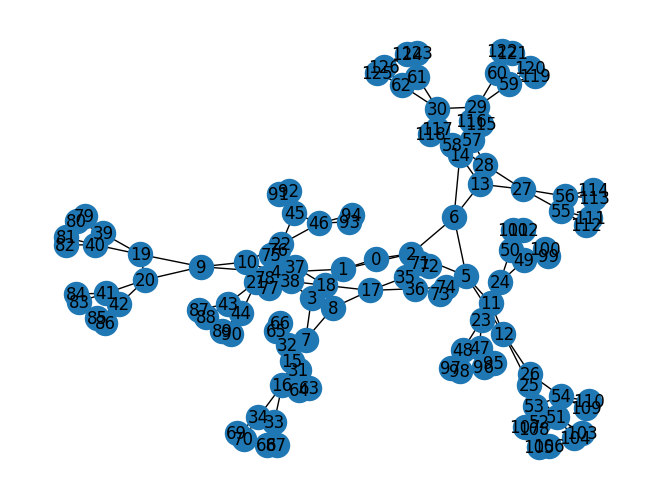

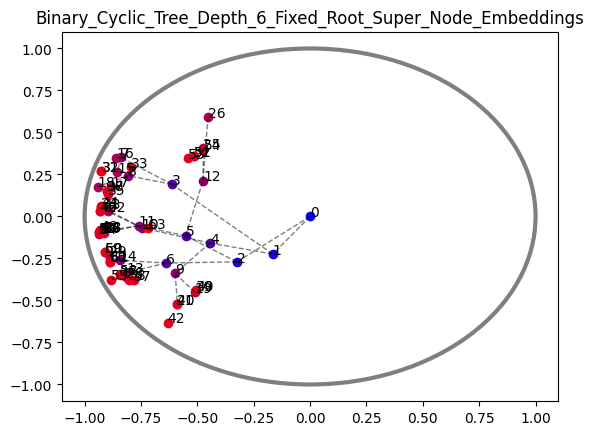

Test_Loss: [3.3061]
Test_ROC: [0.56]
Test_Average_Precision [0.6485]


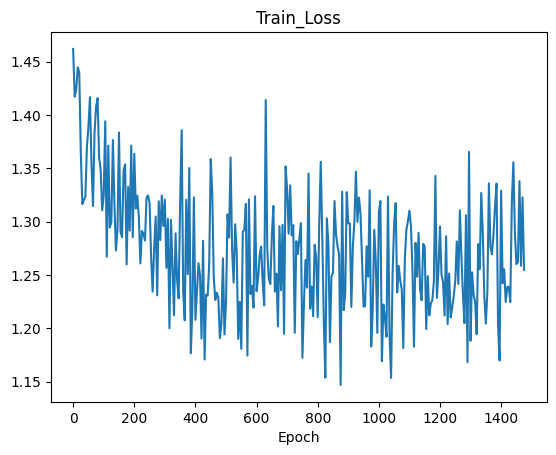

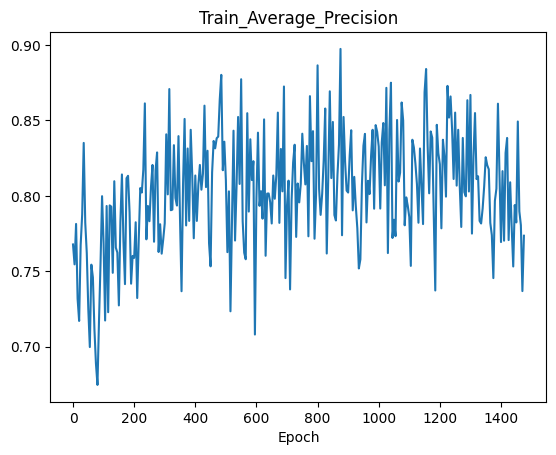

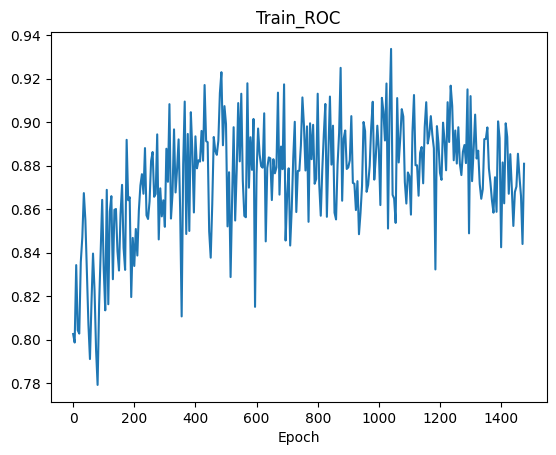

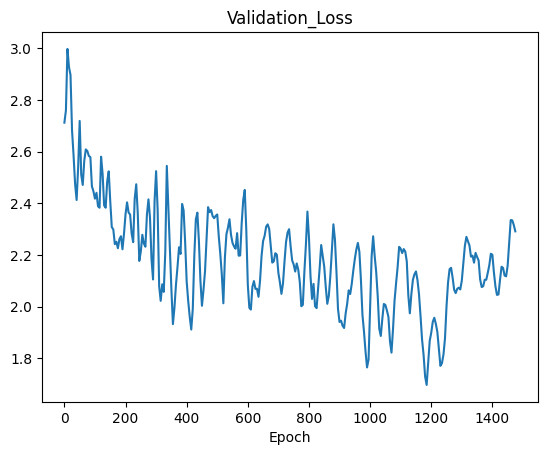

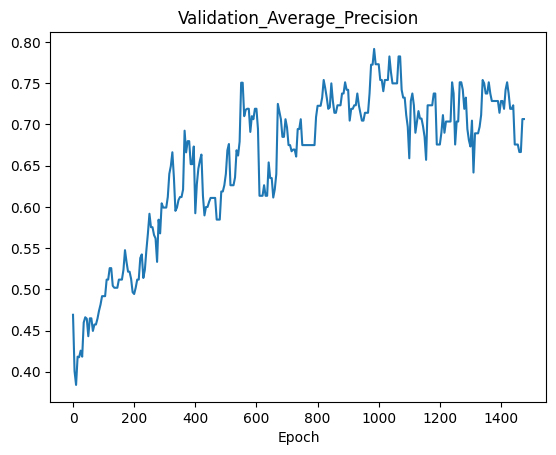

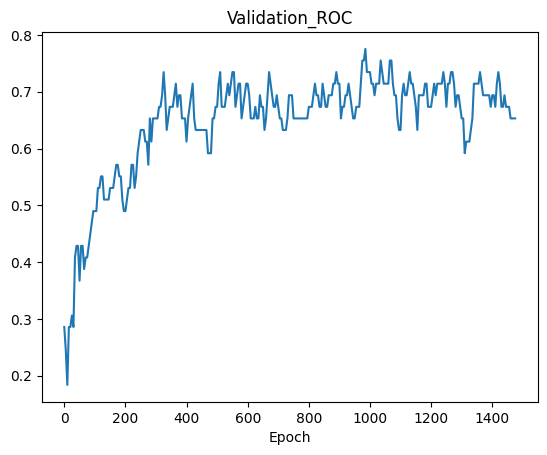

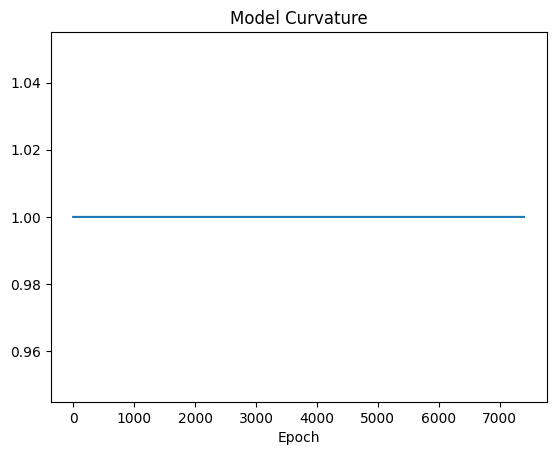

In [283]:
dir_0 = os.path.join(os.getcwd(), "logs")
dir_1 = os.path.join(dir_0, "lp")
dir_2 = os.path.join(dir_1, "2023_5_12")
dir_3 = os.path.join(dir_2, "54")
embeddings_path = os.path.join(dir_3, "embeddings.npy")
log_path = os.path.join(dir_3, "log.txt")   

# viz_embeddings(embeddings_path, is_bin_tree=True, is_cyclic=False, use_colors=True, show_edges=True)
prefix = "Binary_Cyclic_Tree_Depth_6_Fixed_Root_Super_Node"
viz_embeddings(embeddings_path, 
               is_bin_tree=True, 
               is_cyclic=True, 
               use_colors=True, 
               show_edges=True, 
               use_save=True,
              prefix=prefix)
viz_metrics(log_path, 
            use_save=True, 
            prefix=prefix)

    

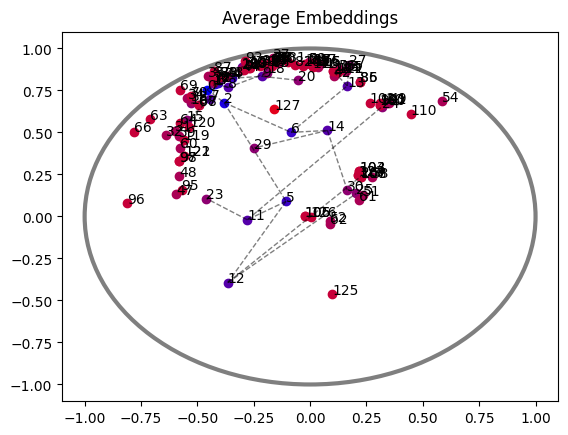

In [232]:
embeddings_avg = None
for folder_num in os.listdir(dir_2):
    if 31 <= int(folder_num) <= 40:
        embeddings_path = os.path.join(dir_3, "embeddings.npy")
        
        if embeddings_avg is None: embeddings_avg = np.load(embeddings_path)
        else: 
            embeddings_avg += np.load(embeddings_path)
        log_path = os.path.join(dir_3, "log.txt")   
embeddings_avg /= 10
viz_embeddings_avg(embeddings_avg, use_colors=True, show_edges=True)



In [11]:
def viz_embeddings_avg(embeddings_avg, 
                   reduce_dim = False, 
                   is_bin_tree= False, 
                   is_cyclic= False, 
                   use_colors = False,
                   show_edges = False,
                   use_save = True,
                   prefix = ""):
    
    hyperboloid_embeddings = embeddings_avg
    if not reduce_dim:
        c = 1.
        torch_embeddings = torch.from_numpy(hyperboloid_embeddings)
        poincare_embeddings = [to_poincare(torch_embedding, c) for torch_embedding in torch_embeddings]
    else:
        # UPDATE: NO LONGER NEED PROJECTION USING TSNE!!!
        from sklearn.manifold import TSNE
        projected_embeddings = TSNE(n_components=2,
                          init='random', perplexity=3).fit_transform(hyperboloid_embeddings)
        poincare_embeddings = torch.from_numpy(projected_embeddings)

    # Create a figure and axis
    fig, ax = plt.subplots()
    # Create a circle with radius 1 centered at the origin
    circ = plt.Circle((0, 0), 
                  radius= 1, 
                  edgecolor='black', 
                  facecolor='None', 
                  linewidth=3, 
                  alpha=0.5)
    # Add the circle to the axis
    ax.add_patch(circ)
    if is_bin_tree: ax.set_title(f"{prefix}_Embeddings")
    else: ax.set_title(f"Average Embeddings")
    ax.set_xlim(-1.1, 1.1)
    ax.set_ylim(-1.1, 1.1)
    
#     poincare_embeddings = scale_to_poincare_disk(poincare_embeddings)
    
    if use_colors:
        colors = ['r', 'g', 'b', 'c', 'm', 'y', 'k']
        cmap = LinearSegmentedColormap.from_list(
            name='BlueRed',
            colors=['blue', 'red'],
            N=10
        )
        colors = [cmap(i) for i in np.linspace(0, 1, 7)]
        for index, poincare_embedding in enumerate(poincare_embeddings):
            color = colors[int(np.log2(index + 1))]
            plt.scatter(poincare_embedding[0], poincare_embedding[1], color = color)
            ax.annotate(index, (poincare_embedding[0], poincare_embedding[1]))
    else:
        for index, poincare_embedding in enumerate(poincare_embeddings):
            plt.scatter(poincare_embedding[0], poincare_embedding[1])
#             ax.annotate(index, (poincare_embedding[0], poincare_embedding[1]))
    def get_edges(adj_matrix):
        edges = []
        for i in range(len(adj_matrix)):
            for j in range(i, len(adj_matrix)):
                if adj_matrix[i, j] > 0:
                    edges.append([i, j])
        return edges
    
    adj_matrix = get_adjacency_matrix_for_binary_tree(5)
        
    embeddings_df = pd.DataFrame({'x': [poincare_embeddings[i][0] for i in range(len(poincare_embeddings))], 
                                        'y': [poincare_embeddings[i][1] for i in range(len(poincare_embeddings))],
                                        'id': [i for i in range(len(poincare_embeddings))]}
                                      )
    if show_edges:
        edge_list_0 = get_edges(adj_matrix)
        for i in range(len(edge_list_0)):
            x1 = embeddings_df.loc[(embeddings_df.id == edge_list_0[i][0]), ['x', 'y']].values[0]
            x2 = embeddings_df.loc[(embeddings_df.id == edge_list_0[i][1]), ['x', 'y']].values[0]
            _ = plt.plot([x1[0], x2[0]], [x1[1], x2[1]], '--', c='black', linewidth=1, alpha=0.5)
    if use_save: plt.savefig(f"{prefix}_embeddings.png")
    plt.show()

c:\users\rarh9\desktop\mit\meng\fhnn_venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Using Log Path : logs\lp\2023_7_17\10
Projecting Train Embeddings :


100%|██████████████████████████████████████████████████████████████████████████████| 161/161 [00:00<00:00, 1008.15it/s]


Scaling Projected Train Embeddings :
Projecting Test Embeddings :


100%|█████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 696.12it/s]


Scaling Projected Test Embeddings :
Age Labels:  [72, 75, 70, 73, 78, 64, 64, 67, 69, 75, 62, 69, 71, 68, 75, 66, 65, 78, 67]
Predicted Ages:  [73.08225149 75.98087716 68.47981676 68.3546695  70.8966657  64.92944106
 65.74382114 65.13865844 72.22557876 71.38149819 75.21292956 69.32716345
 67.04231547 72.26615189 68.5148221  75.24449303 76.05059138 74.91195764
 85.19145255]


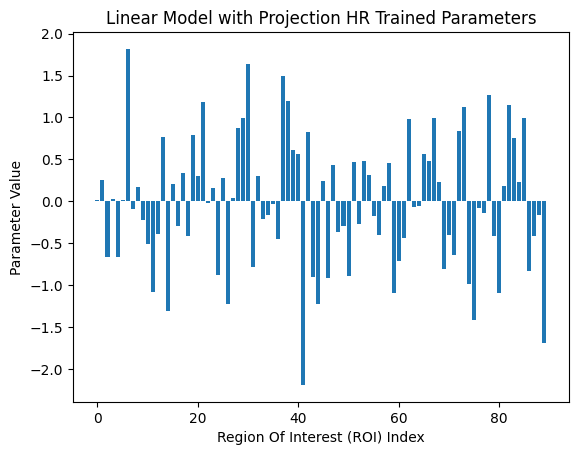

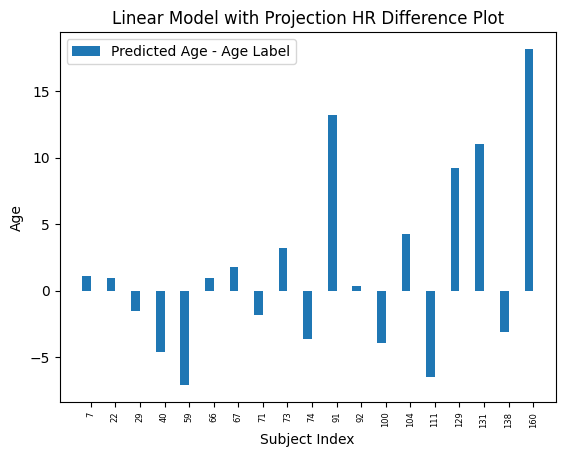

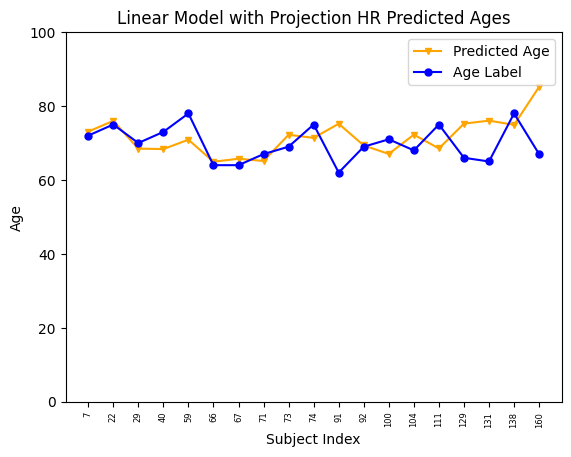

Linear Model with Projection HR Mean Squared Error (MSE): 47.68413924492928


47.68413924492928

In [1]:
from age_predictor import Age_Predictor
linear_age_predictor = Age_Predictor("Linear", "HR", dataset="MEG")
linear_age_predictor.regression()

Alpha Parameter : 100
Projecting Train Embeddings :


100%|██████████████████████████████████████████████████████████████████████████████| 161/161 [00:00<00:00, 1079.40it/s]


Scaling Projected Train Embeddings :
Projecting Test Embeddings :


100%|█████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 954.14it/s]


Scaling Projected Test Embeddings :
Age Labels:  [72, 75, 70, 73, 78, 64, 64, 67, 69, 75, 62, 69, 71, 68, 75, 66, 65, 78, 67]
Predicted Ages:  [72.37039861 70.84114756 70.19590685 70.32972714 75.58366963 69.65351412
 71.05101457 72.59179197 70.31443191 72.16046891 73.90568431 69.59039354
 69.76783538 71.26467606 69.79994289 72.75640322 71.59170487 72.9316424
 73.27480136]


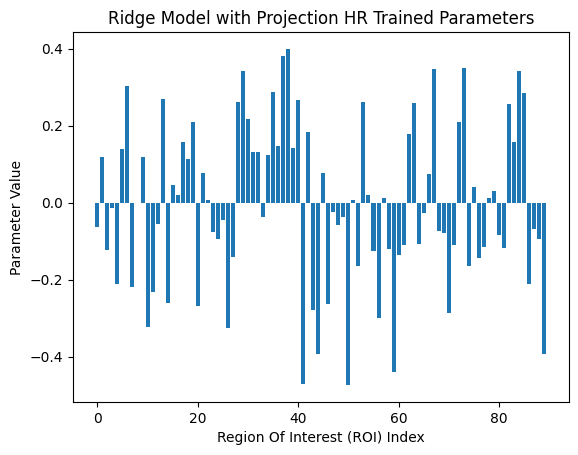

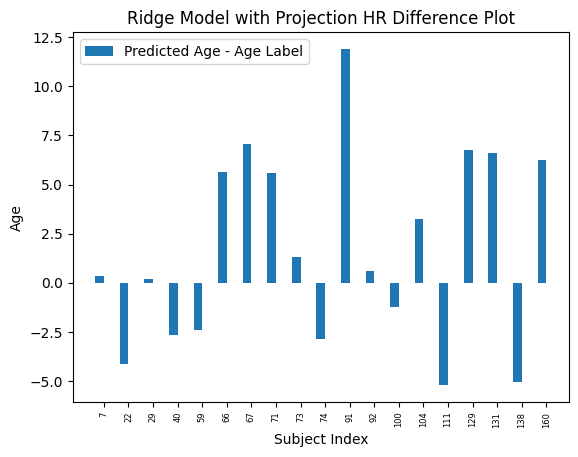

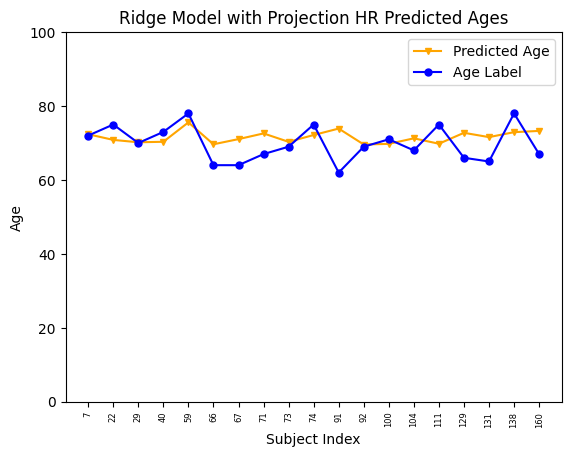

Ridge Model with Projection HR Mean Squared Error (MSE): 25.718432986470738


25.718432986470738

In [3]:
from age_predictor import Age_Predictor
ridge_age_predictor = Age_Predictor("Ridge", "HR", dataset = "MEG")
ridge_age_predictor.regression()

c:\users\rarh9\desktop\mit\meng\fhnn_venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Using Log Path : logs\lp\2023_7_19\0
Projecting Train Embeddings :


100%|███████████████████████████████████████████████████████████████████████████████| 527/527 [00:01<00:00, 296.74it/s]


Scaling Projected Train Embeddings :
Projecting Test Embeddings :


100%|█████████████████████████████████████████████████████████████████████████████████| 60/60 [00:00<00:00, 312.55it/s]


Scaling Projected Test Embeddings :
Age Labels:  [28.17, 25.83, 19.0, 28.42, 29.83, 34.75, 32.58, 35.0, 35.08, 36.33, 33.17, 37.25, 48.33, 48.75, 44.42, 44.25, 42.67, 46.42, 41.33, 43.83, 39.92, 39.33, 44.92, 42.75, 53.33, 58.08, 51.08, 56.42, 53.17, 53.5, 51.75, 51.25, 68.08, 66.08, 59.83, 58.75, 61.33, 61.25, 66.58, 68.08, 63.67, 66.58, 65.08, 68.33, 68.75, 75.67, 69.5, 75.33, 76.25, 76.33, 69.33, 71.17, 78.67, 74.42, 69.25, 71.08, 82.58, 79.5, 80.42, 86.08]
Predicted Ages:  [ 20.76723158  40.71315188 100.04892888  14.37055475  59.06648418
  16.77063417  77.72856965  25.52280752  62.00793668  -1.92440159
  53.45462739  89.17101992  71.04038645  80.15947487  20.06317475
  53.89781653  25.56192652  45.63867285  69.37458236  50.71176279
   7.08733457  38.65493563  34.56041731  76.46114528  75.68586526
  55.47097183  52.73444639  44.59276736  15.40375281  38.38747442
  46.48073169  89.76350553  78.01979335  71.47984207  84.05314237
  66.79769917  88.75239214  33.48407065  37.1744698   94

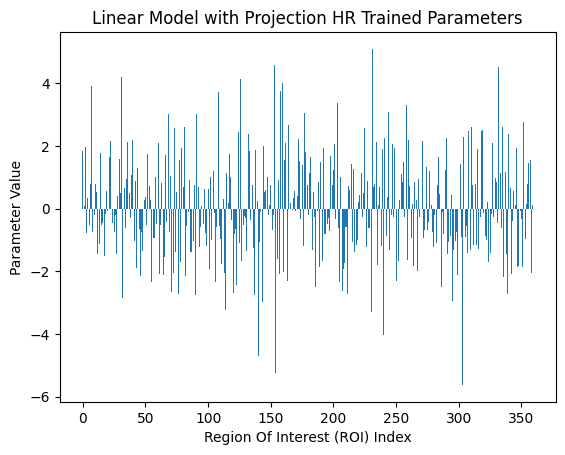

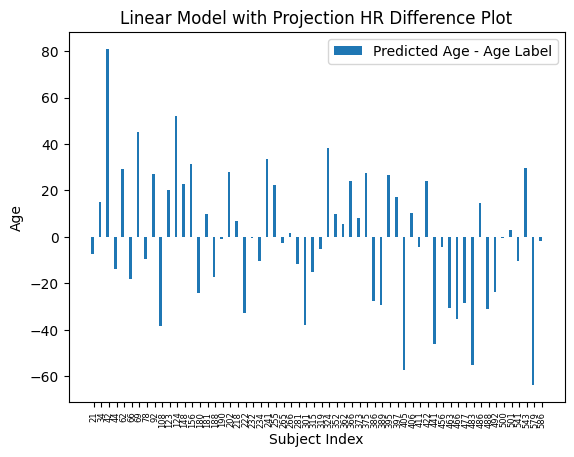

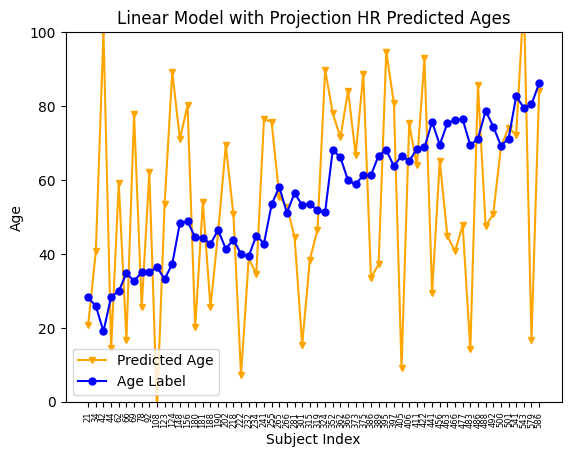

Linear Model with Projection HR Mean Squared Error (MSE): 804.8542544924151


804.8542544924151

In [1]:
from age_predictor import Age_Predictor
linear_age_predictor = Age_Predictor("Linear", "HR", dataset="Cam-CAN")
linear_age_predictor.regression()
    

Alpha Parameter : 100
Projecting Train Embeddings :


100%|███████████████████████████████████████████████████████████████████████████████| 527/527 [00:01<00:00, 275.31it/s]


Scaling Projected Train Embeddings :
Projecting Test Embeddings :


100%|█████████████████████████████████████████████████████████████████████████████████| 60/60 [00:00<00:00, 267.82it/s]


Scaling Projected Test Embeddings :
Age Labels:  [28.17, 25.83, 19.0, 28.42, 29.83, 34.75, 32.58, 35.0, 35.08, 36.33, 33.17, 37.25, 48.33, 48.75, 44.42, 44.25, 42.67, 46.42, 41.33, 43.83, 39.92, 39.33, 44.92, 42.75, 53.33, 58.08, 51.08, 56.42, 53.17, 53.5, 51.75, 51.25, 68.08, 66.08, 59.83, 58.75, 61.33, 61.25, 66.58, 68.08, 63.67, 66.58, 65.08, 68.33, 68.75, 75.67, 69.5, 75.33, 76.25, 76.33, 69.33, 71.17, 78.67, 74.42, 69.25, 71.08, 82.58, 79.5, 80.42, 86.08]
Predicted Ages:  [31.42613685 53.96629031 71.09812566 30.42771814 43.31489141 35.39409623
 77.77330794 39.20065723 47.40717153 29.62505724 54.99311326 65.2604712
 40.72697483 56.69307409 40.54097437 55.76627344 48.12061318 55.38833483
 64.92580137 48.42843351 19.3725123  44.78384808 40.25623254 56.52150429
 49.20892059 54.48320444 61.44037498 46.62490146 35.49250439 62.18834668
 52.91321185 81.3362581  72.26154997 61.9638356  77.55598672 70.93520175
 64.6254229  42.3772216  50.74063856 68.77070611 55.85578943 36.39130605
 59.6245

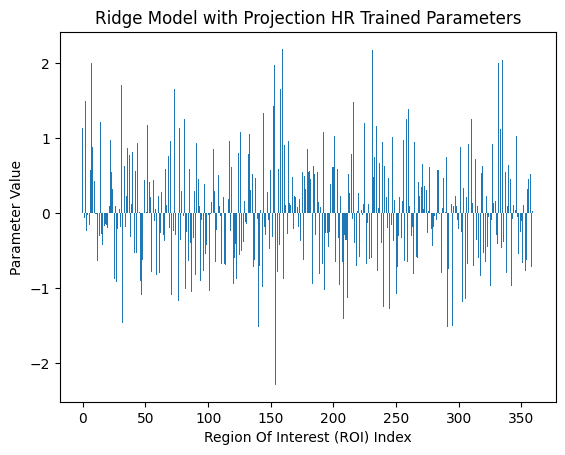

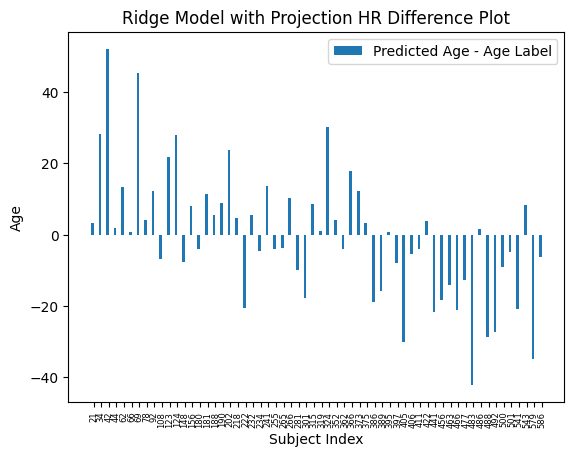

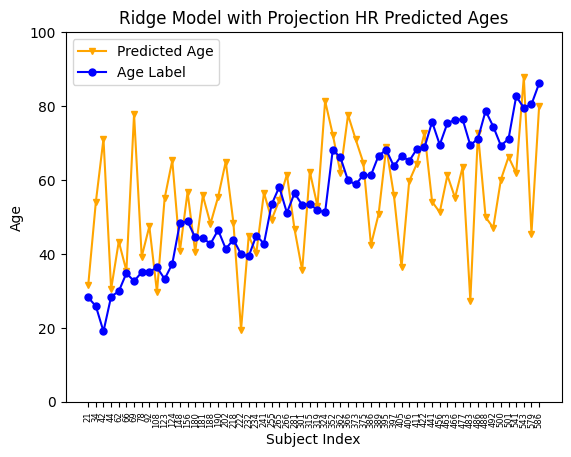

Ridge Model with Projection HR Mean Squared Error (MSE): 322.440759849622


322.440759849622

In [6]:
from age_predictor import Age_Predictor
ridge_age_predictor = Age_Predictor("Ridge", "HR", dataset="Cam-CAN", alpha=100)
ridge_age_predictor.regression()


Projecting Train Embeddings :


100%|██████████████████████████████████████████████████████████████████████████████| 161/161 [00:00<00:00, 1893.42it/s]


Scaling Projected Train Embeddings :
Projecting Test Embeddings :


100%|████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1266.90it/s]

Scaling Projected Test Embeddings :
Age Labels:  [72, 75, 70, 73, 78, 64, 64, 67, 69, 75, 62, 69, 71, 68, 75, 66, 65, 78, 67]
Predicted Ages:  [74.96623554 71.97875018 67.85485723 73.04412373 71.7644242  76.30485211
 73.04840494 57.71134543 71.42801385 69.31885673 74.47484712 78.6219168
 70.2850238  64.37059111 69.88413342 67.48737005 72.48135948 80.26720551
 74.68284405]


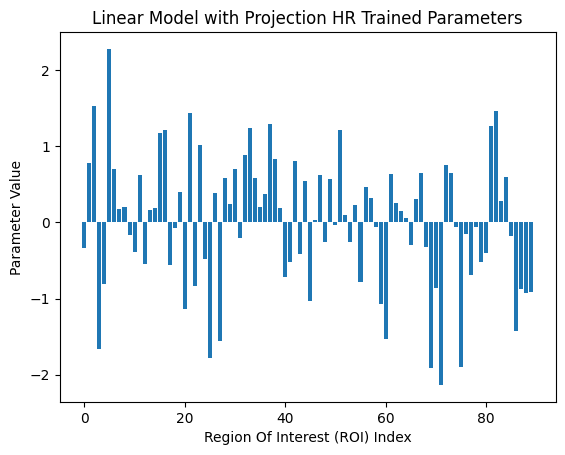

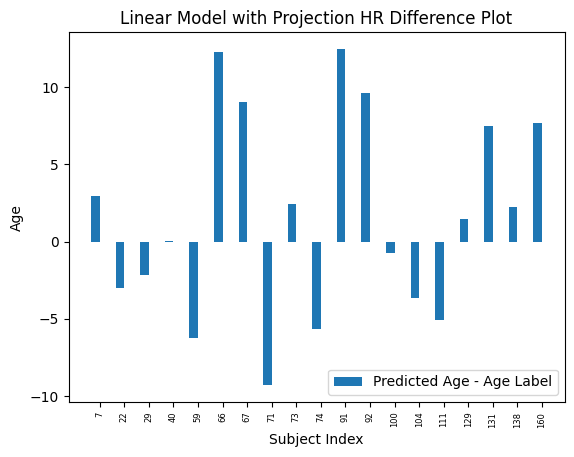

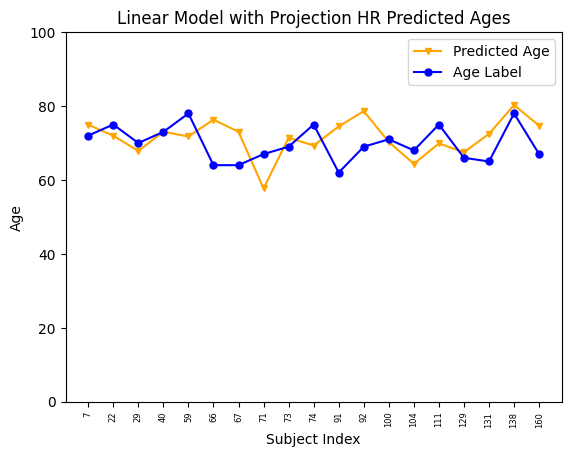

Linear Model with Projection HR Mean Squared Error (MSE): 43.66071378380936


43.66071378380936

In [4]:
from age_predictor import Age_Predictor
linear_age_predictor = Age_Predictor("Linear", "HR", dataset = "MEG")
linear_age_predictor.regression()

Alpha Parameter : 100
Projecting Train Embeddings :


100%|██████████████████████████████████████████████████████████████████████████████| 161/161 [00:00<00:00, 1849.83it/s]


Scaling Projected Train Embeddings :
Projecting Test Embeddings :


100%|████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 1266.74it/s]


Scaling Projected Test Embeddings :
Age Labels:  [72, 75, 70, 73, 78, 64, 64, 67, 69, 75, 62, 69, 71, 68, 75, 66, 65, 78, 67]
Predicted Ages:  [73.02567991 72.33983552 70.29949564 70.55065093 72.98111379 70.08916187
 72.779291   68.76646463 71.95517262 71.99601641 71.88276311 71.16591836
 72.72708576 69.44848739 71.59007486 71.05361827 72.43006353 73.14684331
 71.74741837]


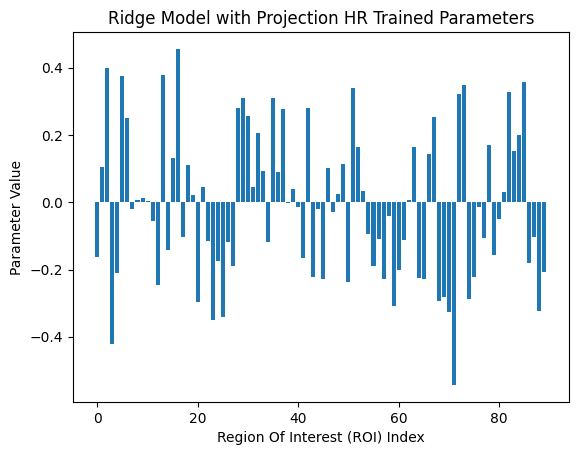

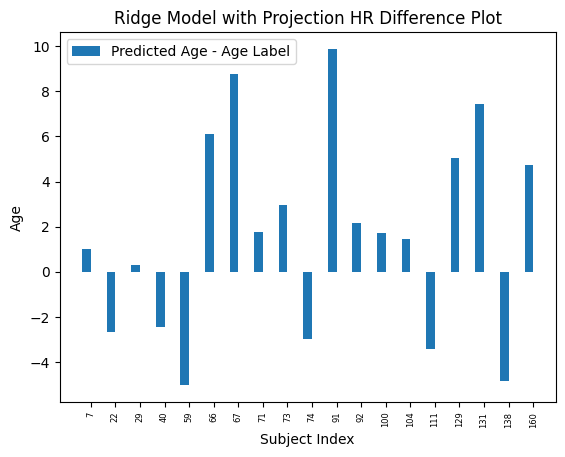

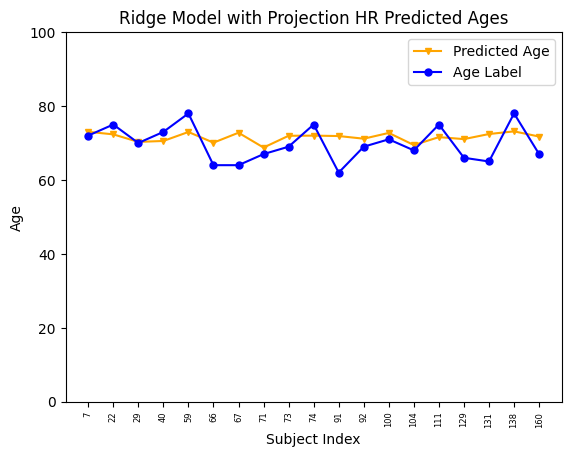

Ridge Model with Projection HR Mean Squared Error (MSE): 22.123298767251022


22.123298767251022

In [3]:
from age_predictor import Age_Predictor

# linear_age_predictor = Age_Predictor("Linear", "HR", dataset = "MEG")
# linear_age_predictor.regression()
ridge_age_predictor = Age_Predictor("Ridge", "HR", dataset = "MEG")
ridge_age_predictor.regression()

c:\users\rarh9\desktop\mit\meng\fhnn_venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Using Log Path : logs\lp\2023_7_17\0
Projecting Train Embeddings :


100%|█████████████████████████████████████████████████████████████████████████████████| 52/52 [00:00<00:00, 429.75it/s]


Scaling Projected Train Embeddings :
Projecting Test Embeddings :


100%|███████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 299.98it/s]


Scaling Projected Test Embeddings :
Age Labels:  [28.67, 18.83, 37.33, 31.75, 56.42, 84.42]
Predicted Ages:  [45.51356975 50.90339349 34.89323547 75.3069851  55.96895063 46.6273271 ]


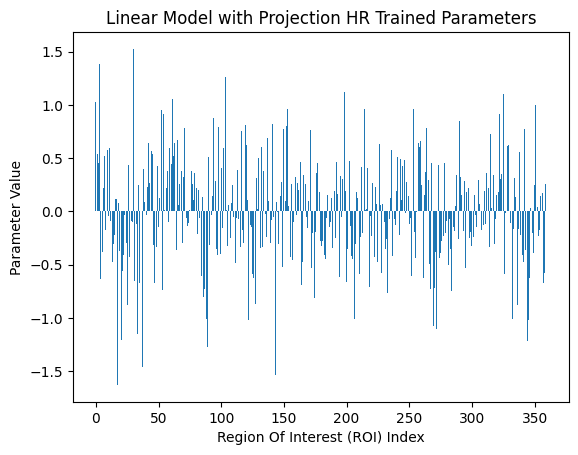

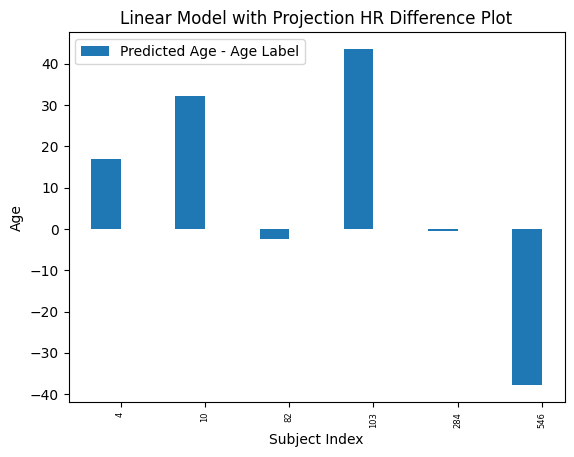

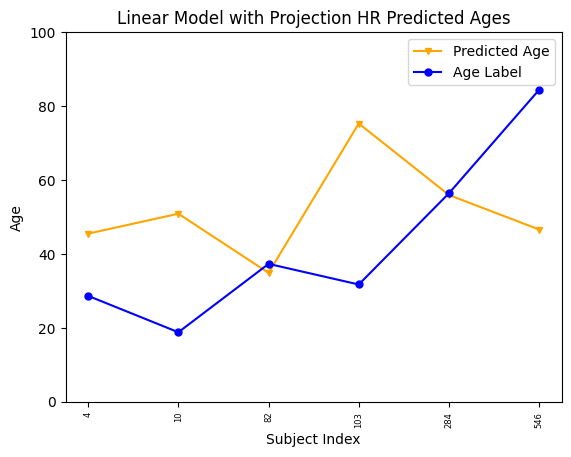

Linear Model with Projection HR Mean Squared Error (MSE): 774.0077925466579


774.0077925466579

In [1]:
from age_predictor import Age_Predictor
ridge_age_predictor = Age_Predictor("Linear", "HR")
ridge_age_predictor.regression()

Alpha Parameter : 100
Projecting Train Embeddings :


100%|█████████████████████████████████████████████████████████████████████████████████| 52/52 [00:00<00:00, 412.60it/s]


Scaling Projected Train Embeddings :
Projecting Test Embeddings :


100%|███████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 315.81it/s]

Scaling Projected Test Embeddings :
Age Labels:  [28.67, 18.83, 37.33, 31.75, 56.42, 84.42]
Predicted Ages:  [50.77728665 52.70899677 40.77440335 64.16837458 52.67440366 48.10999653]


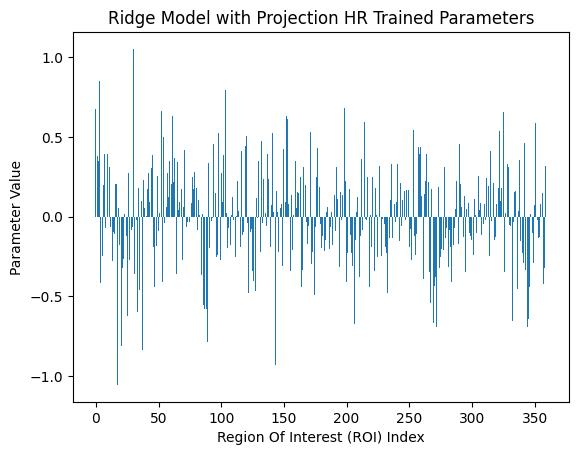

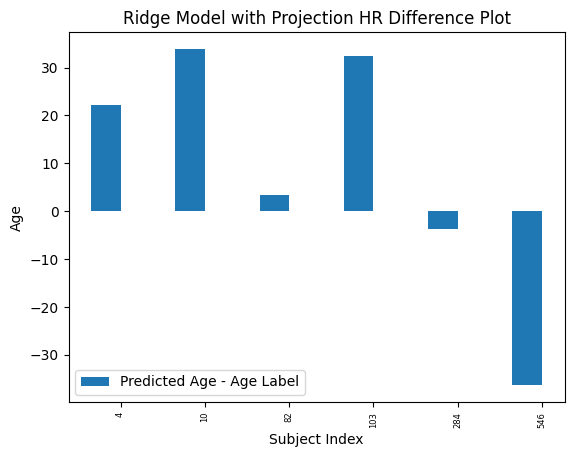

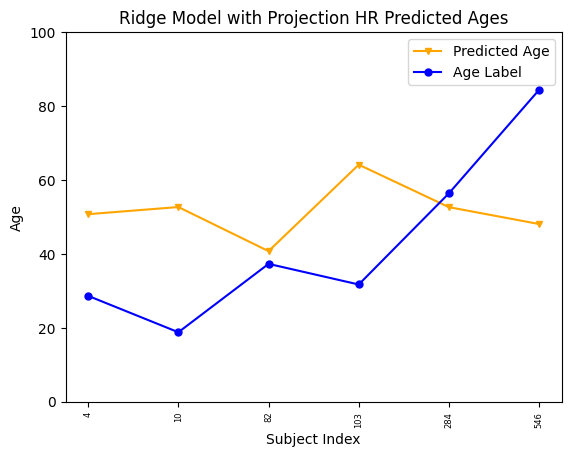

Ridge Model with Projection HR Mean Squared Error (MSE): 671.9632189350735


671.9632189350735

In [2]:
from age_predictor import Age_Predictor
ridge_age_predictor = Age_Predictor("Ridge", "HR")
ridge_age_predictor.regression()

c:\users\rarh9\desktop\mit\meng\fhnn_venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Using Log Path : logs\lp\2023_7_17\0
Projecting Train Embeddings :


100%|█████████████████████████████████████████████████████████████████████████████████| 52/52 [00:00<00:00, 456.02it/s]


Scaling Projected Train Embeddings :
Projecting Test Embeddings :


100%|███████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 428.76it/s]

Scaling Projected Test Embeddings :
Age Labels:  [28.67, 18.83, 37.33, 31.75, 56.42, 84.42]
Predicted Ages:  [45.51356975 50.90339349 34.89323547 75.3069851  55.96895063 46.6273271 ]


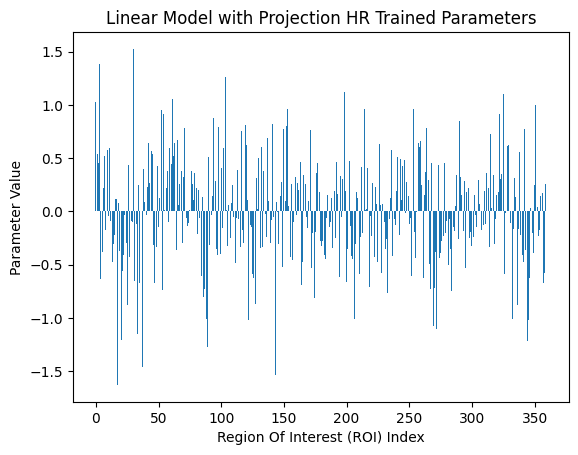

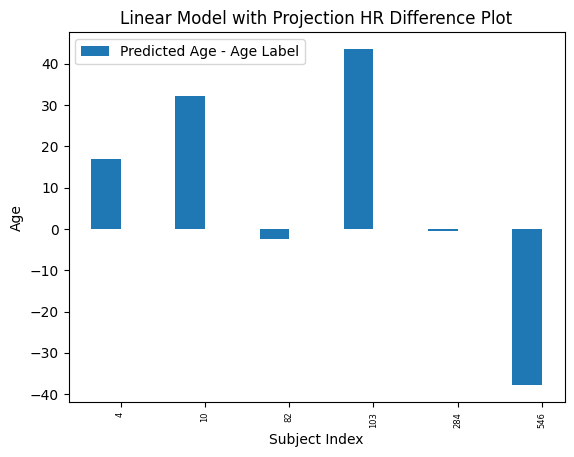

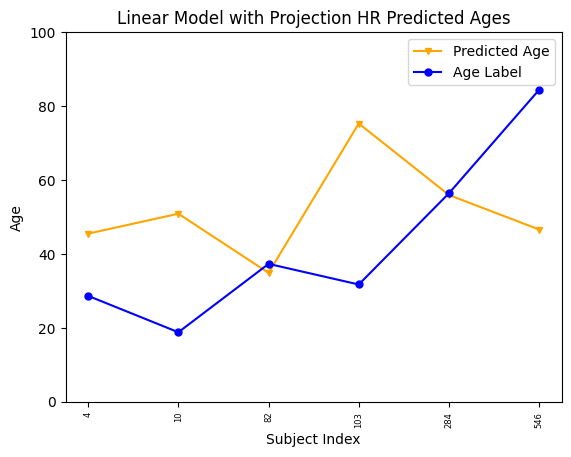

Linear Model with Projection HR Mean Squared Error (MSE): 774.0077925466579


774.0077925466579

In [1]:
from age_predictor import Age_Predictor
ridge_age_predictor = Age_Predictor("Linear", "HR")
ridge_age_predictor.regression()

THIS IS THE SBJ ID:  0
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


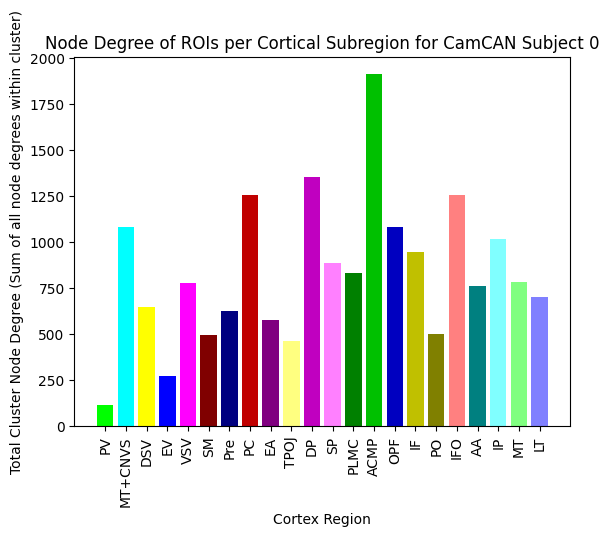

THIS IS THE SBJ ID:  1
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


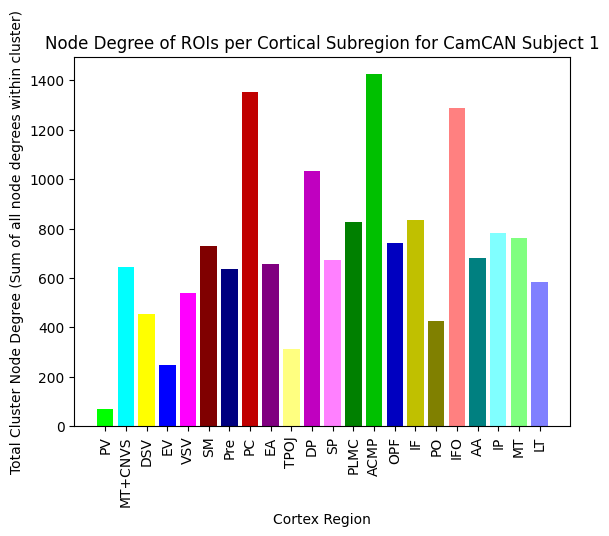

THIS IS THE SBJ ID:  2
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


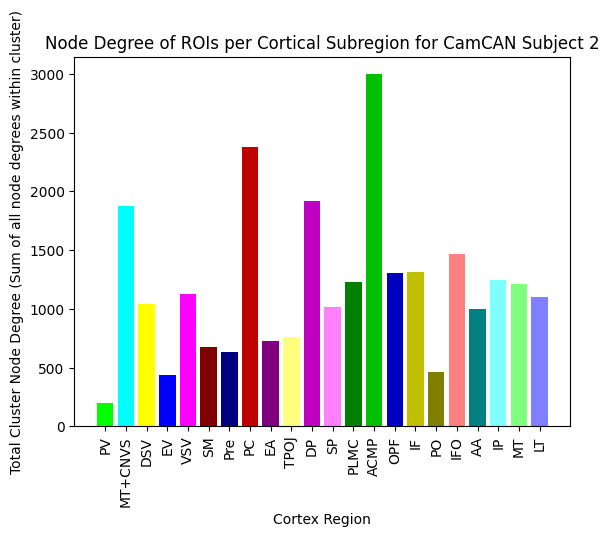

THIS IS THE SBJ ID:  3
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


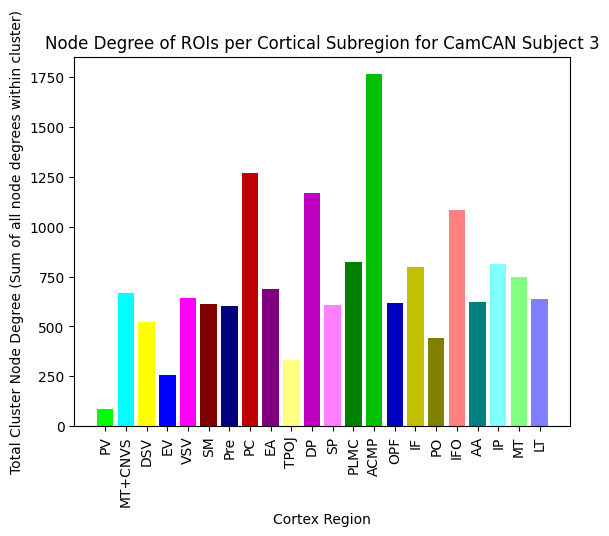

THIS IS THE SBJ ID:  4
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


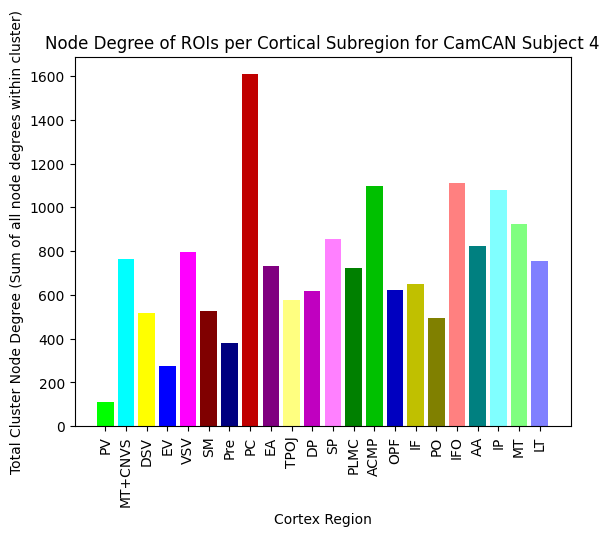

THIS IS THE SBJ ID:  5
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


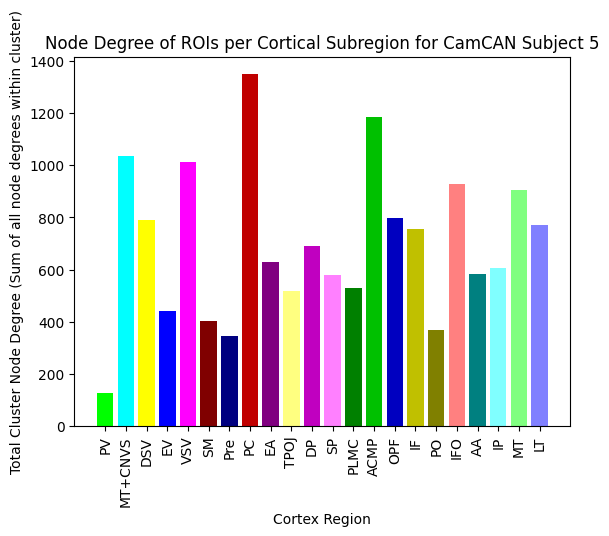

THIS IS THE SBJ ID:  6
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


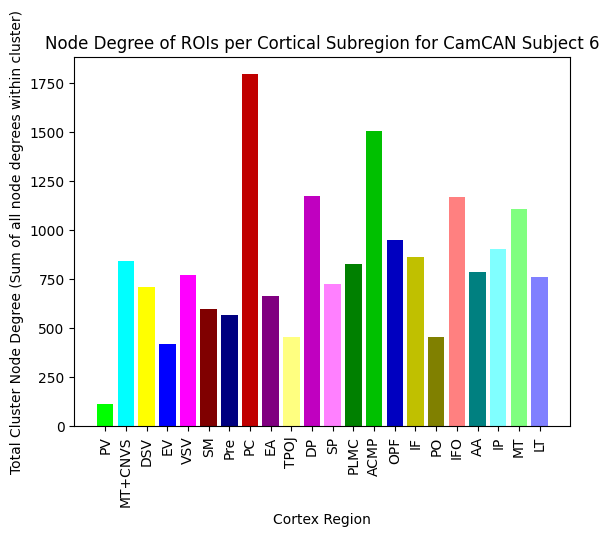

THIS IS THE SBJ ID:  7
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


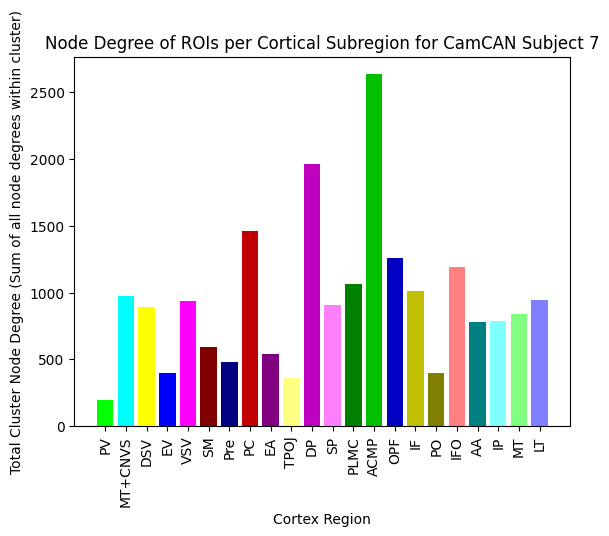

THIS IS THE SBJ ID:  8
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


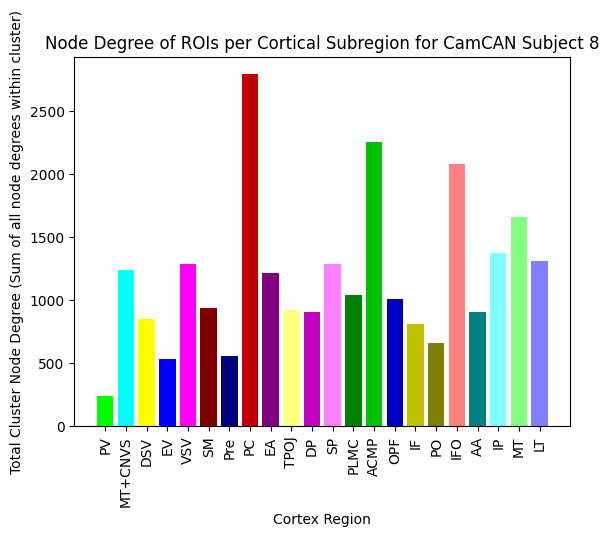

THIS IS THE SBJ ID:  9
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


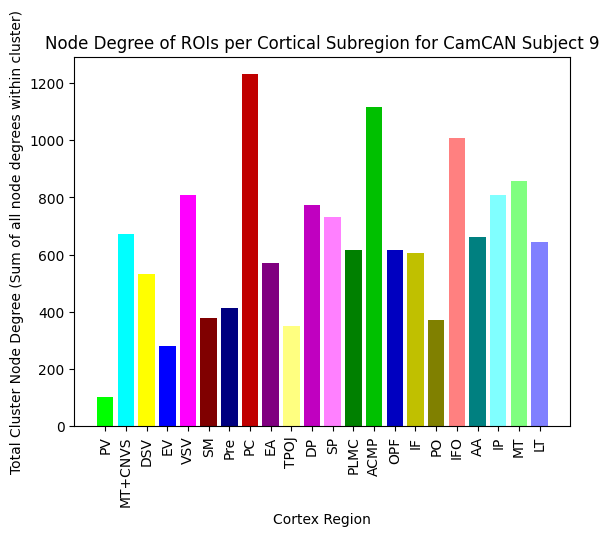

THIS IS THE SBJ ID:  10
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


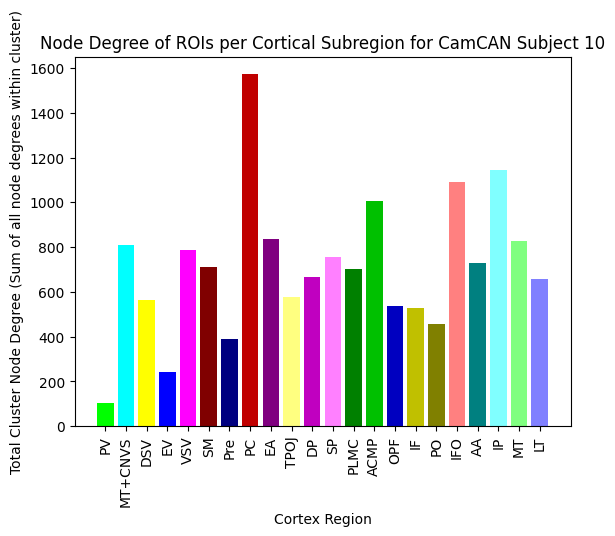

THIS IS THE SBJ ID:  11
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


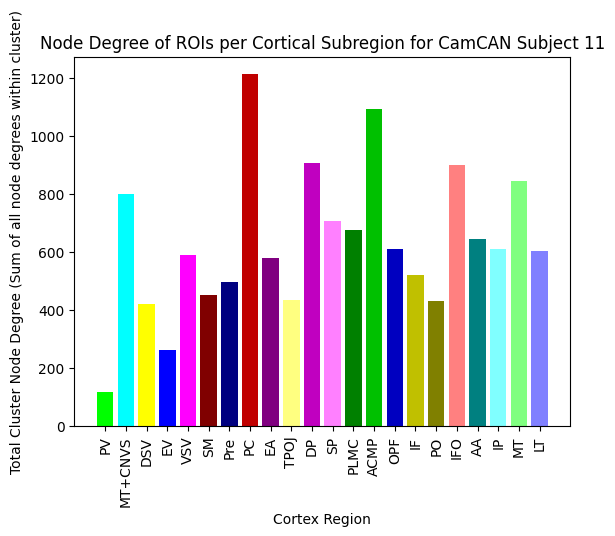

THIS IS THE SBJ ID:  12
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


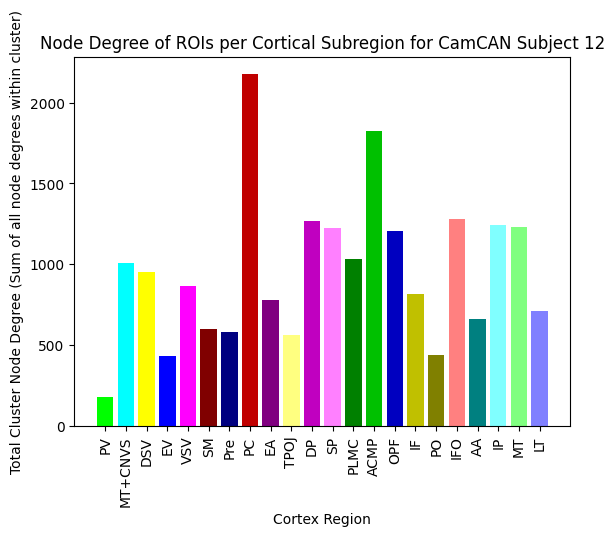

THIS IS THE SBJ ID:  13
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


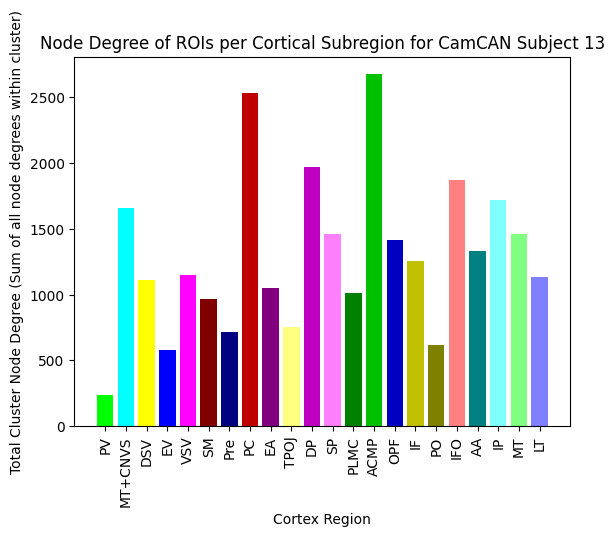

THIS IS THE SBJ ID:  14
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


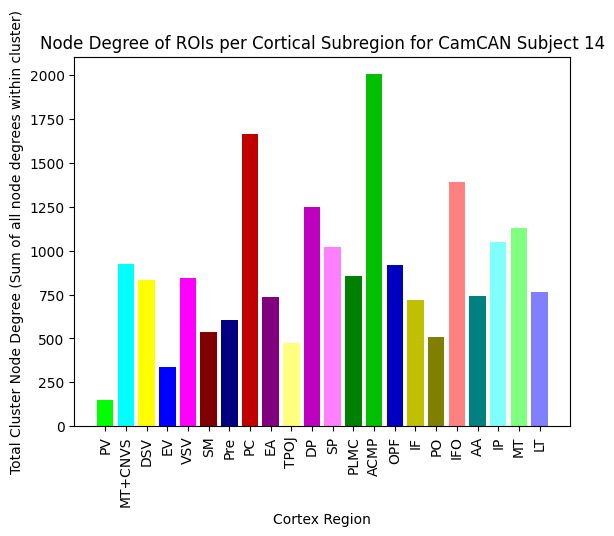

THIS IS THE SBJ ID:  15
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


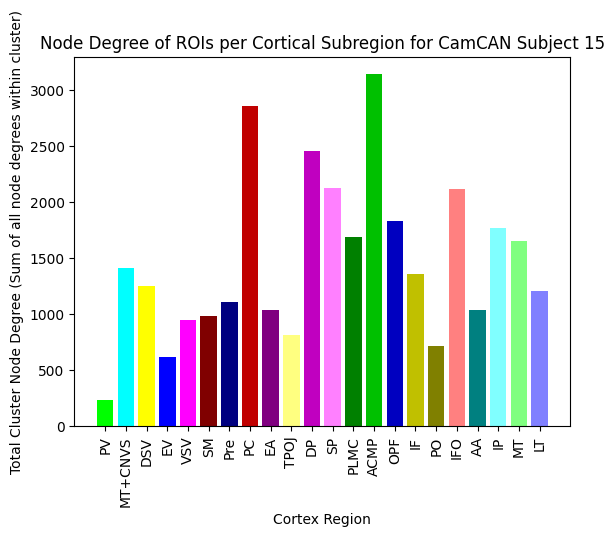

THIS IS THE SBJ ID:  16
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


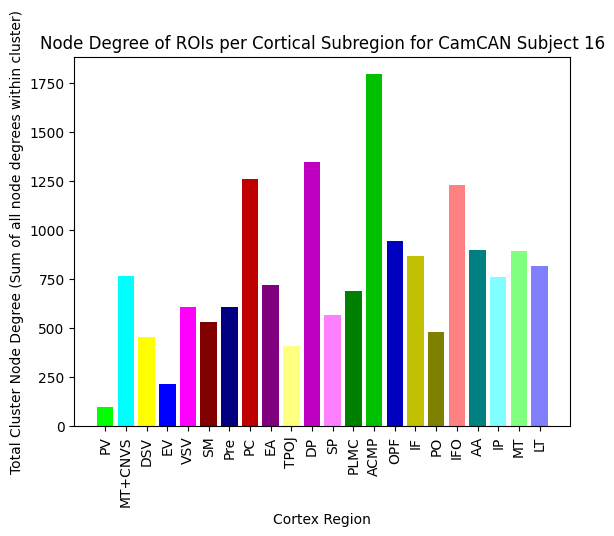

THIS IS THE SBJ ID:  17
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


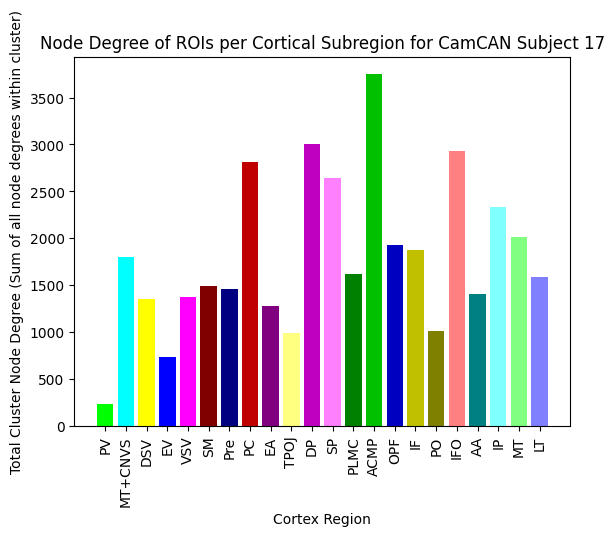

THIS IS THE SBJ ID:  18
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


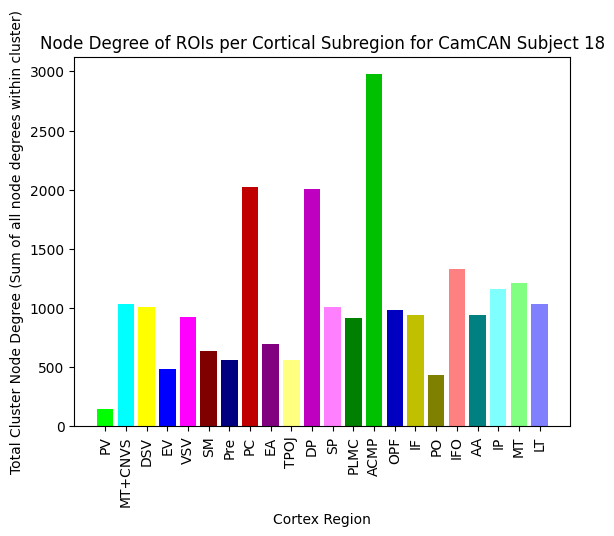

THIS IS THE SBJ ID:  19
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


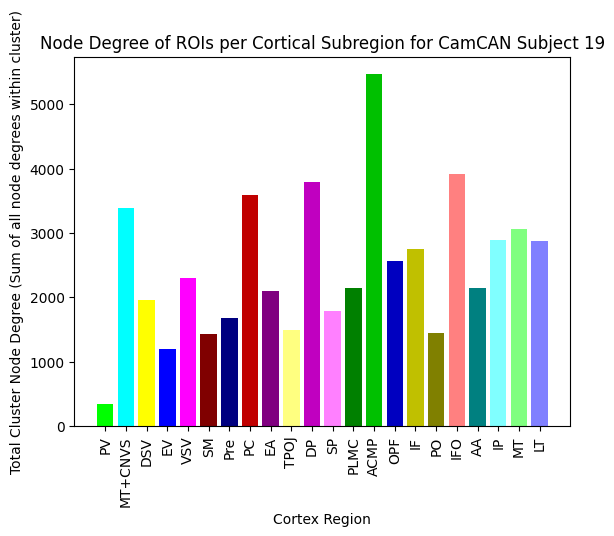

THIS IS THE SBJ ID:  20
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


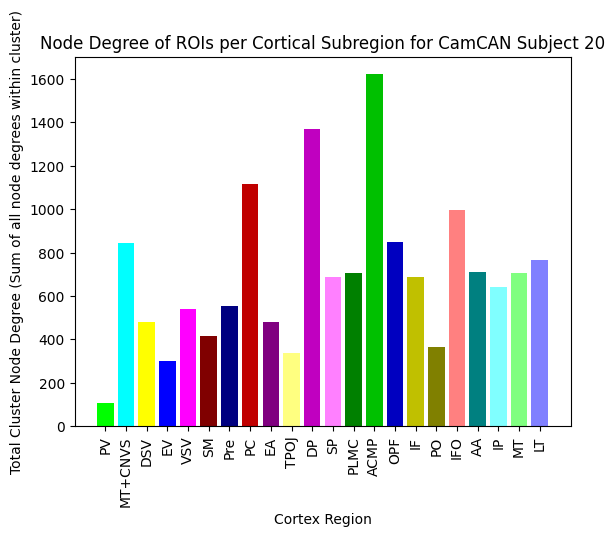

THIS IS THE SBJ ID:  21
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


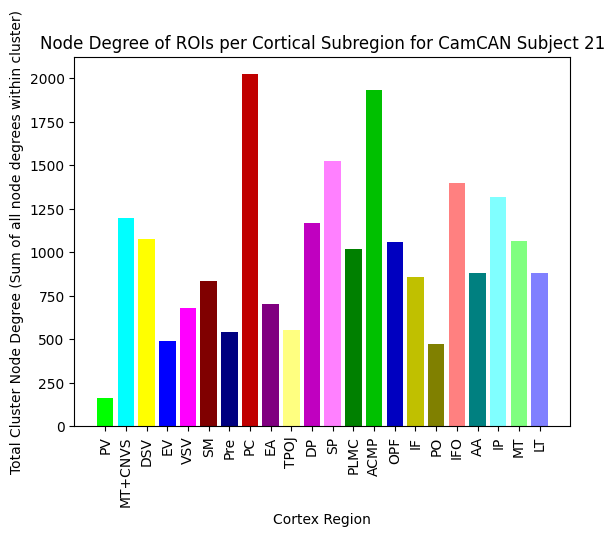

THIS IS THE SBJ ID:  22
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


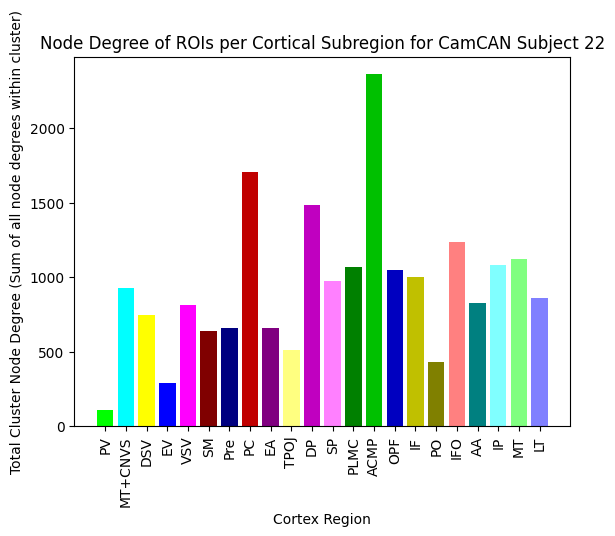

THIS IS THE SBJ ID:  23
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


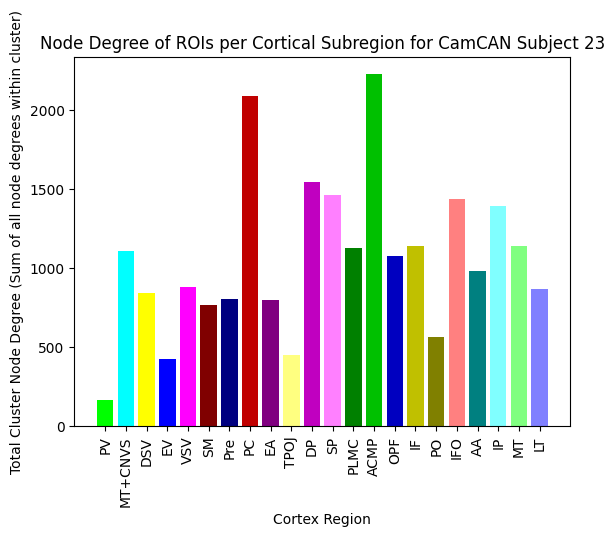

THIS IS THE SBJ ID:  24
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


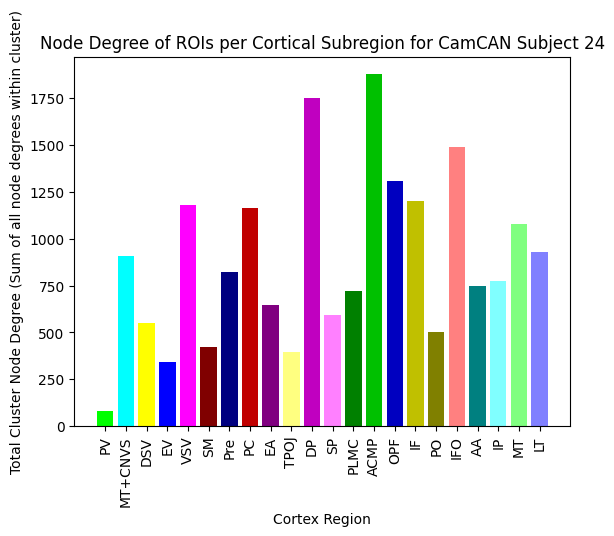

THIS IS THE SBJ ID:  25
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


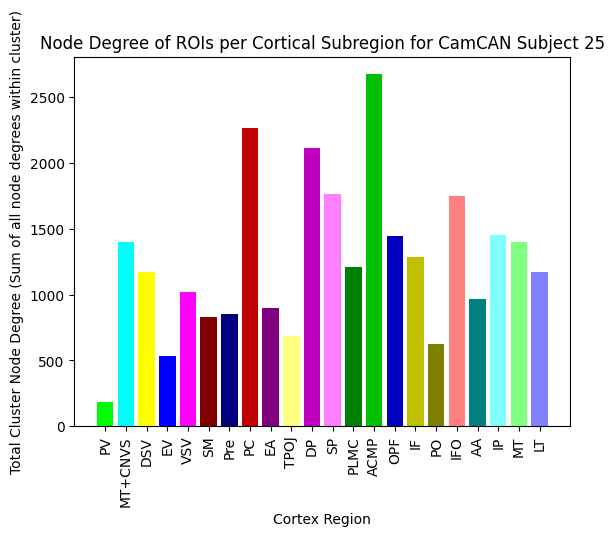

THIS IS THE SBJ ID:  26
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


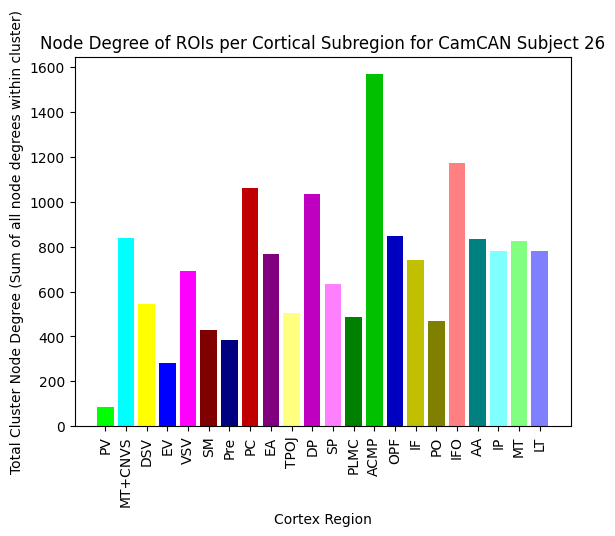

THIS IS THE SBJ ID:  27
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


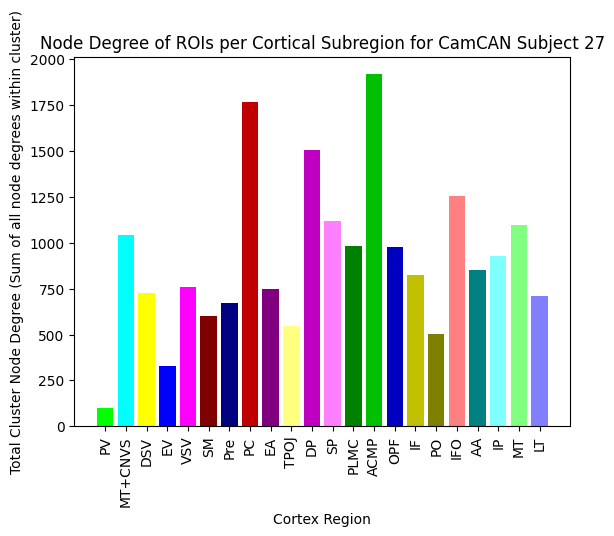

THIS IS THE SBJ ID:  28
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


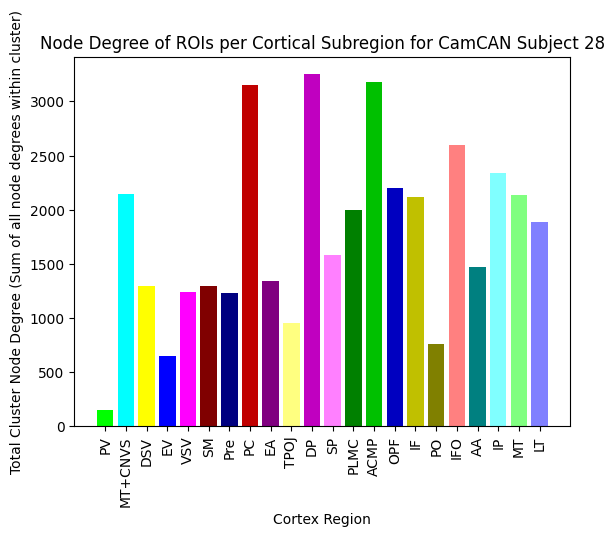

THIS IS THE SBJ ID:  29
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


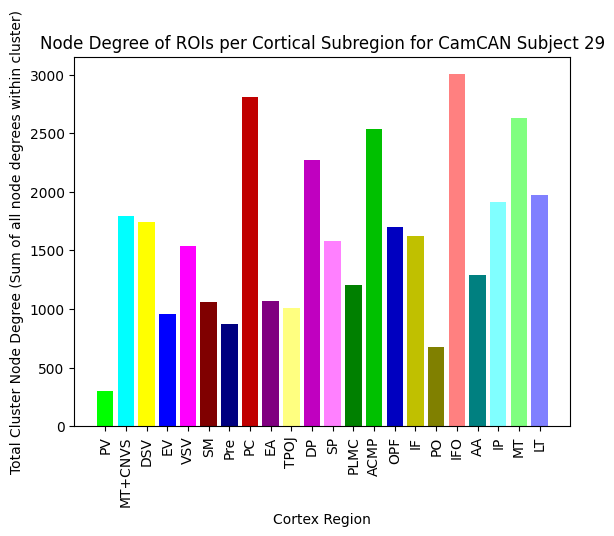

THIS IS THE SBJ ID:  30
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


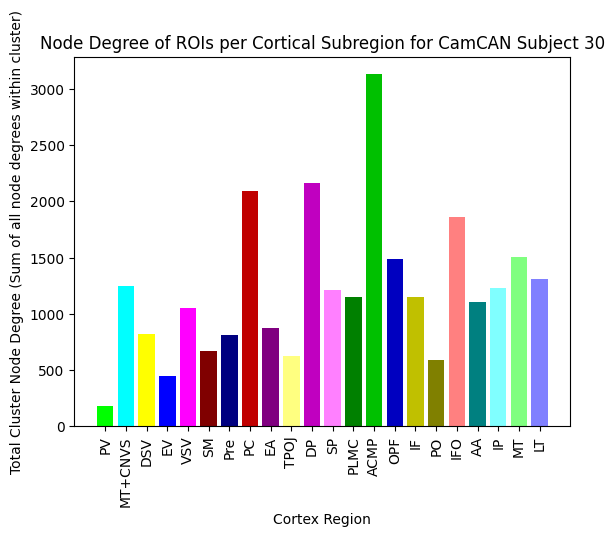

THIS IS THE SBJ ID:  31
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


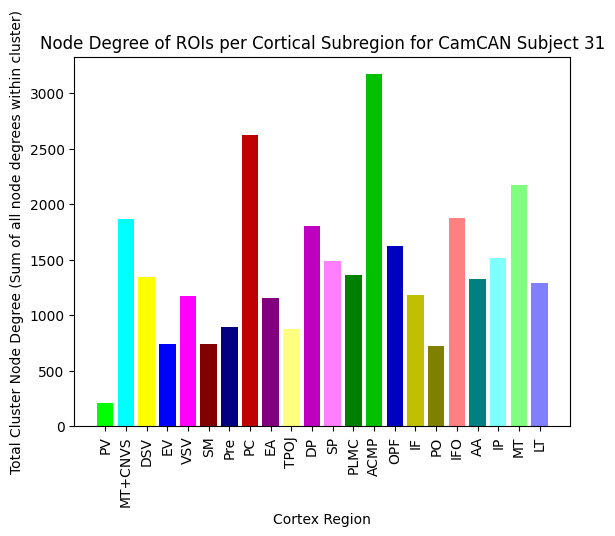

THIS IS THE SBJ ID:  32
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


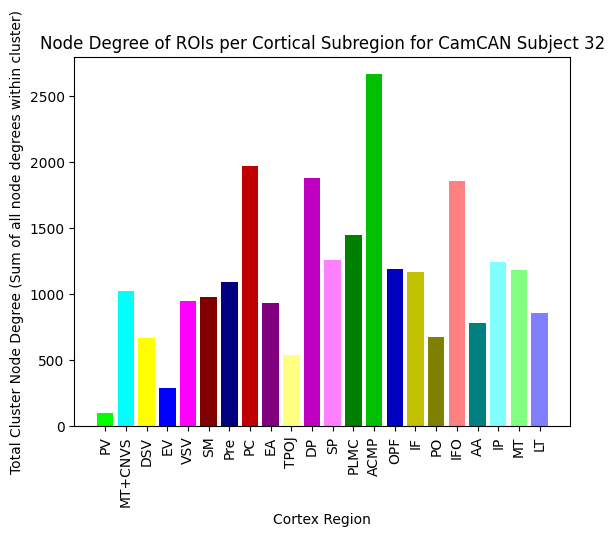

THIS IS THE SBJ ID:  33
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


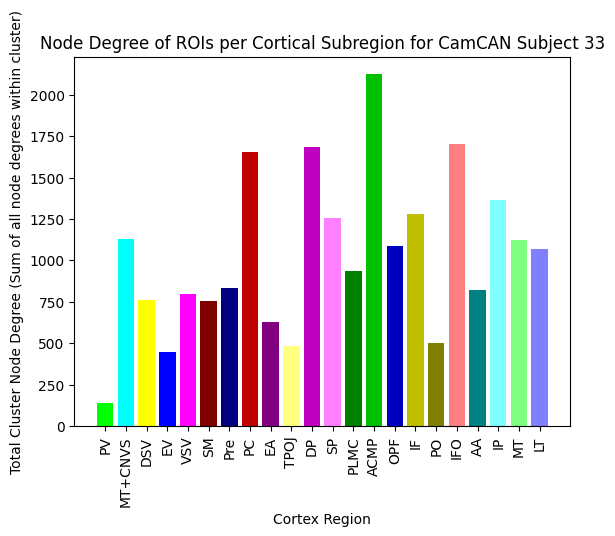

THIS IS THE SBJ ID:  34
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


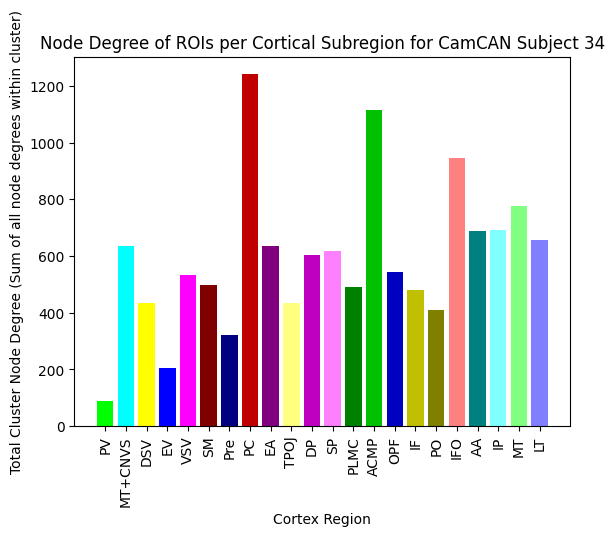

THIS IS THE SBJ ID:  35
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


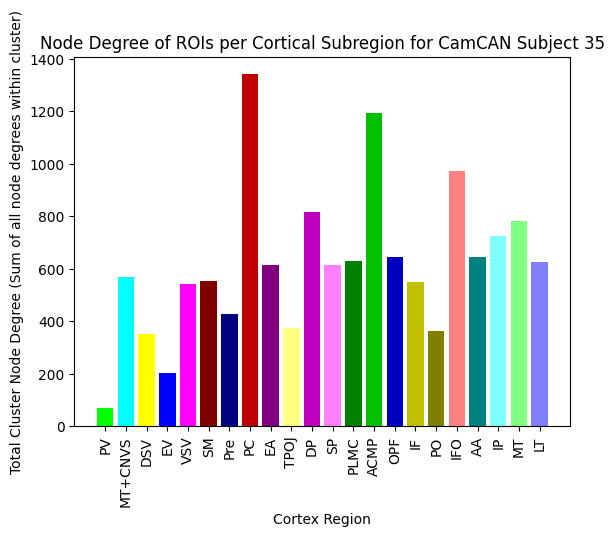

THIS IS THE SBJ ID:  36
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


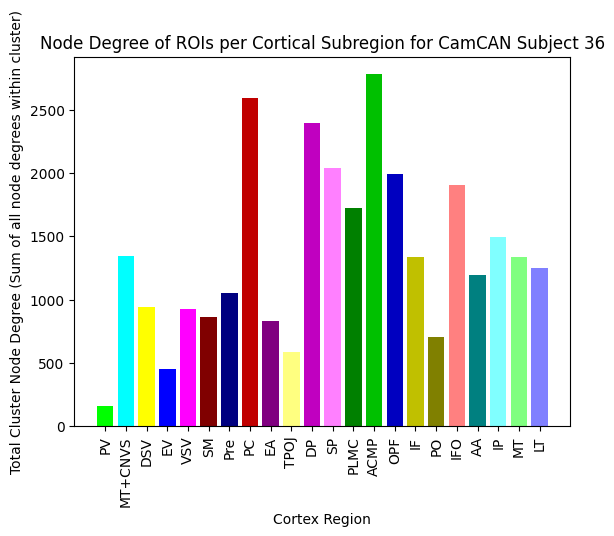

THIS IS THE SBJ ID:  37
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


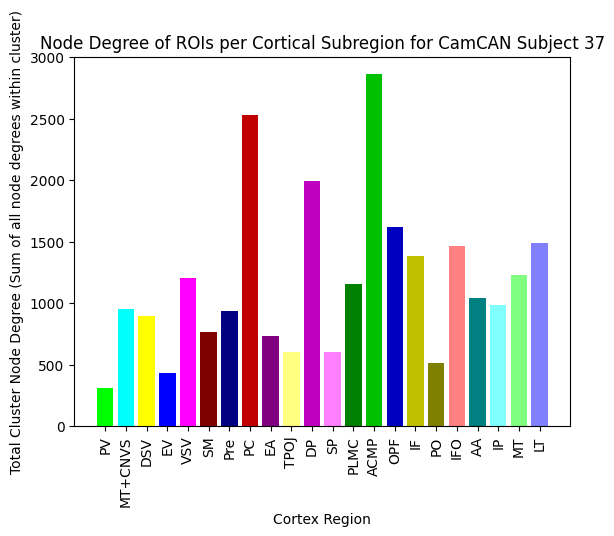

THIS IS THE SBJ ID:  38
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


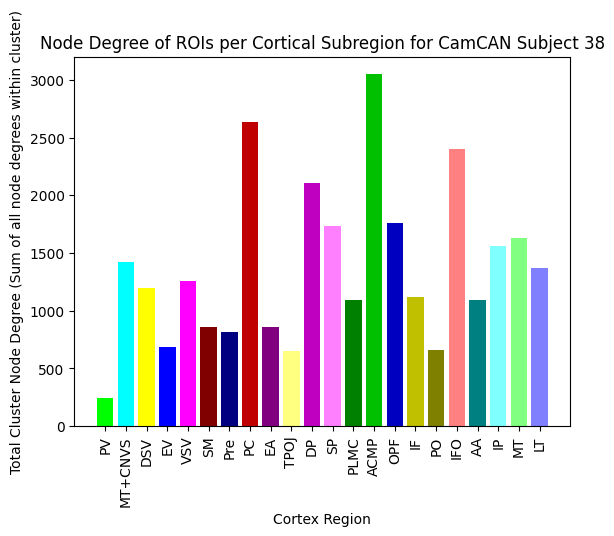

THIS IS THE SBJ ID:  39
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


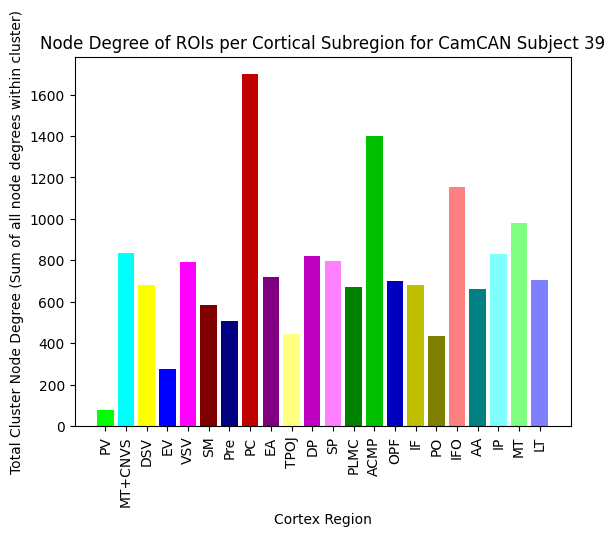

THIS IS THE SBJ ID:  40
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


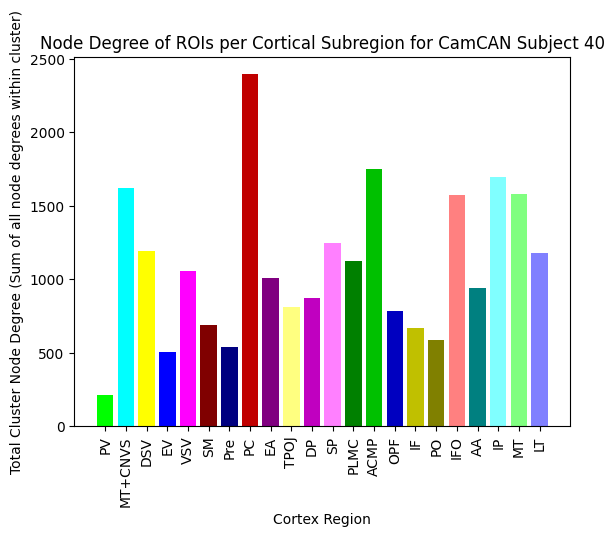

THIS IS THE SBJ ID:  41
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


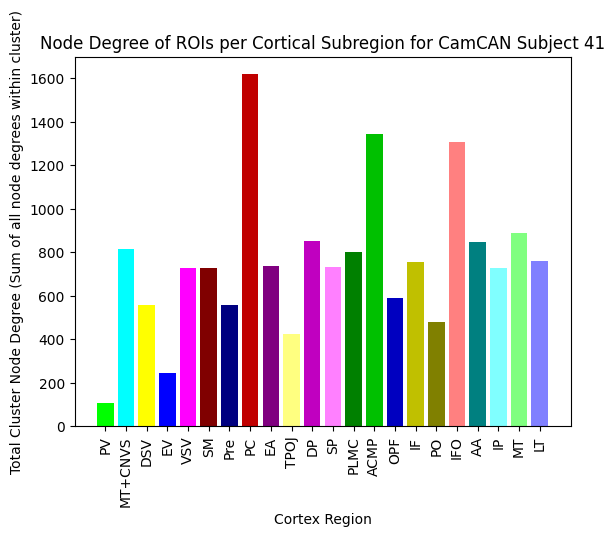

THIS IS THE SBJ ID:  42
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


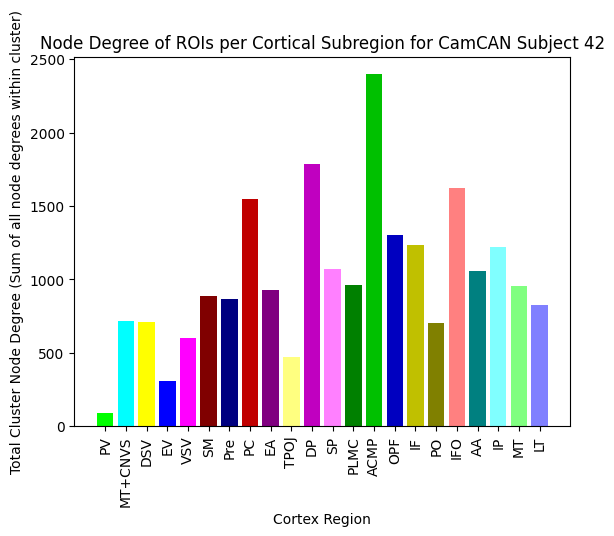

THIS IS THE SBJ ID:  43
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


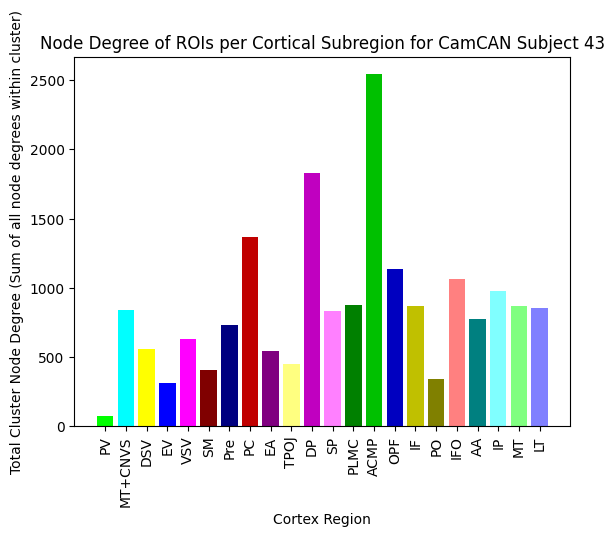

THIS IS THE SBJ ID:  44
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


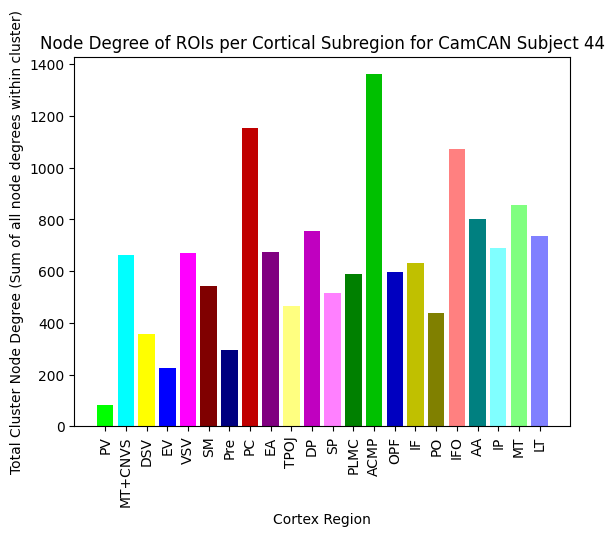

THIS IS THE SBJ ID:  45
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


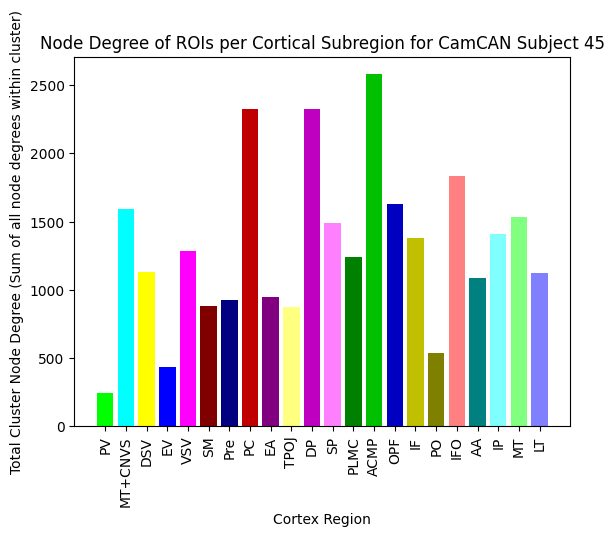

THIS IS THE SBJ ID:  46
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


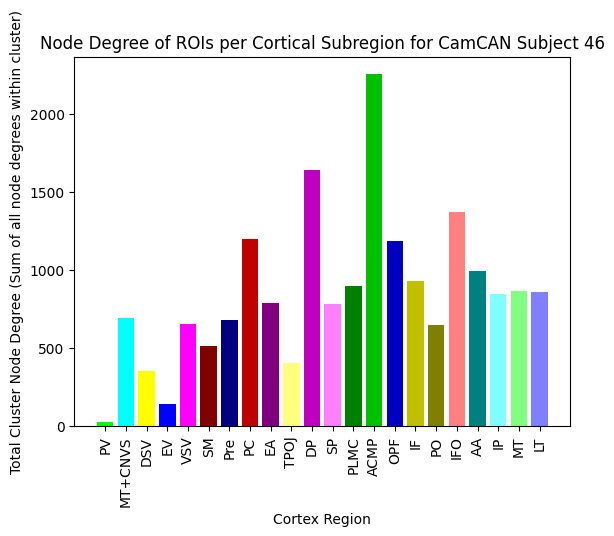

THIS IS THE SBJ ID:  47
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


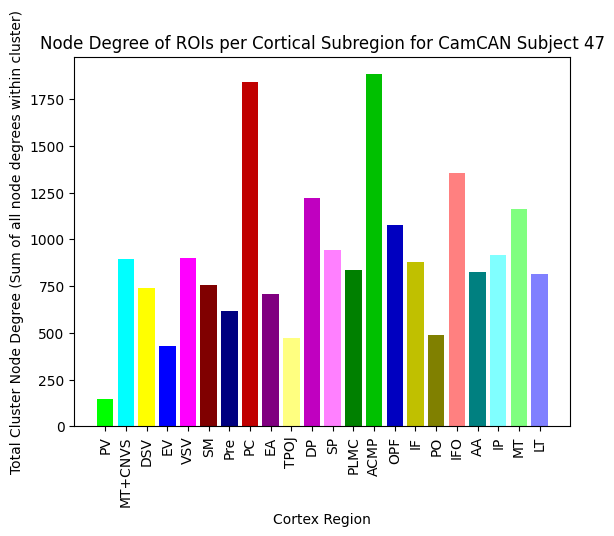

THIS IS THE SBJ ID:  48
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


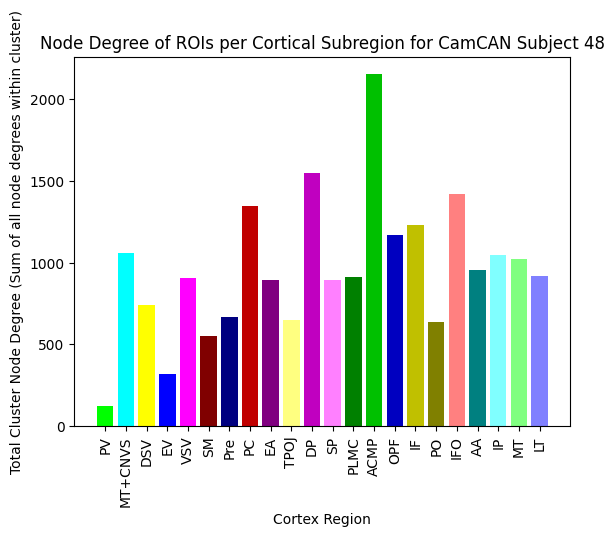

THIS IS THE SBJ ID:  49
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


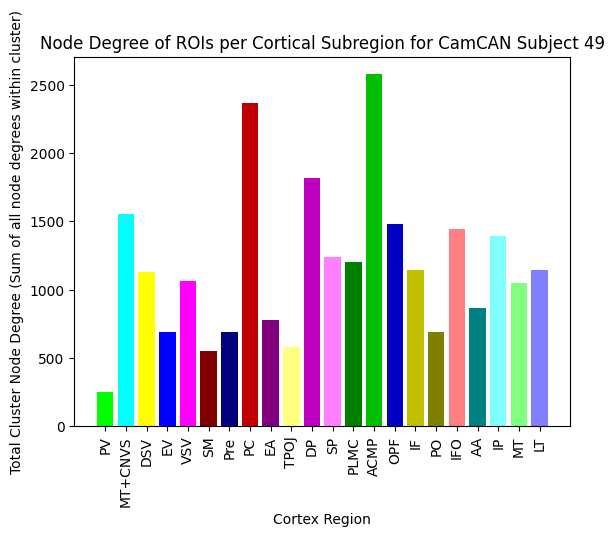

THIS IS THE SBJ ID:  50
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


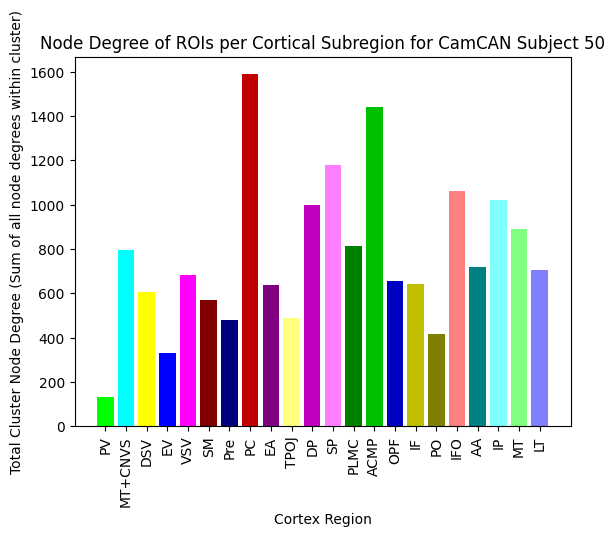

THIS IS THE SBJ ID:  51
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


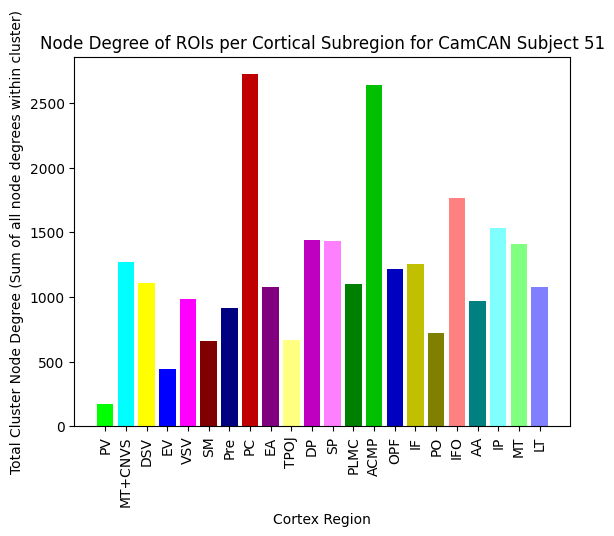

THIS IS THE SBJ ID:  52
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


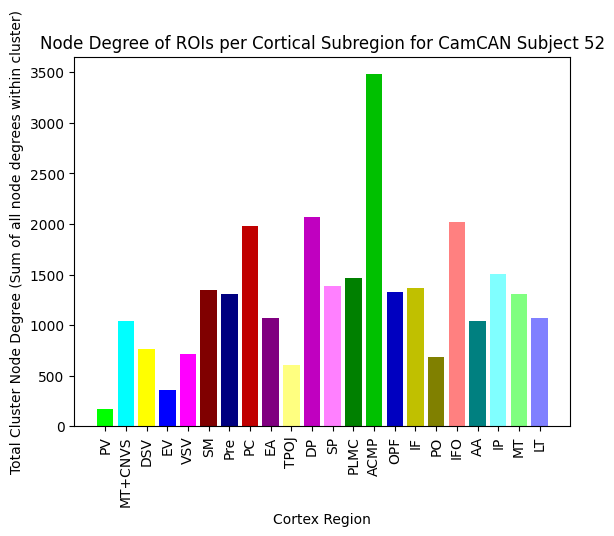

THIS IS THE SBJ ID:  53
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


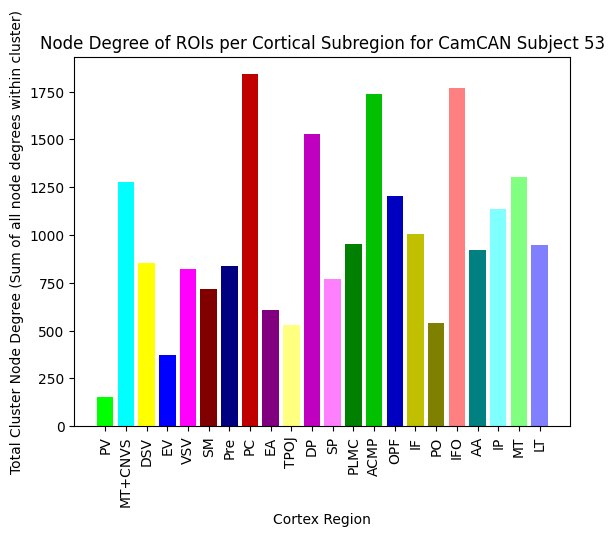

THIS IS THE SBJ ID:  54
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


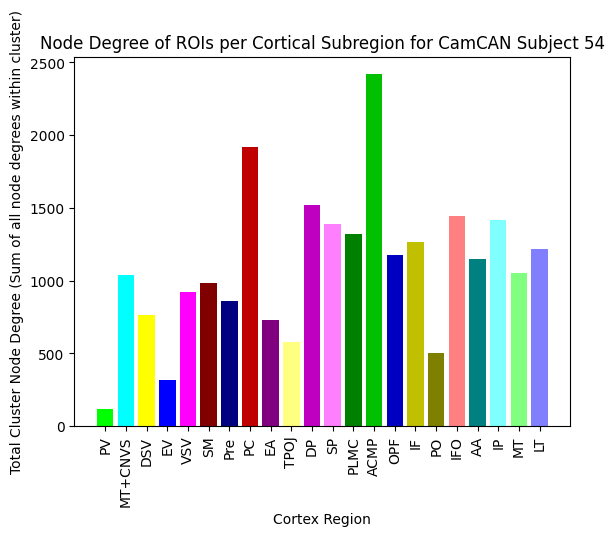

THIS IS THE SBJ ID:  55
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


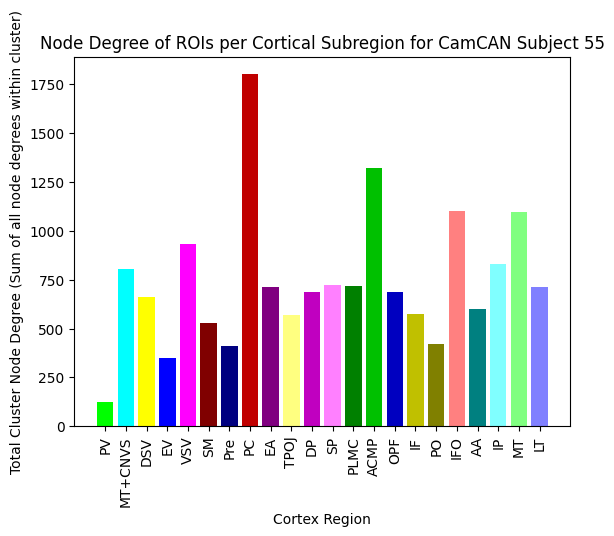

THIS IS THE SBJ ID:  56
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


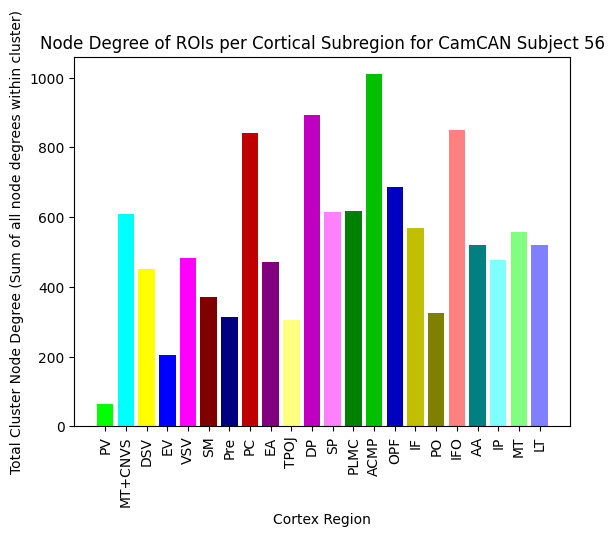

THIS IS THE SBJ ID:  57
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


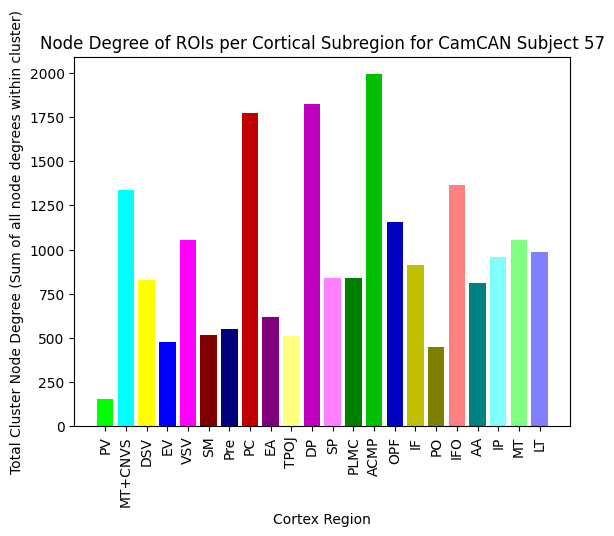

THIS IS THE SBJ ID:  58
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


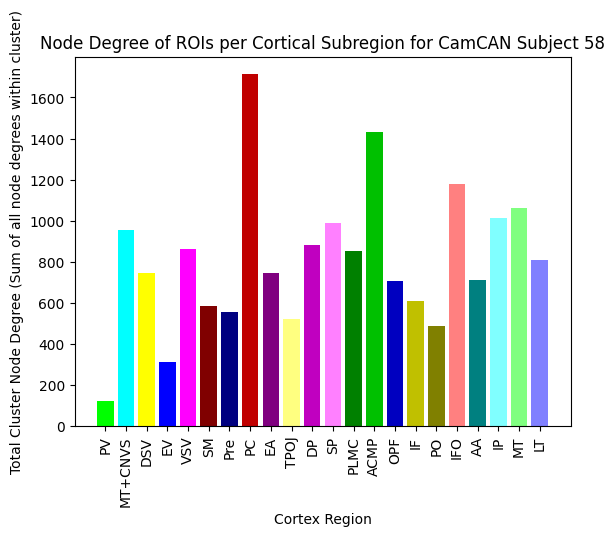

THIS IS THE SBJ ID:  59
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


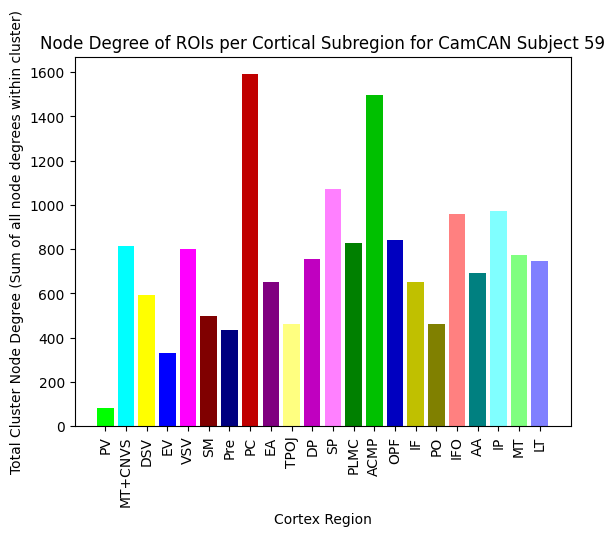

THIS IS THE SBJ ID:  60
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


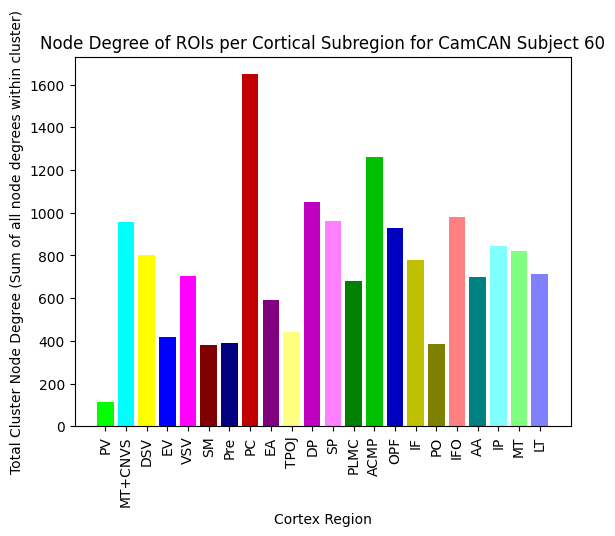

THIS IS THE SBJ ID:  61
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


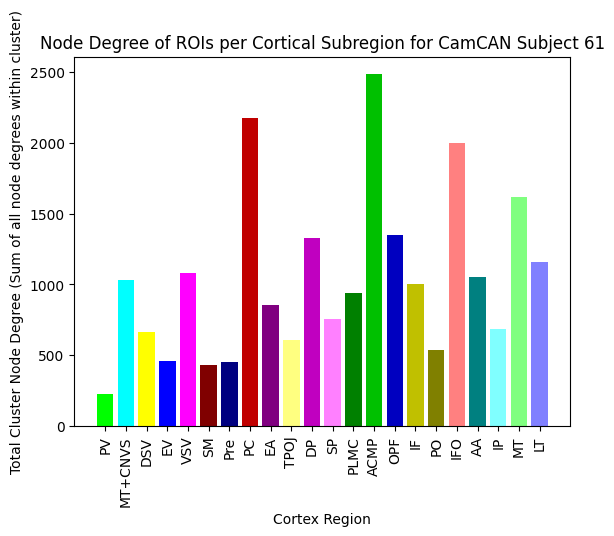

THIS IS THE SBJ ID:  62
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


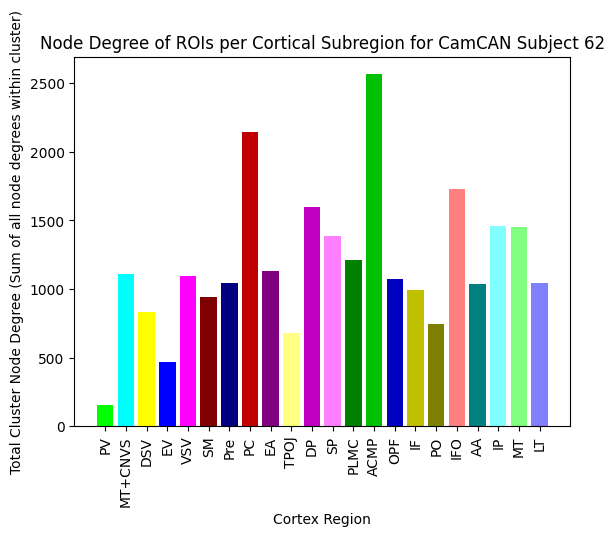

THIS IS THE SBJ ID:  63
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


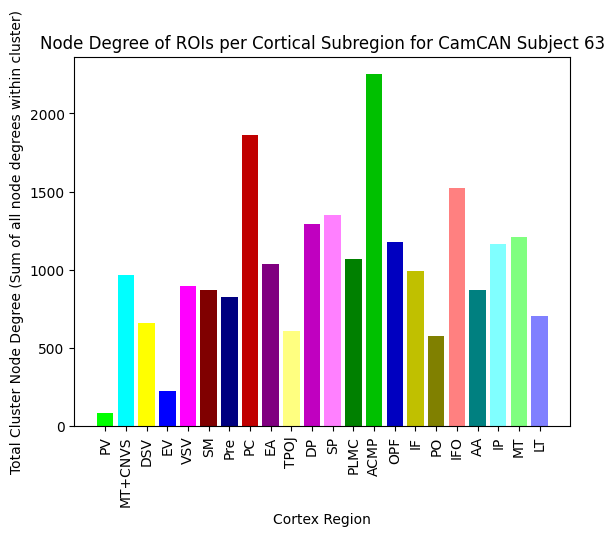

THIS IS THE SBJ ID:  64
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


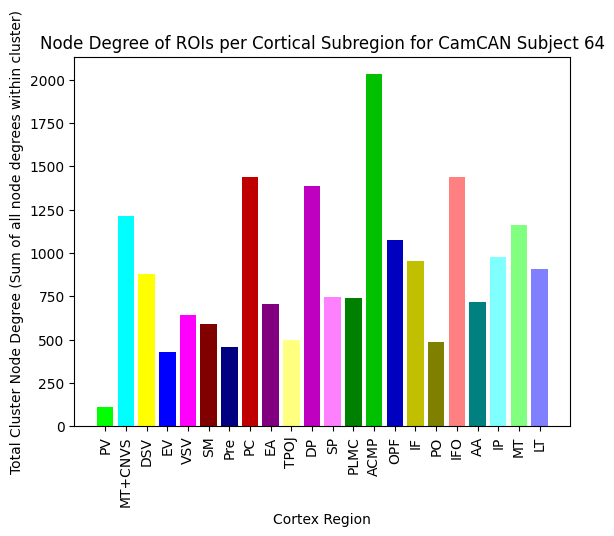

THIS IS THE SBJ ID:  65
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


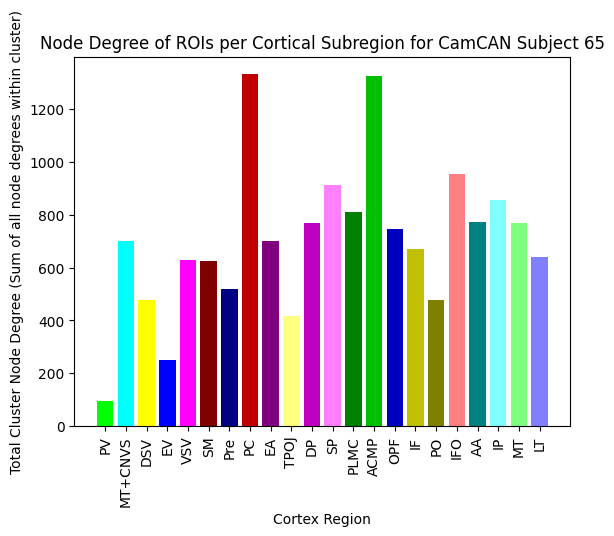

THIS IS THE SBJ ID:  66
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


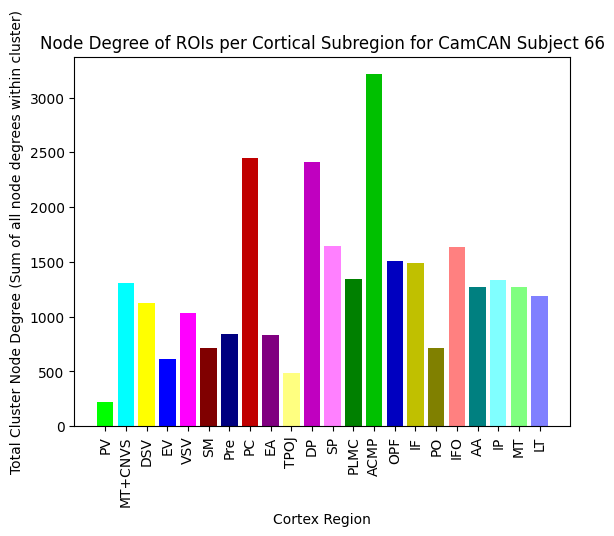

THIS IS THE SBJ ID:  67
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


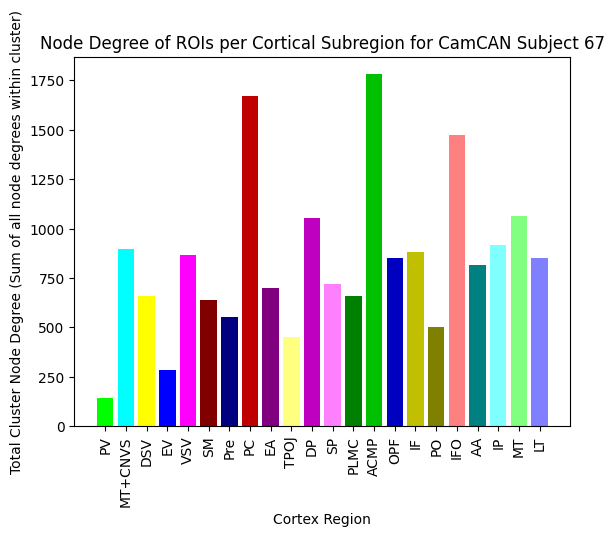

THIS IS THE SBJ ID:  68
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


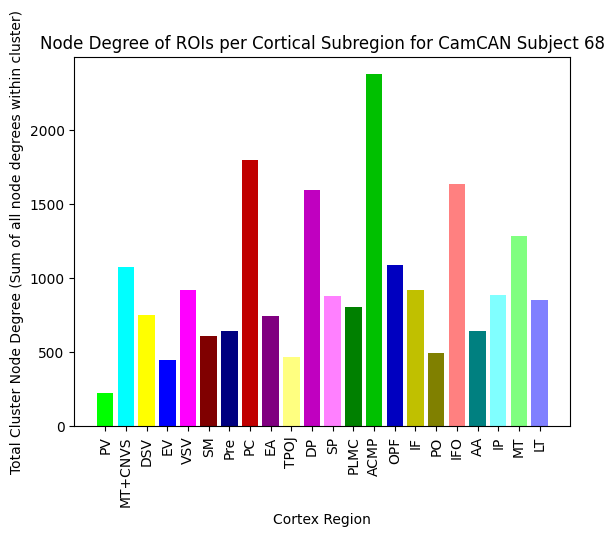

THIS IS THE SBJ ID:  69
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


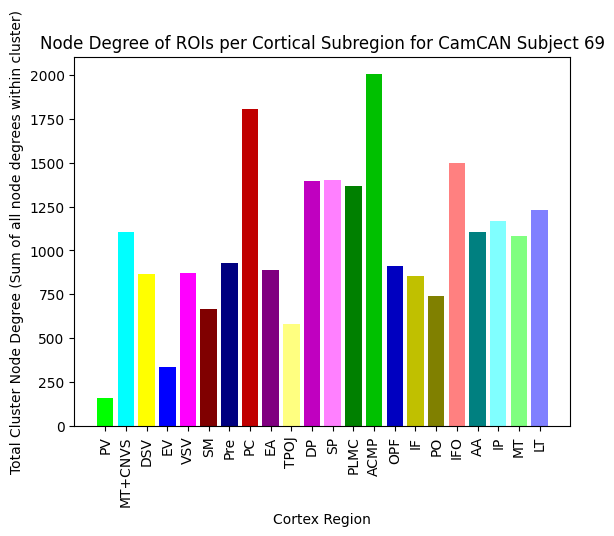

THIS IS THE SBJ ID:  70
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


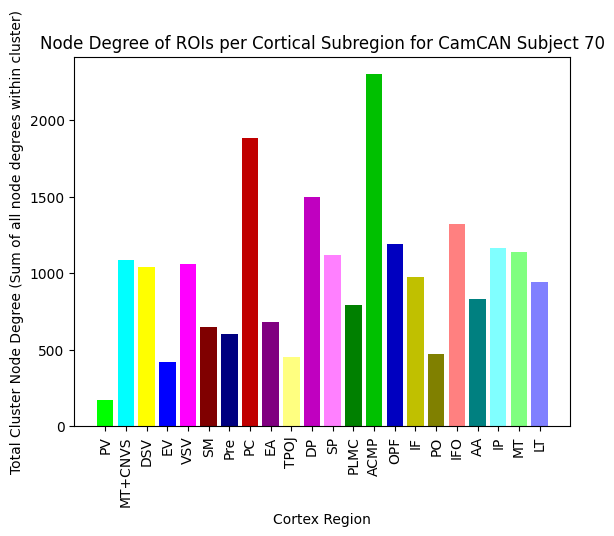

THIS IS THE SBJ ID:  71
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


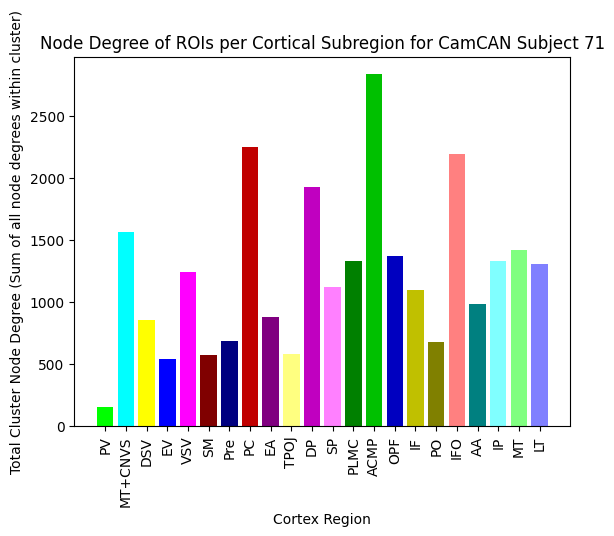

THIS IS THE SBJ ID:  72
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


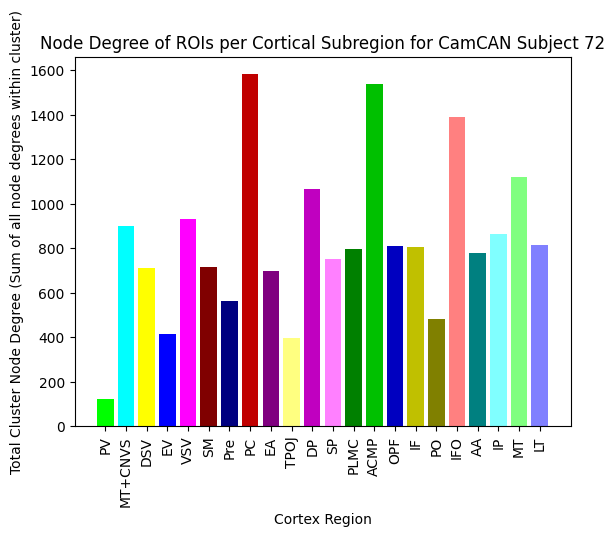

THIS IS THE SBJ ID:  73
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


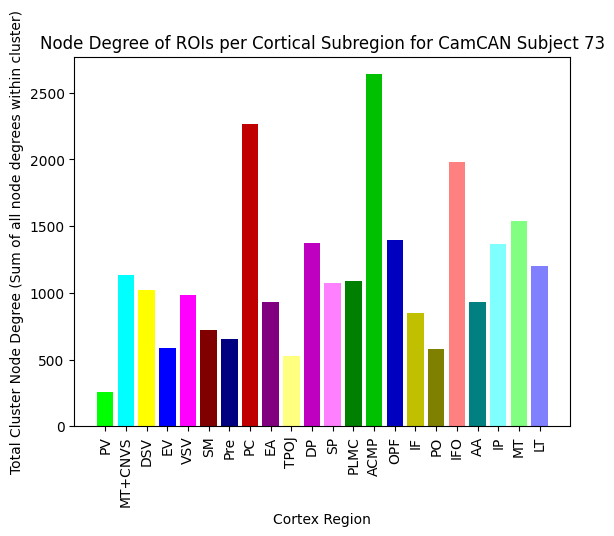

THIS IS THE SBJ ID:  74
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


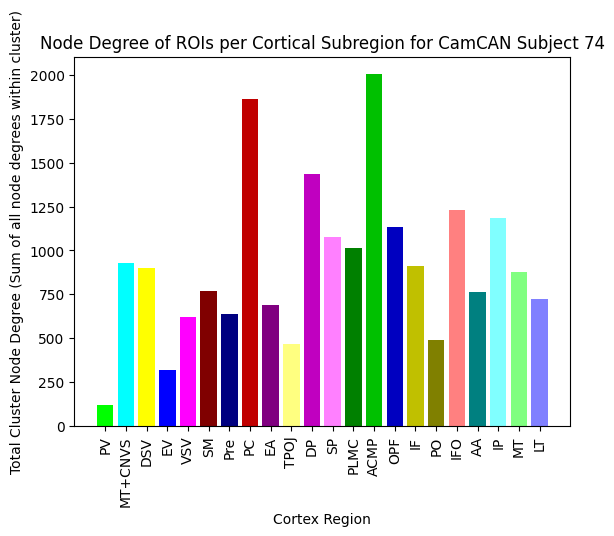

THIS IS THE SBJ ID:  75
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


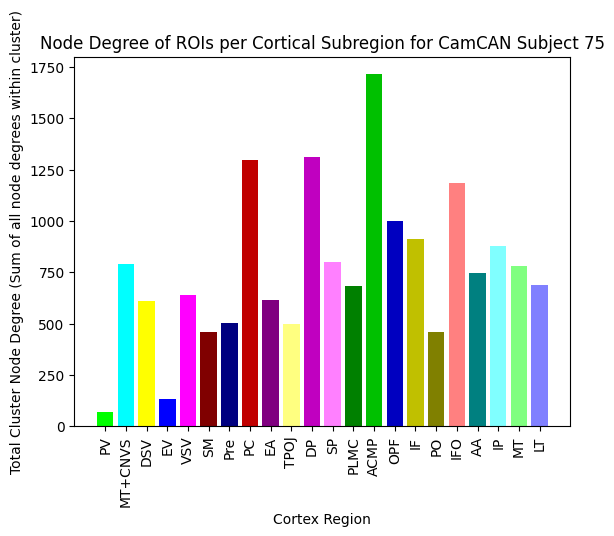

THIS IS THE SBJ ID:  76
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


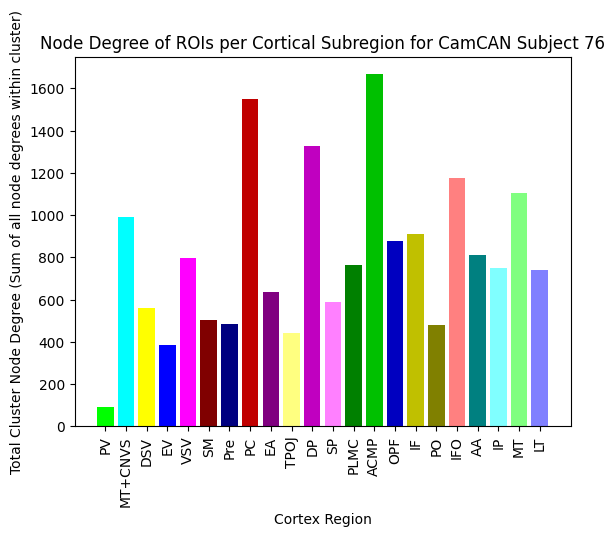

THIS IS THE SBJ ID:  77
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


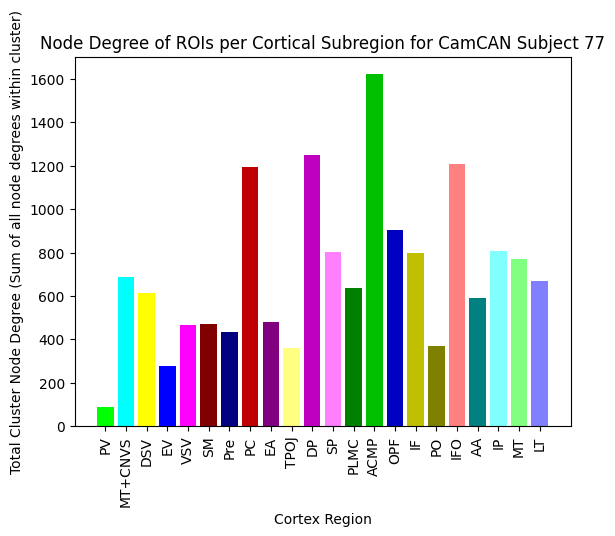

THIS IS THE SBJ ID:  78
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


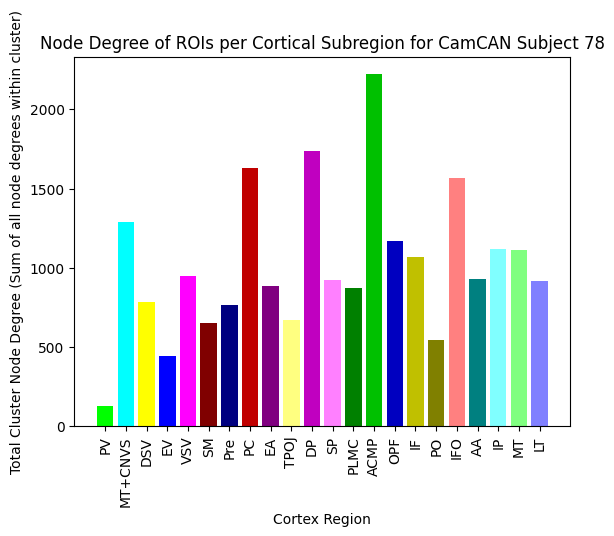

THIS IS THE SBJ ID:  79
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


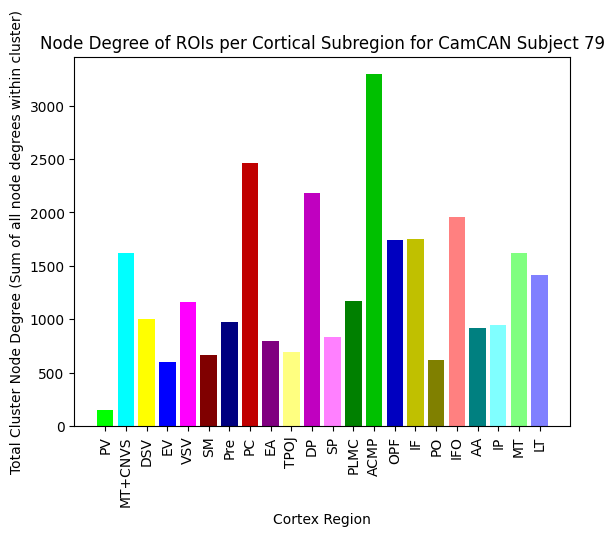

THIS IS THE SBJ ID:  80
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


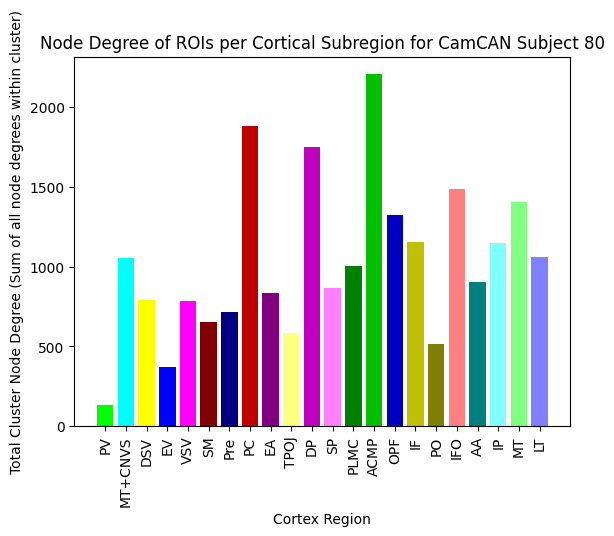

THIS IS THE SBJ ID:  81
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


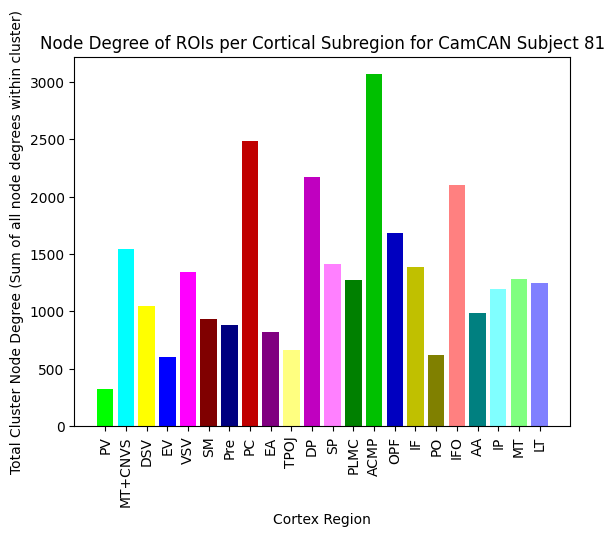

THIS IS THE SBJ ID:  82
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


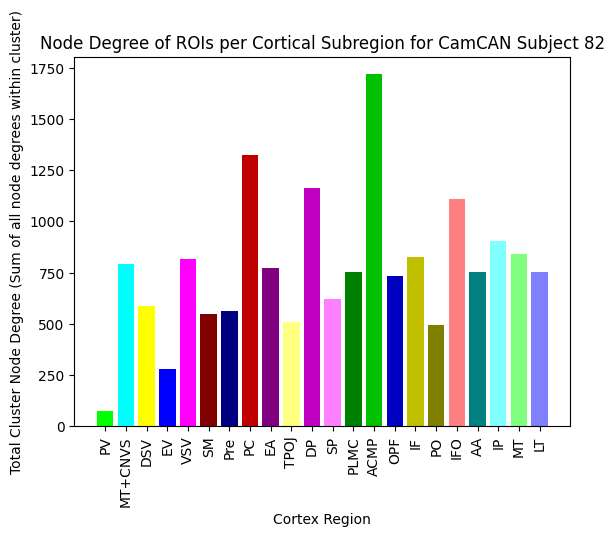

THIS IS THE SBJ ID:  83
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


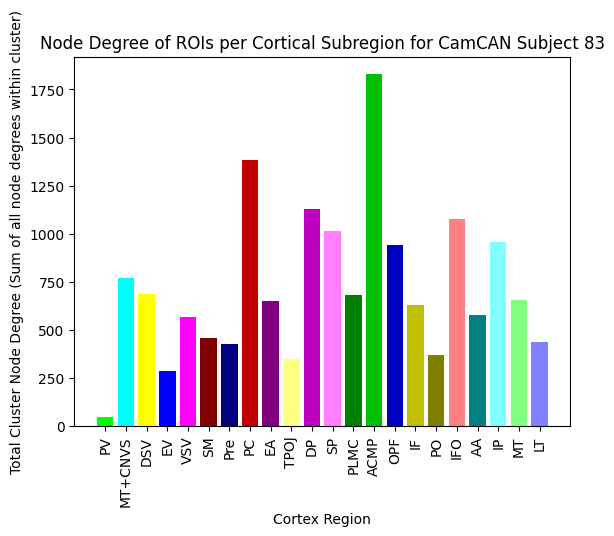

THIS IS THE SBJ ID:  84
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


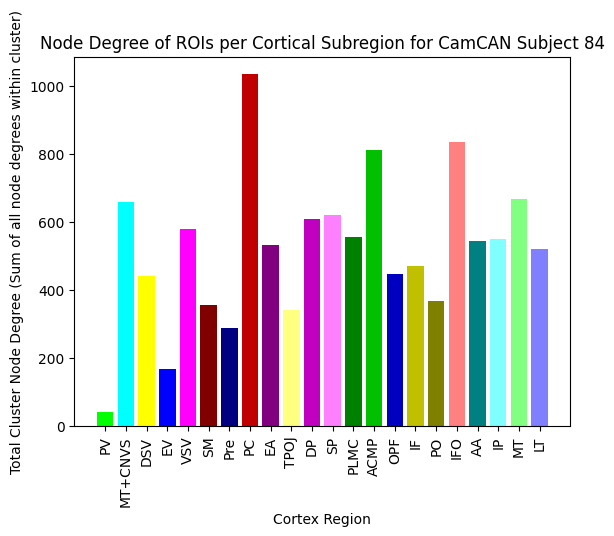

THIS IS THE SBJ ID:  85
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


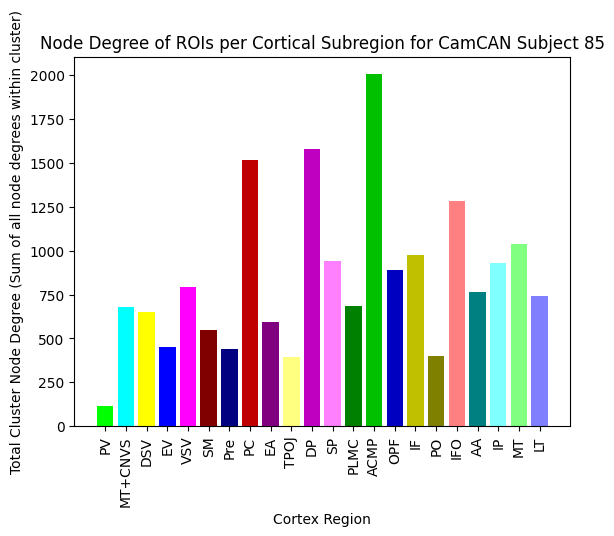

THIS IS THE SBJ ID:  86
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


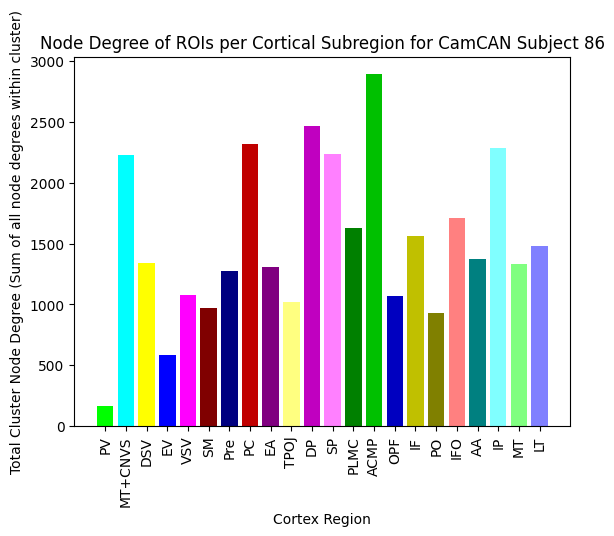

THIS IS THE SBJ ID:  87
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


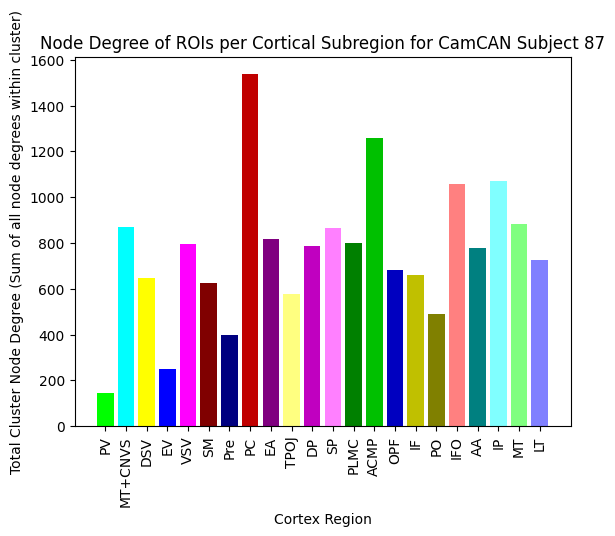

THIS IS THE SBJ ID:  88
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


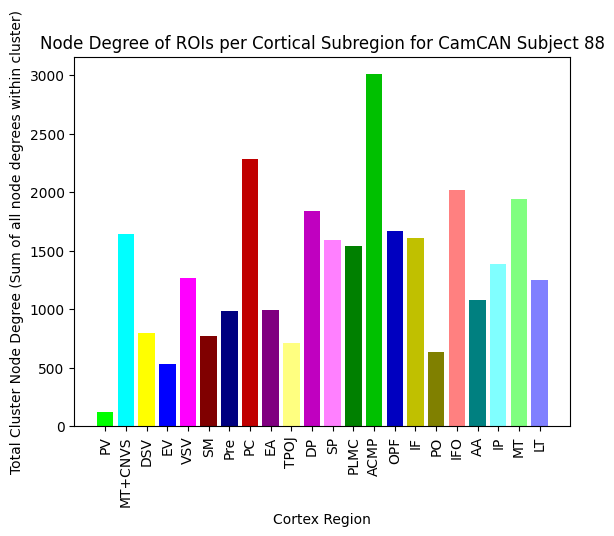

THIS IS THE SBJ ID:  89
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


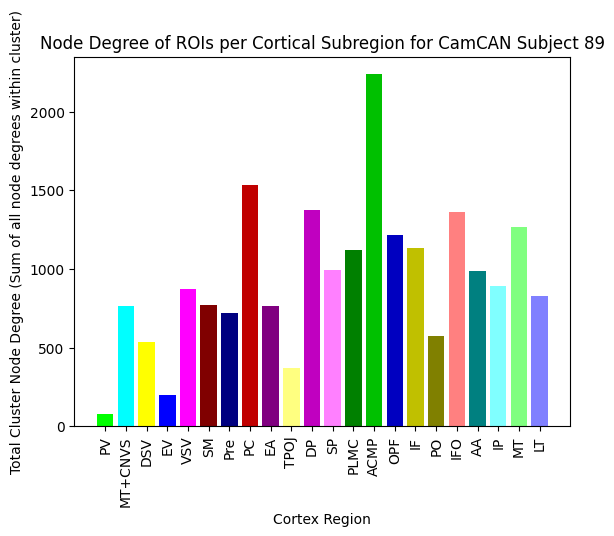

THIS IS THE SBJ ID:  90
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


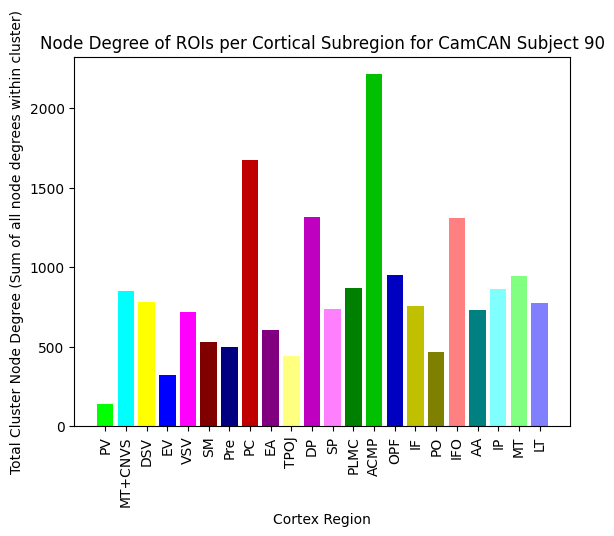

THIS IS THE SBJ ID:  91
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


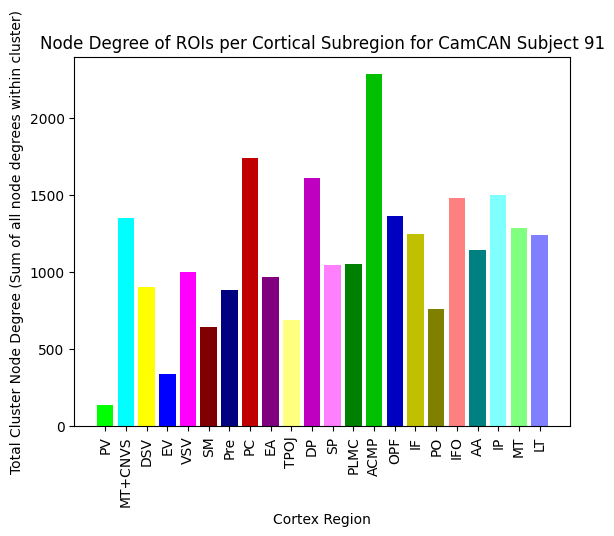

THIS IS THE SBJ ID:  92
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


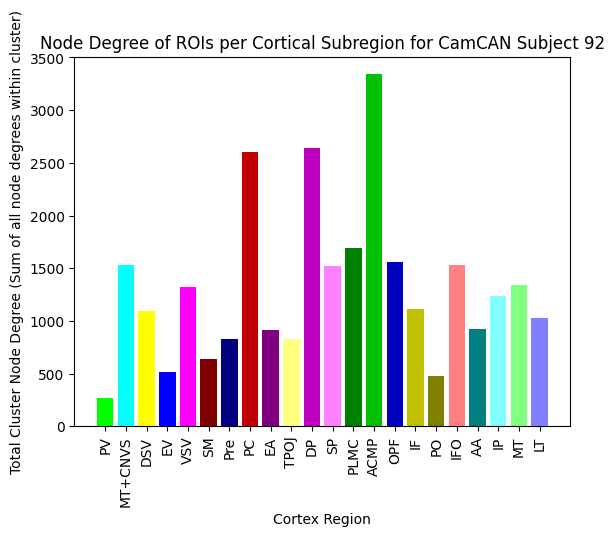

THIS IS THE SBJ ID:  93
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


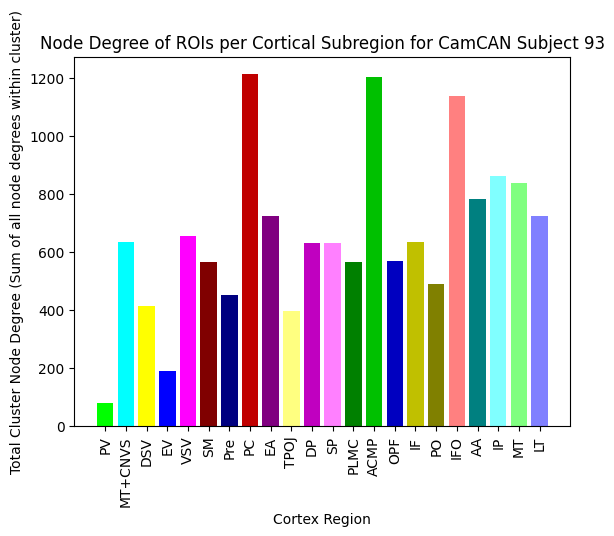

THIS IS THE SBJ ID:  94
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


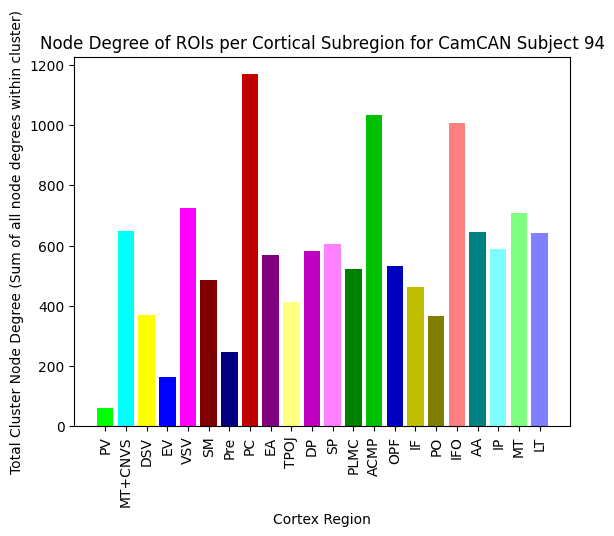

THIS IS THE SBJ ID:  95
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


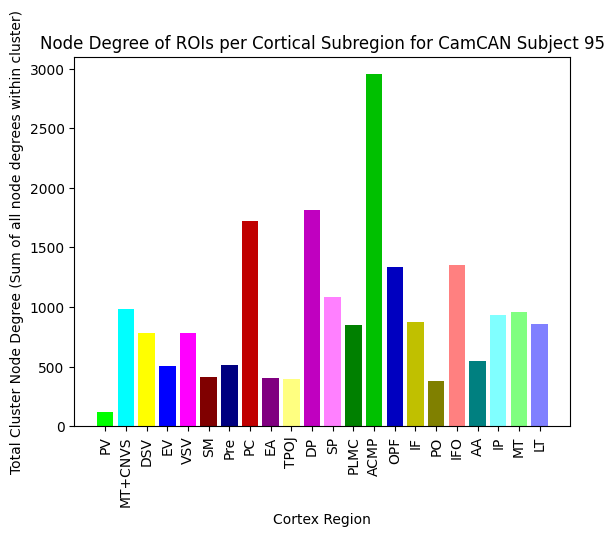

THIS IS THE SBJ ID:  96
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


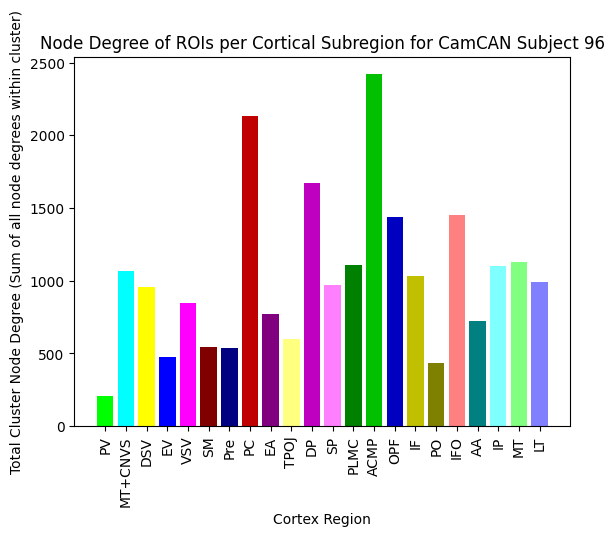

THIS IS THE SBJ ID:  97
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


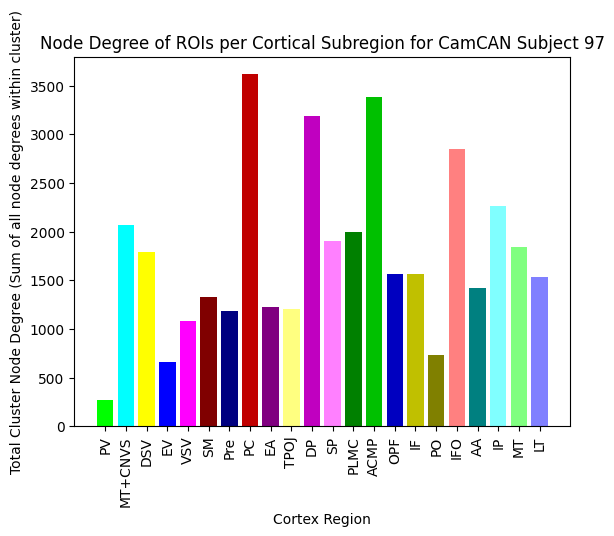

THIS IS THE SBJ ID:  98
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


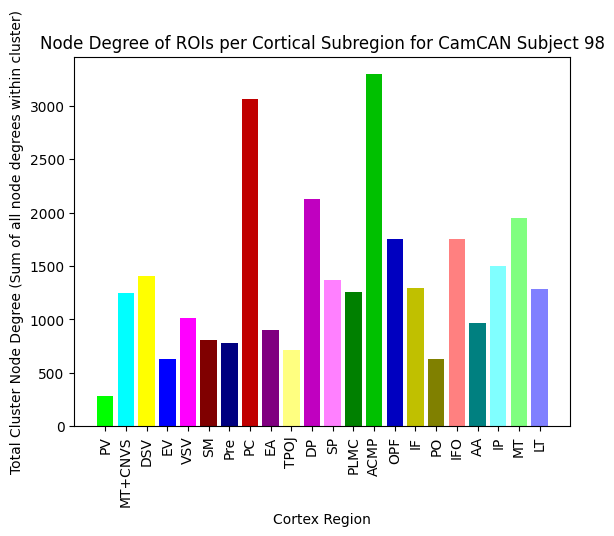

THIS IS THE SBJ ID:  99
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


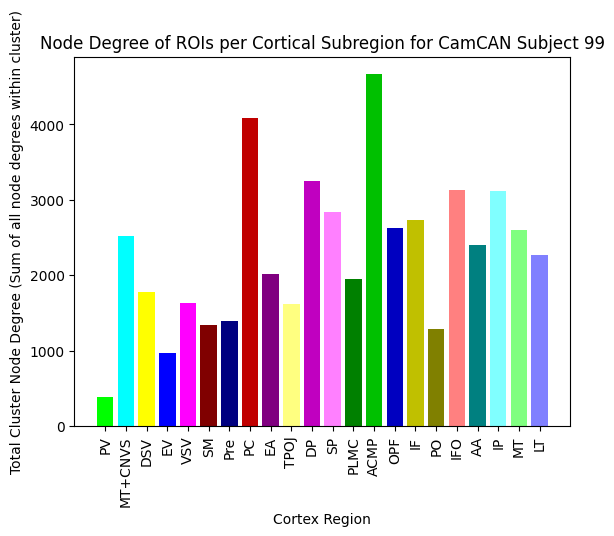

THIS IS THE SBJ ID:  100
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


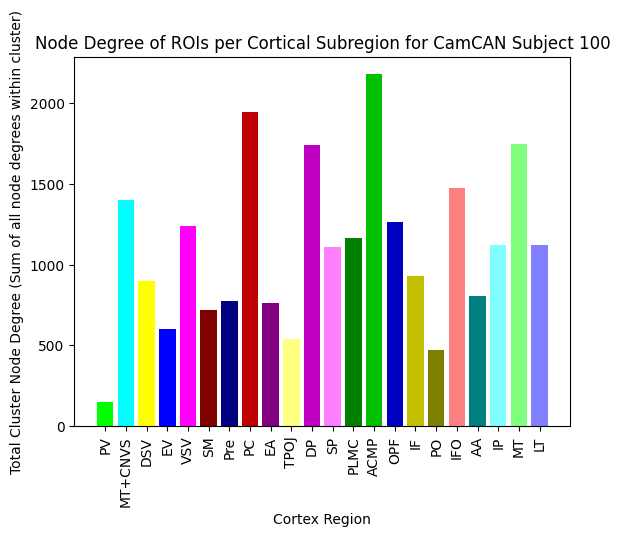

THIS IS THE SBJ ID:  101
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


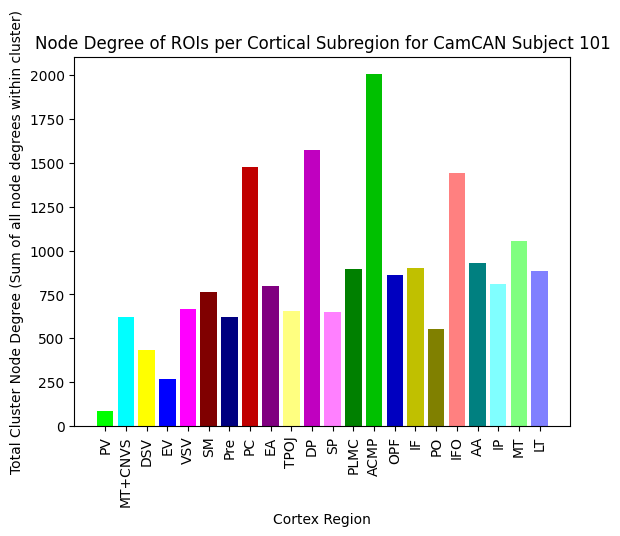

THIS IS THE SBJ ID:  102
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


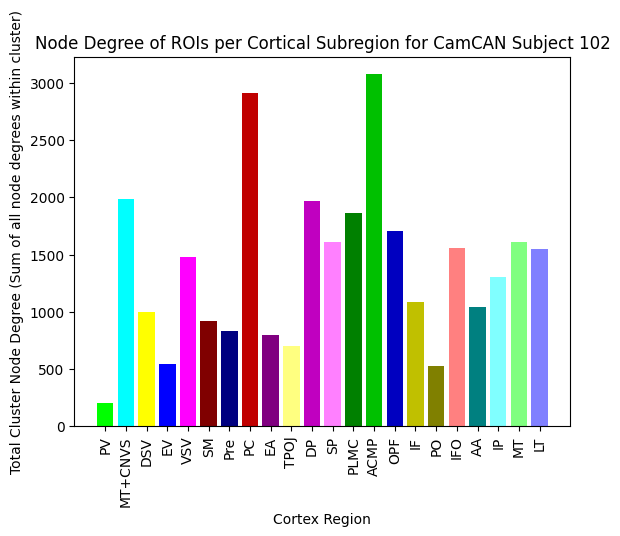

THIS IS THE SBJ ID:  103
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


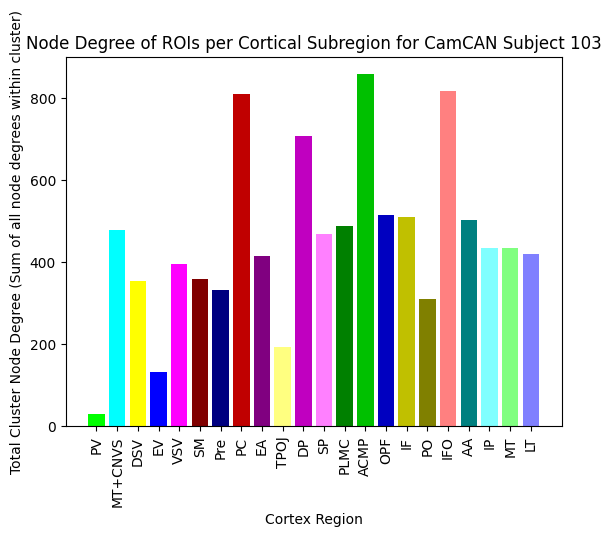

THIS IS THE SBJ ID:  104
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


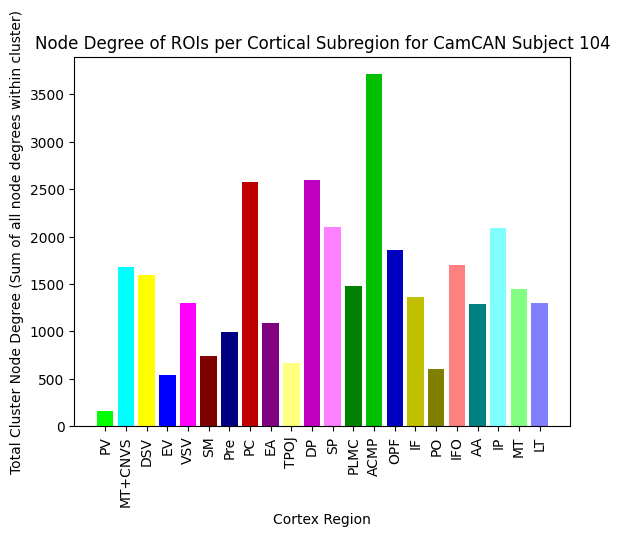

THIS IS THE SBJ ID:  105
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


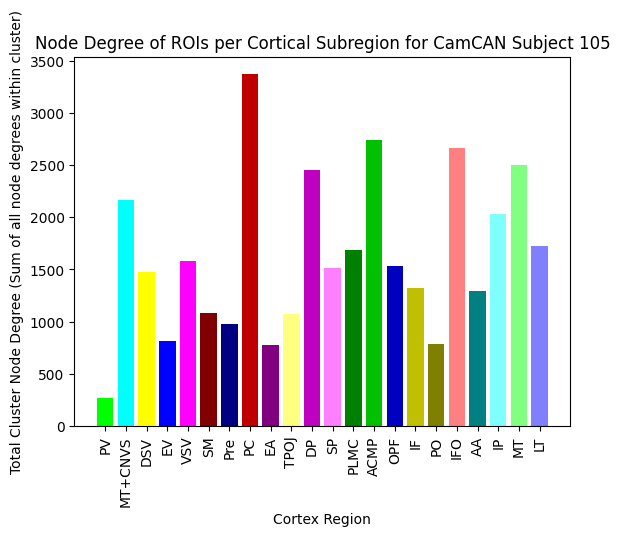

THIS IS THE SBJ ID:  106
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


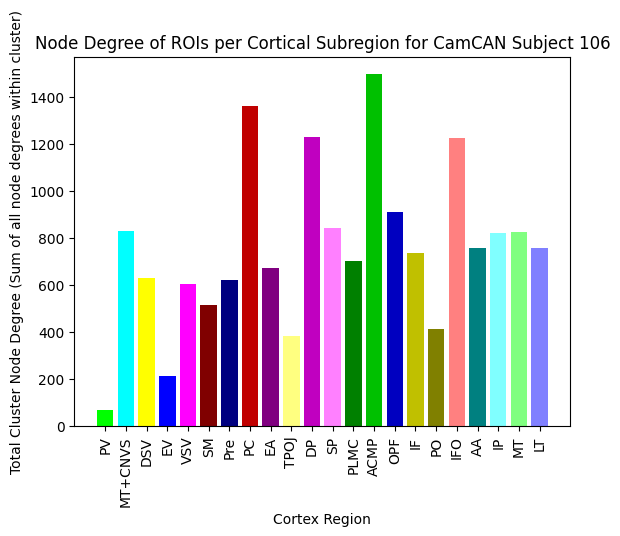

THIS IS THE SBJ ID:  107
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


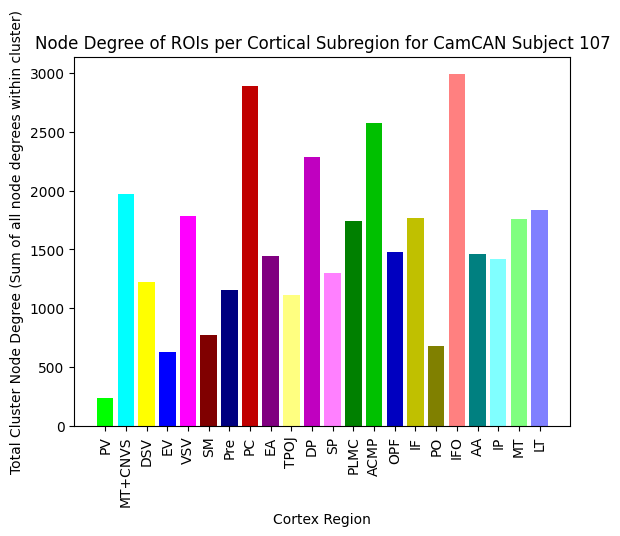

THIS IS THE SBJ ID:  108
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


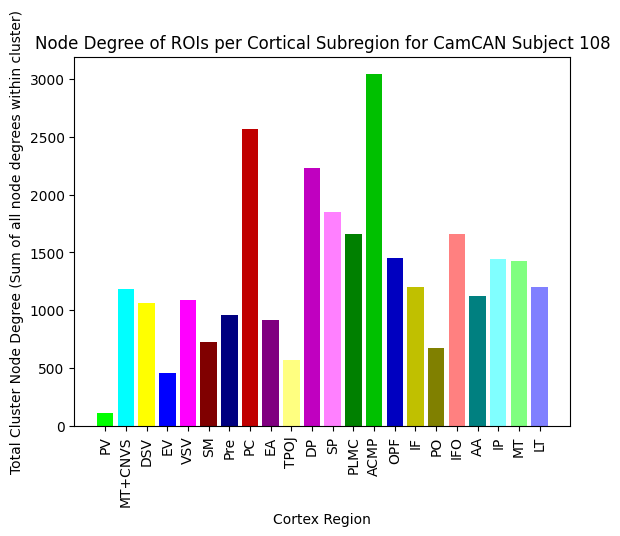

THIS IS THE SBJ ID:  109
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


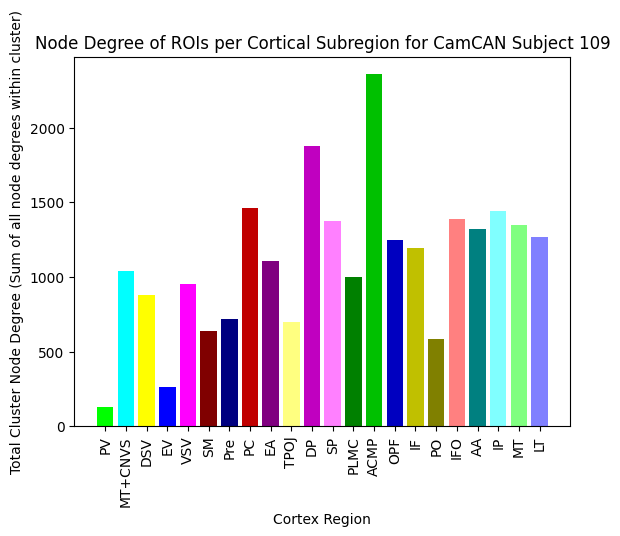

THIS IS THE SBJ ID:  110
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


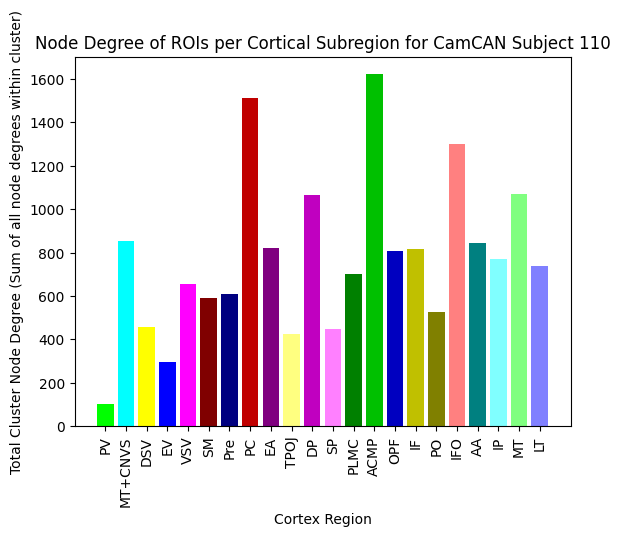

THIS IS THE SBJ ID:  111
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


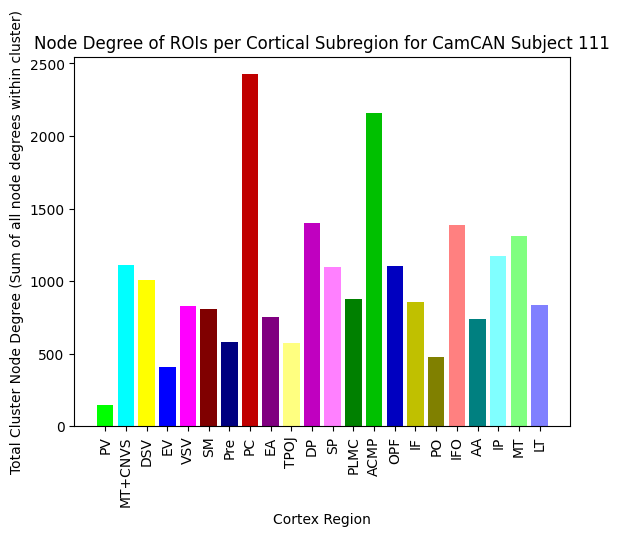

THIS IS THE SBJ ID:  112
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


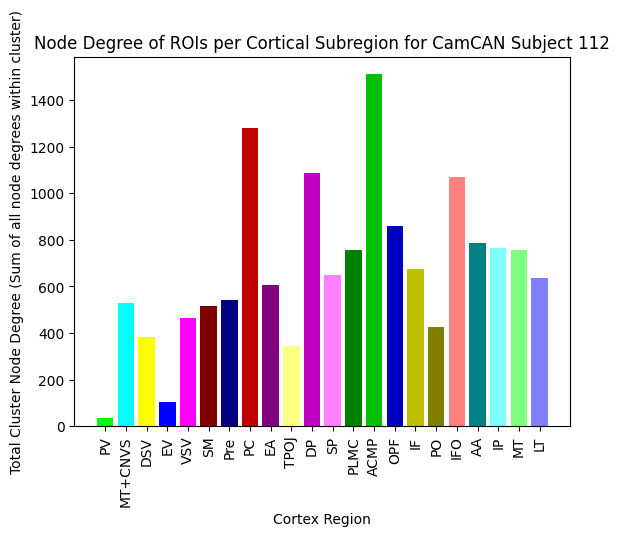

THIS IS THE SBJ ID:  113
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


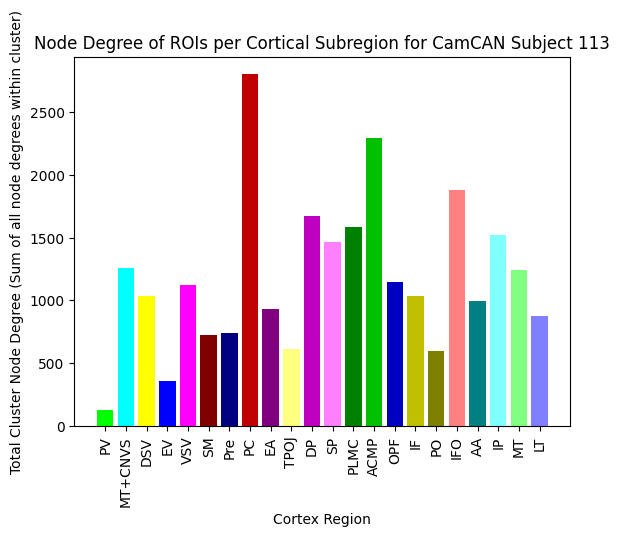

THIS IS THE SBJ ID:  114
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


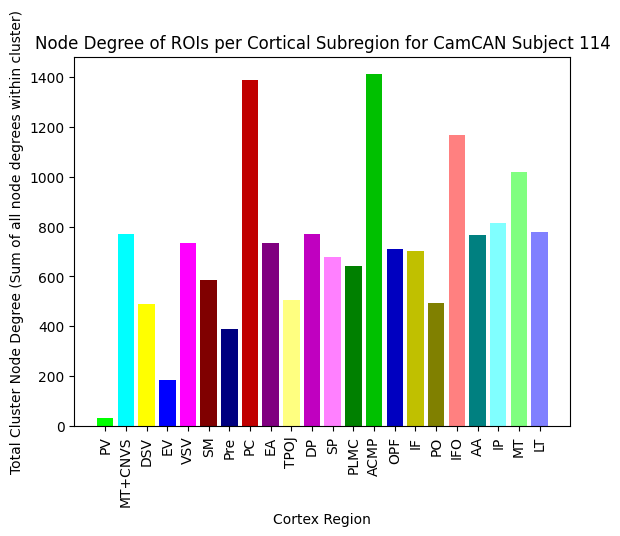

THIS IS THE SBJ ID:  115
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


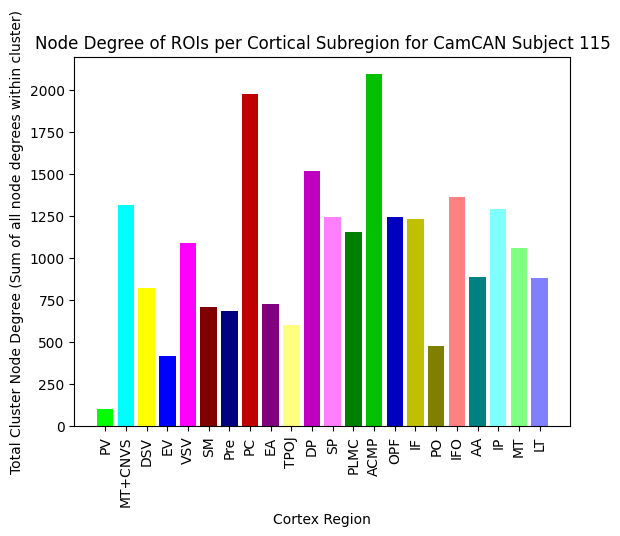

THIS IS THE SBJ ID:  116
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


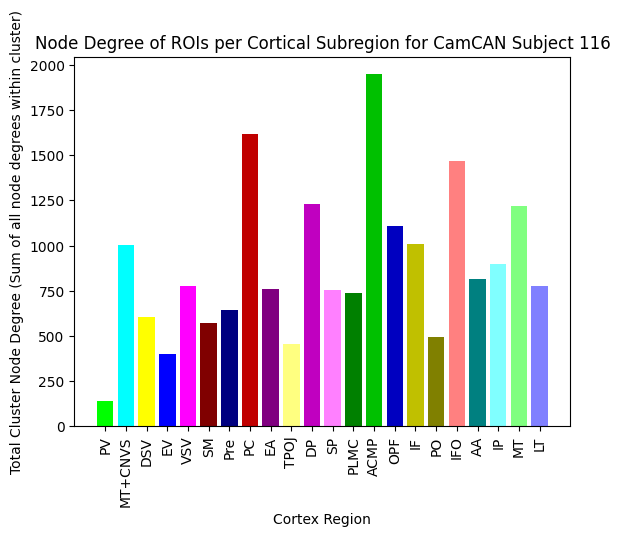

THIS IS THE SBJ ID:  117
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


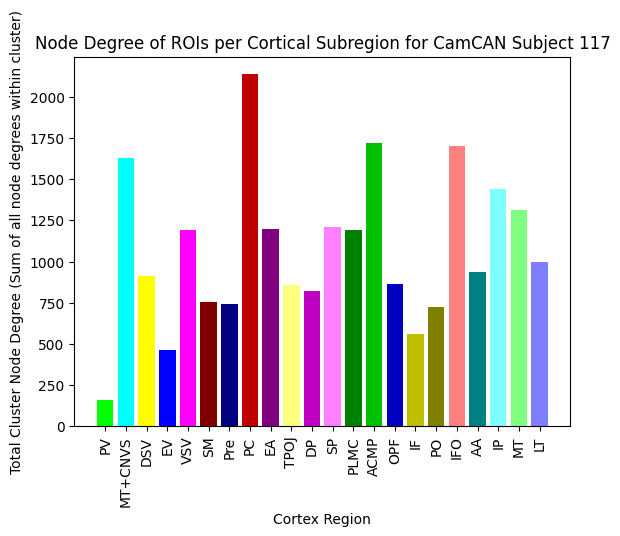

THIS IS THE SBJ ID:  118
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


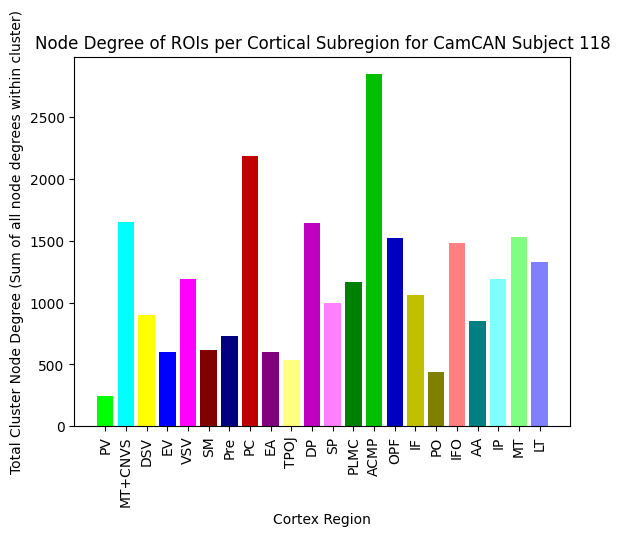

THIS IS THE SBJ ID:  119
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


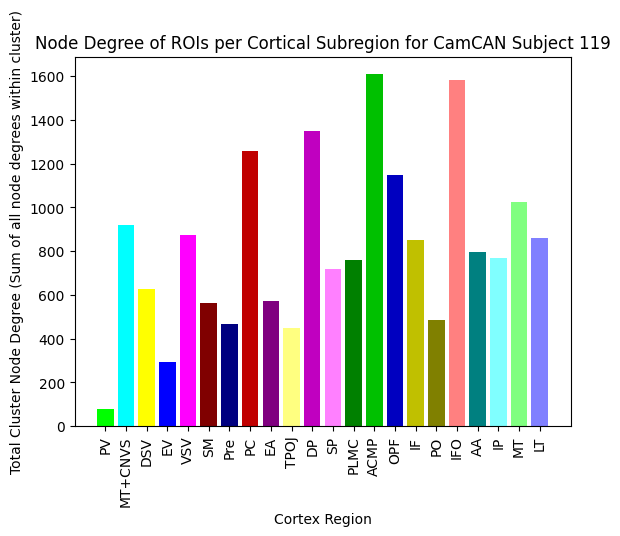

THIS IS THE SBJ ID:  120
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


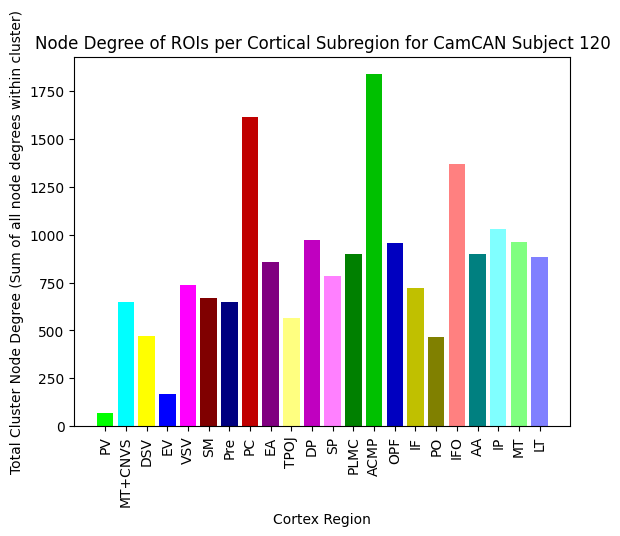

THIS IS THE SBJ ID:  121
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


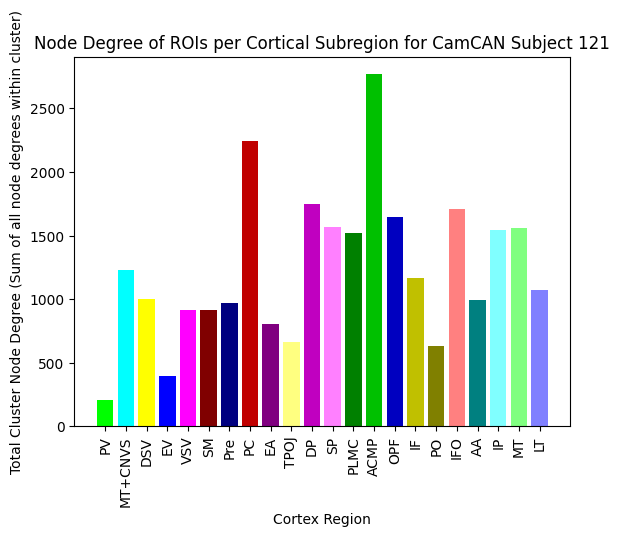

THIS IS THE SBJ ID:  122
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


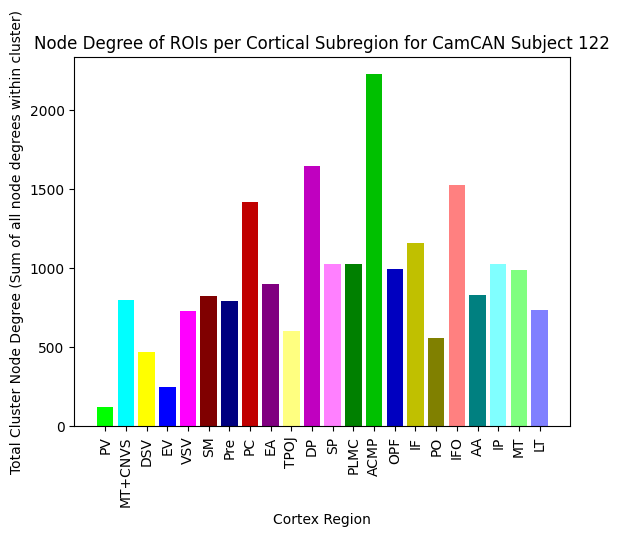

THIS IS THE SBJ ID:  123
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


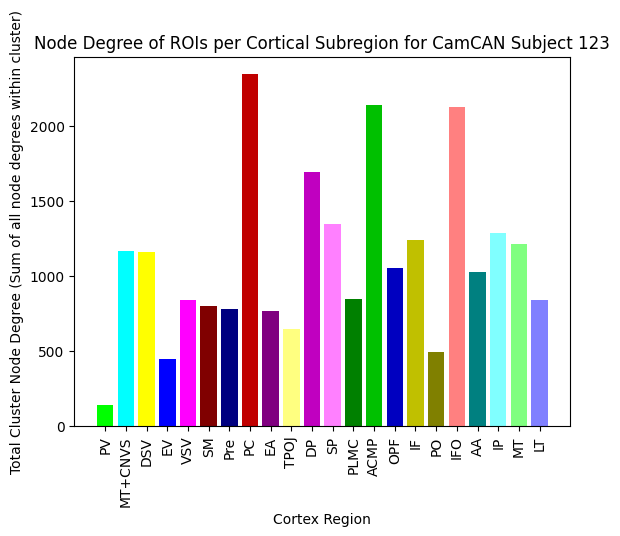

THIS IS THE SBJ ID:  124
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


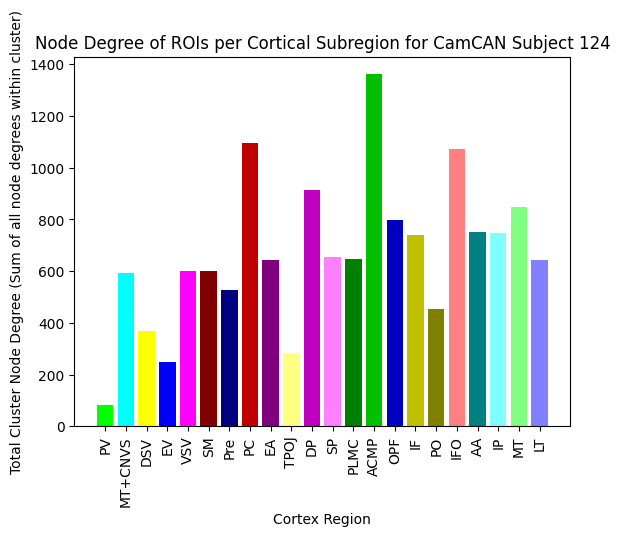

THIS IS THE SBJ ID:  125
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


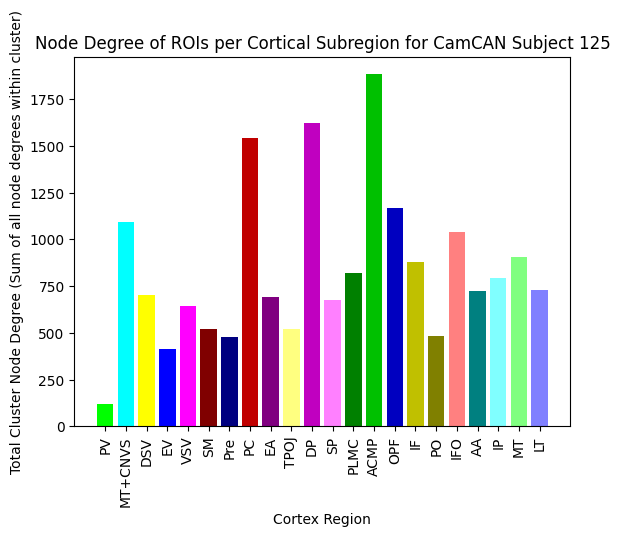

THIS IS THE SBJ ID:  126
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


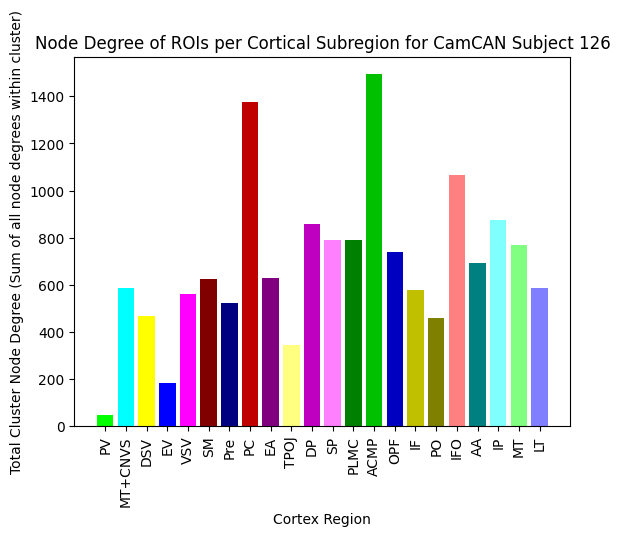

THIS IS THE SBJ ID:  127
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


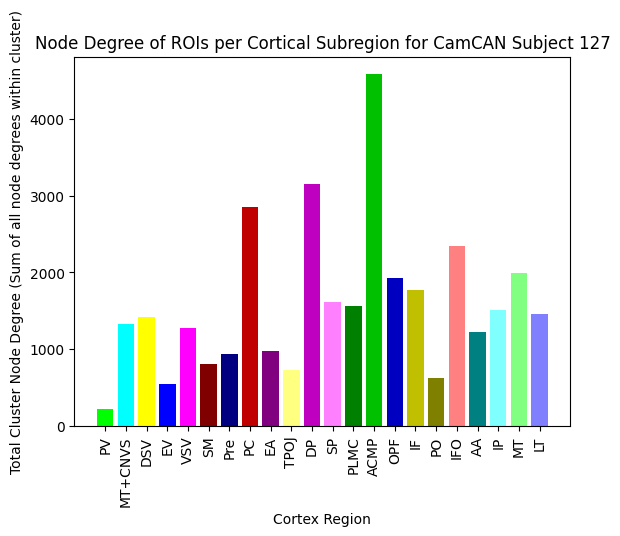

THIS IS THE SBJ ID:  128
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


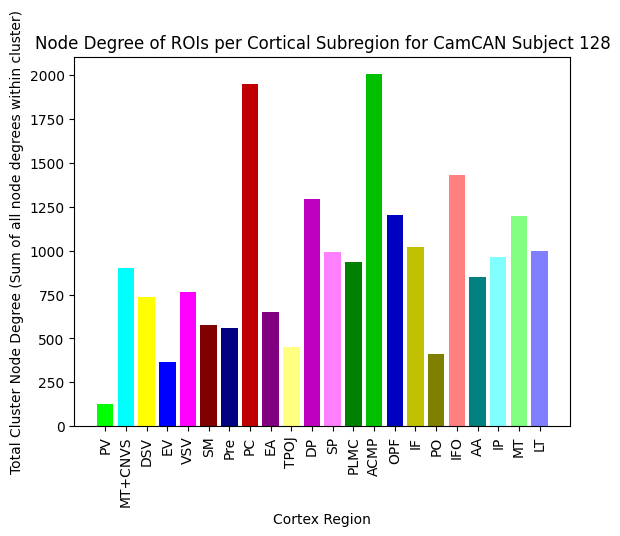

THIS IS THE SBJ ID:  129
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


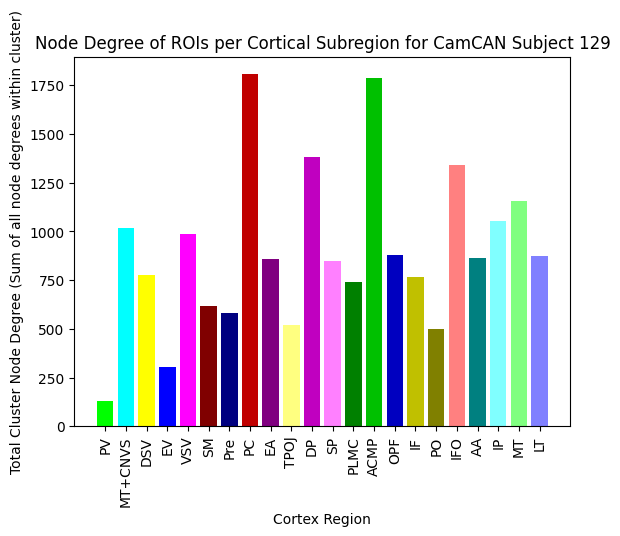

THIS IS THE SBJ ID:  130
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


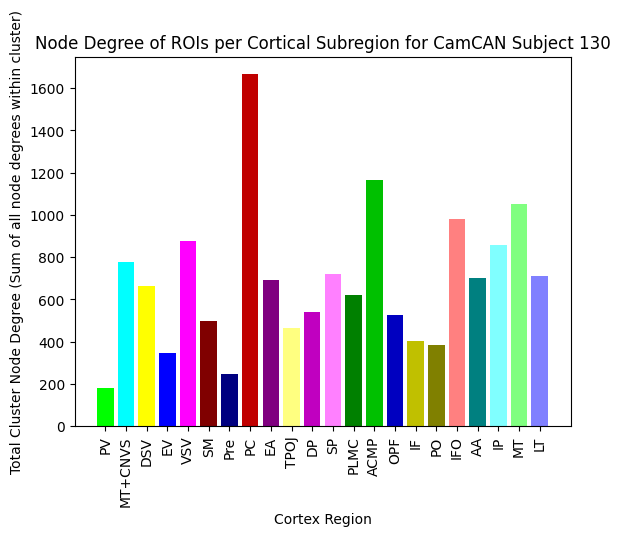

THIS IS THE SBJ ID:  131
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


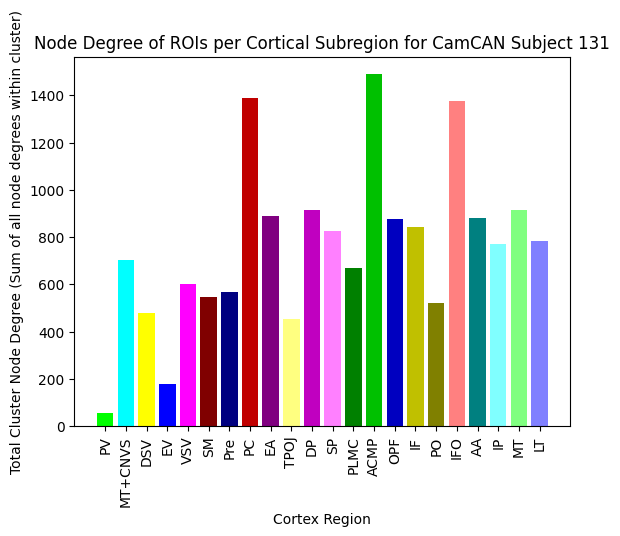

THIS IS THE SBJ ID:  132
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


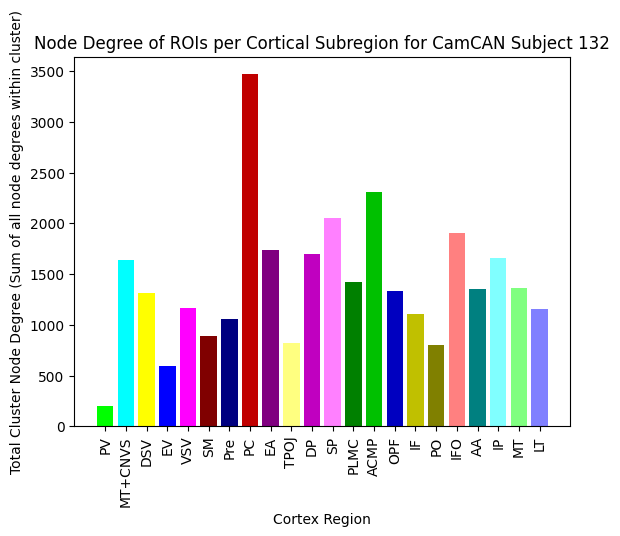

THIS IS THE SBJ ID:  133
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


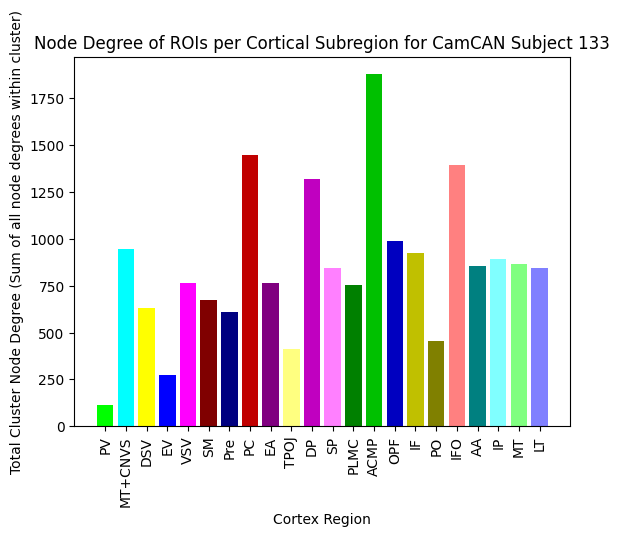

THIS IS THE SBJ ID:  134
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


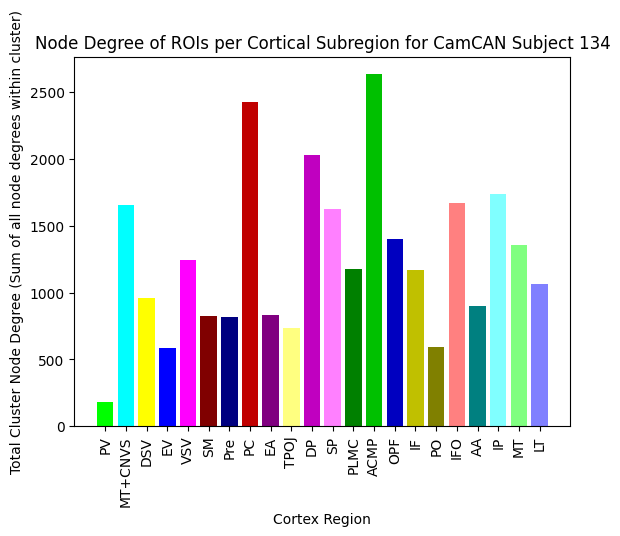

THIS IS THE SBJ ID:  135
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


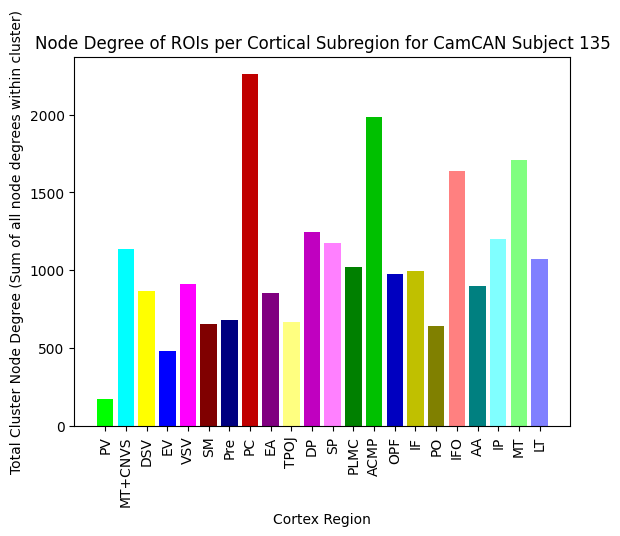

THIS IS THE SBJ ID:  136
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


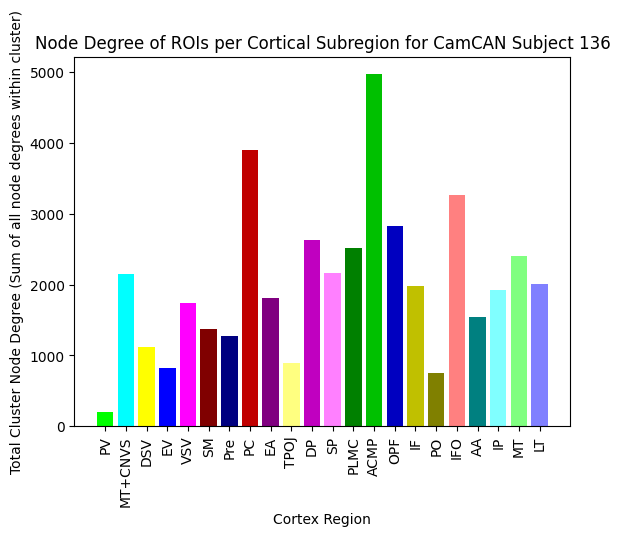

THIS IS THE SBJ ID:  137
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


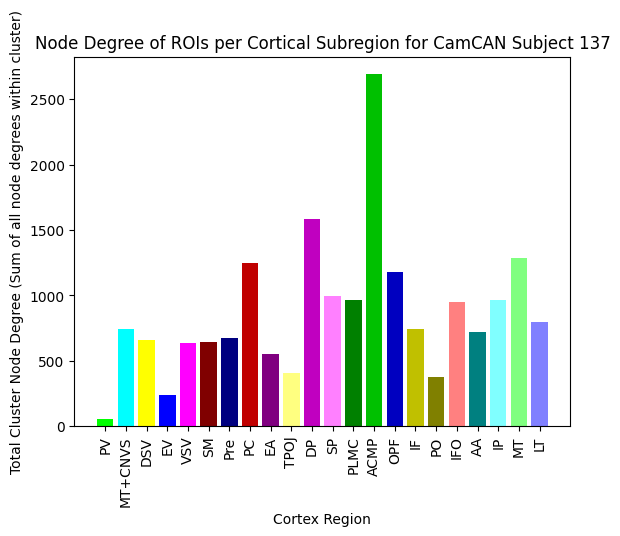

THIS IS THE SBJ ID:  138
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


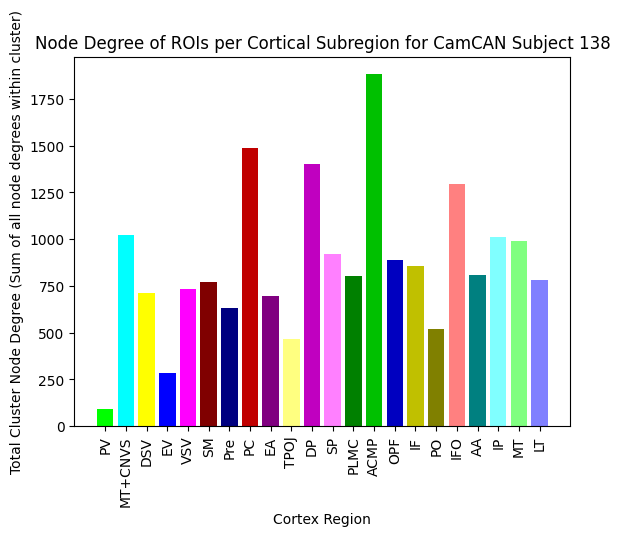

THIS IS THE SBJ ID:  139
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


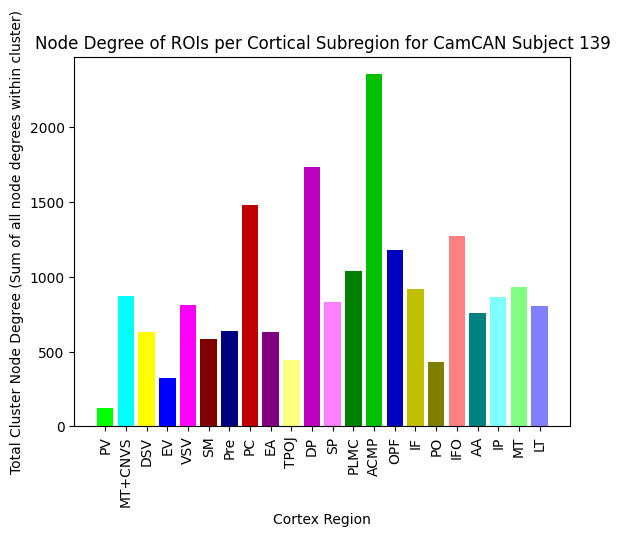

THIS IS THE SBJ ID:  140
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


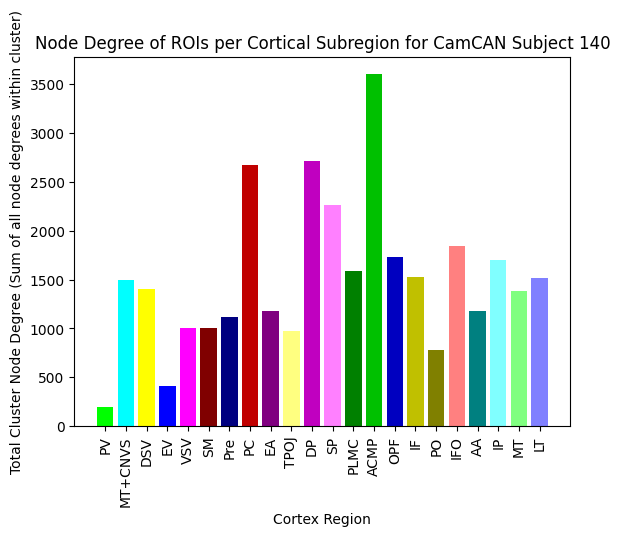

THIS IS THE SBJ ID:  141
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


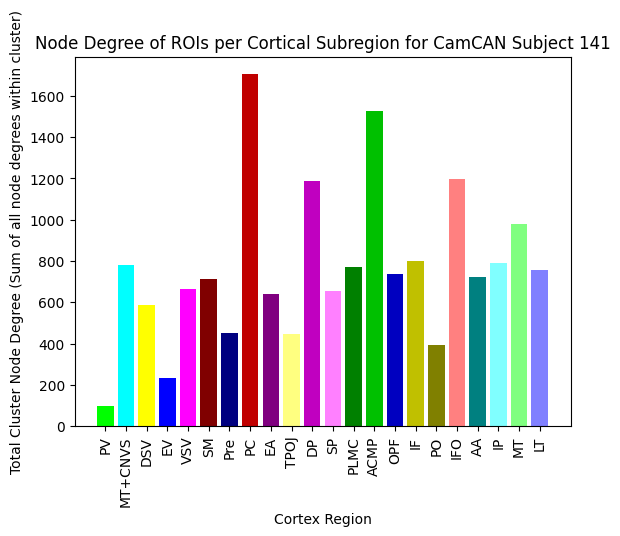

THIS IS THE SBJ ID:  142
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


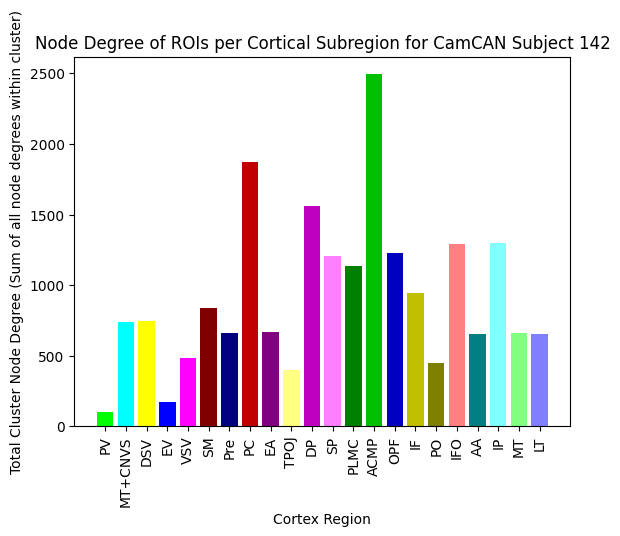

THIS IS THE SBJ ID:  143
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


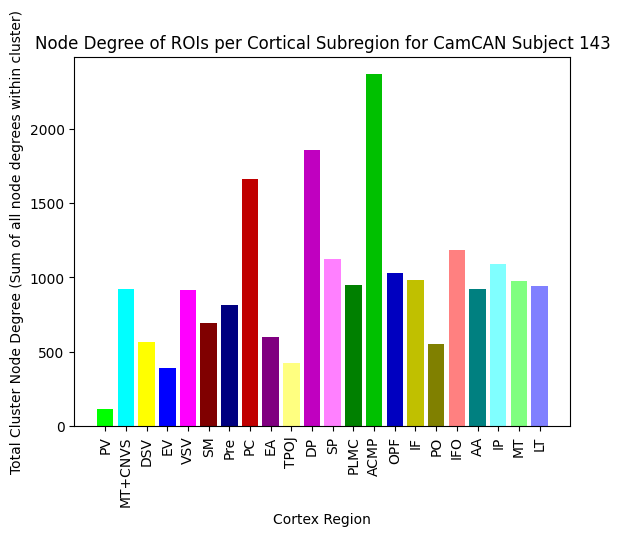

THIS IS THE SBJ ID:  144
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


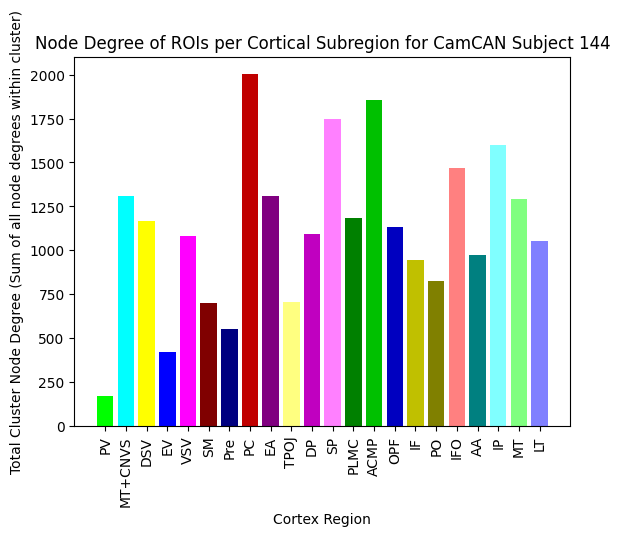

THIS IS THE SBJ ID:  145
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


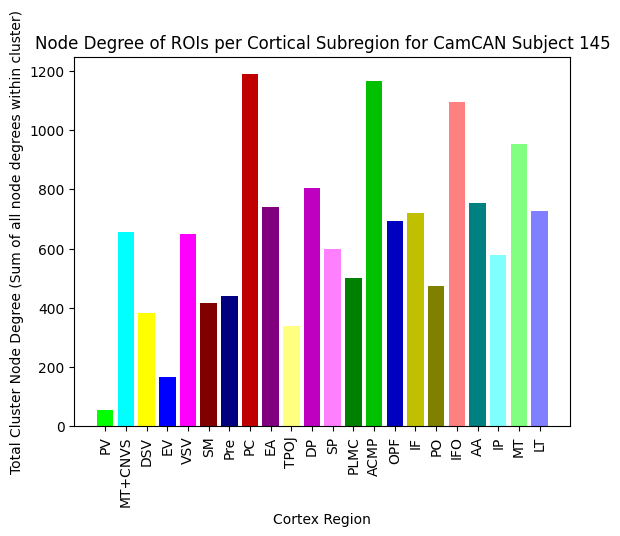

THIS IS THE SBJ ID:  146
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


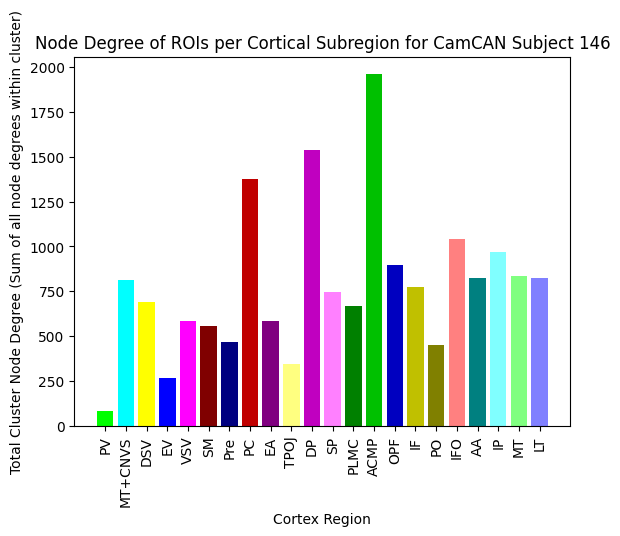

THIS IS THE SBJ ID:  147
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


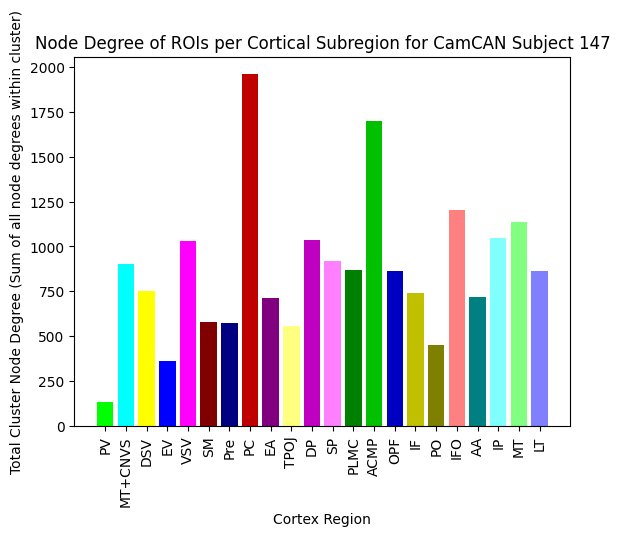

THIS IS THE SBJ ID:  148
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


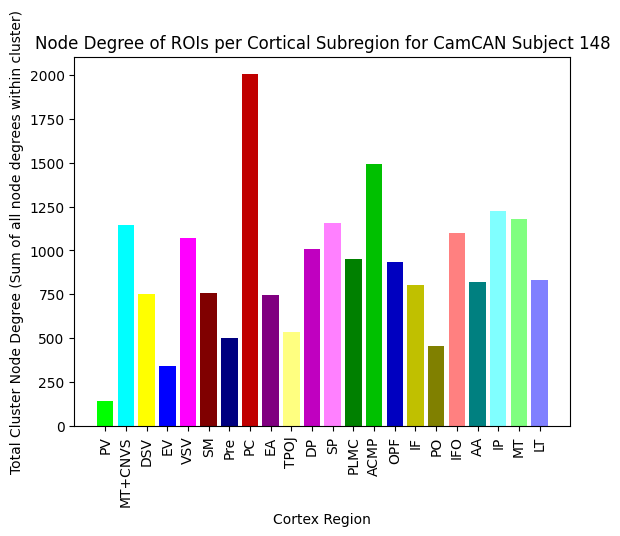

THIS IS THE SBJ ID:  149
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


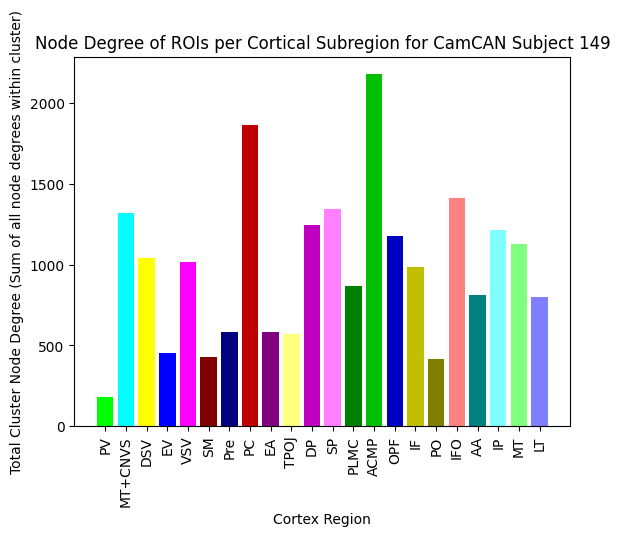

THIS IS THE SBJ ID:  150
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


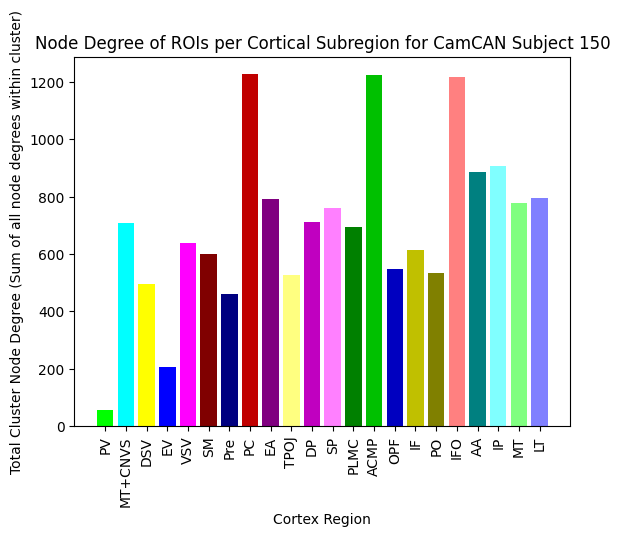

THIS IS THE SBJ ID:  151
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


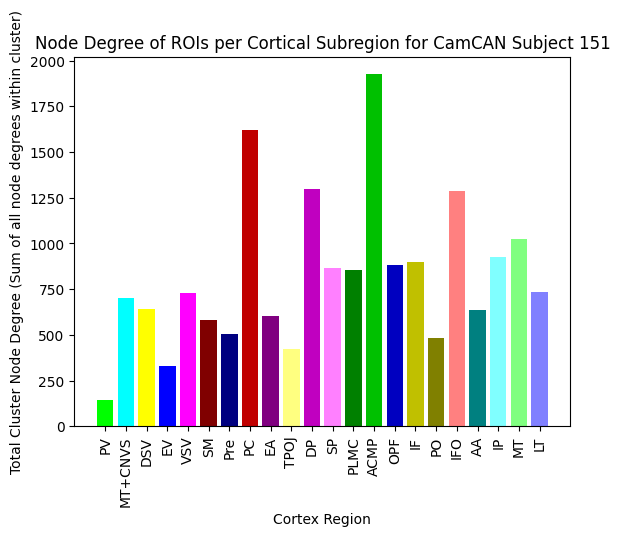

THIS IS THE SBJ ID:  152
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


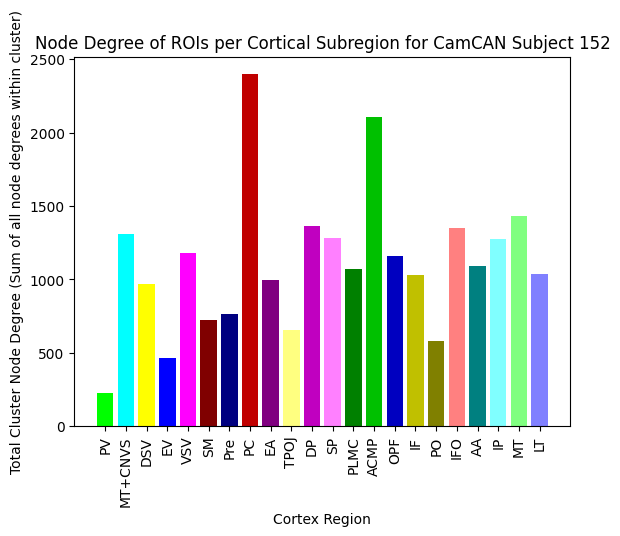

THIS IS THE SBJ ID:  153
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


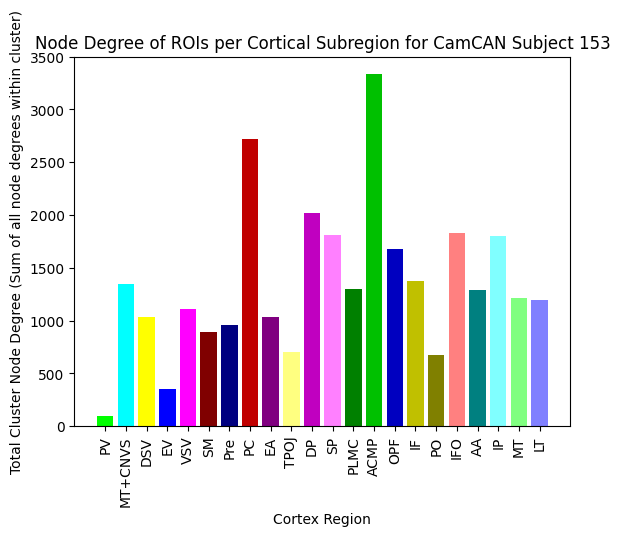

THIS IS THE SBJ ID:  154
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


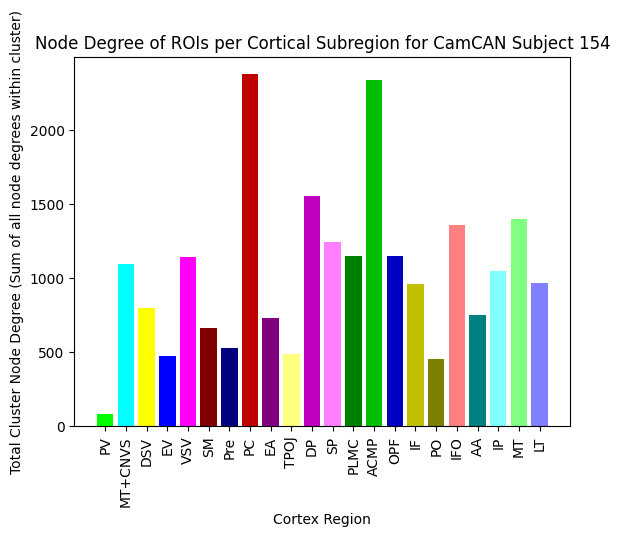

THIS IS THE SBJ ID:  155
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


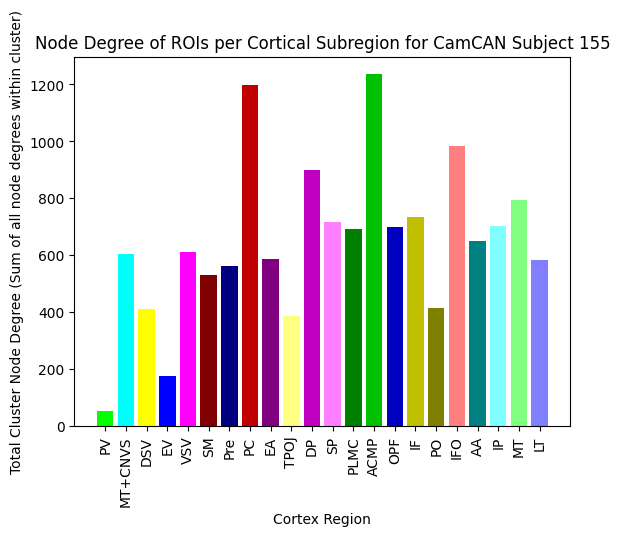

THIS IS THE SBJ ID:  156
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


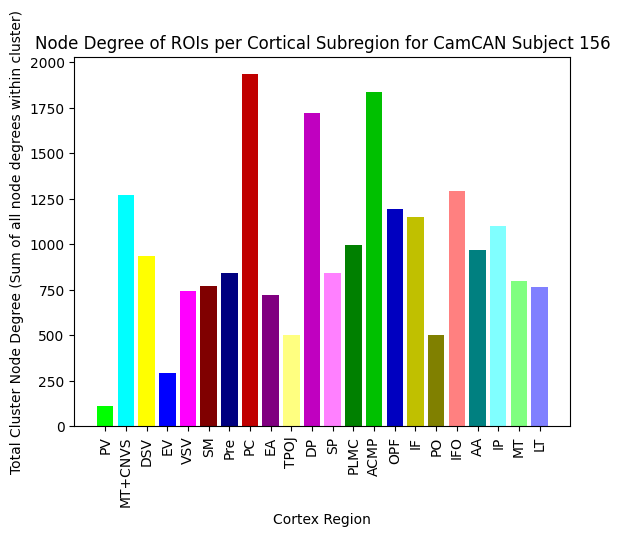

THIS IS THE SBJ ID:  157
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


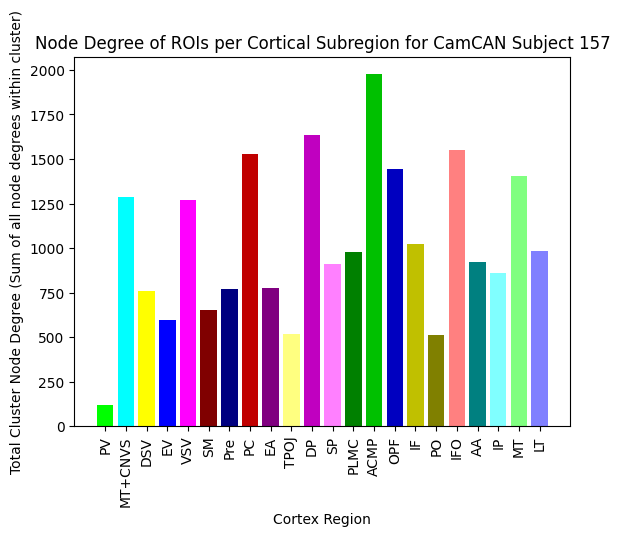

THIS IS THE SBJ ID:  158
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


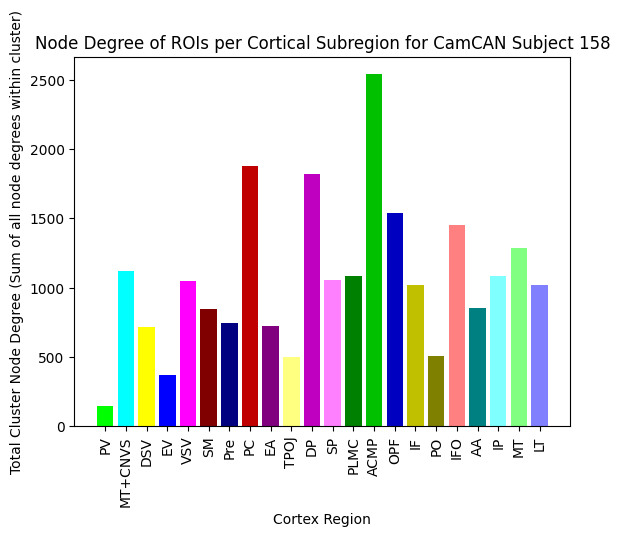

THIS IS THE SBJ ID:  159
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


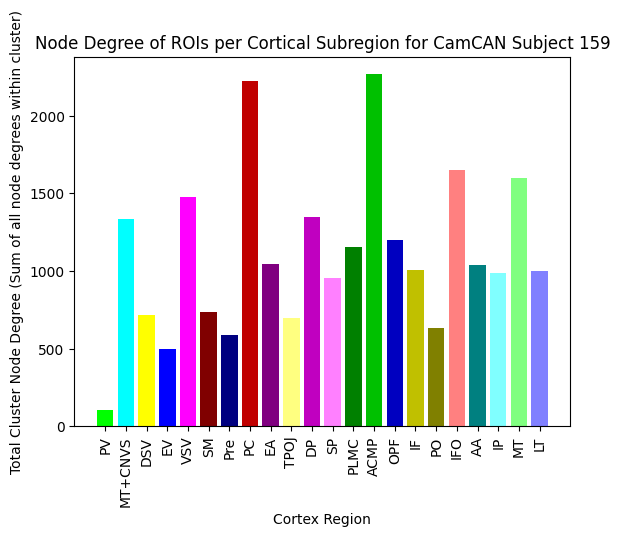

THIS IS THE SBJ ID:  160
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


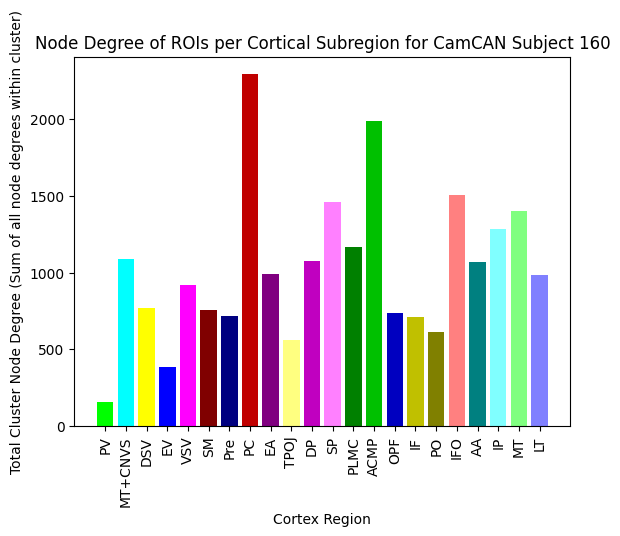

THIS IS THE SBJ ID:  161
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


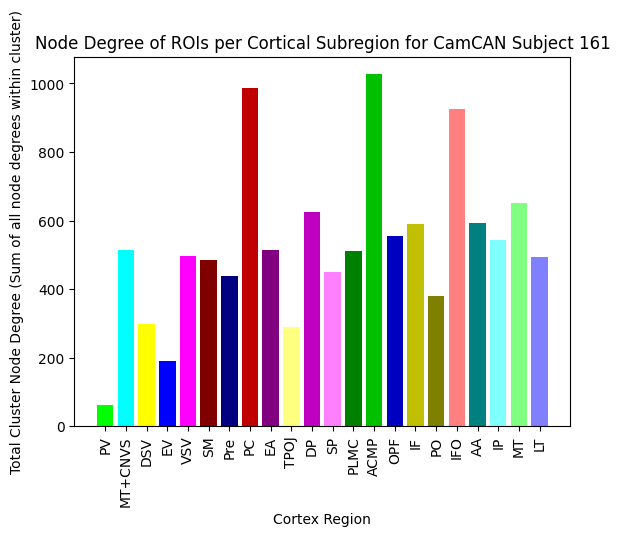

THIS IS THE SBJ ID:  162
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


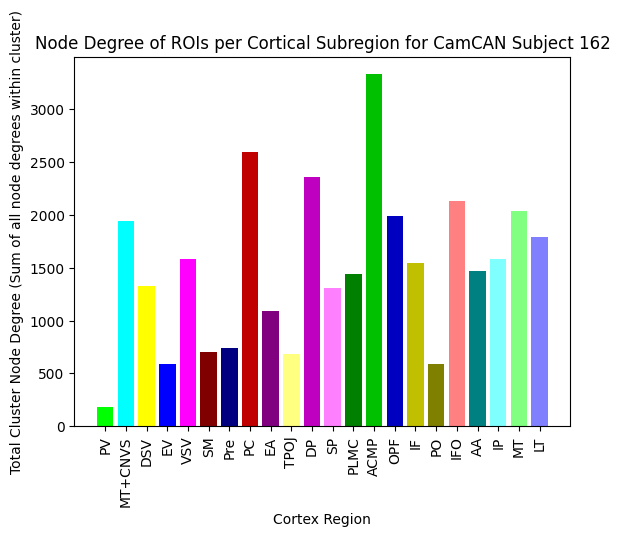

THIS IS THE SBJ ID:  163
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


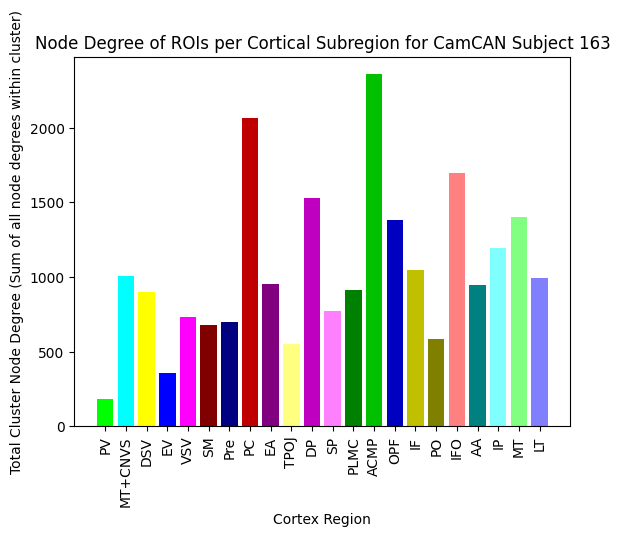

THIS IS THE SBJ ID:  164
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


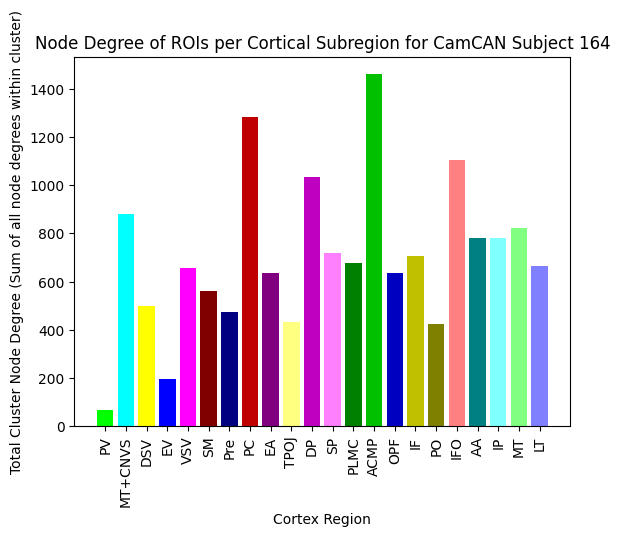

THIS IS THE SBJ ID:  165
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


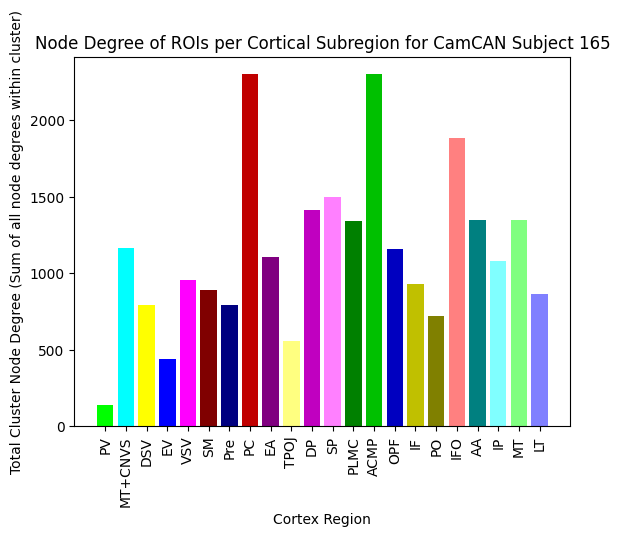

THIS IS THE SBJ ID:  166
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


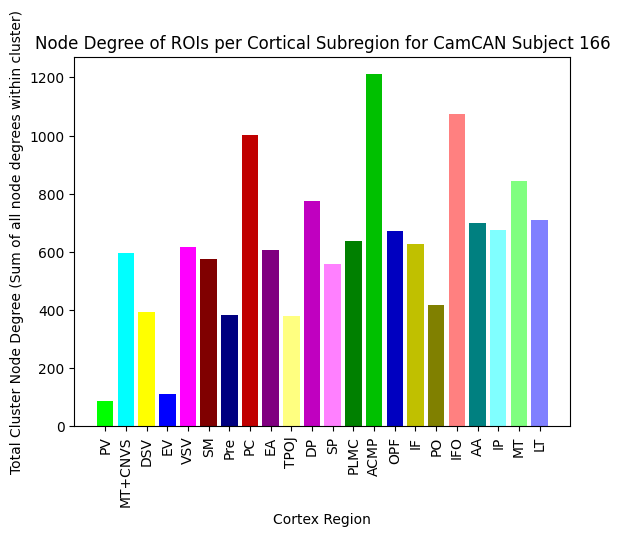

THIS IS THE SBJ ID:  167
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


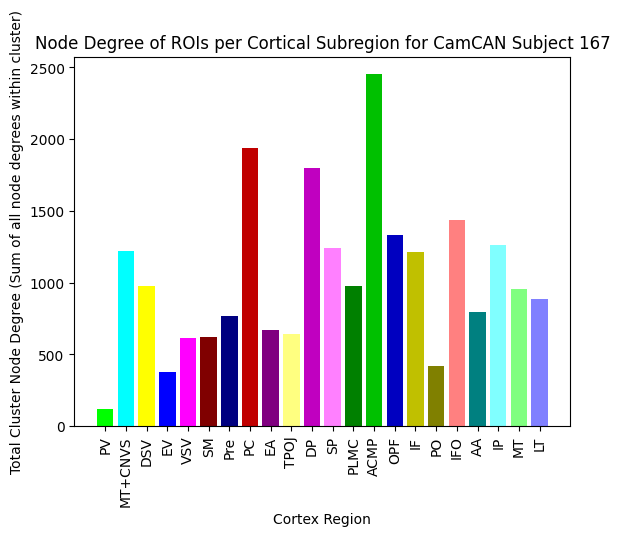

THIS IS THE SBJ ID:  168
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


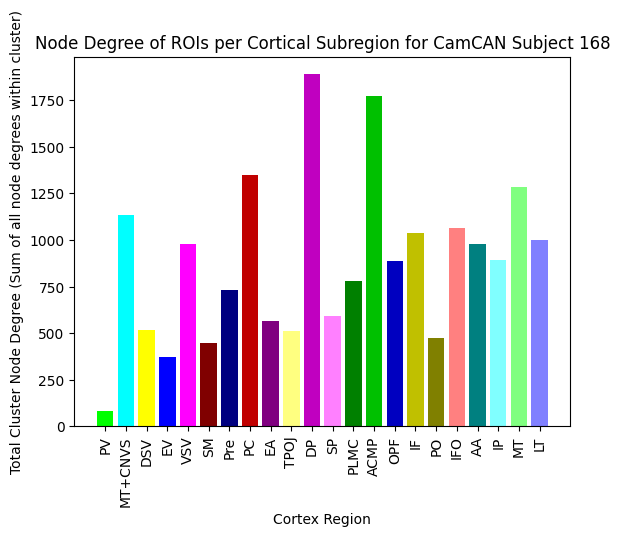

THIS IS THE SBJ ID:  169
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


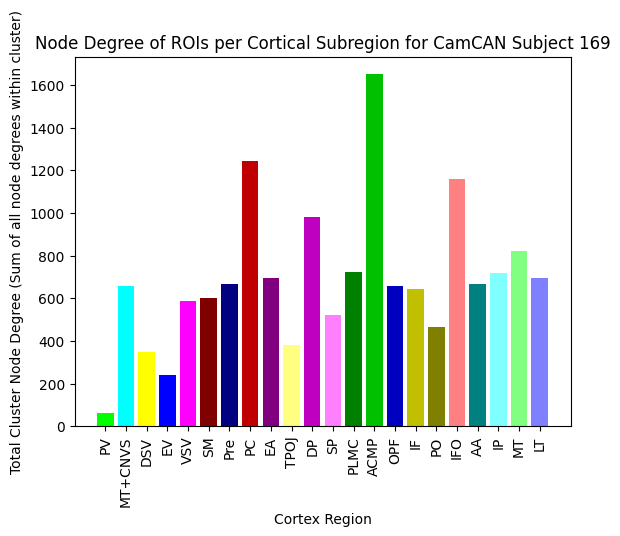

THIS IS THE SBJ ID:  170
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


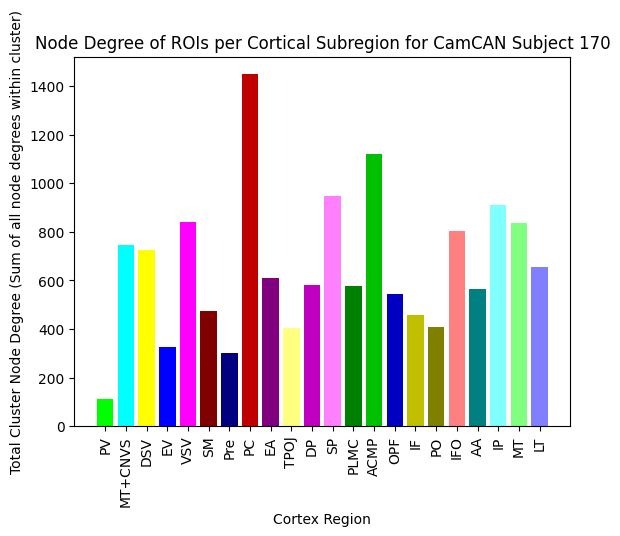

THIS IS THE SBJ ID:  171
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


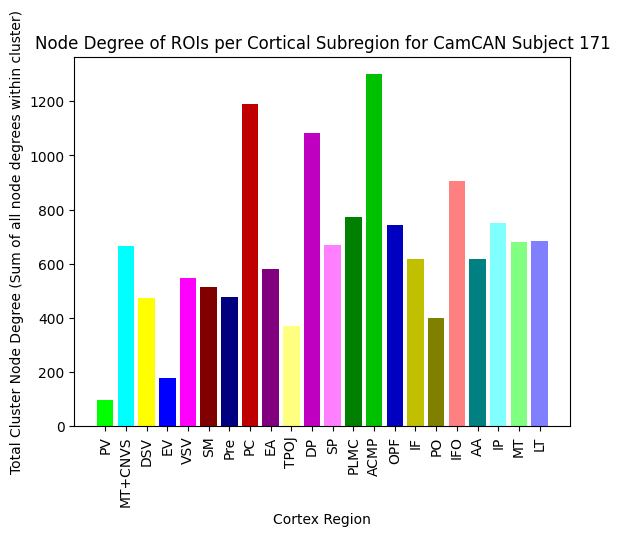

THIS IS THE SBJ ID:  172
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


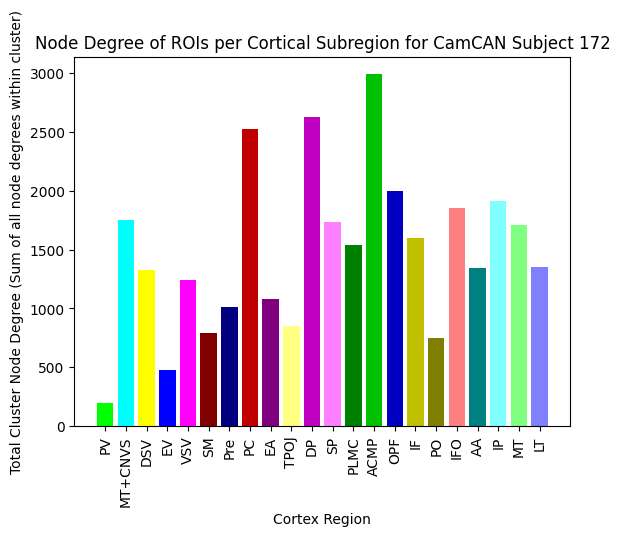

THIS IS THE SBJ ID:  173
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


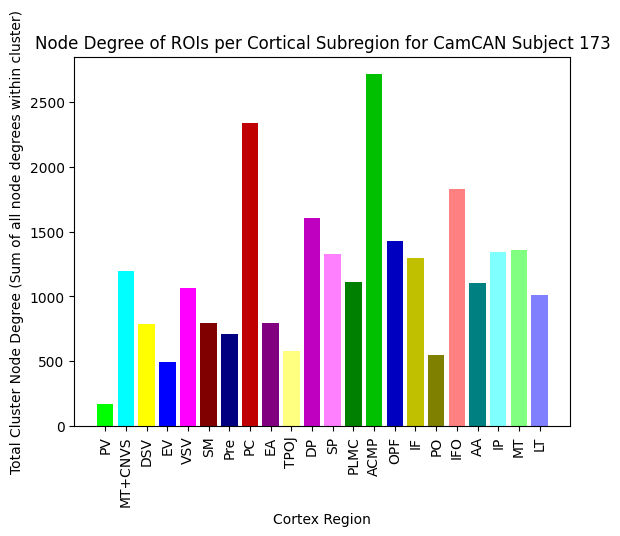

THIS IS THE SBJ ID:  174
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


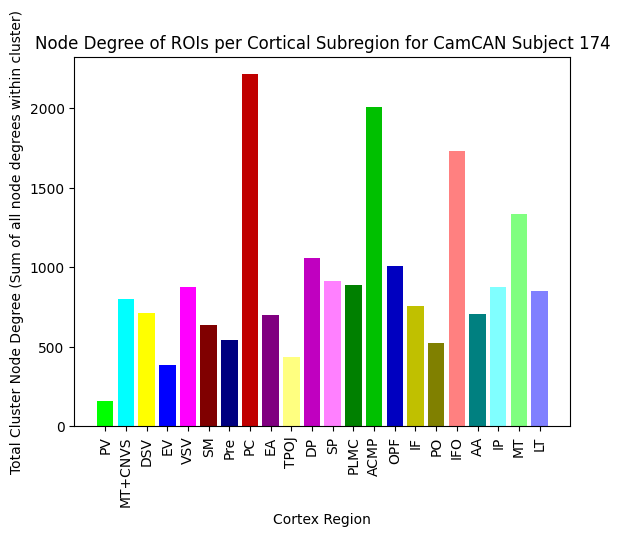

THIS IS THE SBJ ID:  175
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


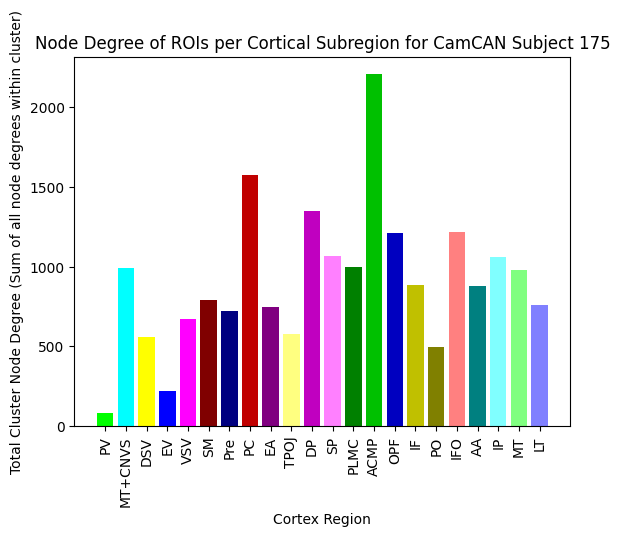

THIS IS THE SBJ ID:  176
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


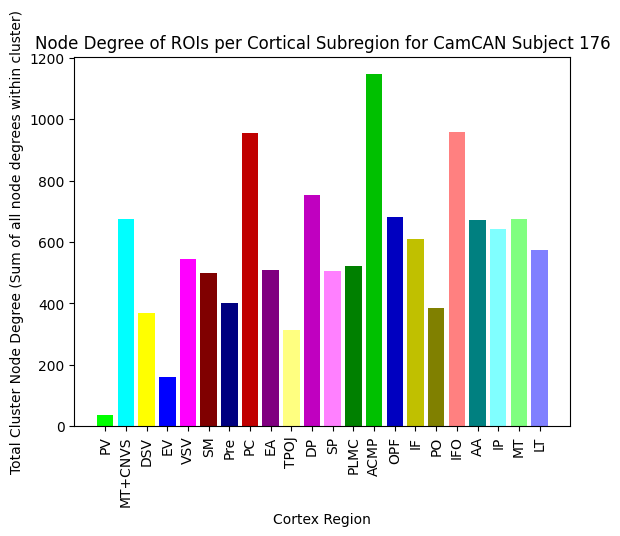

THIS IS THE SBJ ID:  177
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


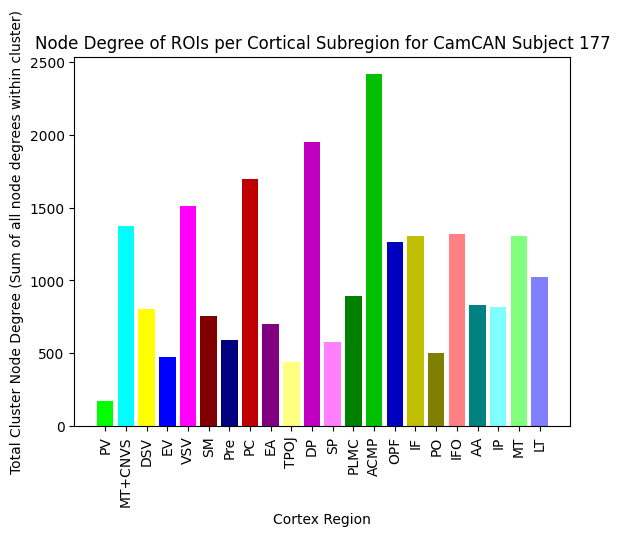

THIS IS THE SBJ ID:  178
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


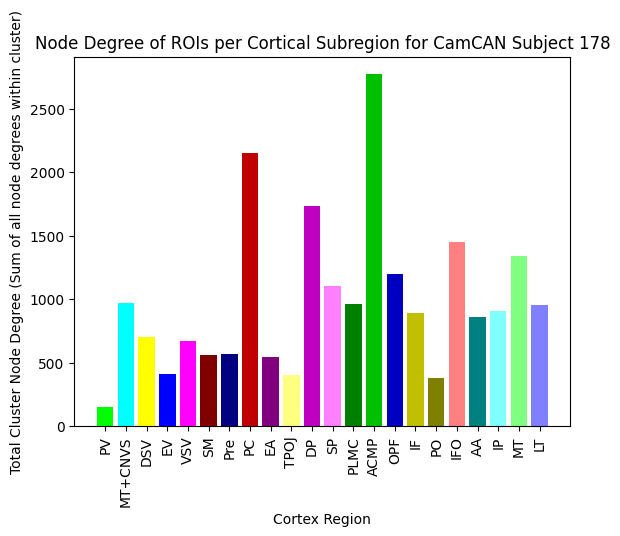

THIS IS THE SBJ ID:  179
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


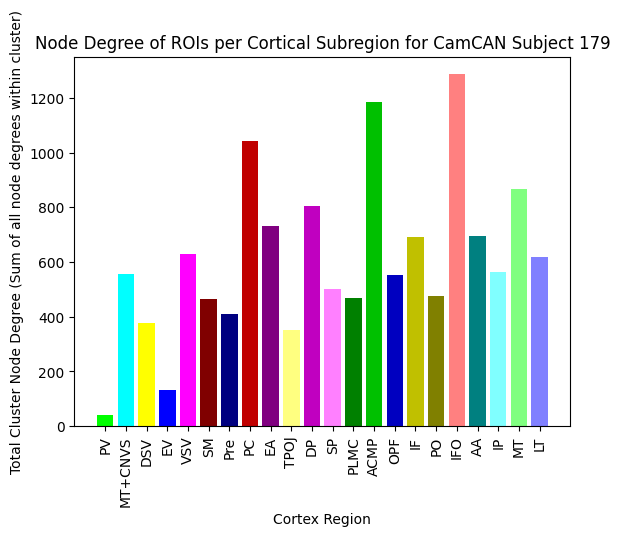

THIS IS THE SBJ ID:  180
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


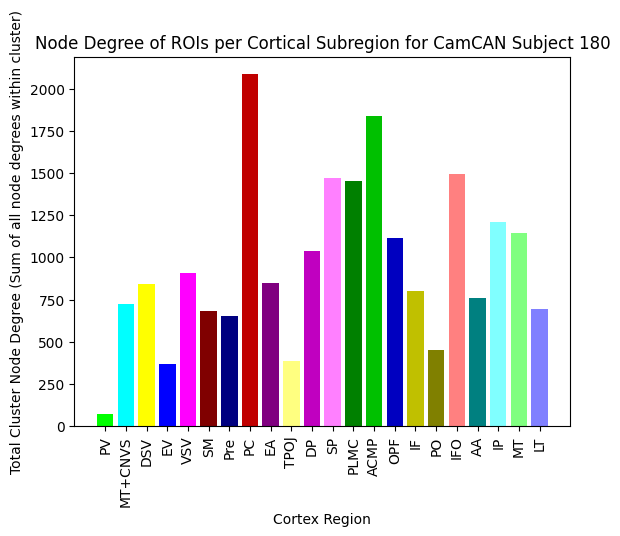

THIS IS THE SBJ ID:  181
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


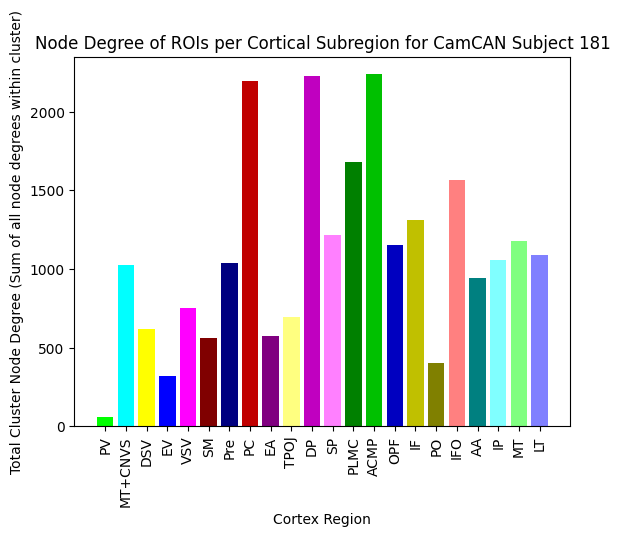

THIS IS THE SBJ ID:  182
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


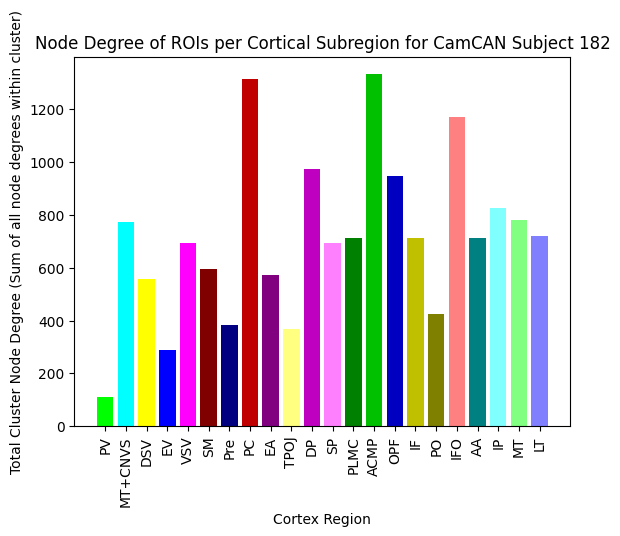

THIS IS THE SBJ ID:  183
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


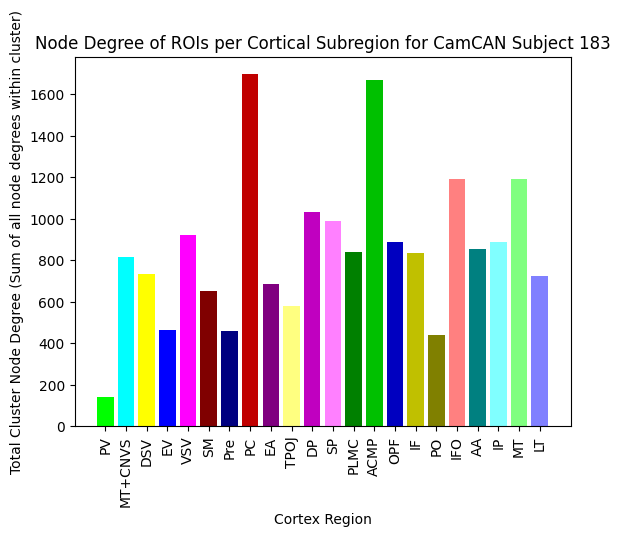

THIS IS THE SBJ ID:  184
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


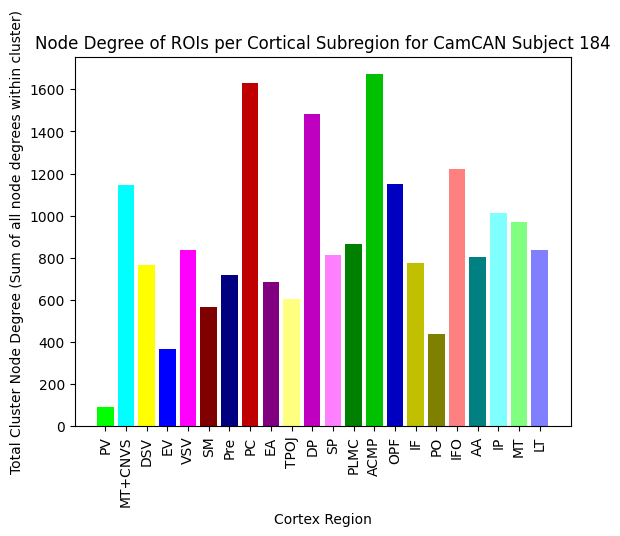

THIS IS THE SBJ ID:  185
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


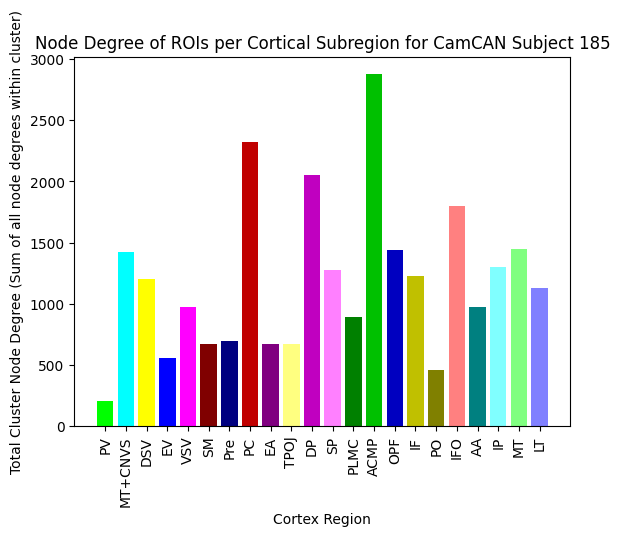

THIS IS THE SBJ ID:  186
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


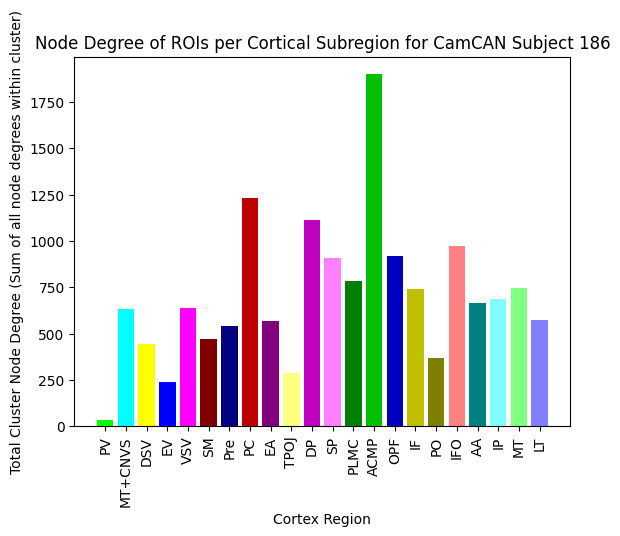

THIS IS THE SBJ ID:  187
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


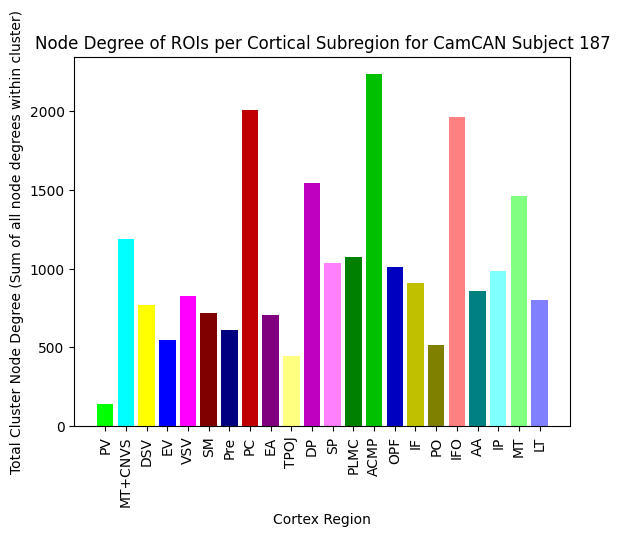

THIS IS THE SBJ ID:  188
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


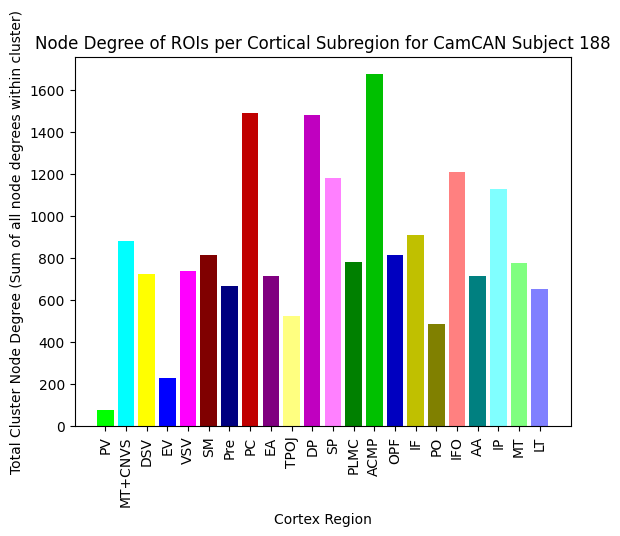

THIS IS THE SBJ ID:  189
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


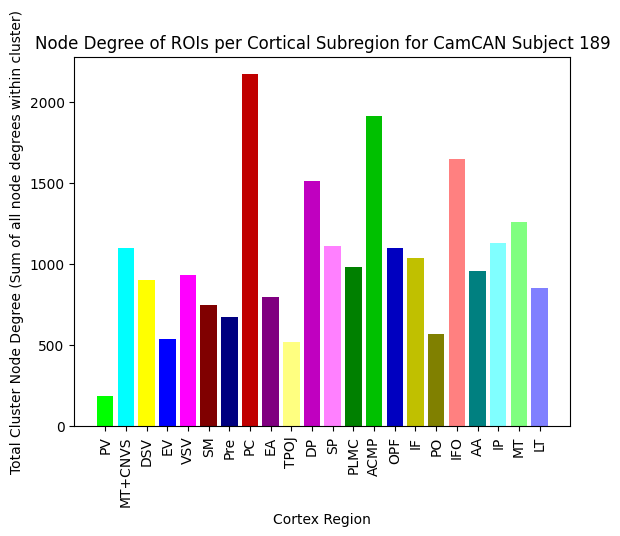

THIS IS THE SBJ ID:  190
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


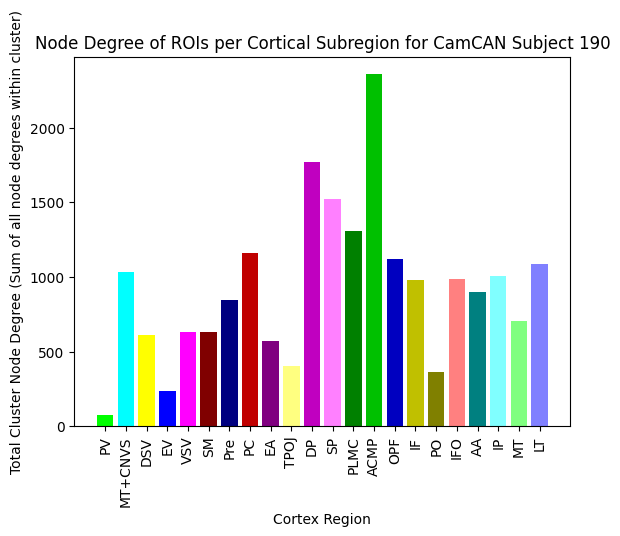

THIS IS THE SBJ ID:  191
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


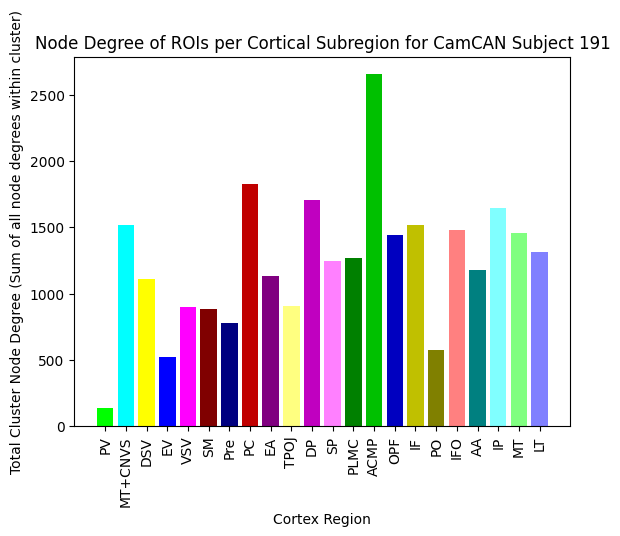

THIS IS THE SBJ ID:  192
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


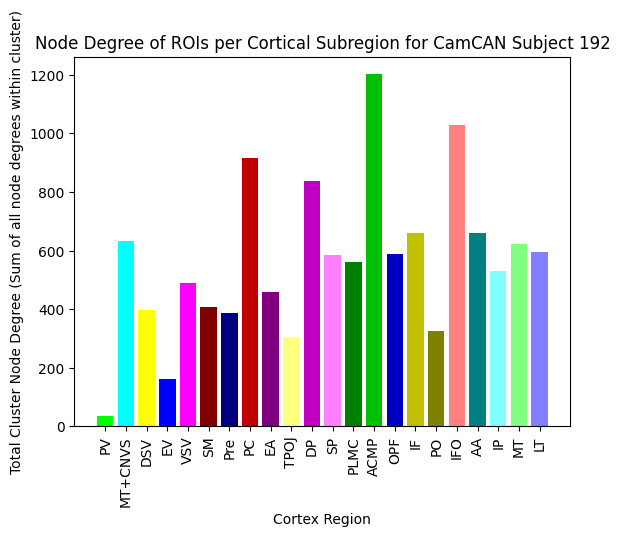

THIS IS THE SBJ ID:  193
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


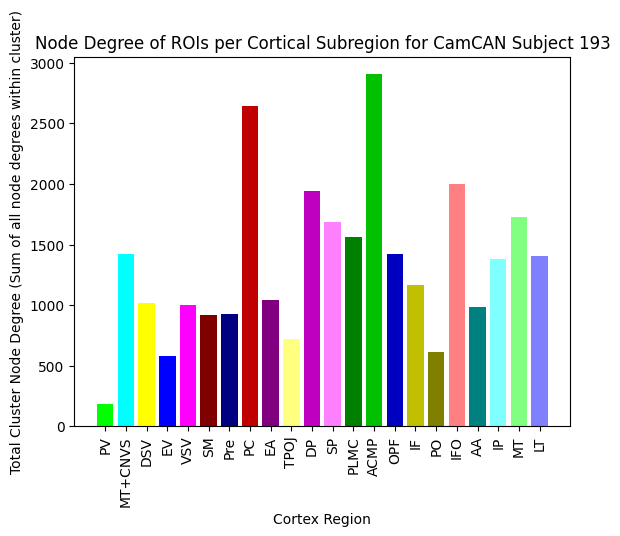

THIS IS THE SBJ ID:  194
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


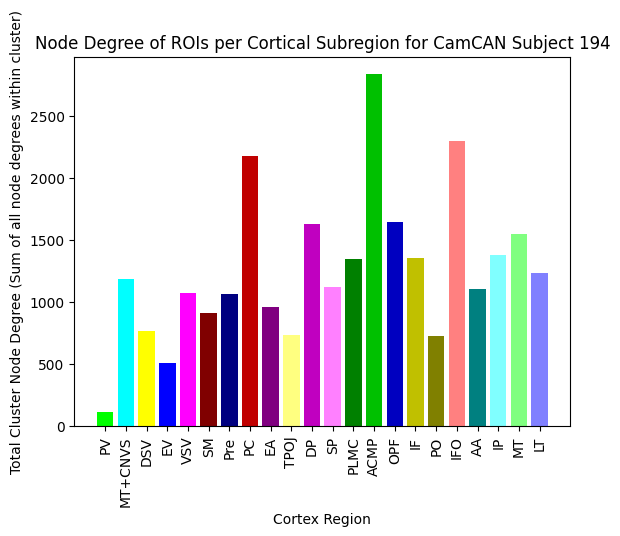

THIS IS THE SBJ ID:  195
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


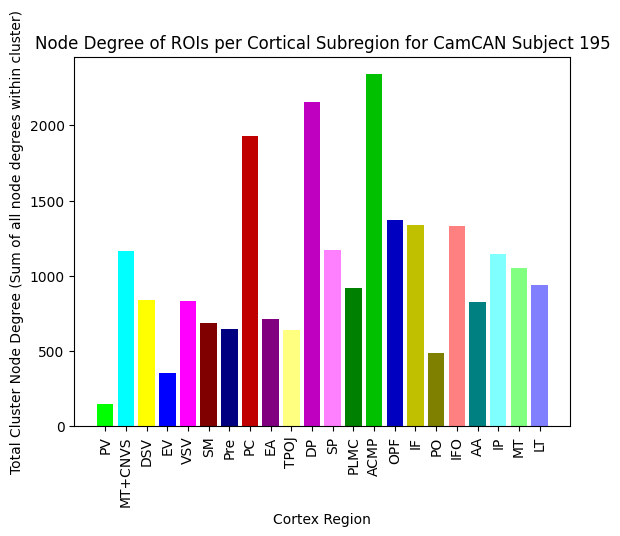

THIS IS THE SBJ ID:  196
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


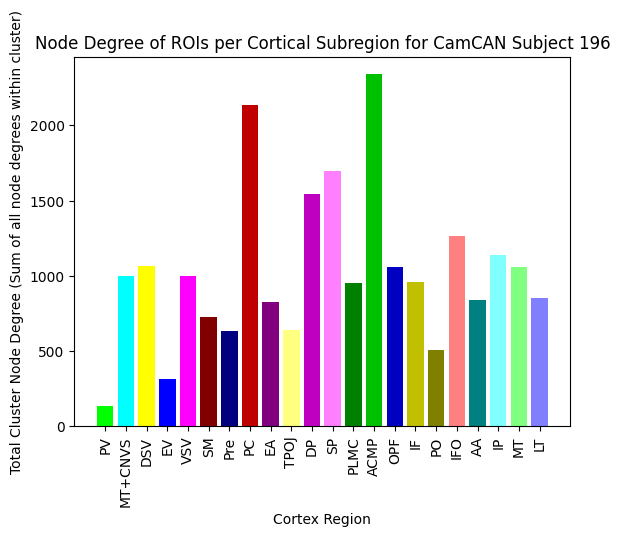

THIS IS THE SBJ ID:  197
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


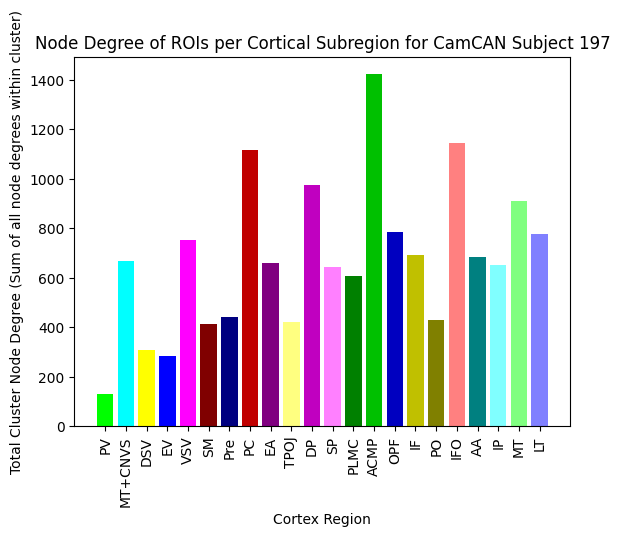

THIS IS THE SBJ ID:  198
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


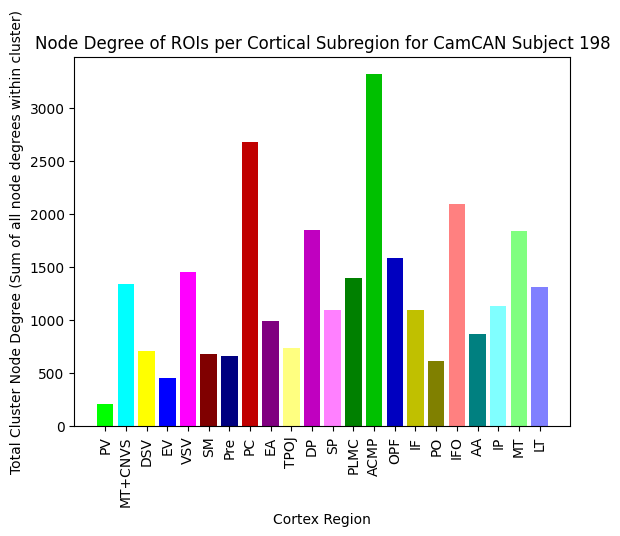

THIS IS THE SBJ ID:  199
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


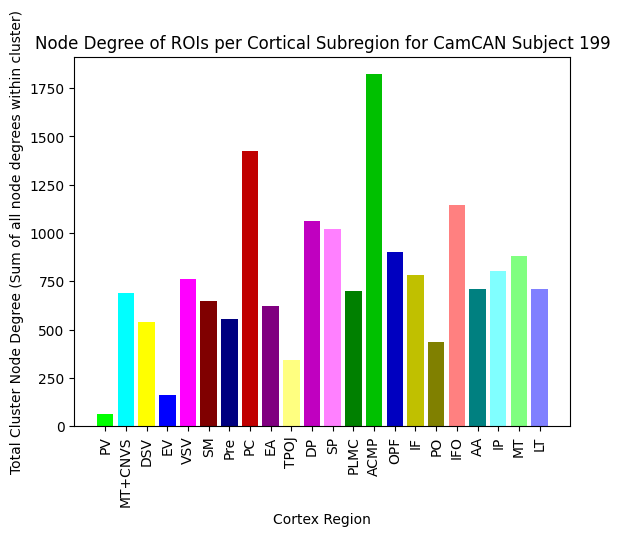

THIS IS THE SBJ ID:  200
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


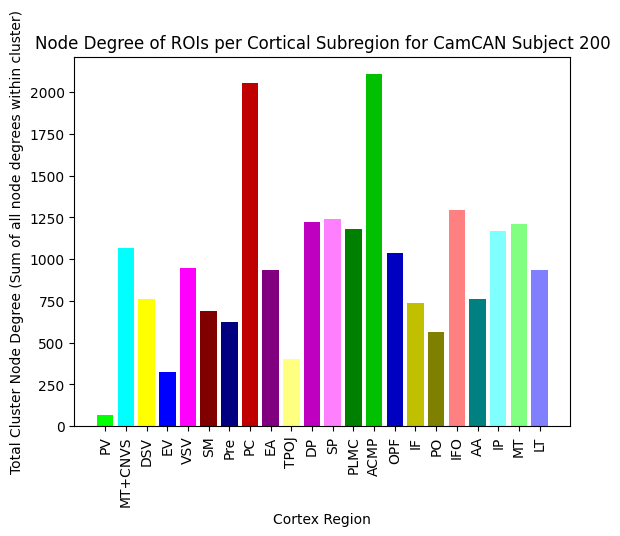

THIS IS THE SBJ ID:  201
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


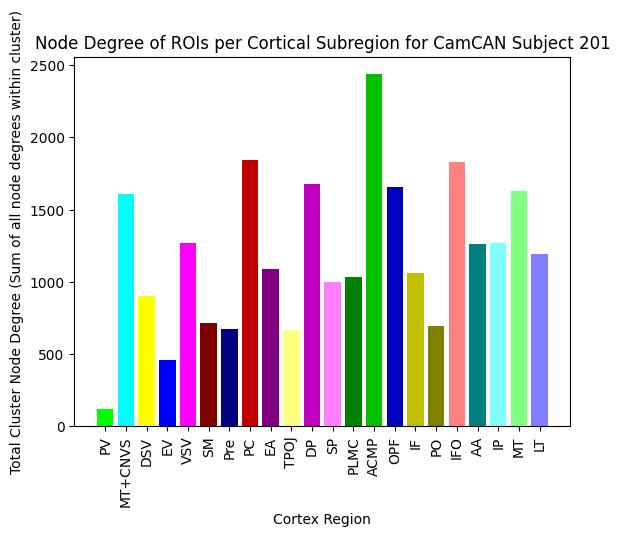

THIS IS THE SBJ ID:  202
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


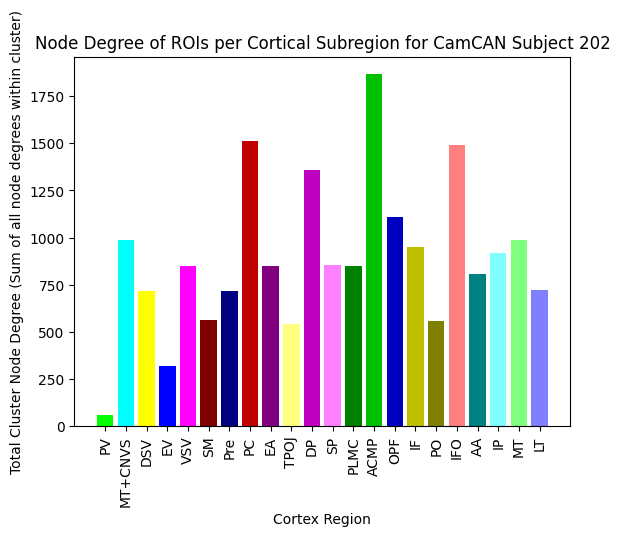

THIS IS THE SBJ ID:  203
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


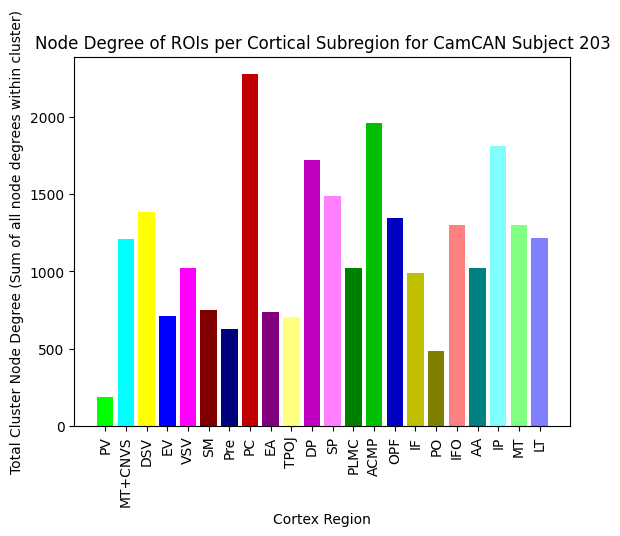

THIS IS THE SBJ ID:  204
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


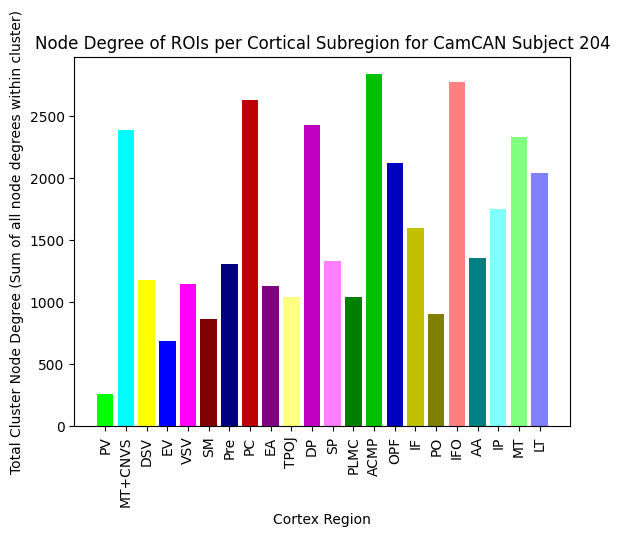

THIS IS THE SBJ ID:  205
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


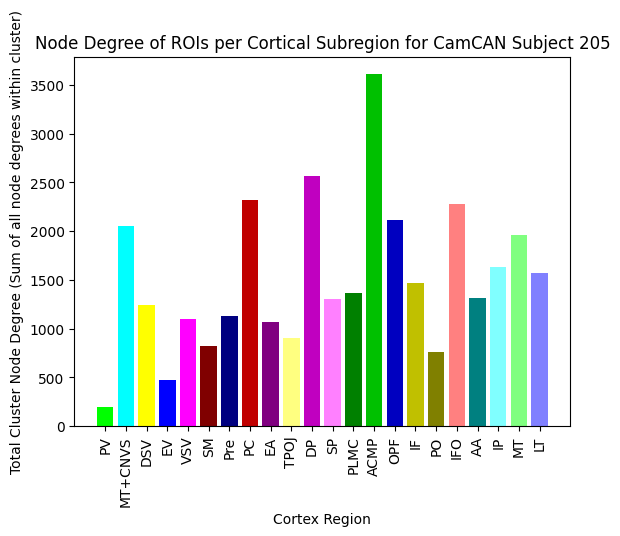

THIS IS THE SBJ ID:  206
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


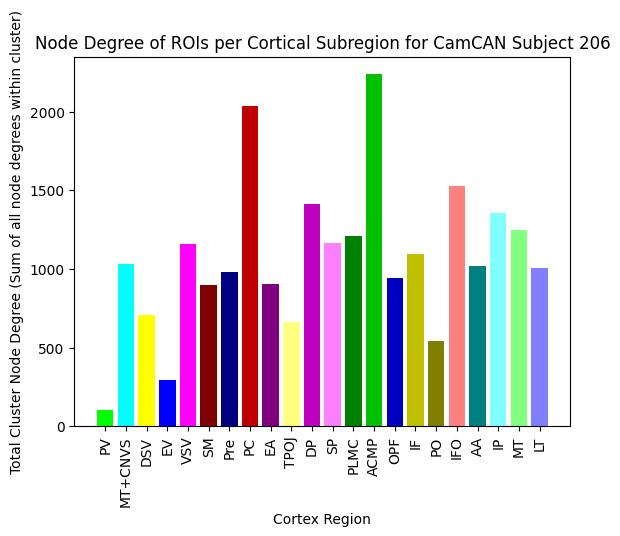

THIS IS THE SBJ ID:  207
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


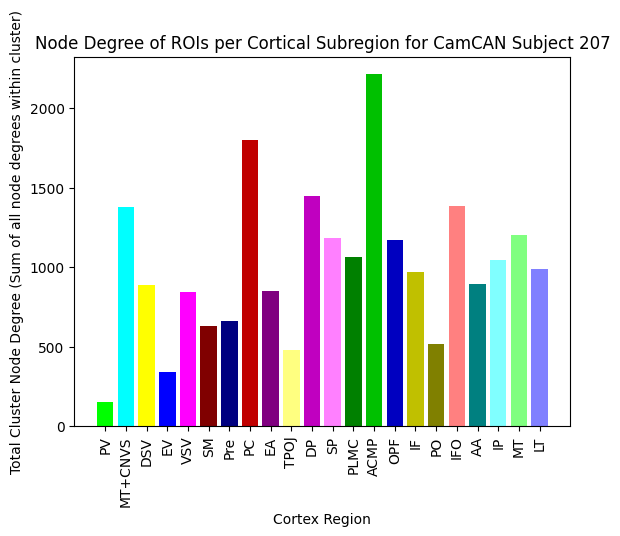

THIS IS THE SBJ ID:  208
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


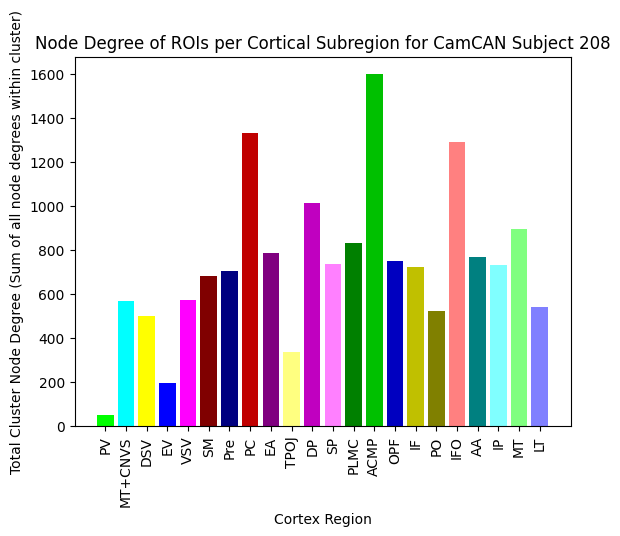

THIS IS THE SBJ ID:  209
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


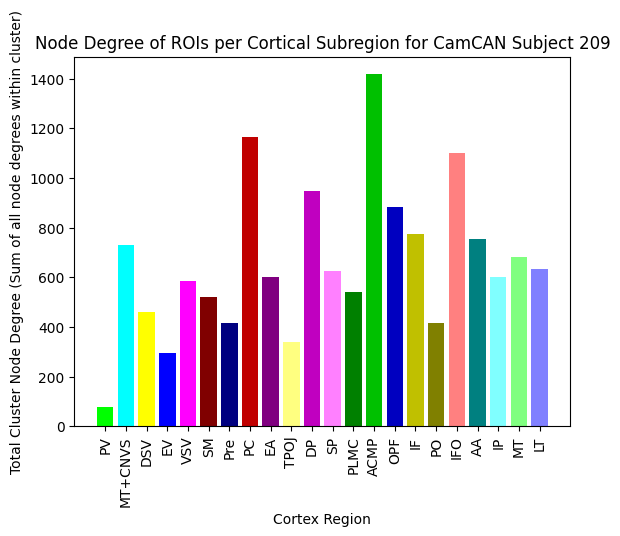

THIS IS THE SBJ ID:  210
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


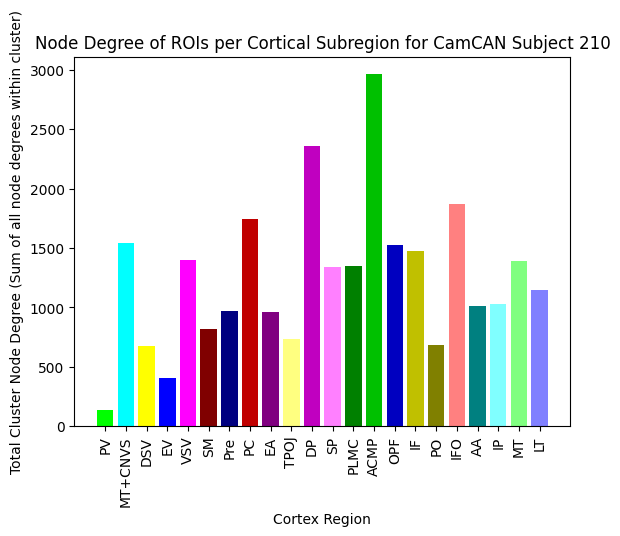

THIS IS THE SBJ ID:  211
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


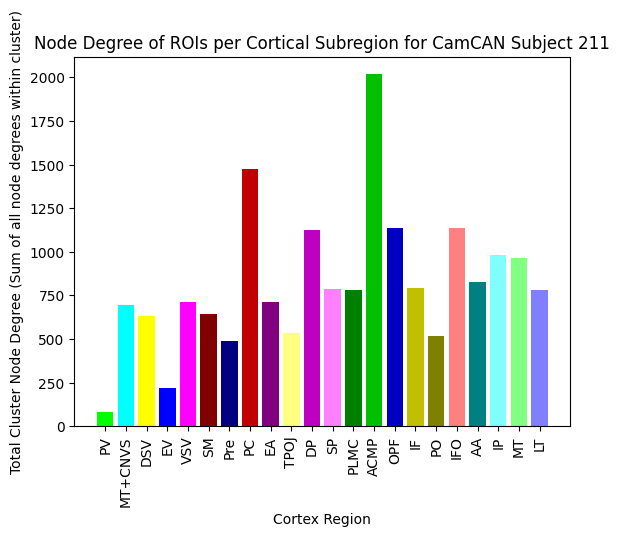

THIS IS THE SBJ ID:  212
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


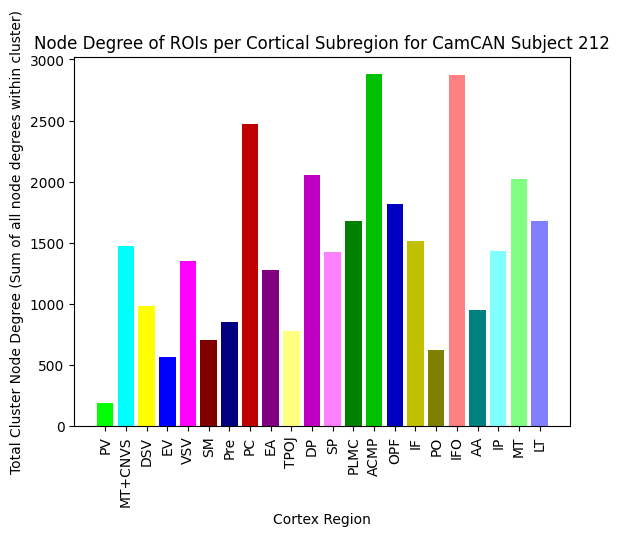

THIS IS THE SBJ ID:  213
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


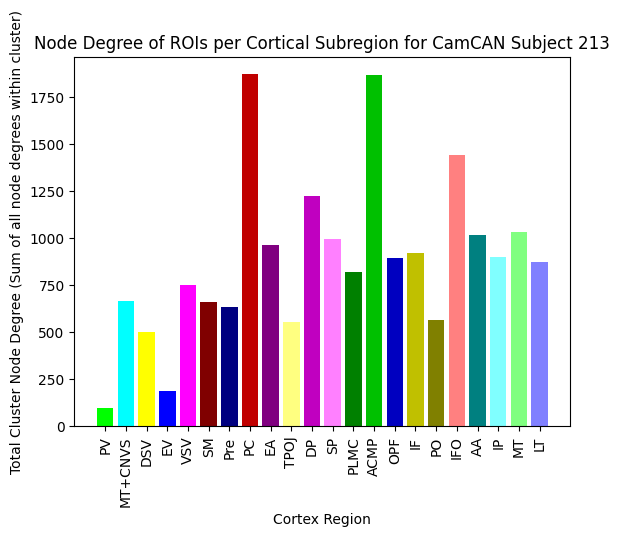

THIS IS THE SBJ ID:  214
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


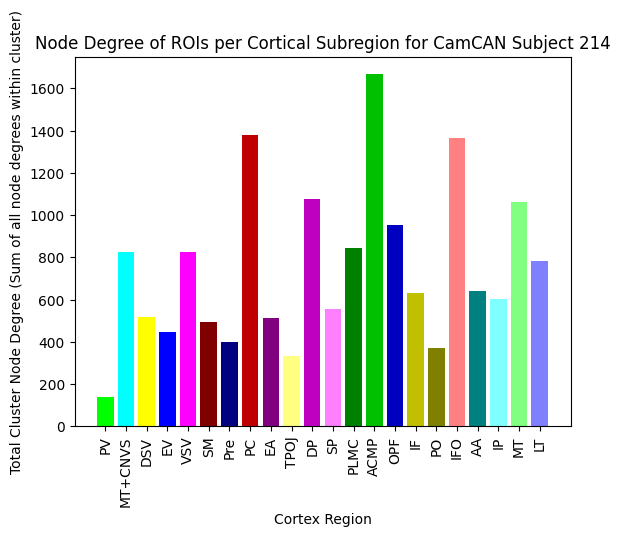

THIS IS THE SBJ ID:  215
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


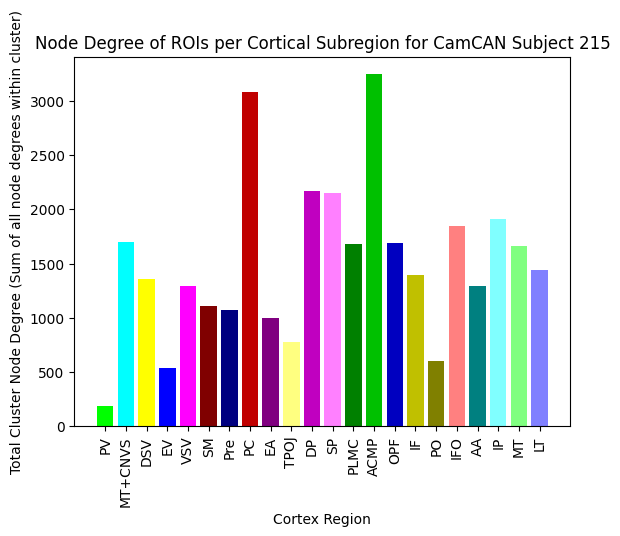

THIS IS THE SBJ ID:  216
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


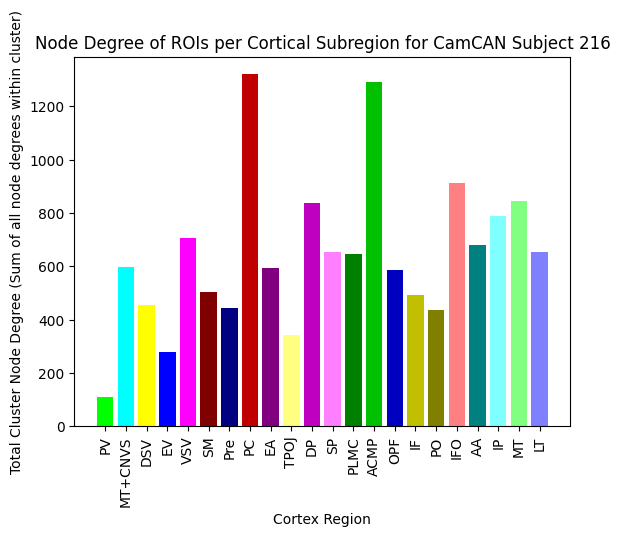

THIS IS THE SBJ ID:  217
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


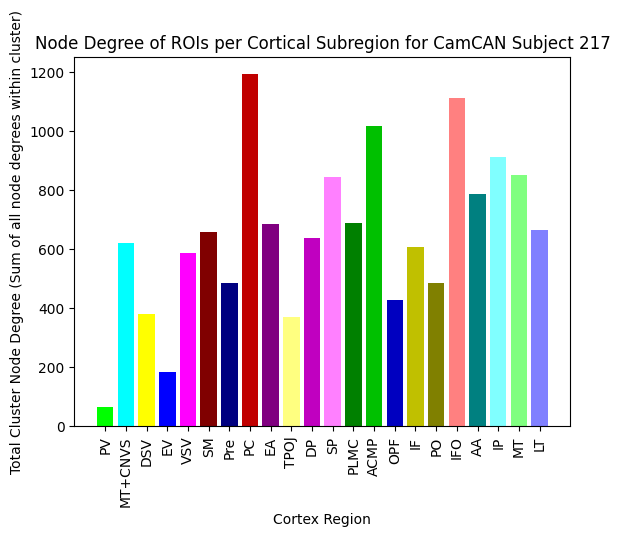

THIS IS THE SBJ ID:  218
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


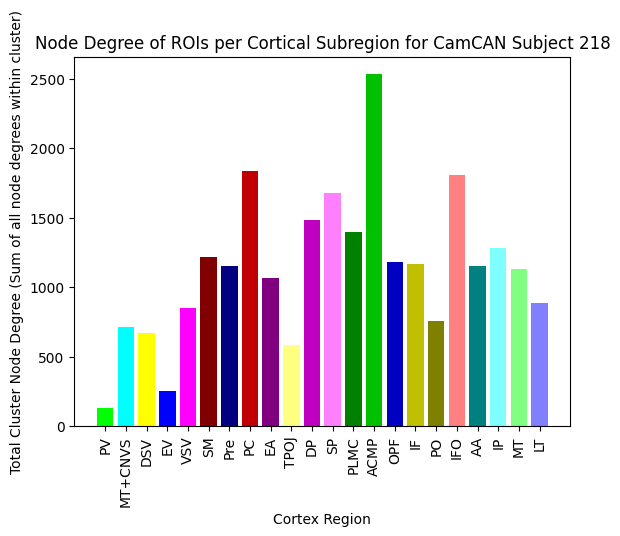

THIS IS THE SBJ ID:  219
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


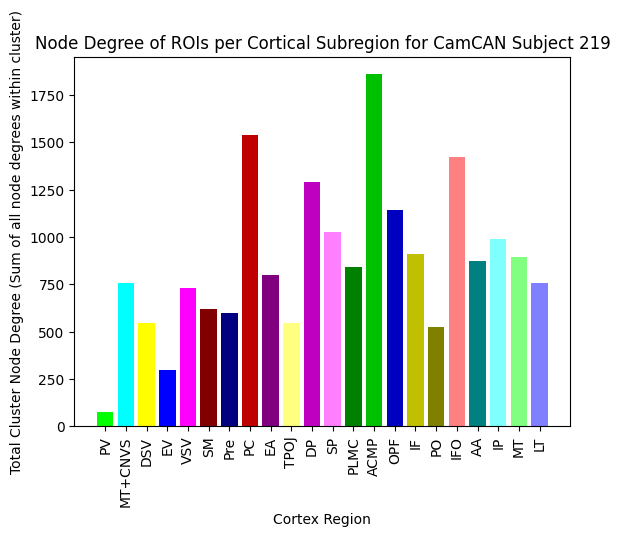

THIS IS THE SBJ ID:  220
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


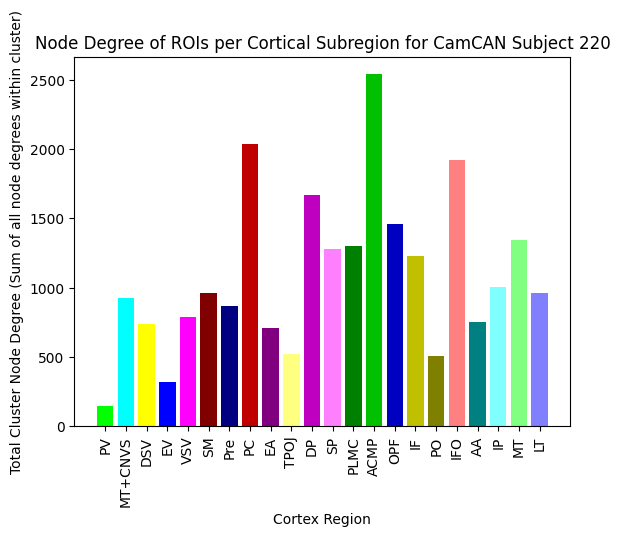

THIS IS THE SBJ ID:  221
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


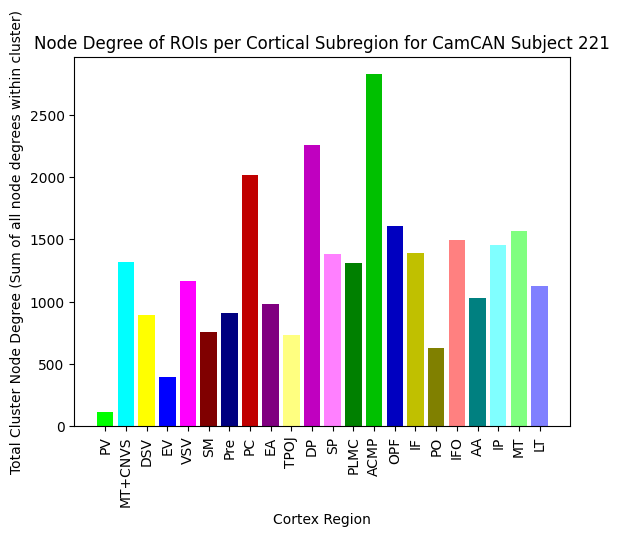

THIS IS THE SBJ ID:  222
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


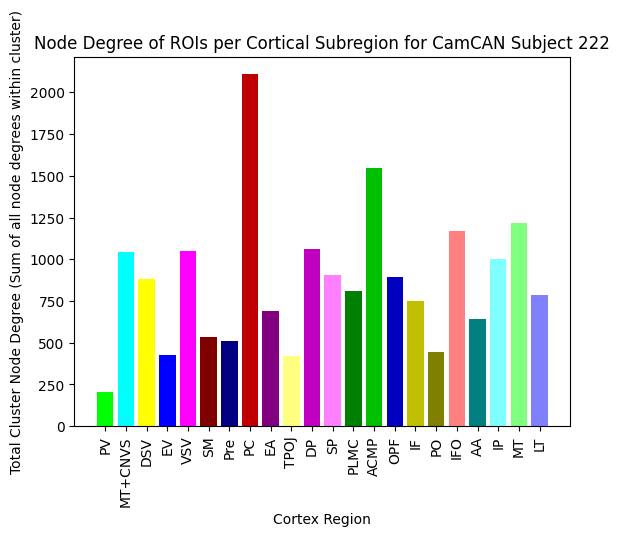

THIS IS THE SBJ ID:  223
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


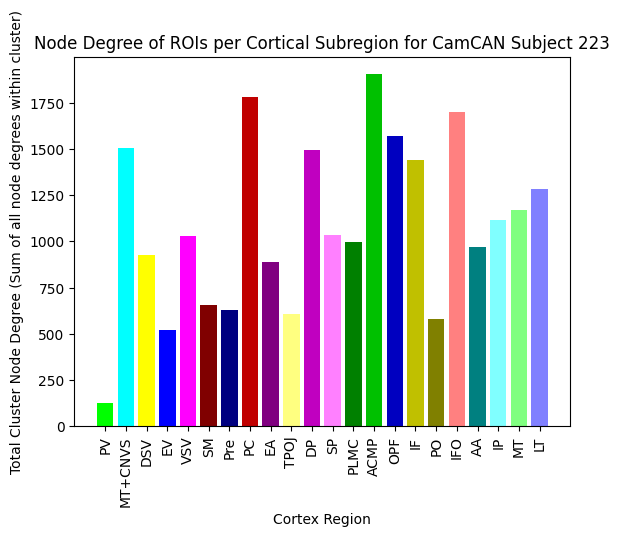

THIS IS THE SBJ ID:  224
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


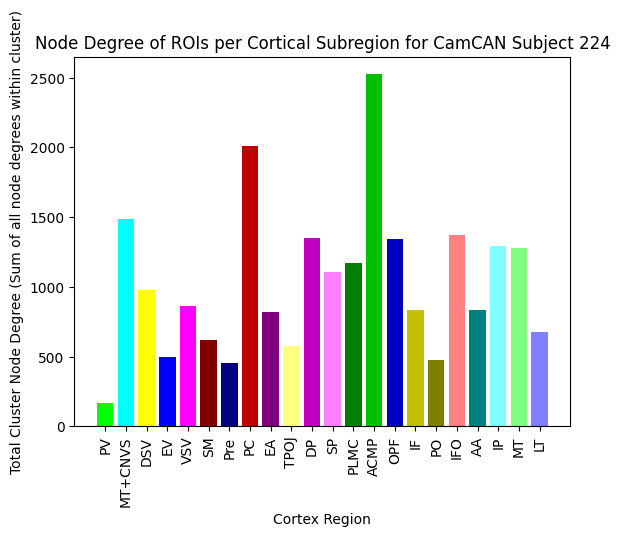

THIS IS THE SBJ ID:  225
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


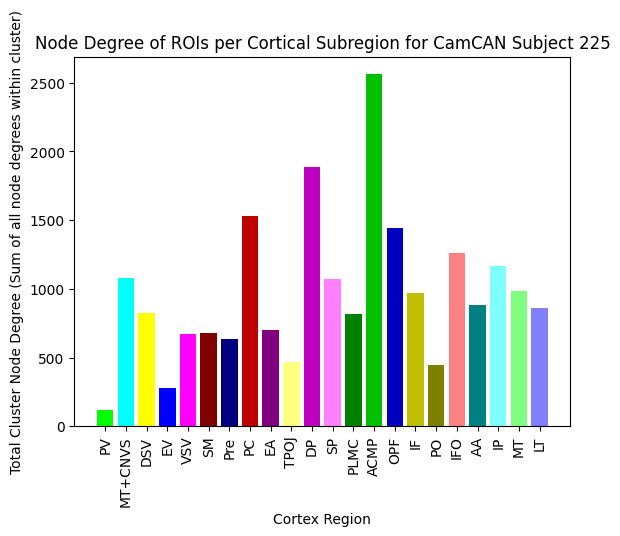

THIS IS THE SBJ ID:  226
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


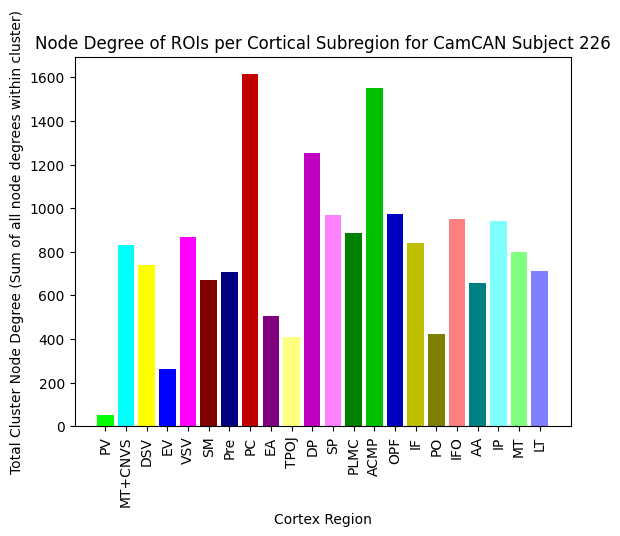

THIS IS THE SBJ ID:  227
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


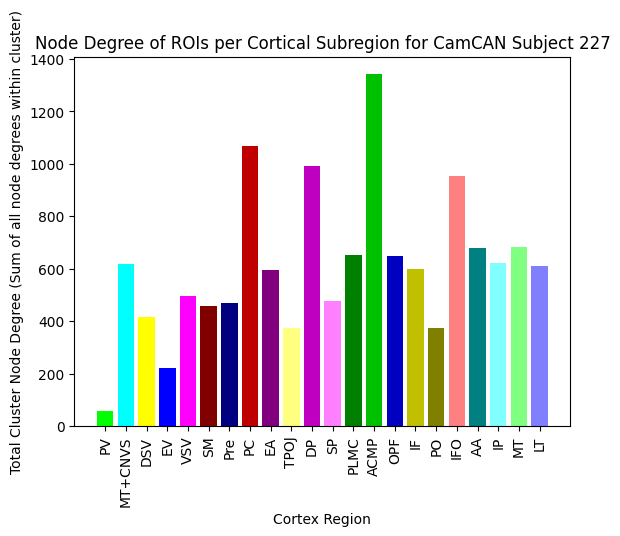

THIS IS THE SBJ ID:  228
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


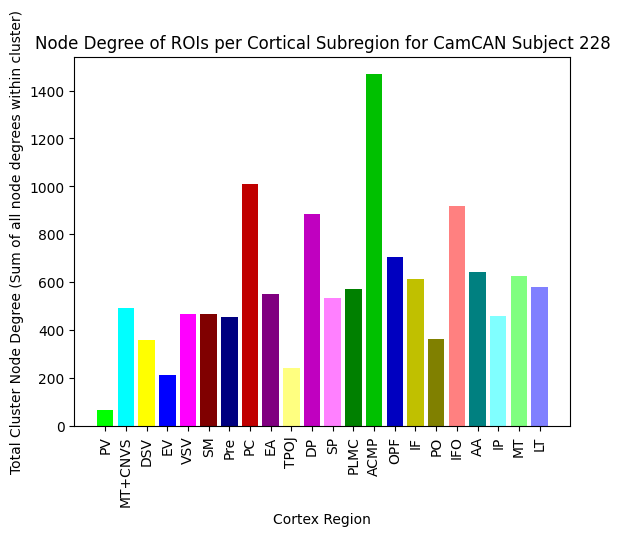

THIS IS THE SBJ ID:  229
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


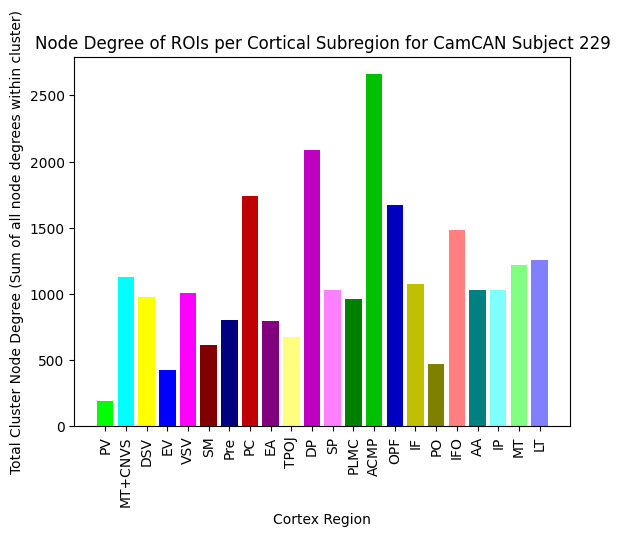

THIS IS THE SBJ ID:  230
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


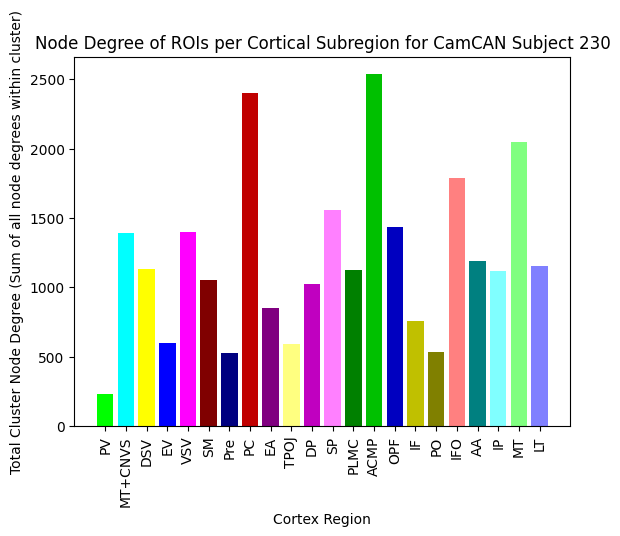

THIS IS THE SBJ ID:  231
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


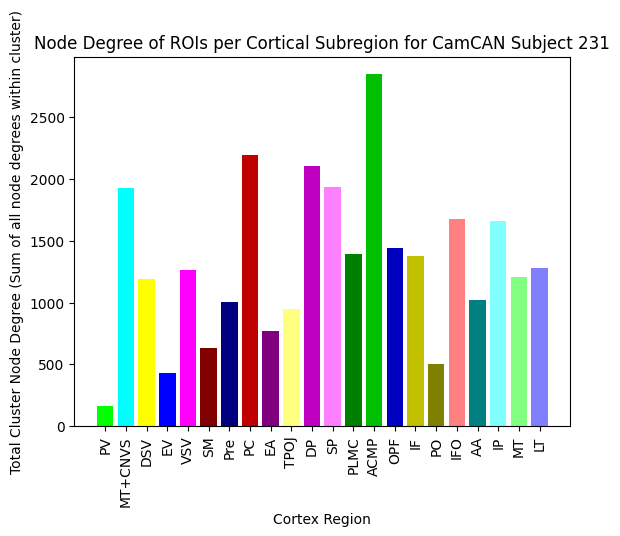

THIS IS THE SBJ ID:  232
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


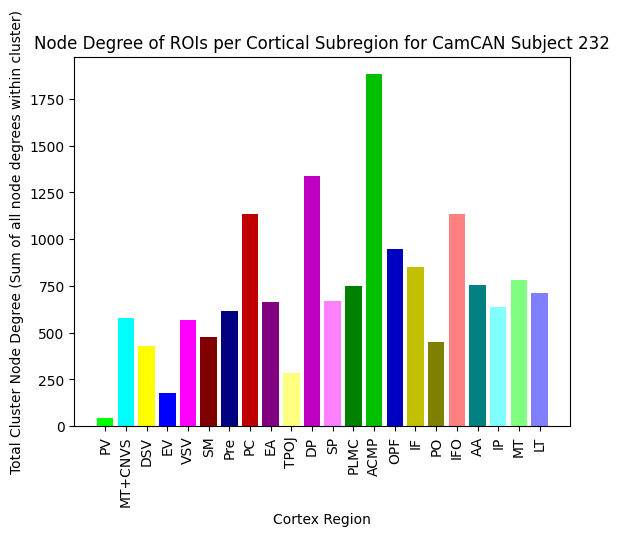

THIS IS THE SBJ ID:  233
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


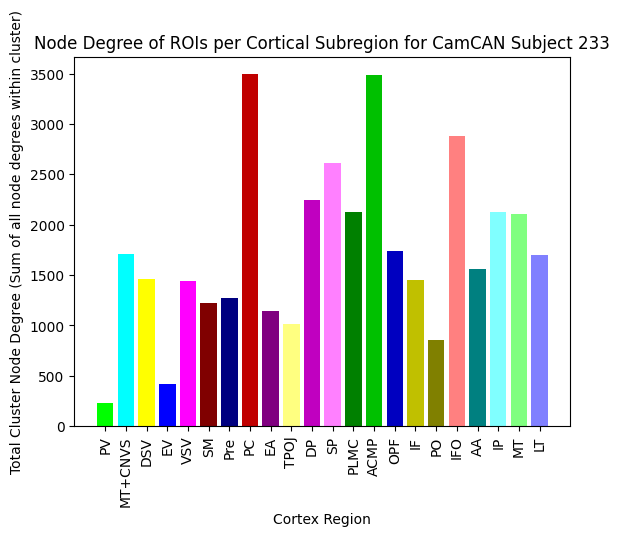

THIS IS THE SBJ ID:  234
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


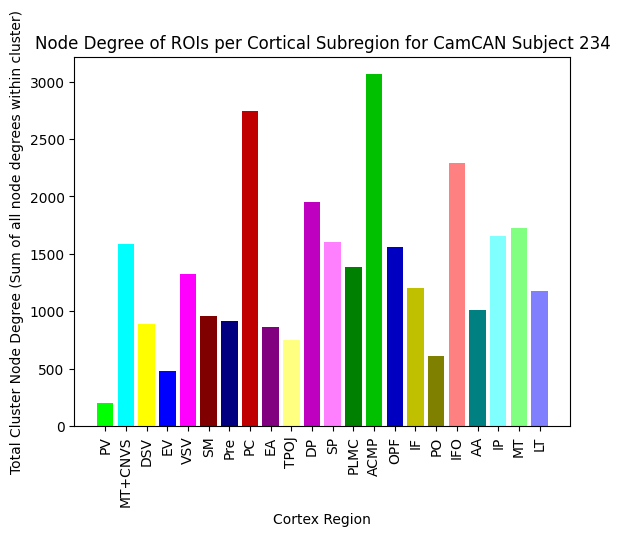

THIS IS THE SBJ ID:  235
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


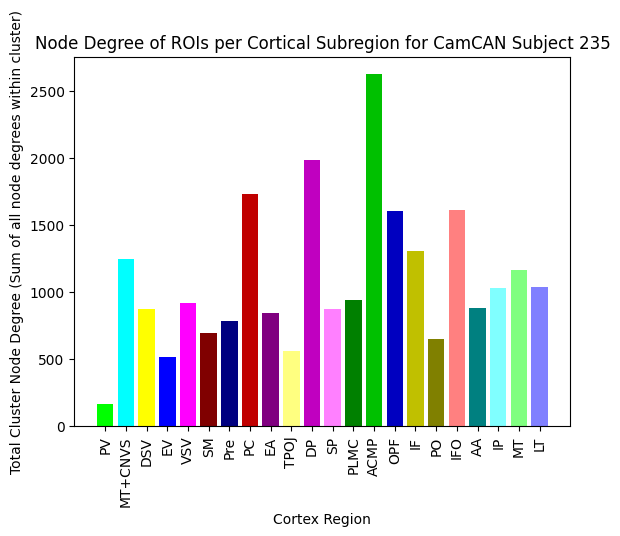

THIS IS THE SBJ ID:  236
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


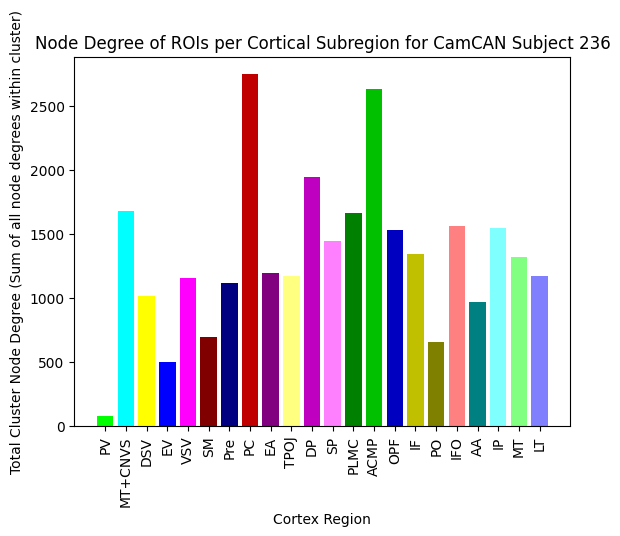

THIS IS THE SBJ ID:  237
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


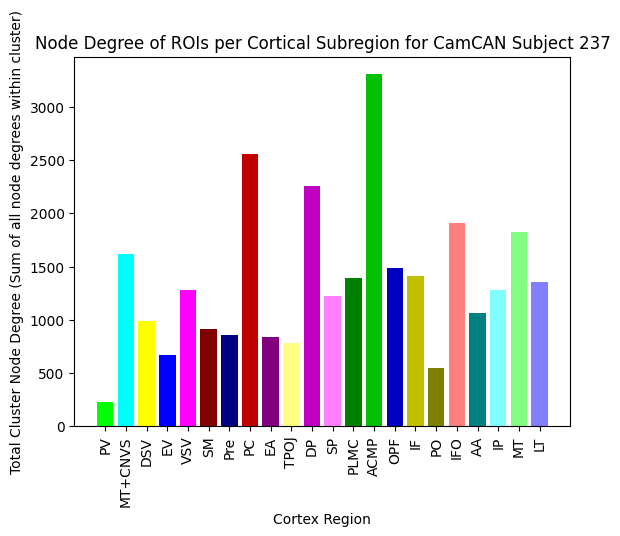

THIS IS THE SBJ ID:  238
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


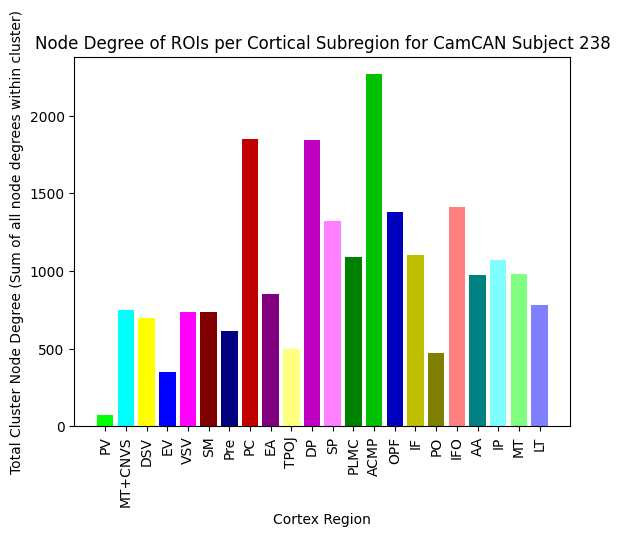

THIS IS THE SBJ ID:  239
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


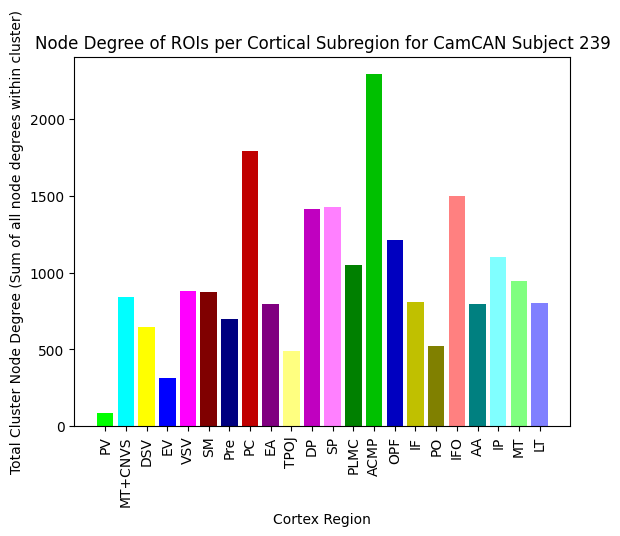

THIS IS THE SBJ ID:  240
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


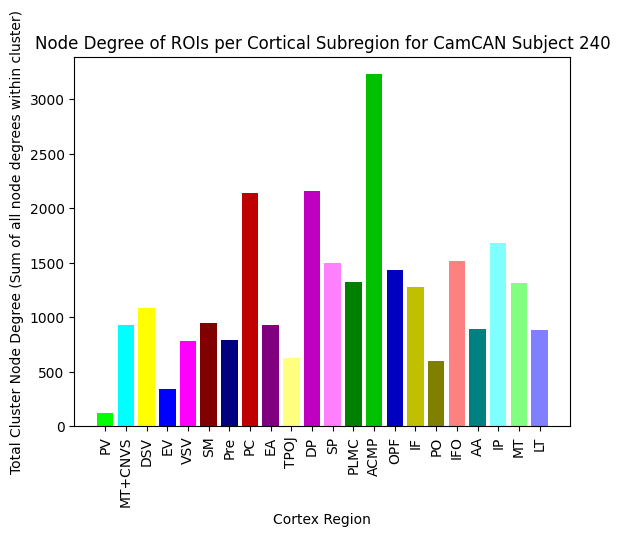

THIS IS THE SBJ ID:  241
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


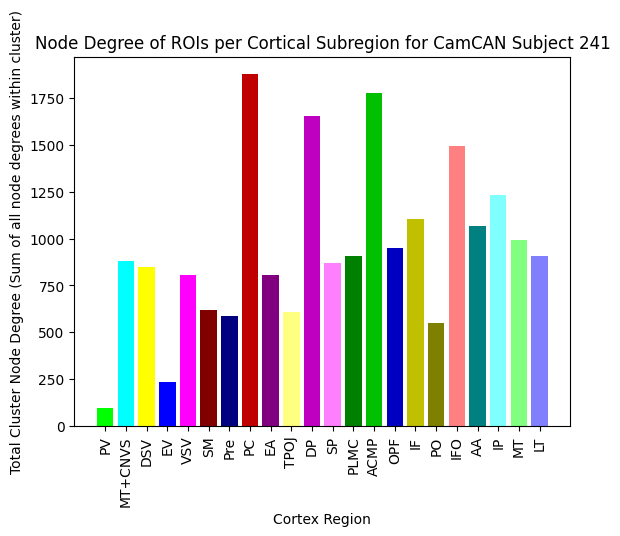

THIS IS THE SBJ ID:  242
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


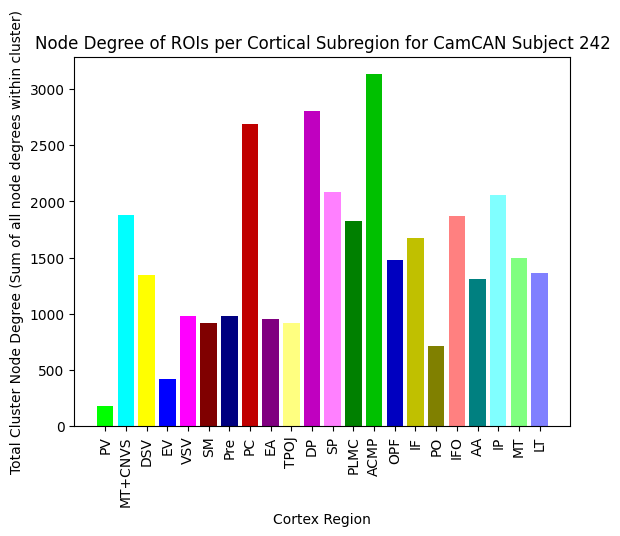

THIS IS THE SBJ ID:  243
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


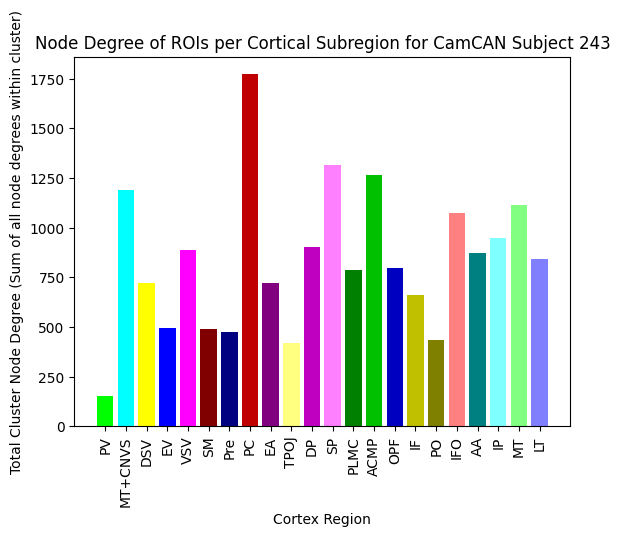

THIS IS THE SBJ ID:  244
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


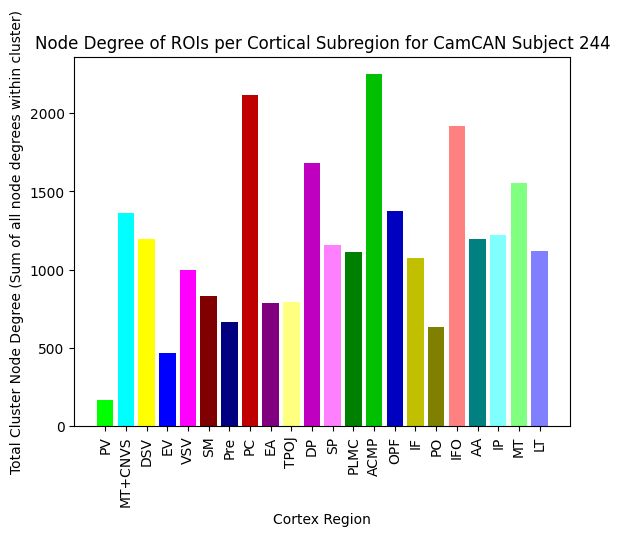

THIS IS THE SBJ ID:  245
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


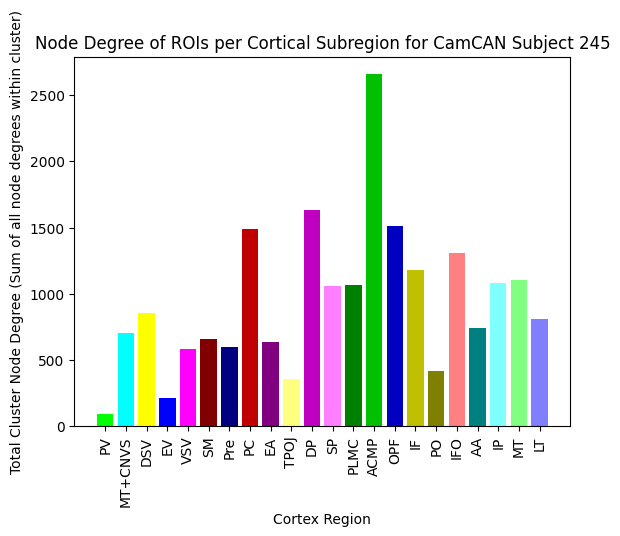

THIS IS THE SBJ ID:  246
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


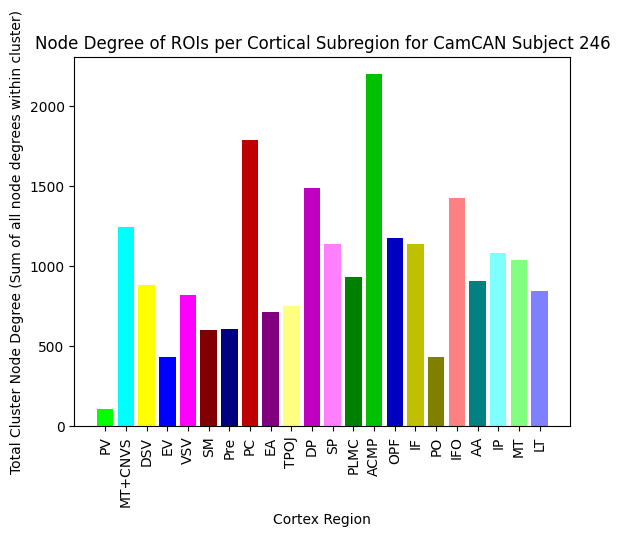

THIS IS THE SBJ ID:  247
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


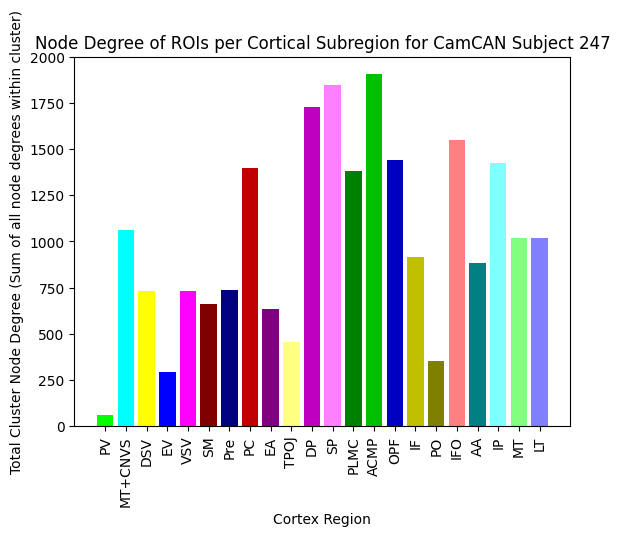

THIS IS THE SBJ ID:  248
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


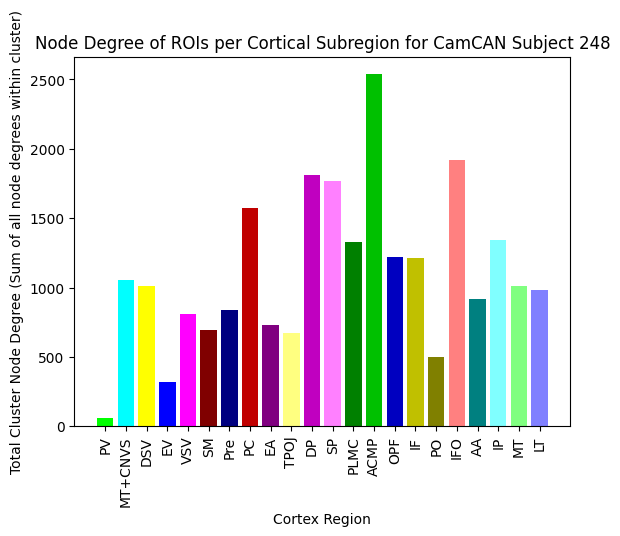

THIS IS THE SBJ ID:  249
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


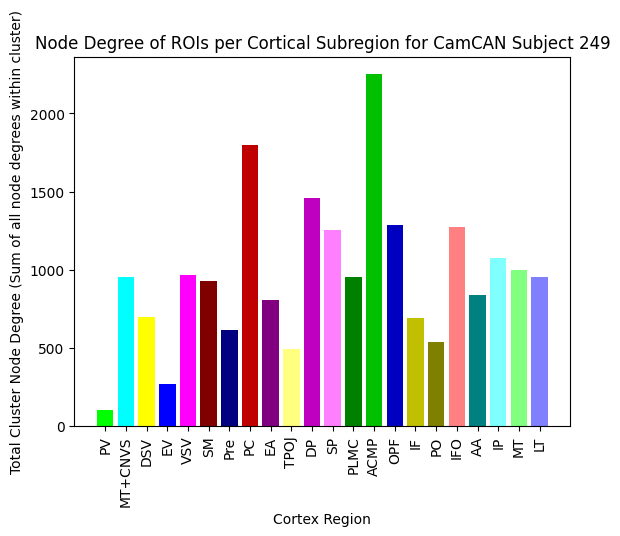

THIS IS THE SBJ ID:  250
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


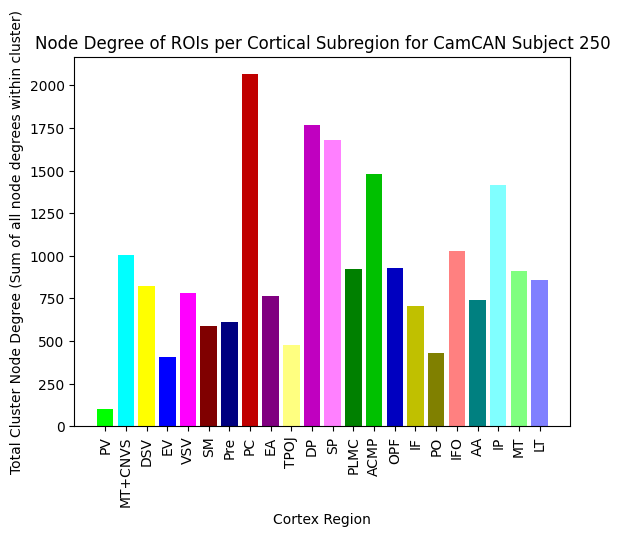

THIS IS THE SBJ ID:  251
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


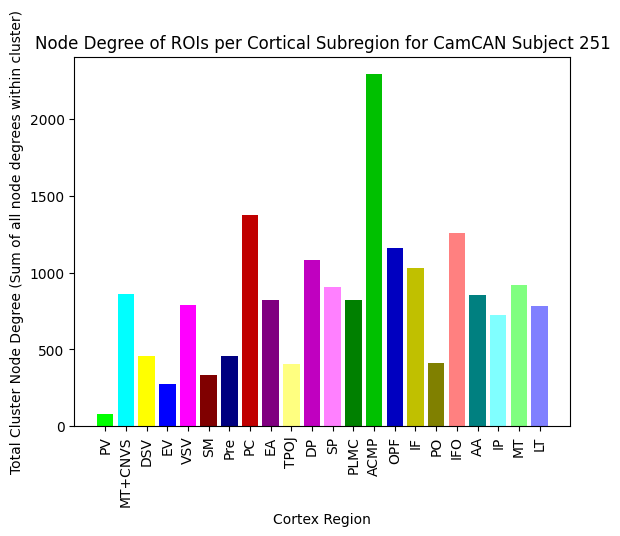

THIS IS THE SBJ ID:  252
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


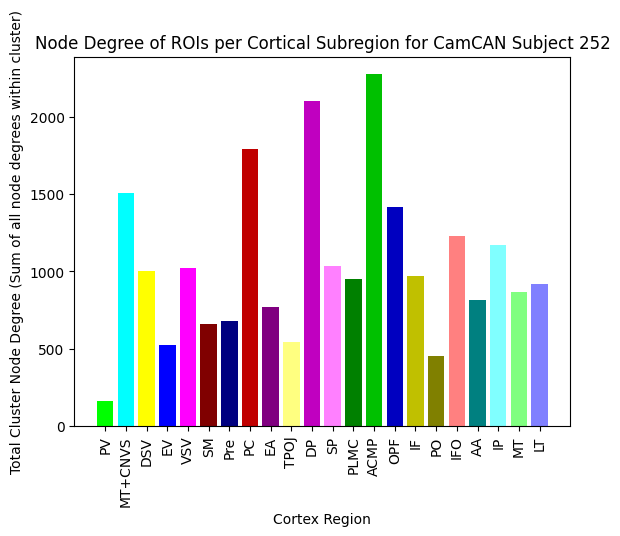

THIS IS THE SBJ ID:  253
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


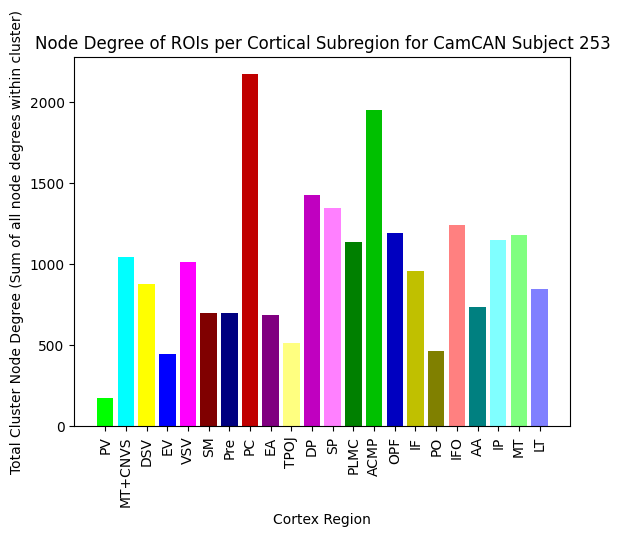

THIS IS THE SBJ ID:  254
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


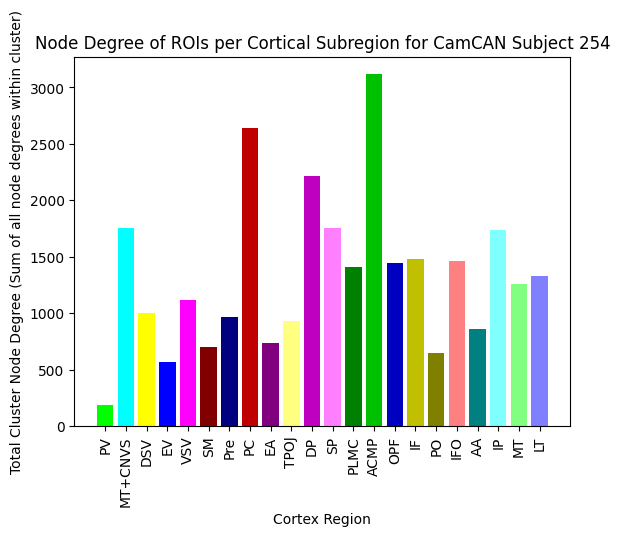

THIS IS THE SBJ ID:  255
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


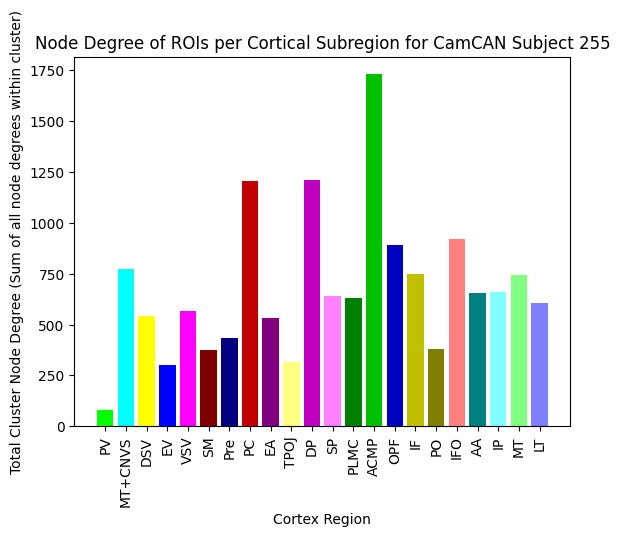

THIS IS THE SBJ ID:  256
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


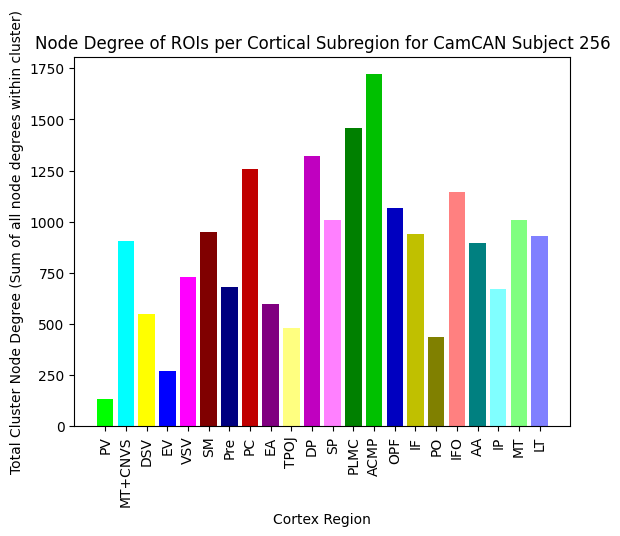

THIS IS THE SBJ ID:  257
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


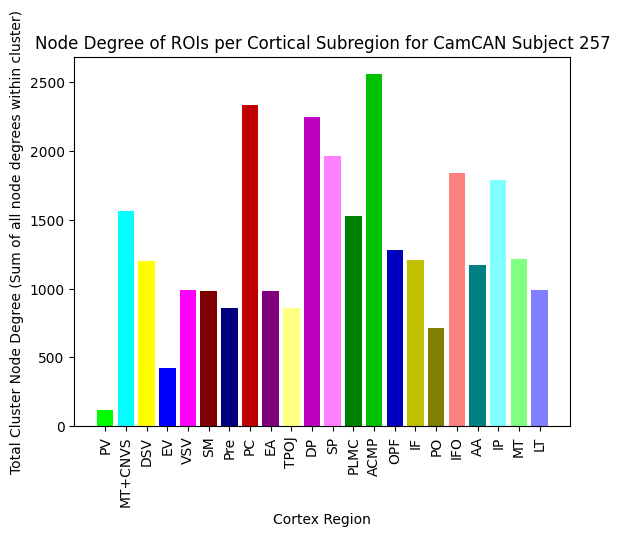

THIS IS THE SBJ ID:  258
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


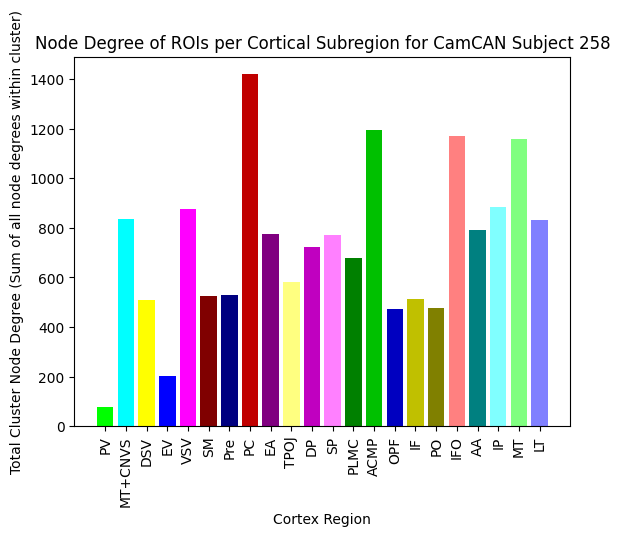

THIS IS THE SBJ ID:  259
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


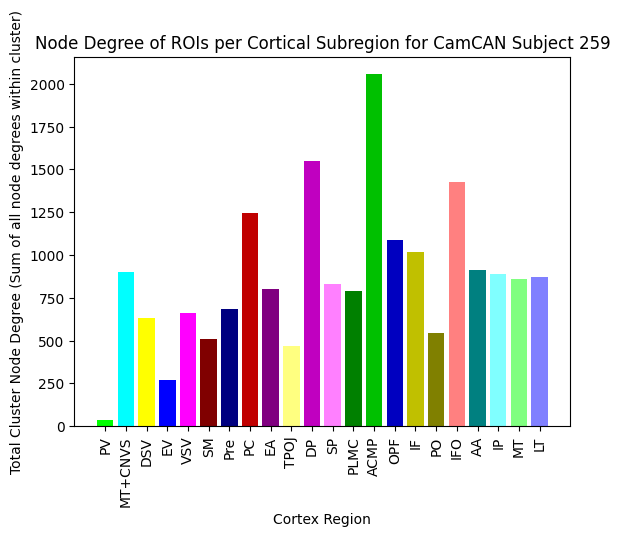

THIS IS THE SBJ ID:  260
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


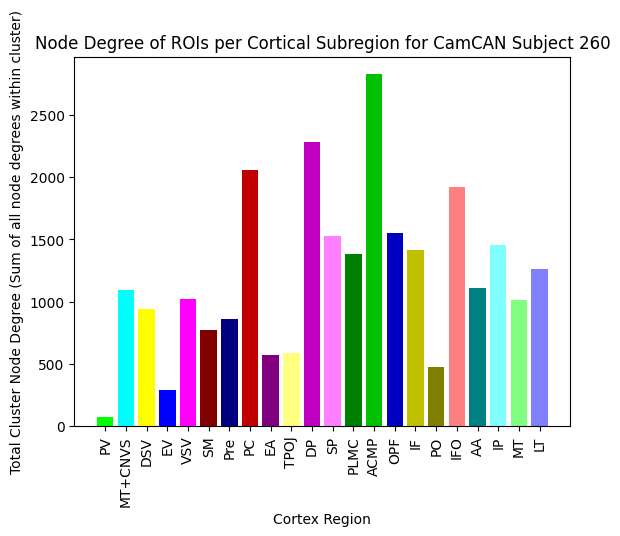

THIS IS THE SBJ ID:  261
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


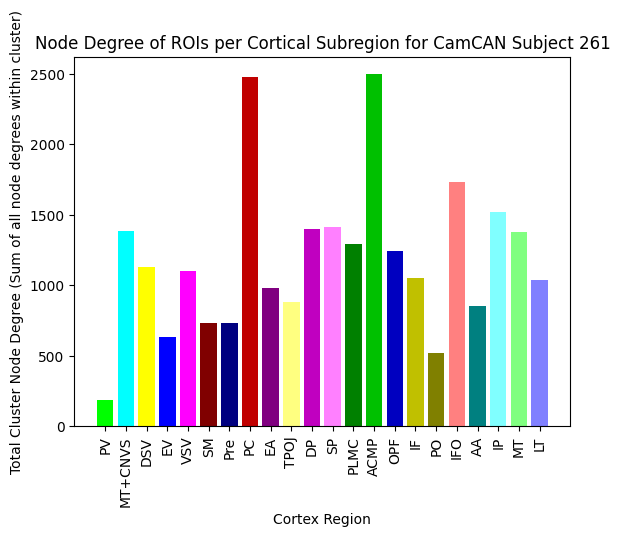

THIS IS THE SBJ ID:  262
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


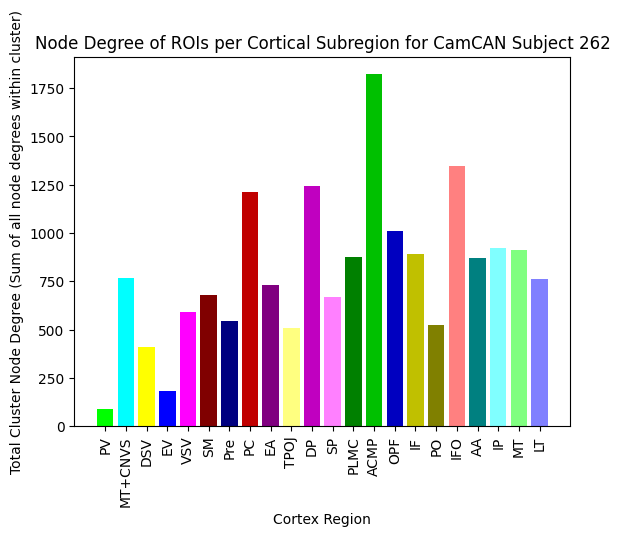

THIS IS THE SBJ ID:  263
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


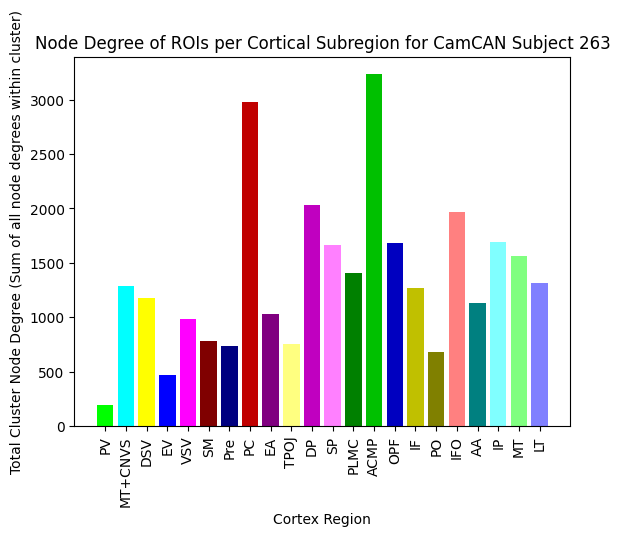

THIS IS THE SBJ ID:  264
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


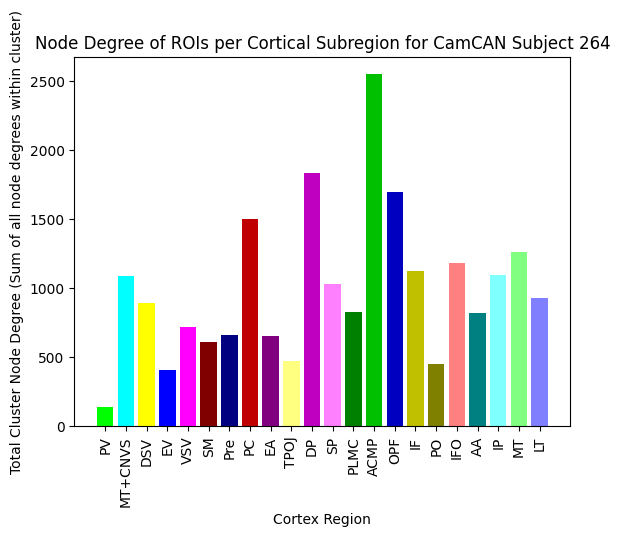

THIS IS THE SBJ ID:  265
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


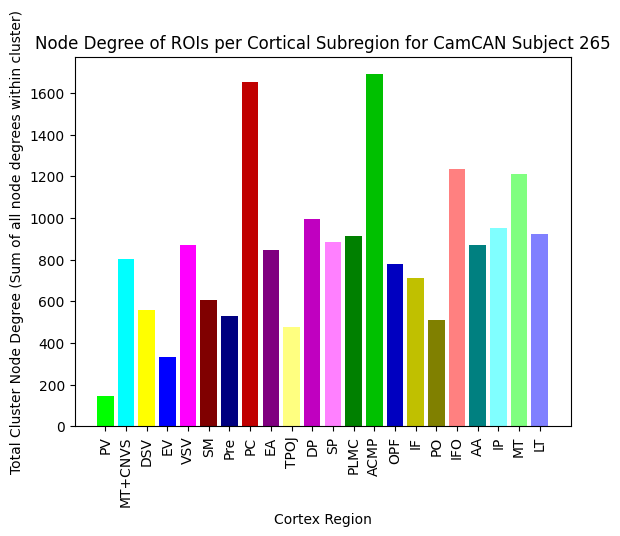

THIS IS THE SBJ ID:  266
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


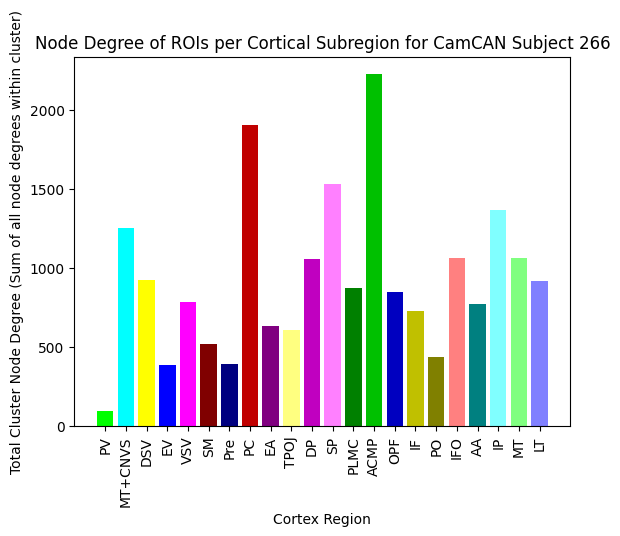

THIS IS THE SBJ ID:  267
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


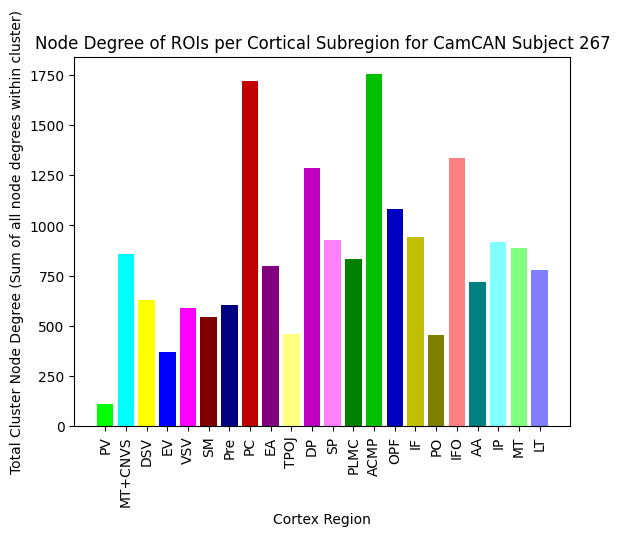

THIS IS THE SBJ ID:  268
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


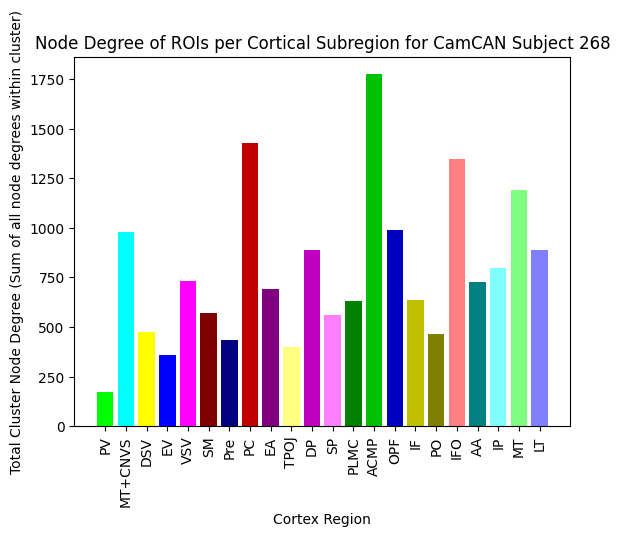

THIS IS THE SBJ ID:  269
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


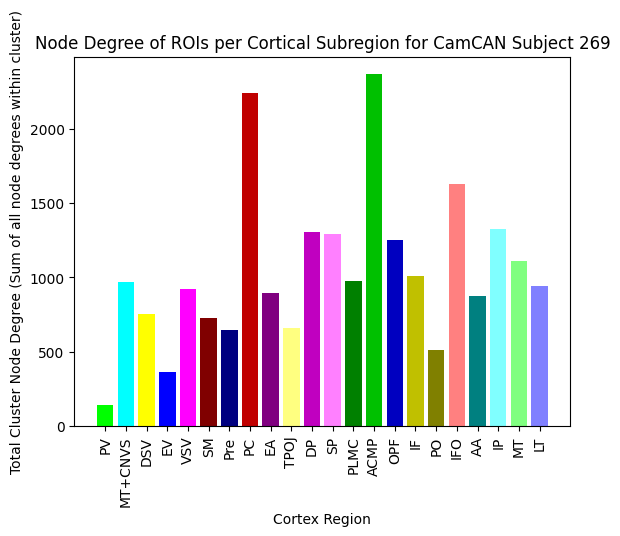

THIS IS THE SBJ ID:  270
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


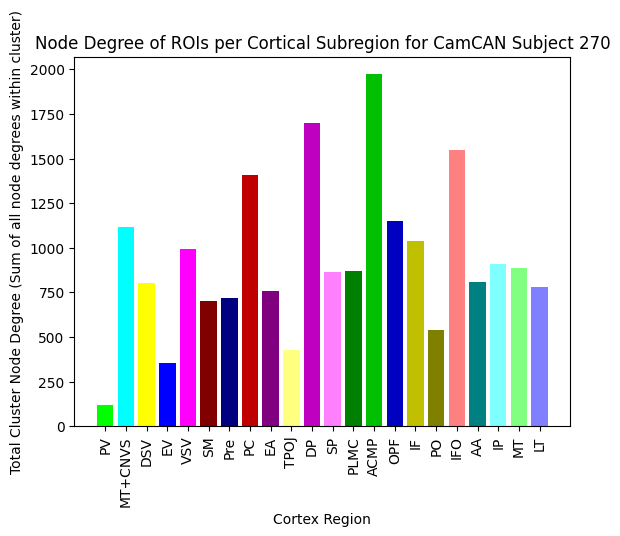

THIS IS THE SBJ ID:  271
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


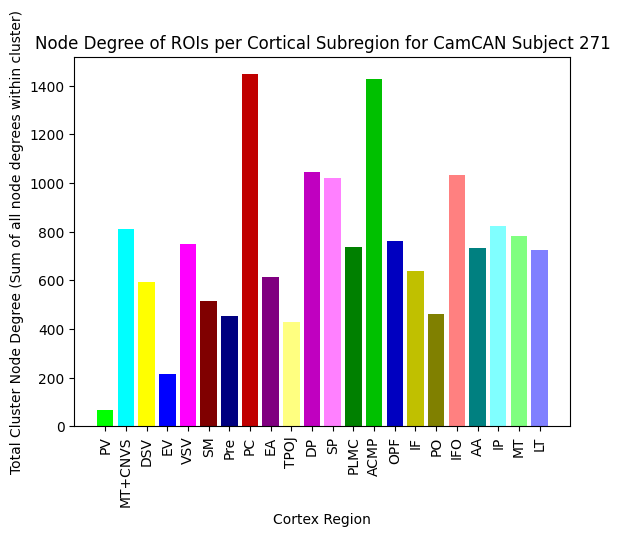

THIS IS THE SBJ ID:  272
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


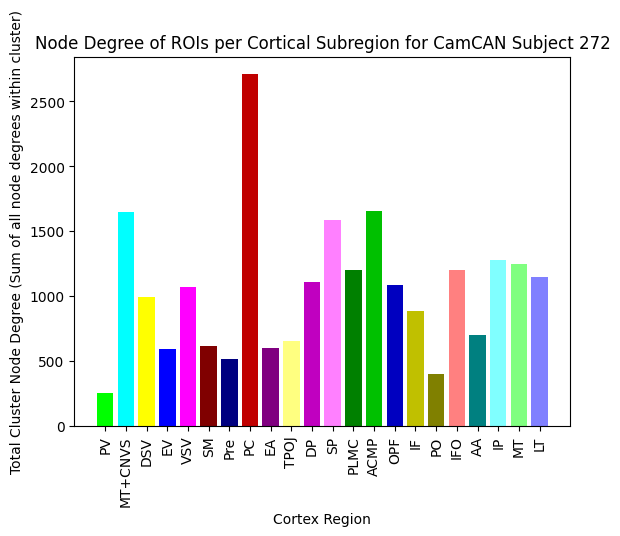

THIS IS THE SBJ ID:  273
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


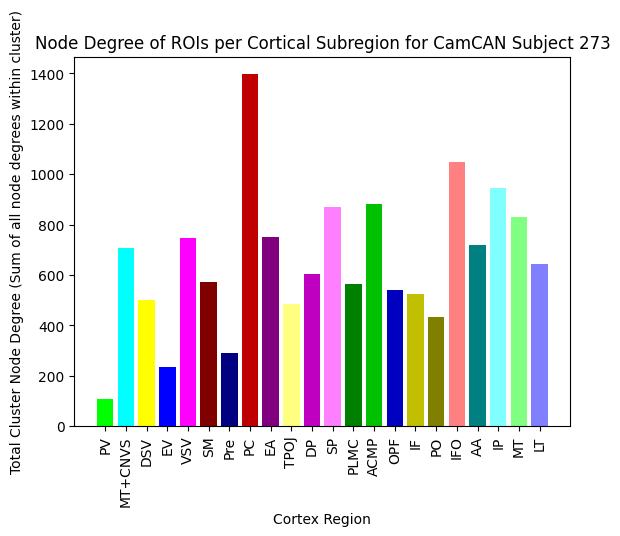

THIS IS THE SBJ ID:  274
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


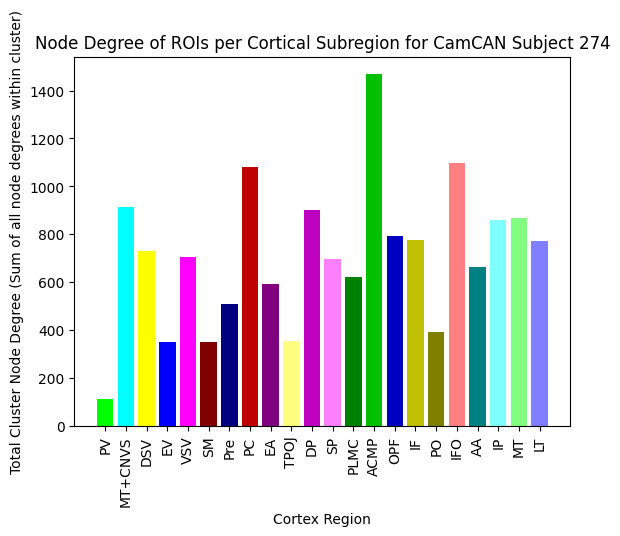

THIS IS THE SBJ ID:  275
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


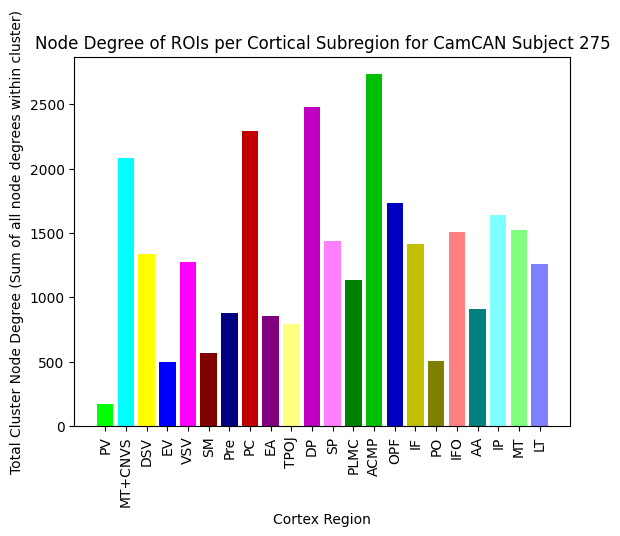

THIS IS THE SBJ ID:  276
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


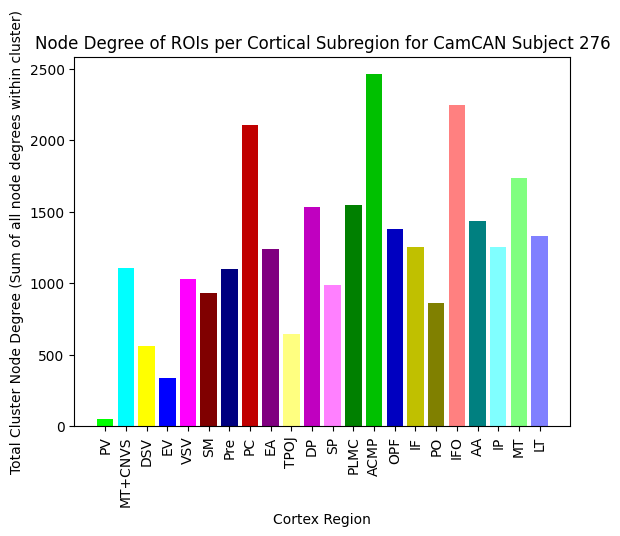

THIS IS THE SBJ ID:  277
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


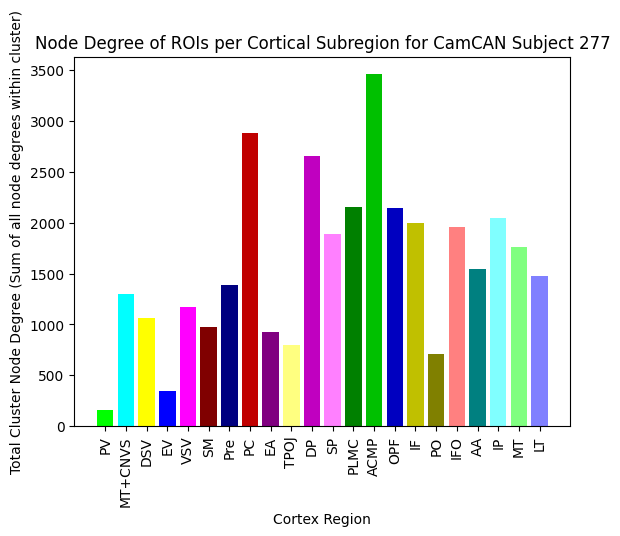

THIS IS THE SBJ ID:  278
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


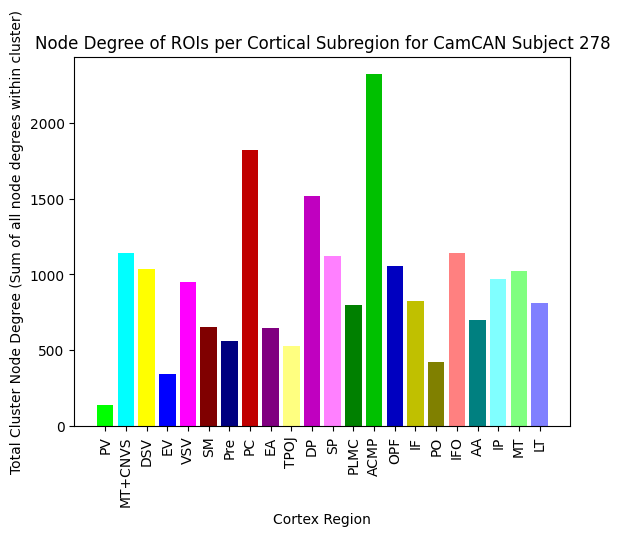

THIS IS THE SBJ ID:  279
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


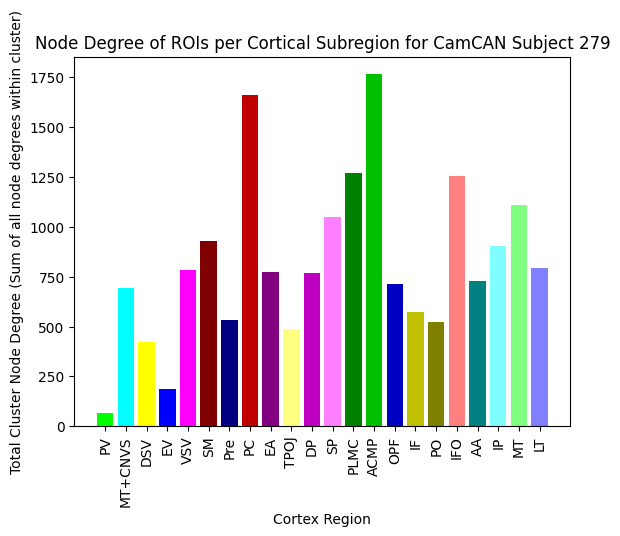

THIS IS THE SBJ ID:  280
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


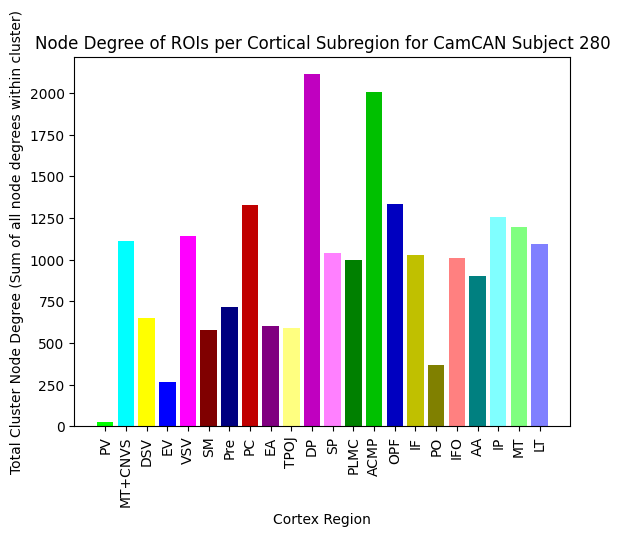

THIS IS THE SBJ ID:  281
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


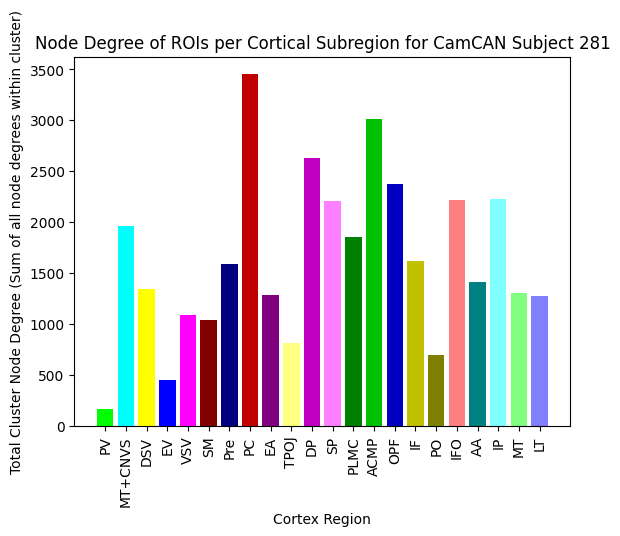

THIS IS THE SBJ ID:  282
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


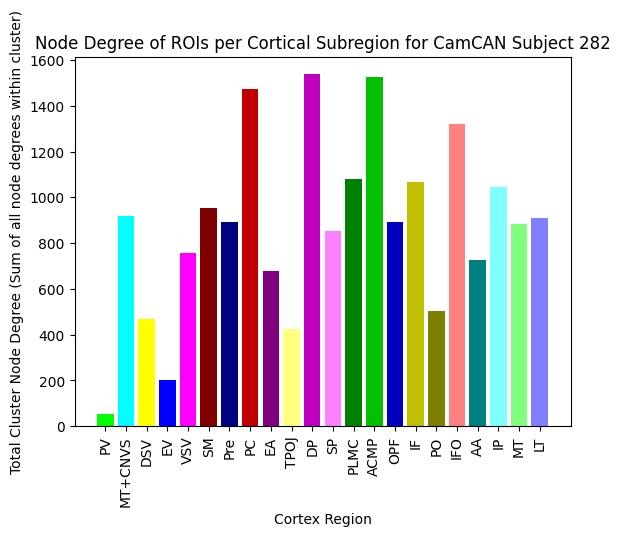

THIS IS THE SBJ ID:  283
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


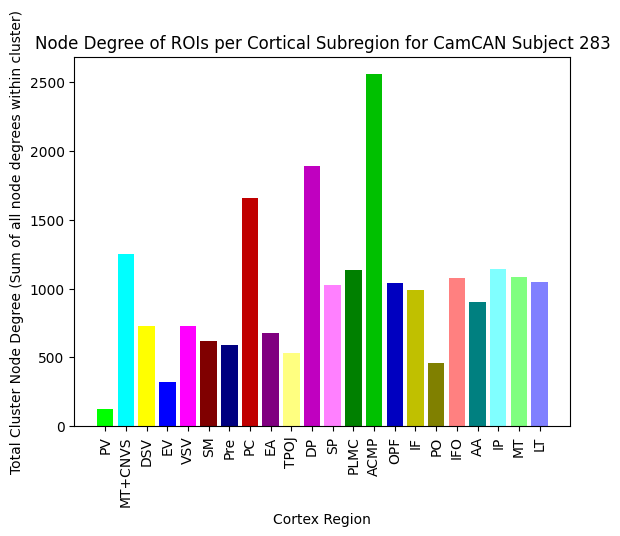

THIS IS THE SBJ ID:  284
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


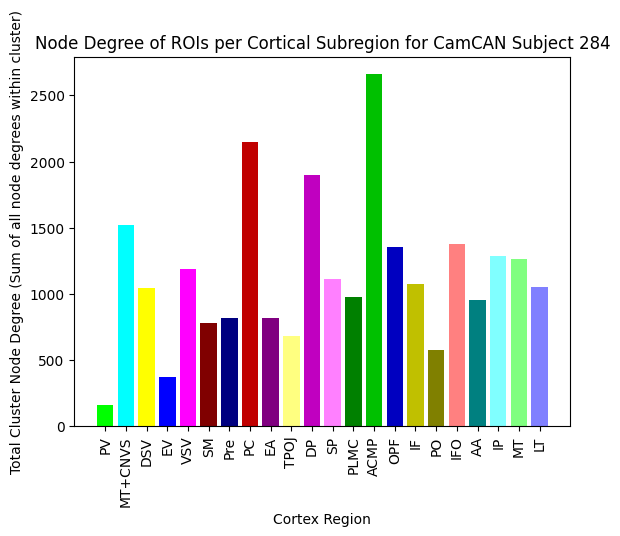

THIS IS THE SBJ ID:  285
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


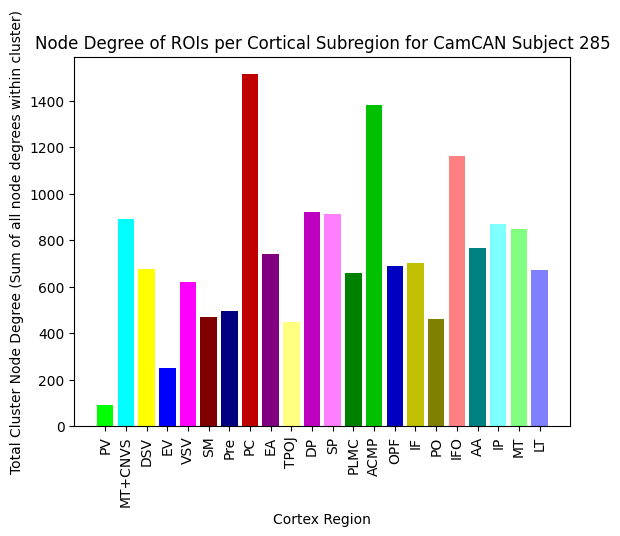

THIS IS THE SBJ ID:  286
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


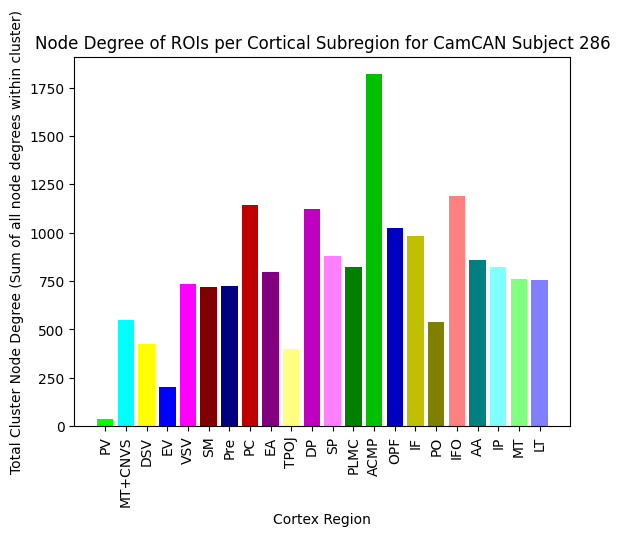

THIS IS THE SBJ ID:  287
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


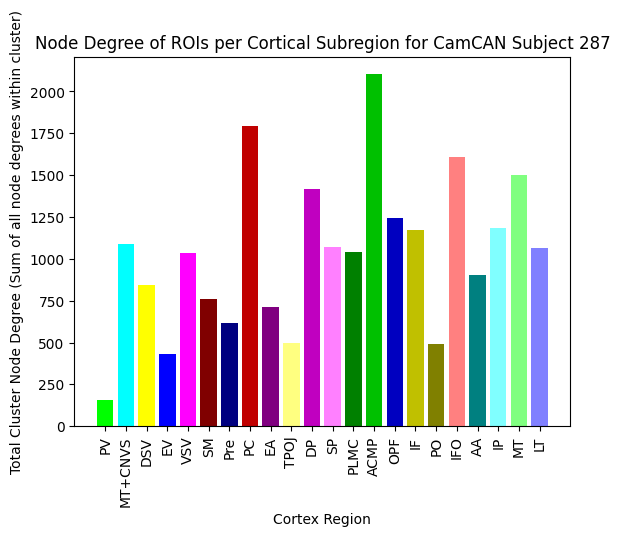

THIS IS THE SBJ ID:  288
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


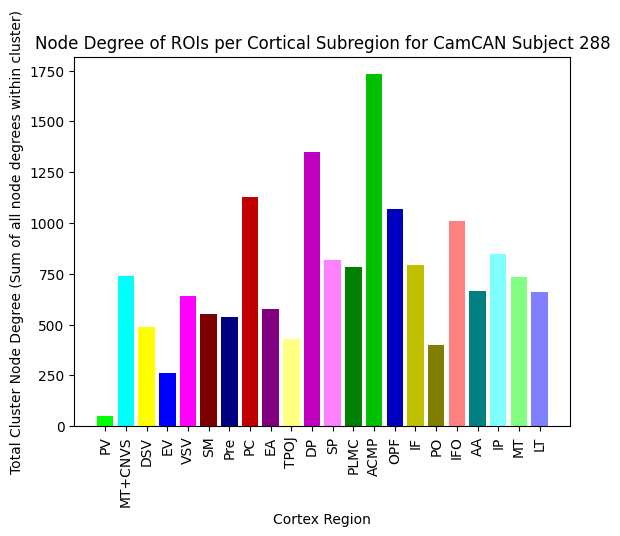

THIS IS THE SBJ ID:  289
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


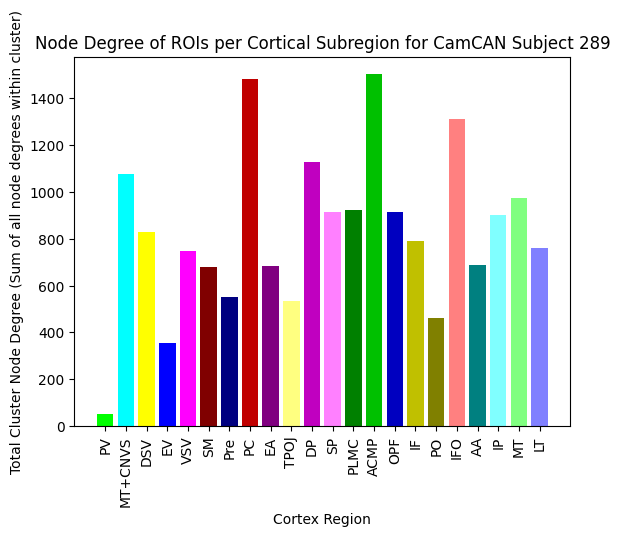

THIS IS THE SBJ ID:  290
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


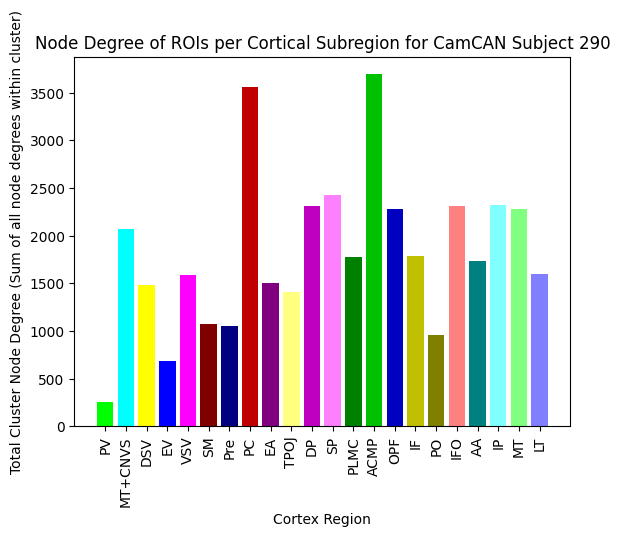

THIS IS THE SBJ ID:  291
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


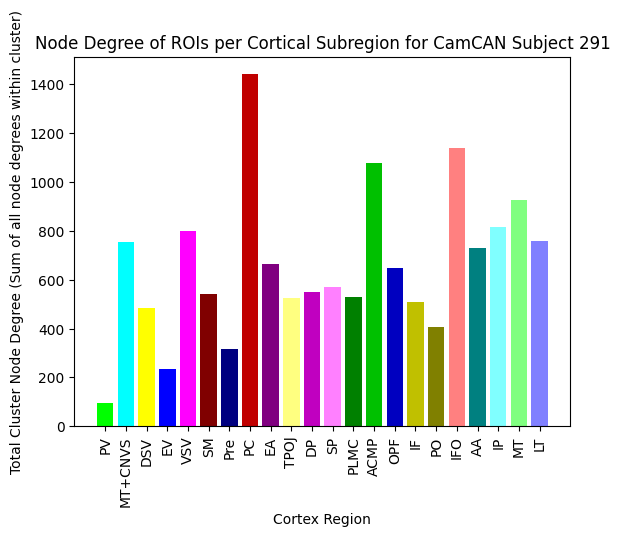

THIS IS THE SBJ ID:  292
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


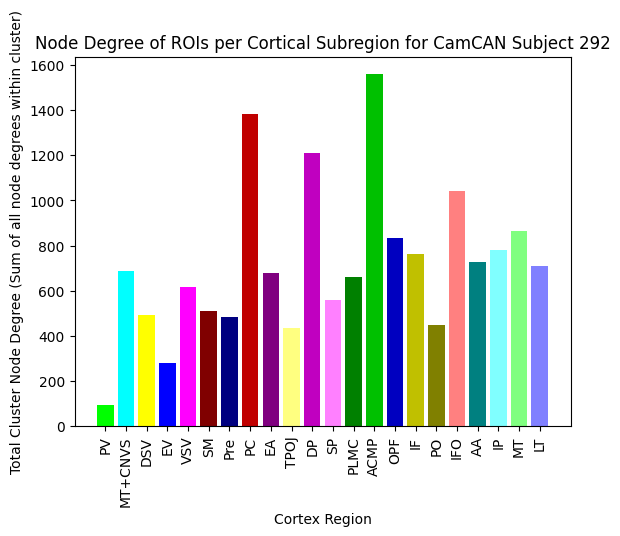

THIS IS THE SBJ ID:  293
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


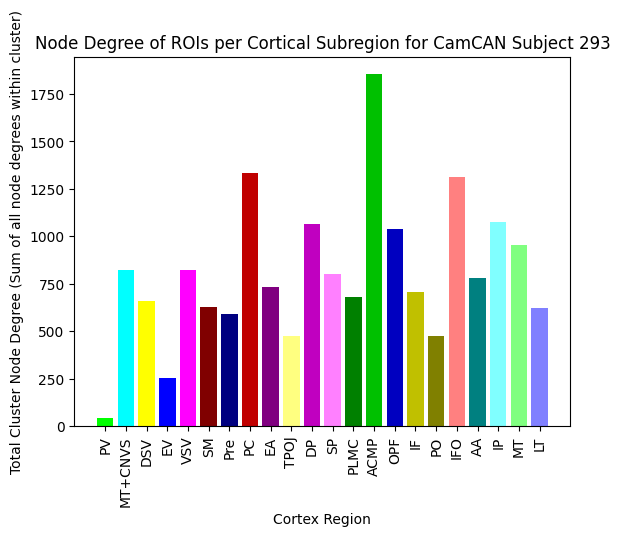

THIS IS THE SBJ ID:  294
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


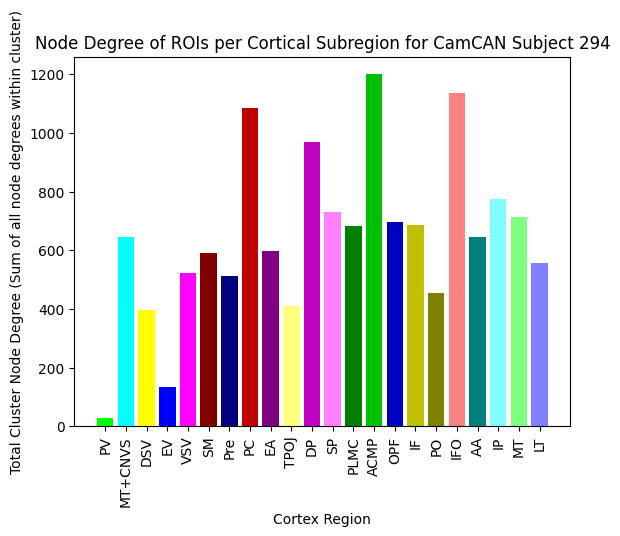

THIS IS THE SBJ ID:  295
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


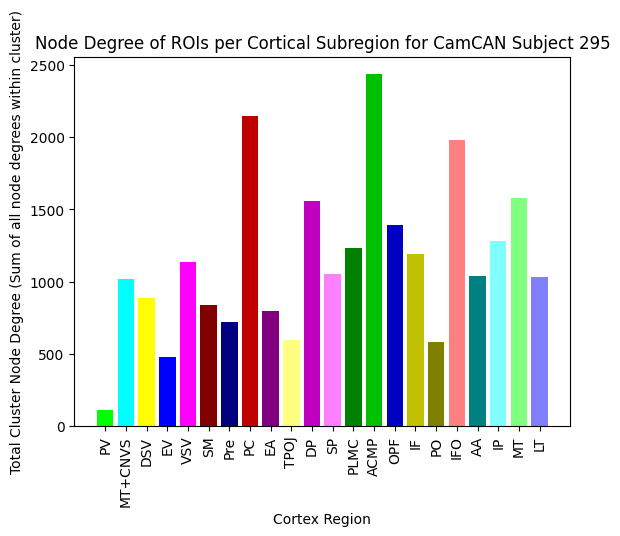

THIS IS THE SBJ ID:  296
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


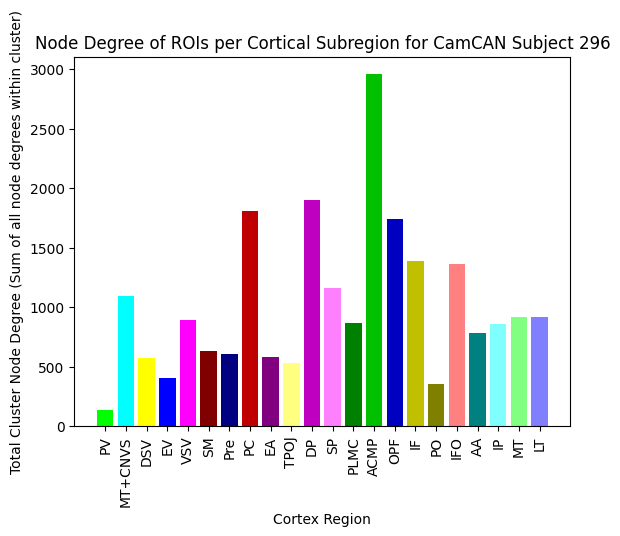

THIS IS THE SBJ ID:  297
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


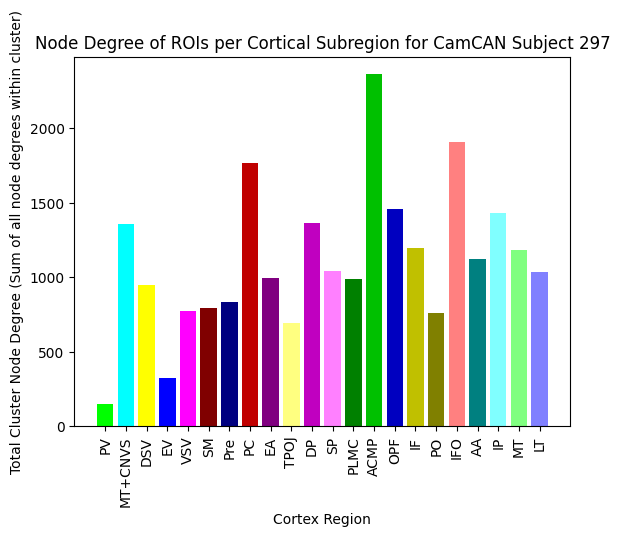

THIS IS THE SBJ ID:  298
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


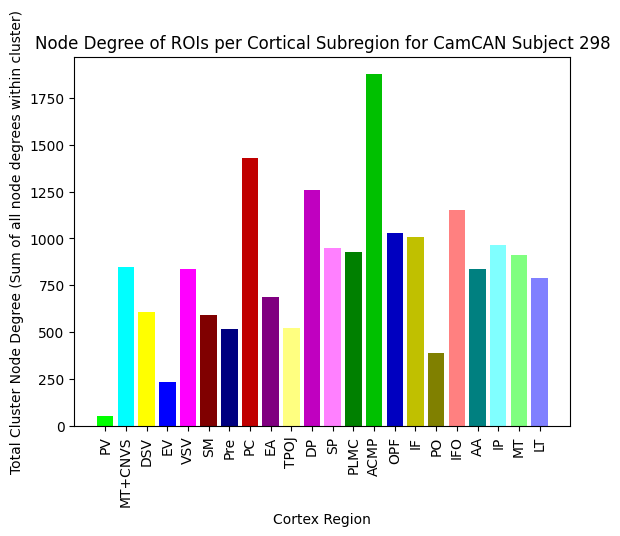

THIS IS THE SBJ ID:  299
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


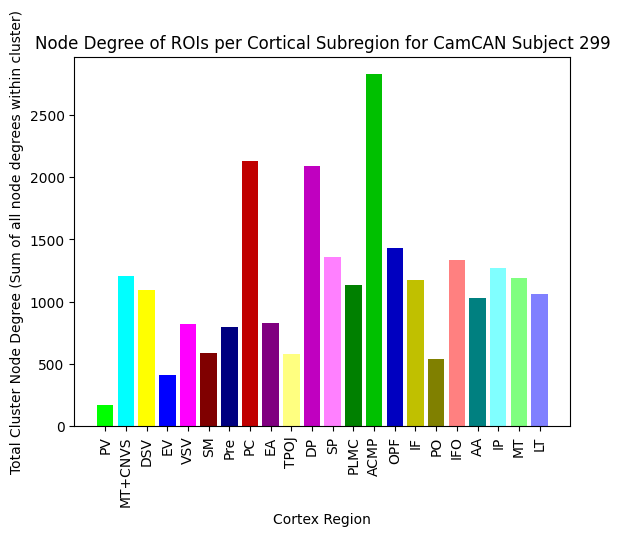

THIS IS THE SBJ ID:  300
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


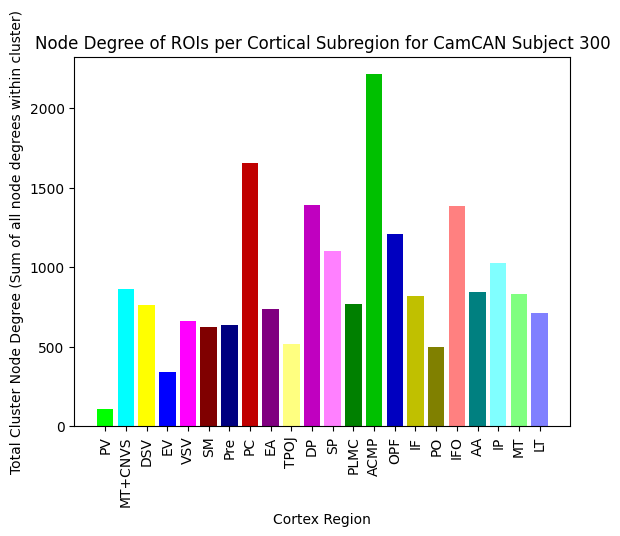

THIS IS THE SBJ ID:  301
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


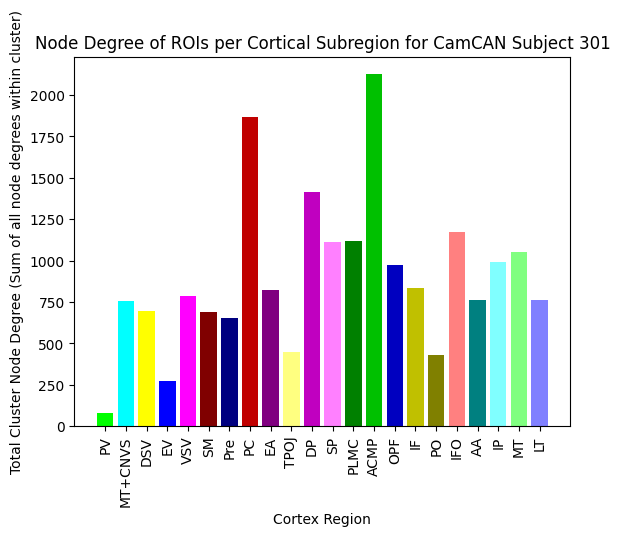

THIS IS THE SBJ ID:  302
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


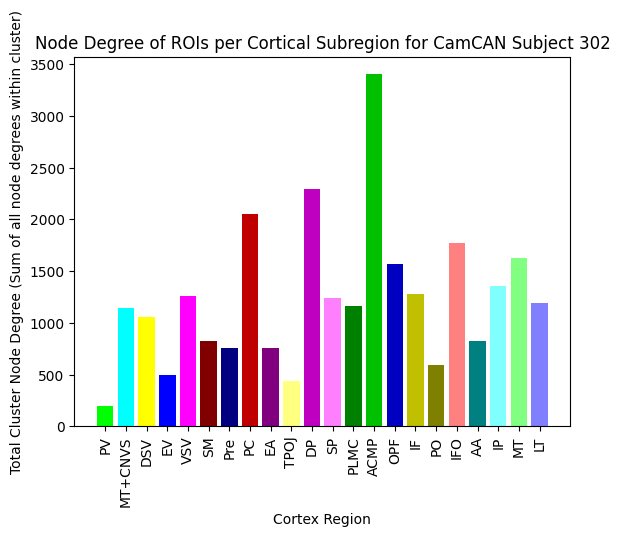

THIS IS THE SBJ ID:  303
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


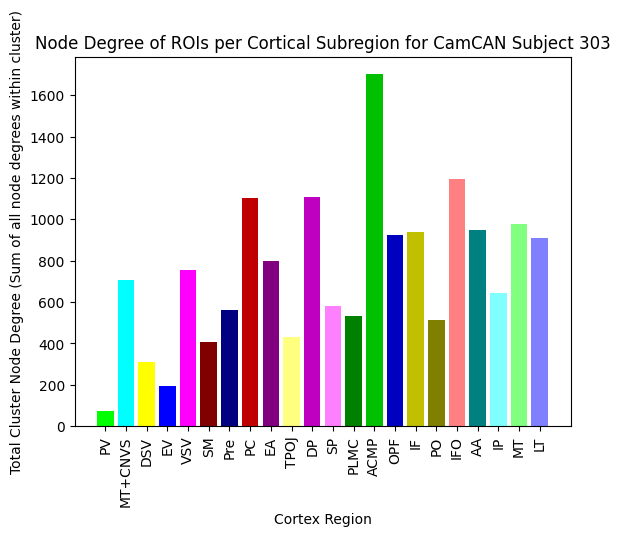

THIS IS THE SBJ ID:  304
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


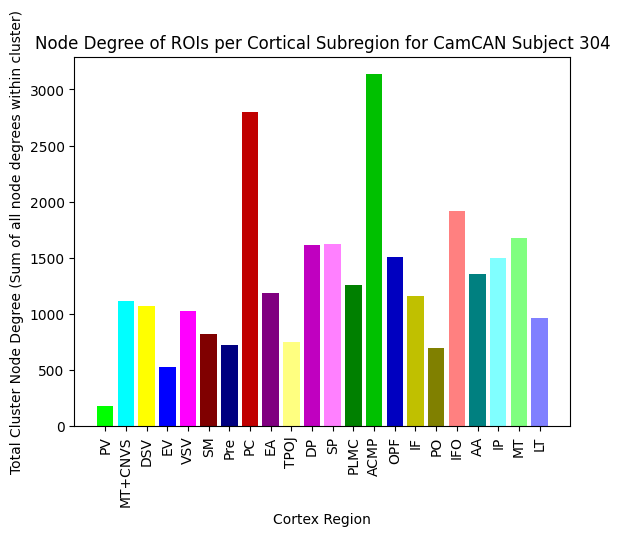

THIS IS THE SBJ ID:  305
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


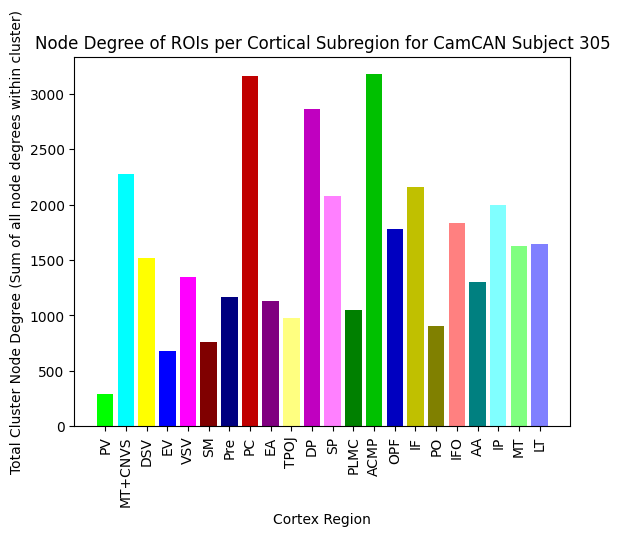

THIS IS THE SBJ ID:  306
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


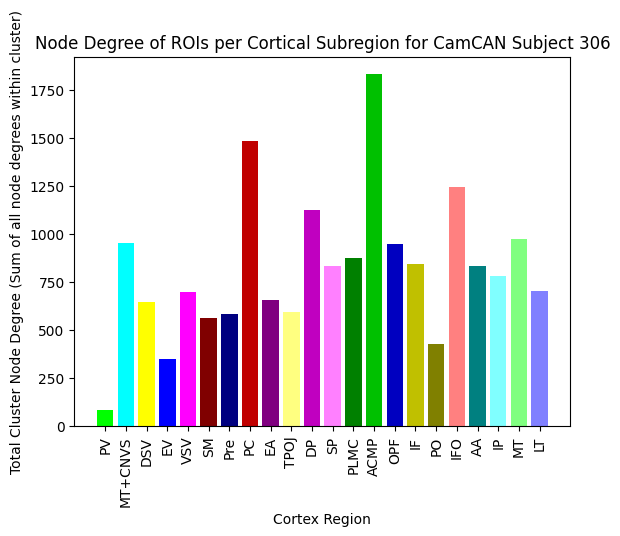

THIS IS THE SBJ ID:  307
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


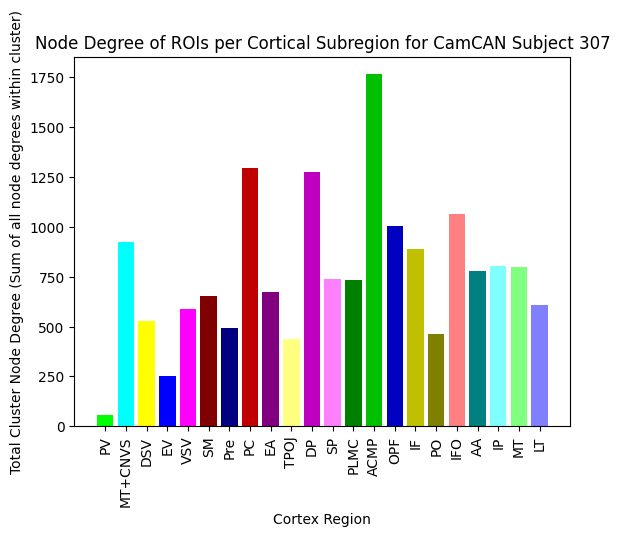

THIS IS THE SBJ ID:  308
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


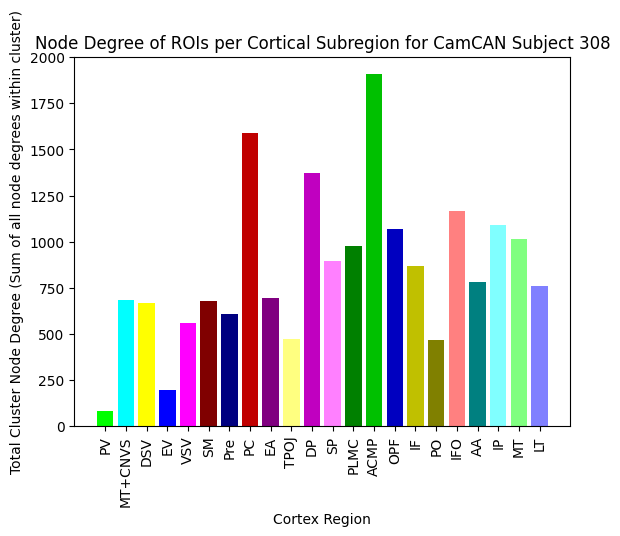

THIS IS THE SBJ ID:  309
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


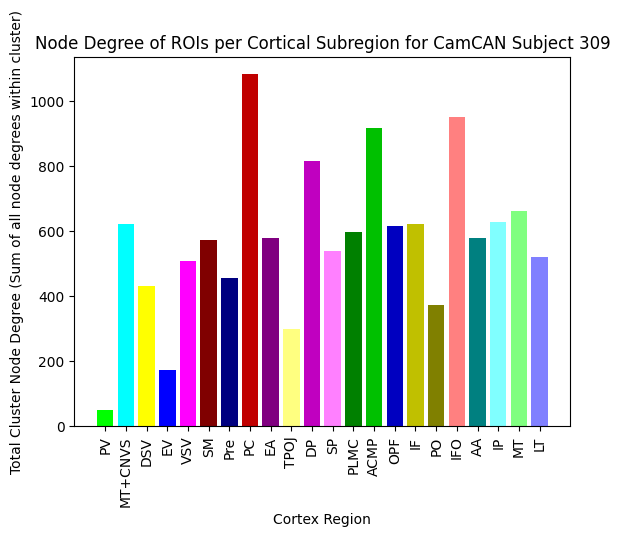

THIS IS THE SBJ ID:  310
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


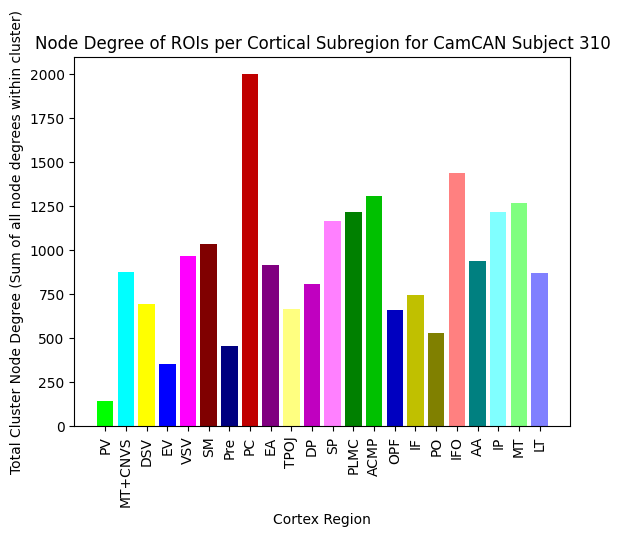

THIS IS THE SBJ ID:  311
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


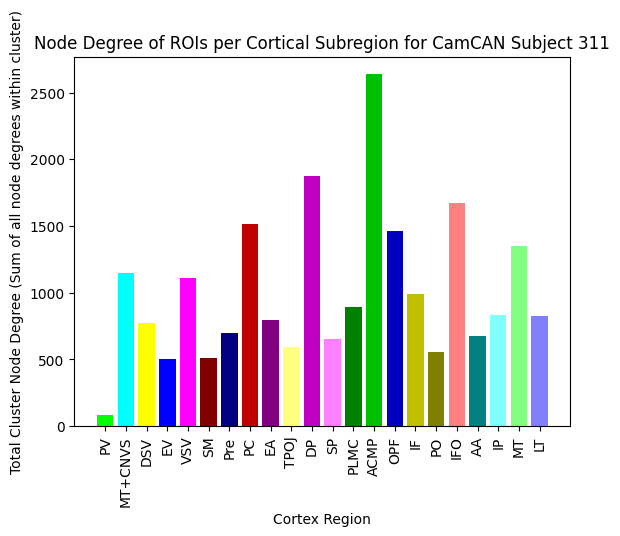

THIS IS THE SBJ ID:  312
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


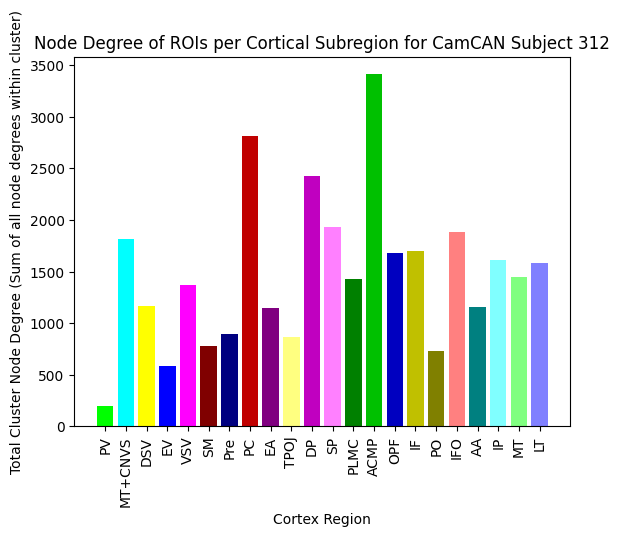

THIS IS THE SBJ ID:  313
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


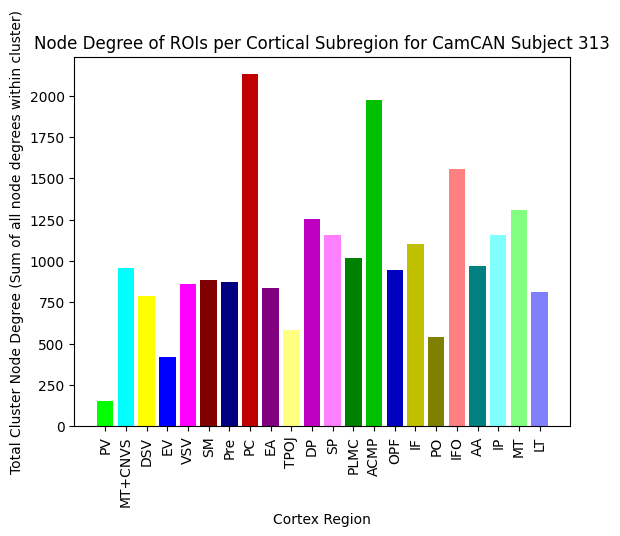

THIS IS THE SBJ ID:  314
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


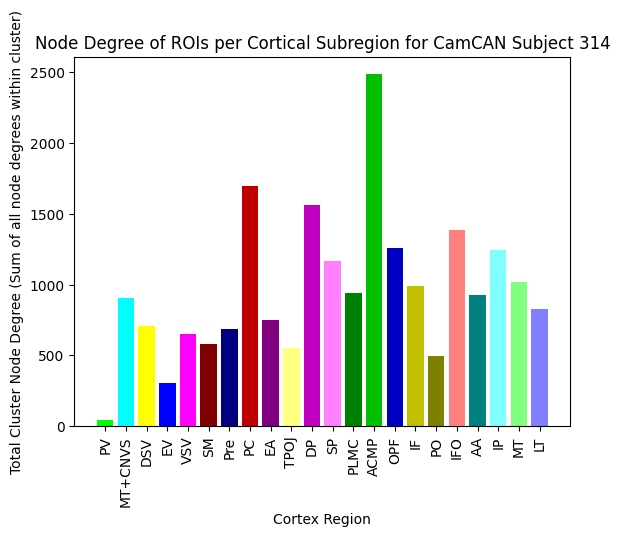

THIS IS THE SBJ ID:  315
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


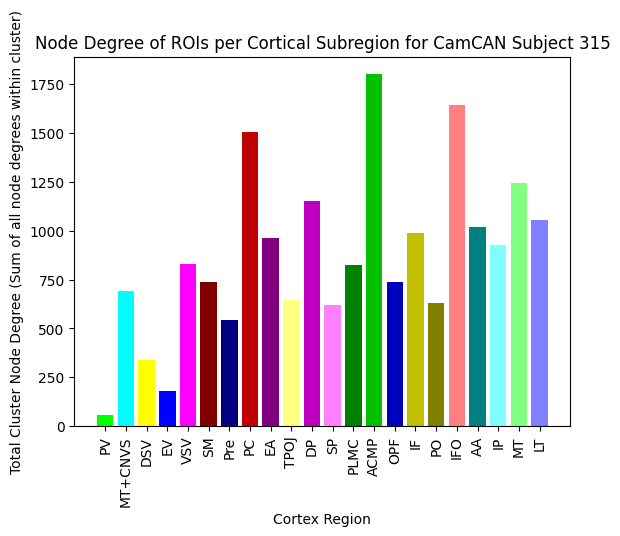

THIS IS THE SBJ ID:  316
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


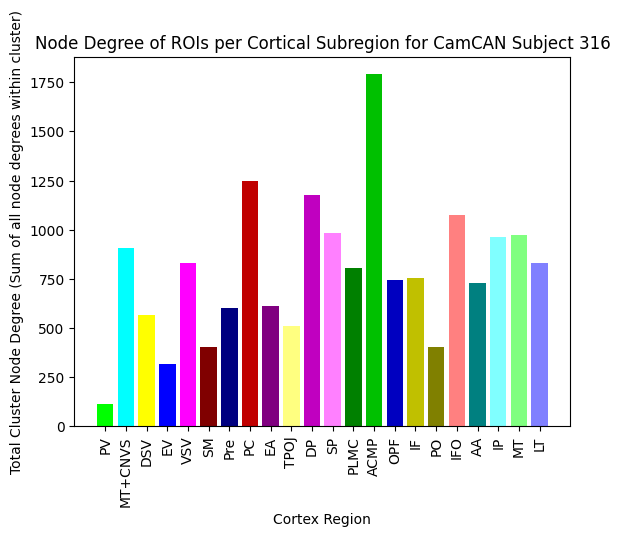

THIS IS THE SBJ ID:  317
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


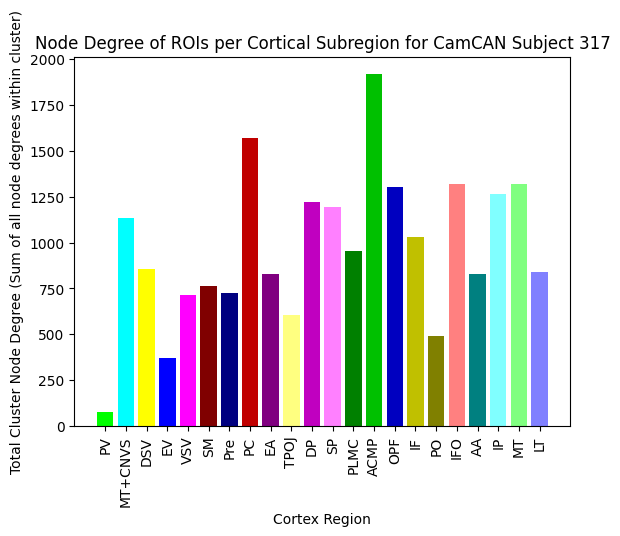

THIS IS THE SBJ ID:  318
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


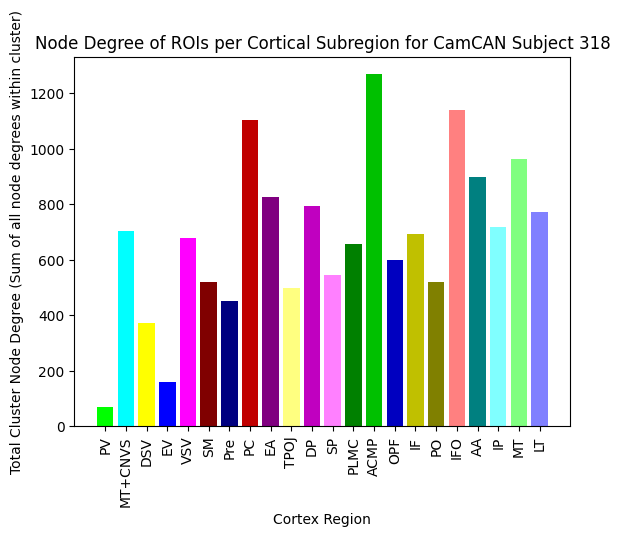

THIS IS THE SBJ ID:  319
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


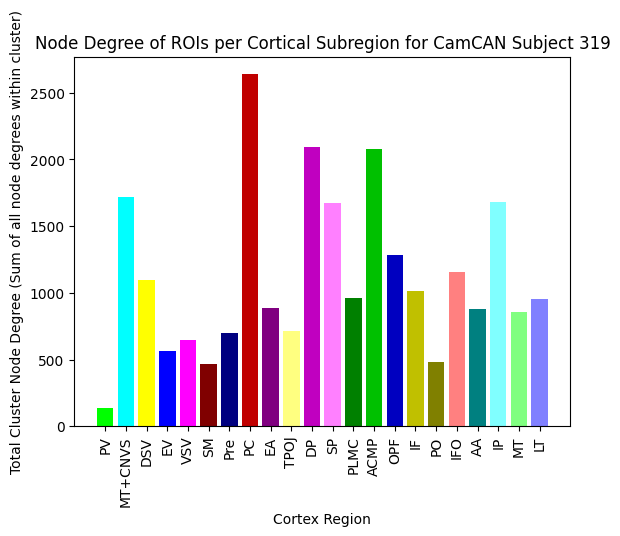

THIS IS THE SBJ ID:  320
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


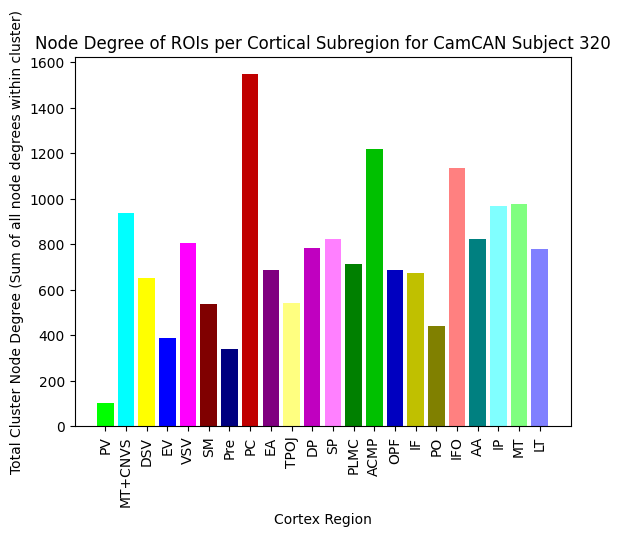

THIS IS THE SBJ ID:  321
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


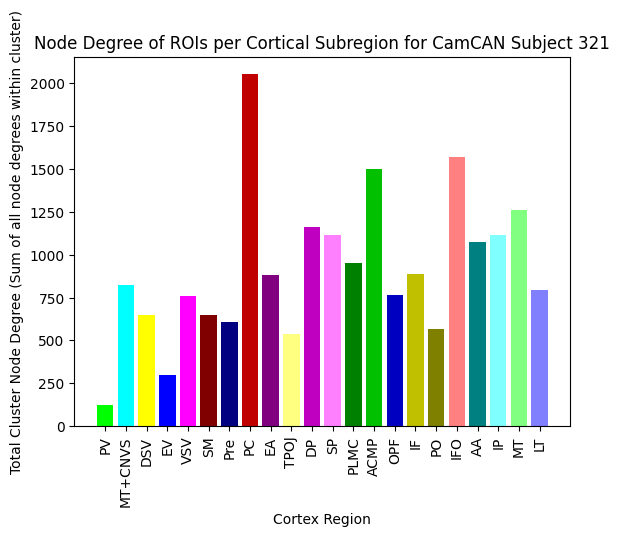

THIS IS THE SBJ ID:  322
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


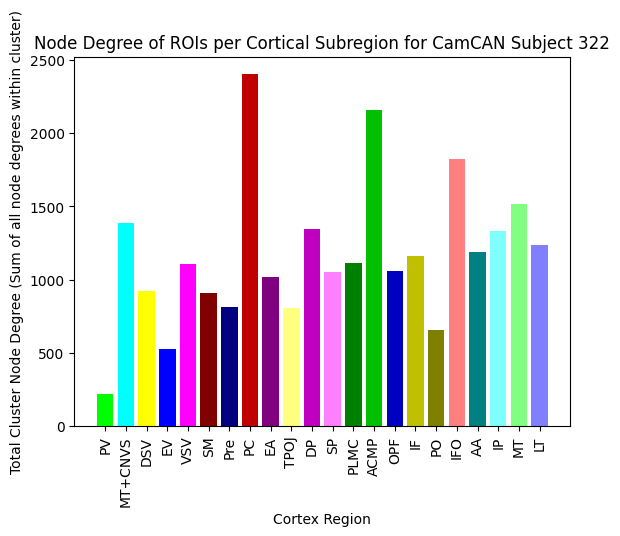

THIS IS THE SBJ ID:  323
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


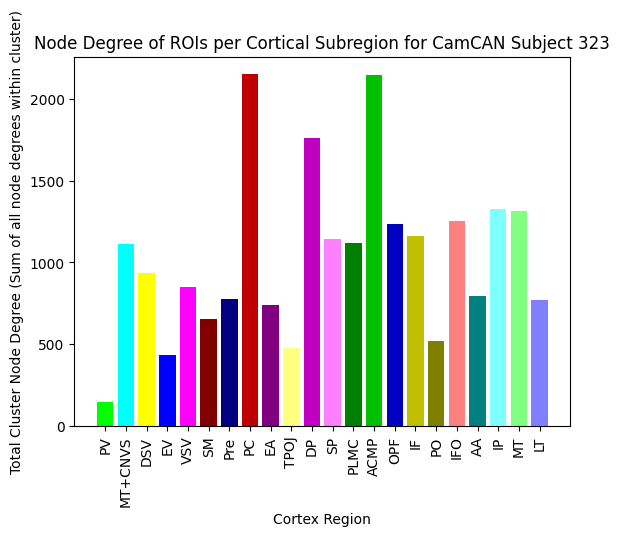

THIS IS THE SBJ ID:  324
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


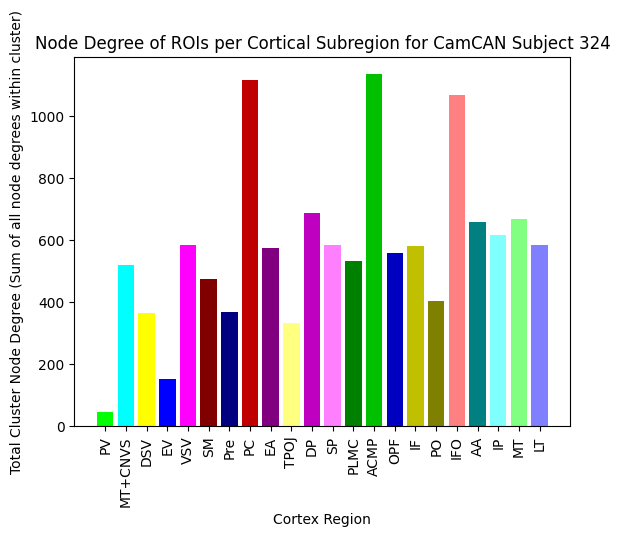

THIS IS THE SBJ ID:  325
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


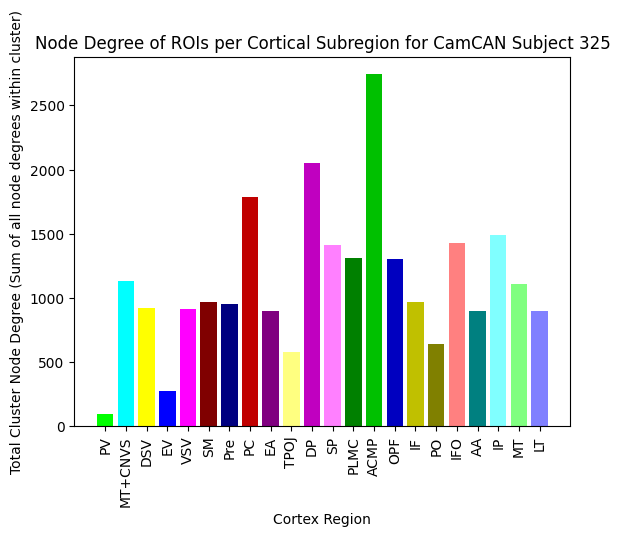

THIS IS THE SBJ ID:  326
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


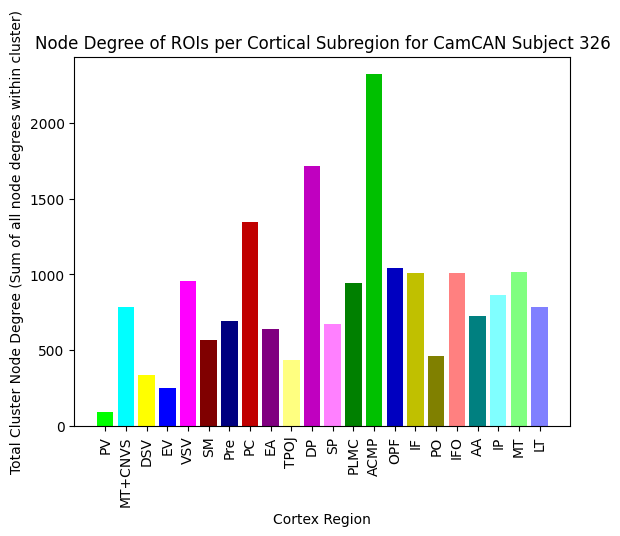

THIS IS THE SBJ ID:  327
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


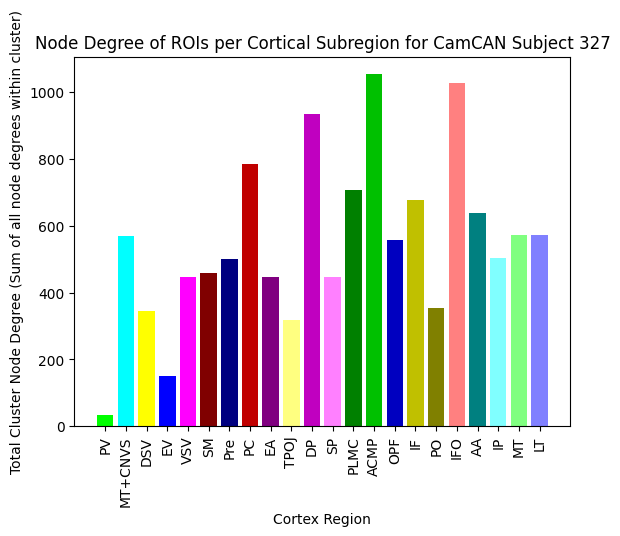

THIS IS THE SBJ ID:  328
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


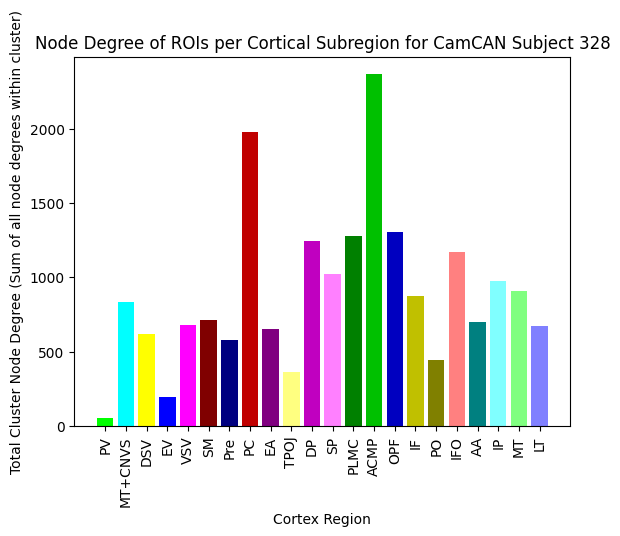

THIS IS THE SBJ ID:  329
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


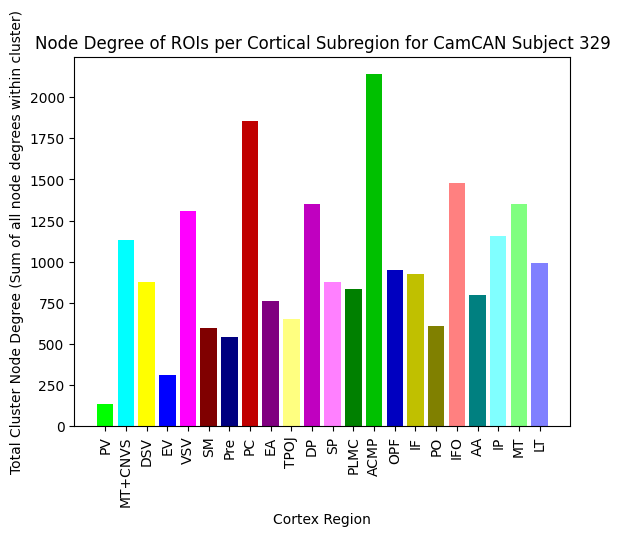

THIS IS THE SBJ ID:  330
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


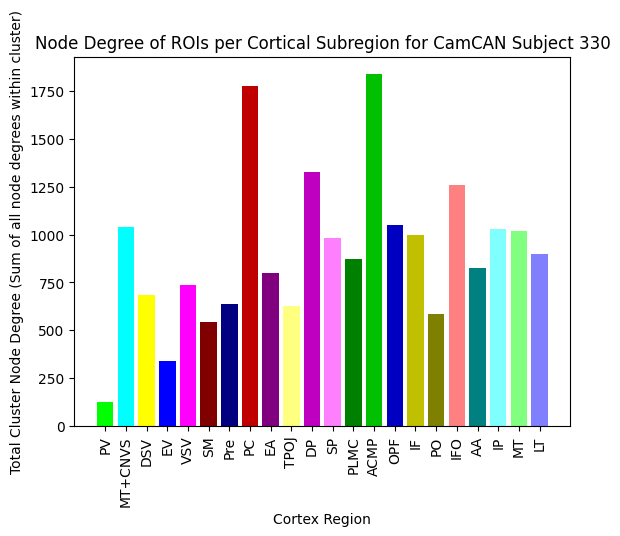

THIS IS THE SBJ ID:  331
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


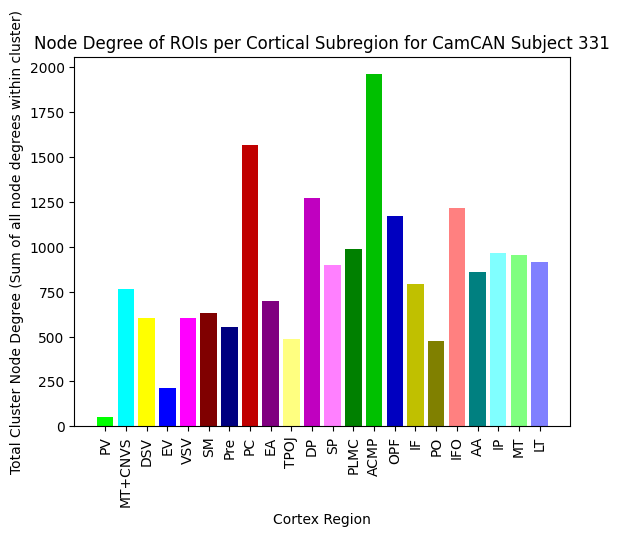

THIS IS THE SBJ ID:  332
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


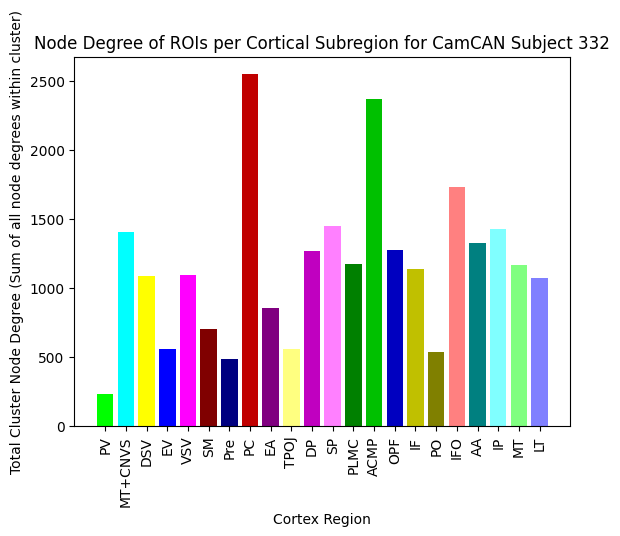

THIS IS THE SBJ ID:  333
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


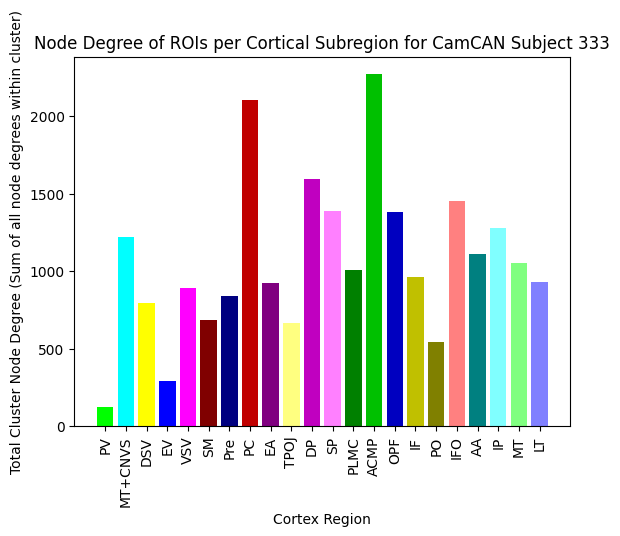

THIS IS THE SBJ ID:  334
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


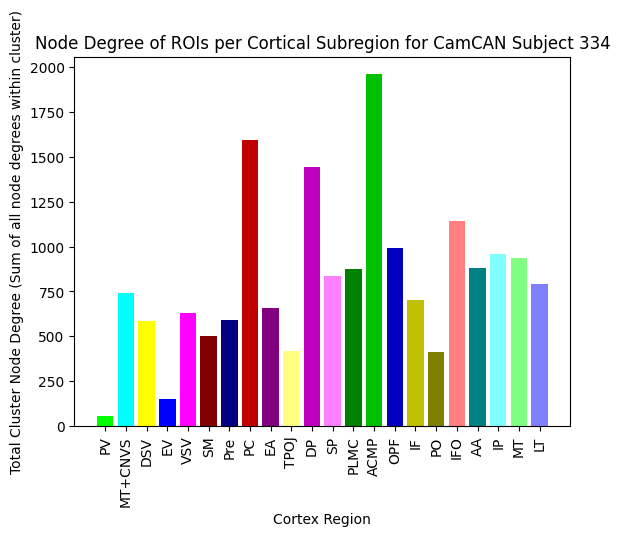

THIS IS THE SBJ ID:  335
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


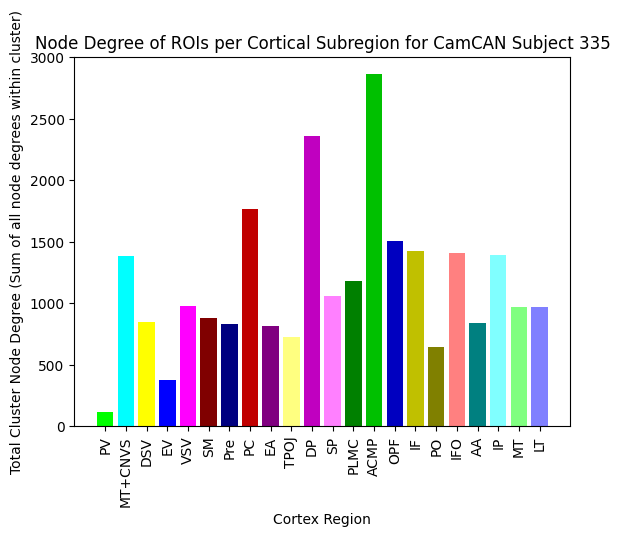

THIS IS THE SBJ ID:  336
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


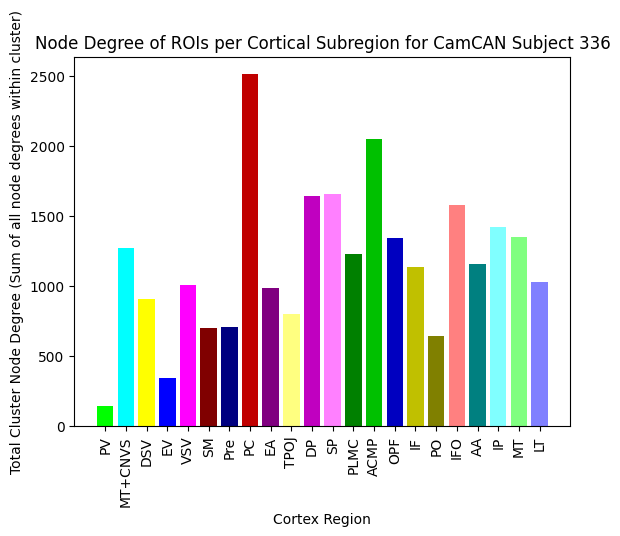

THIS IS THE SBJ ID:  337
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


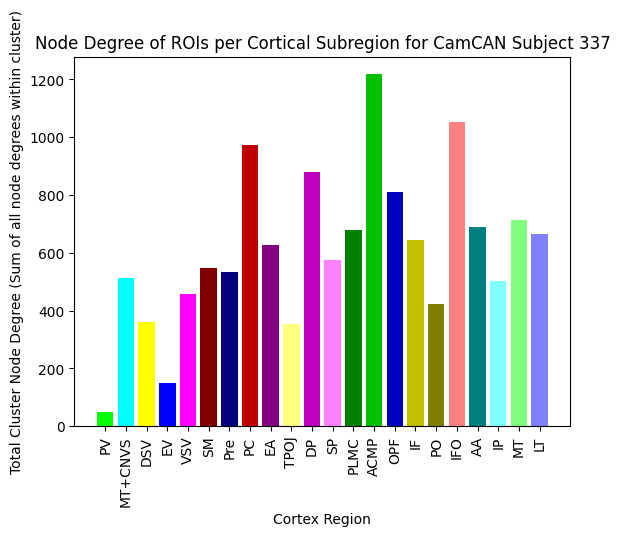

THIS IS THE SBJ ID:  338
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


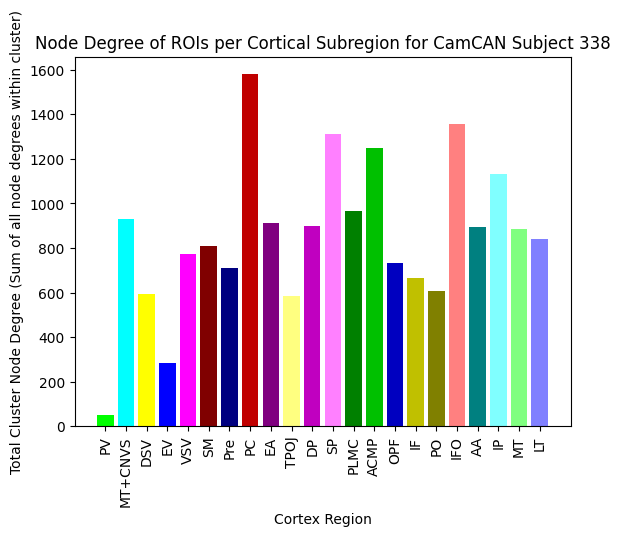

THIS IS THE SBJ ID:  339
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


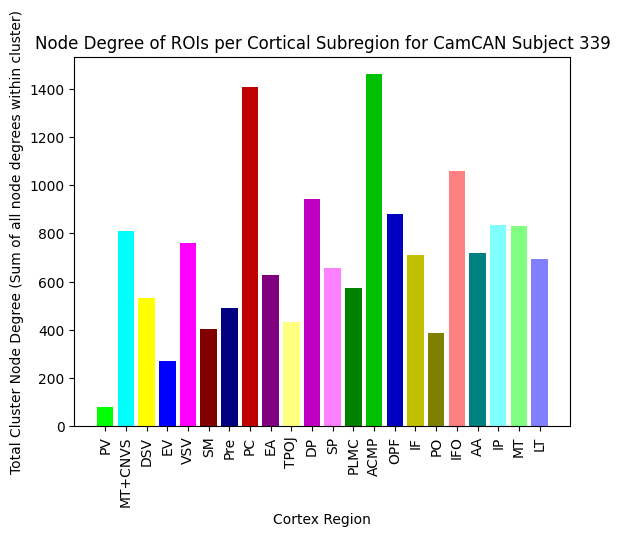

THIS IS THE SBJ ID:  340
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


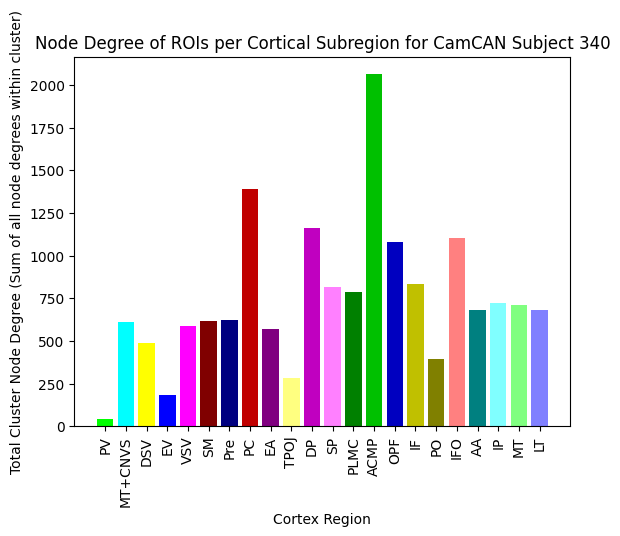

THIS IS THE SBJ ID:  341
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


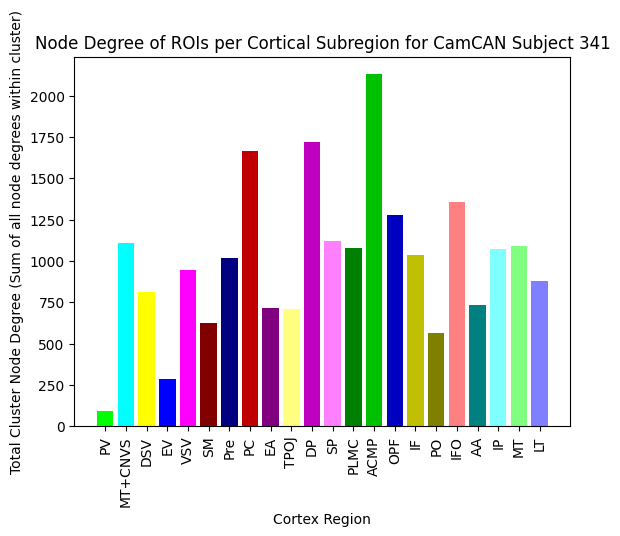

THIS IS THE SBJ ID:  342
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


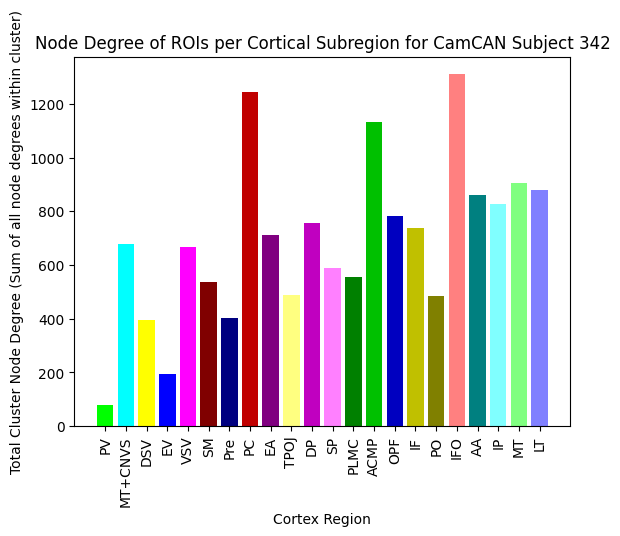

THIS IS THE SBJ ID:  343
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


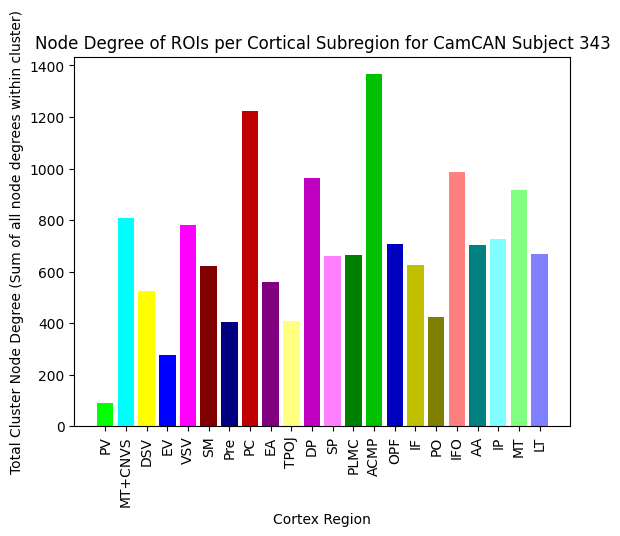

THIS IS THE SBJ ID:  344
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


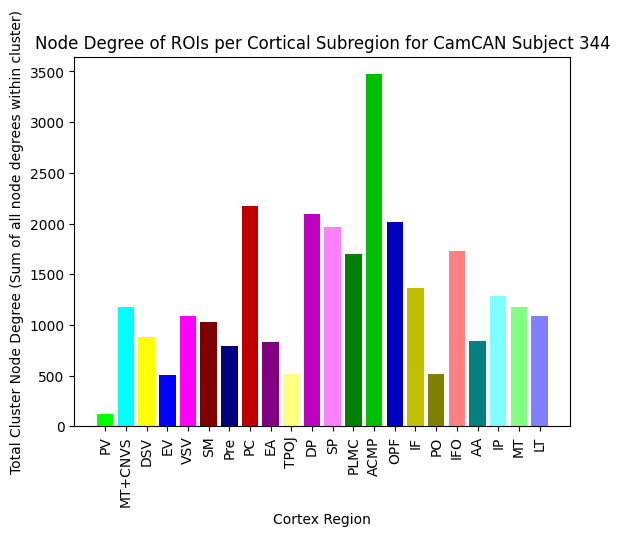

THIS IS THE SBJ ID:  345
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


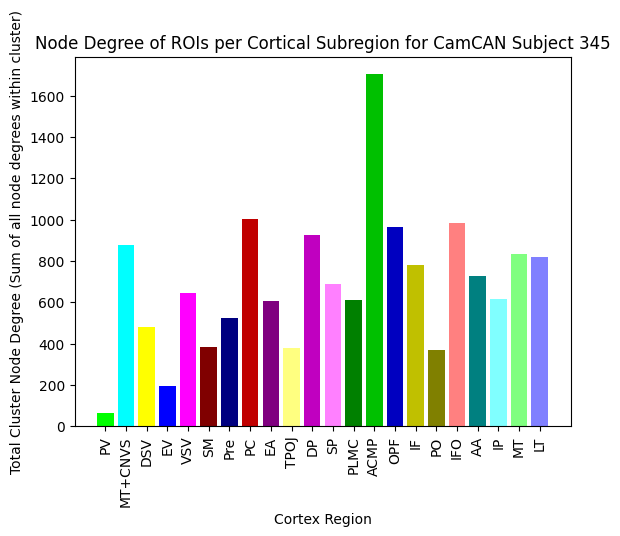

THIS IS THE SBJ ID:  346
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


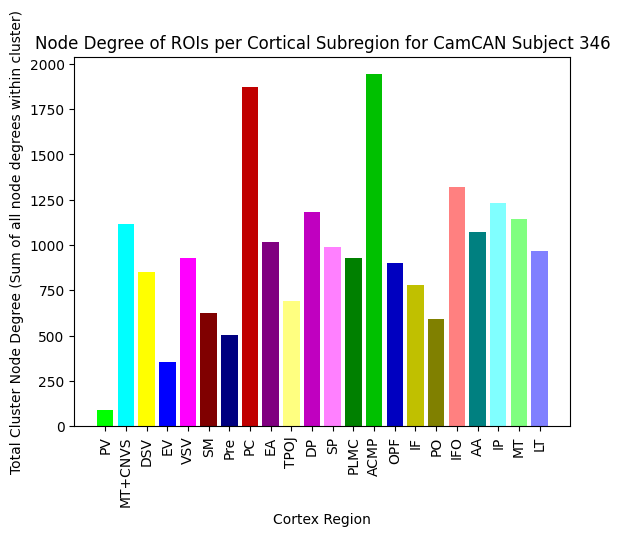

THIS IS THE SBJ ID:  347
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


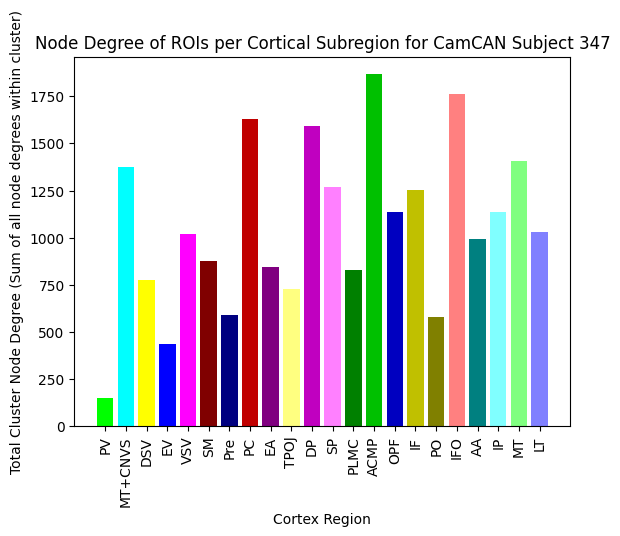

THIS IS THE SBJ ID:  348
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


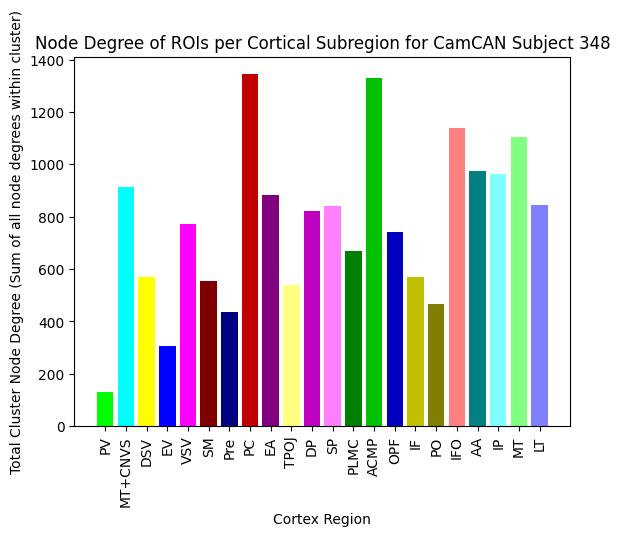

THIS IS THE SBJ ID:  349
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


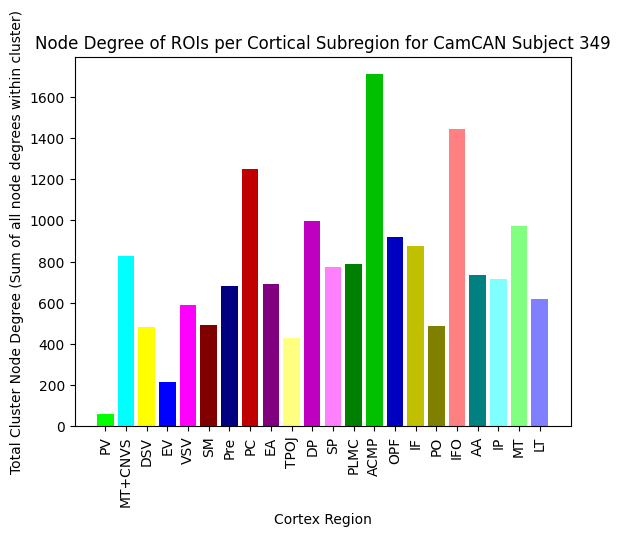

THIS IS THE SBJ ID:  350
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


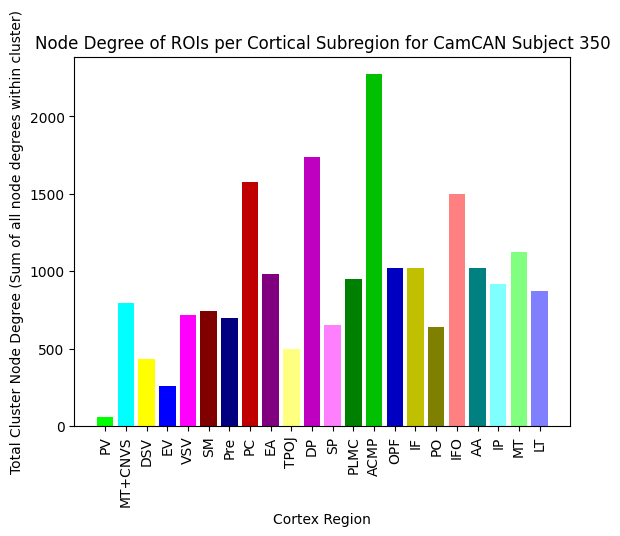

THIS IS THE SBJ ID:  351
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


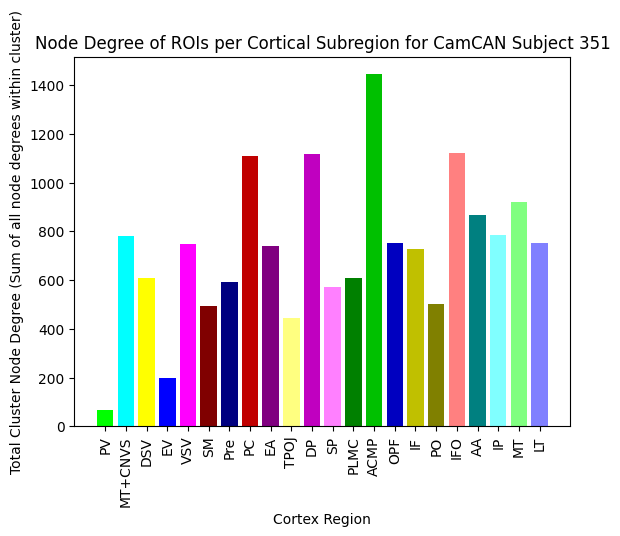

THIS IS THE SBJ ID:  352
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


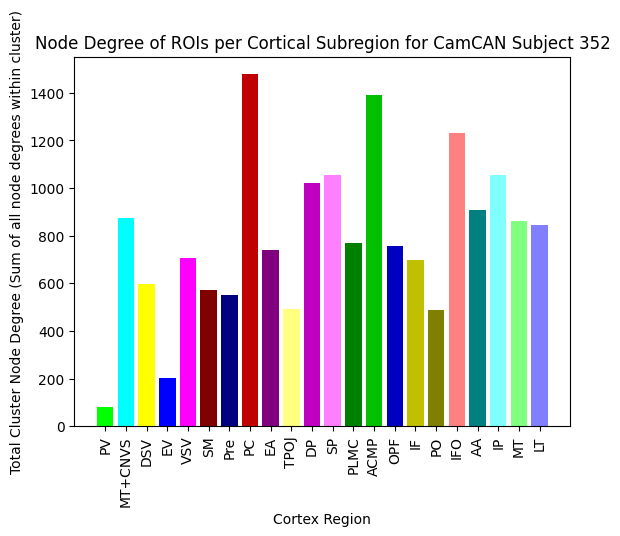

THIS IS THE SBJ ID:  353
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


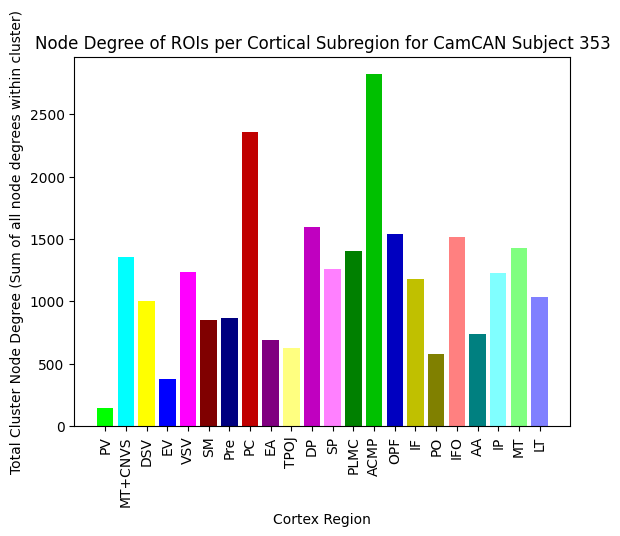

THIS IS THE SBJ ID:  354
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


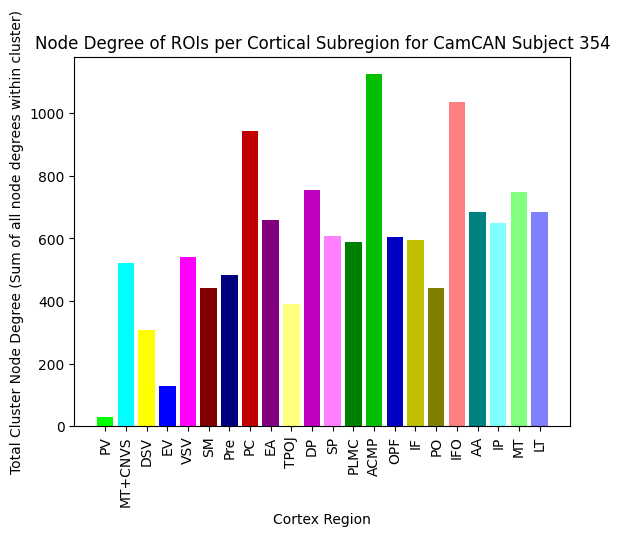

THIS IS THE SBJ ID:  355
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


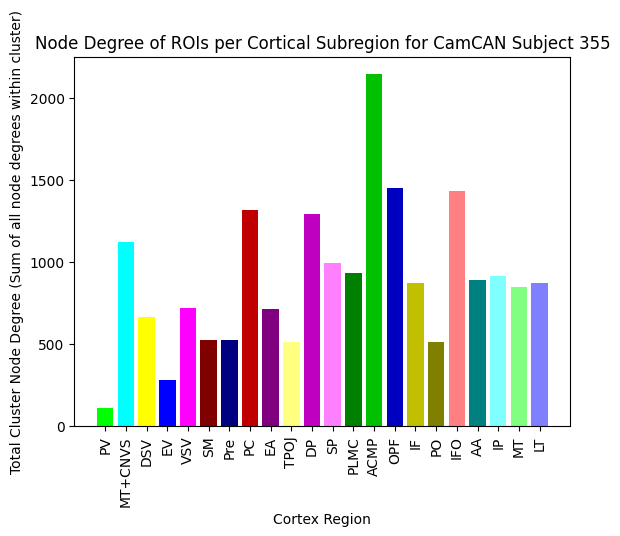

THIS IS THE SBJ ID:  356
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


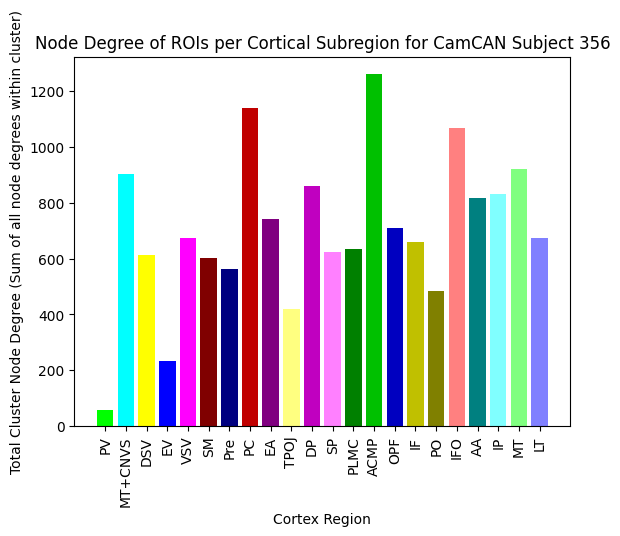

THIS IS THE SBJ ID:  357
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


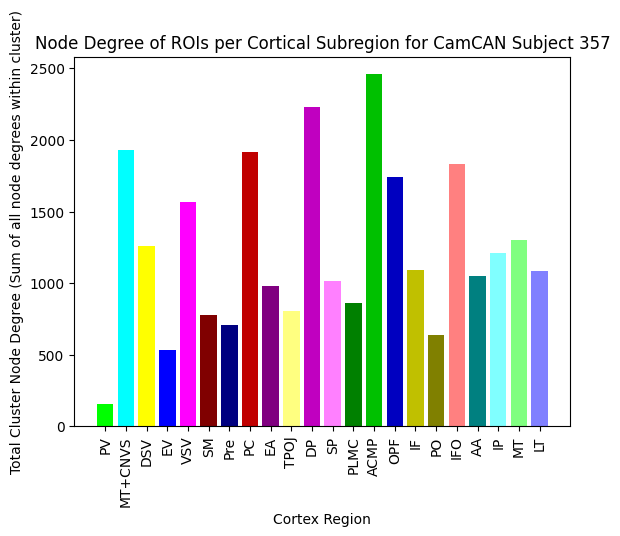

THIS IS THE SBJ ID:  358
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


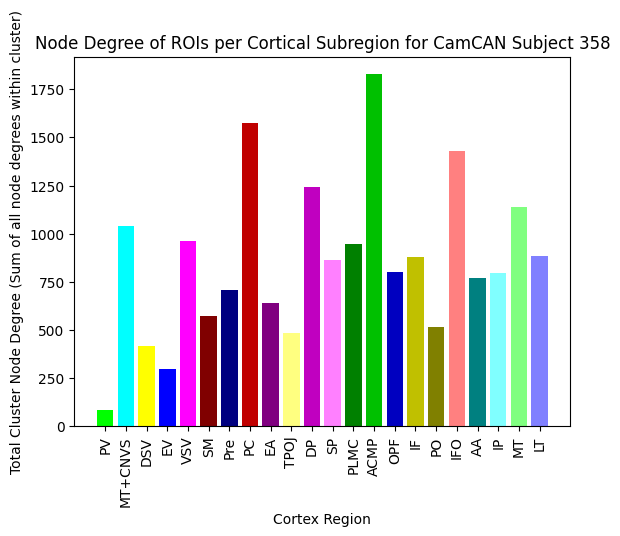

THIS IS THE SBJ ID:  359
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


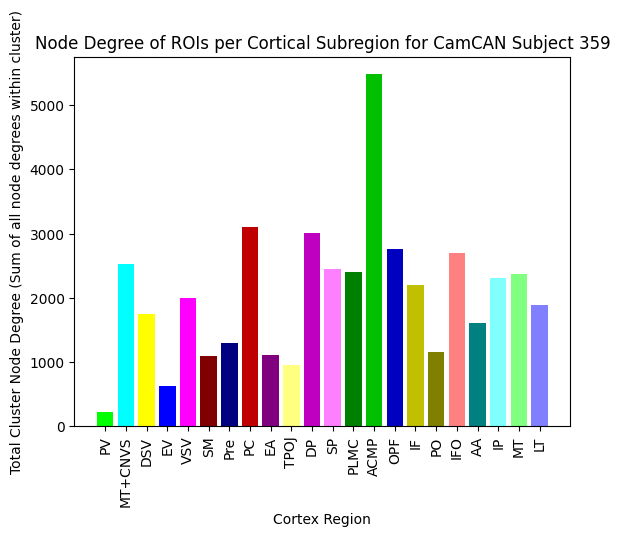

THIS IS THE SBJ ID:  360
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


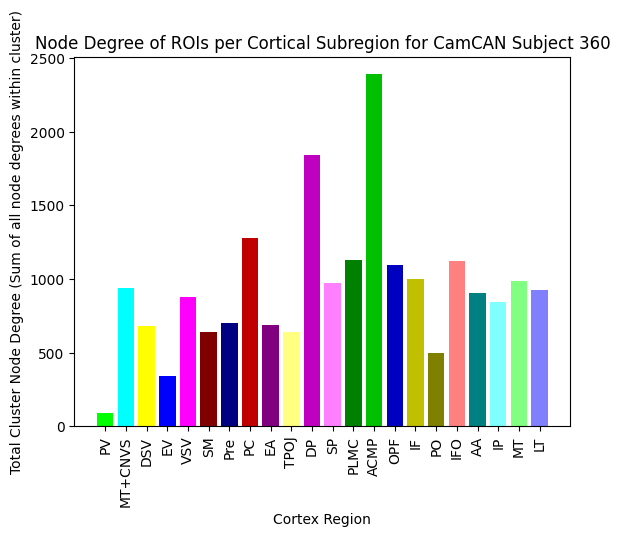

THIS IS THE SBJ ID:  361
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


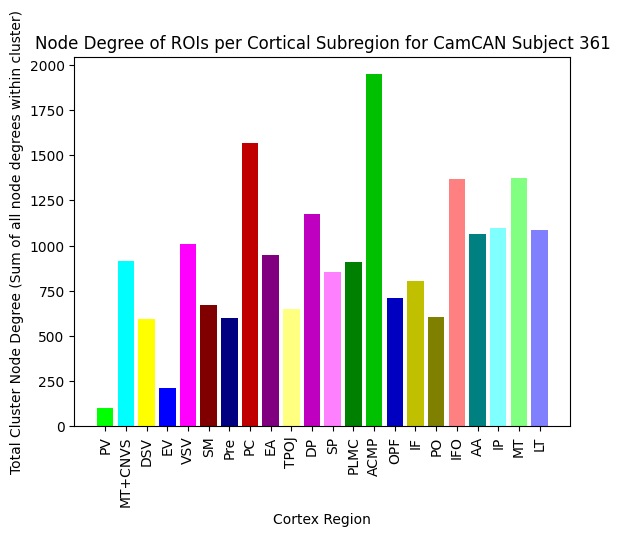

THIS IS THE SBJ ID:  362
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


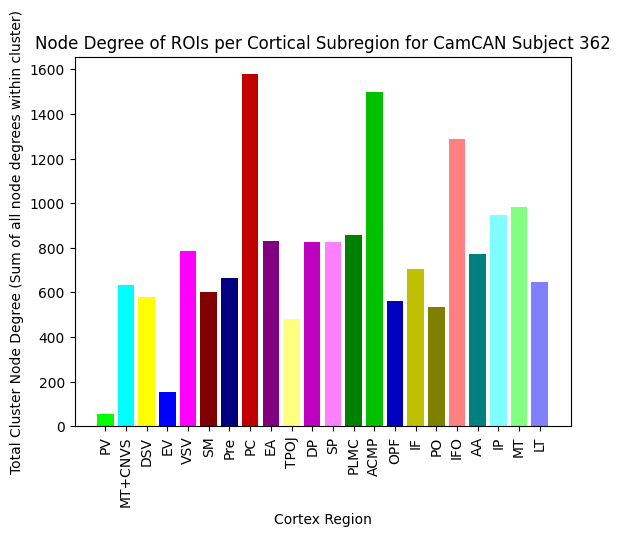

THIS IS THE SBJ ID:  363
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


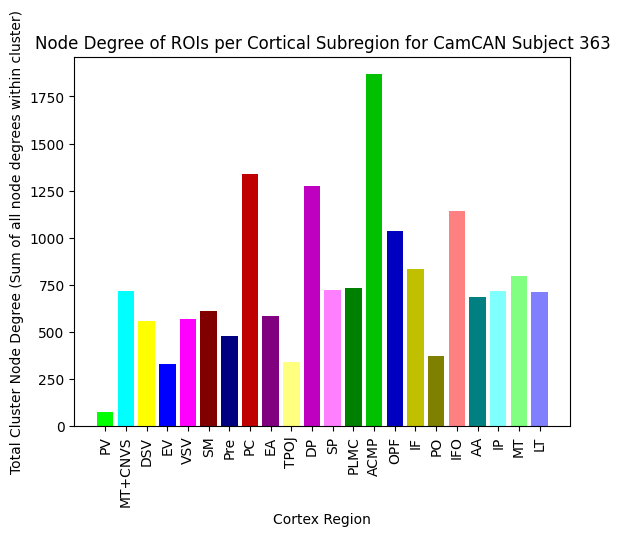

THIS IS THE SBJ ID:  364
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


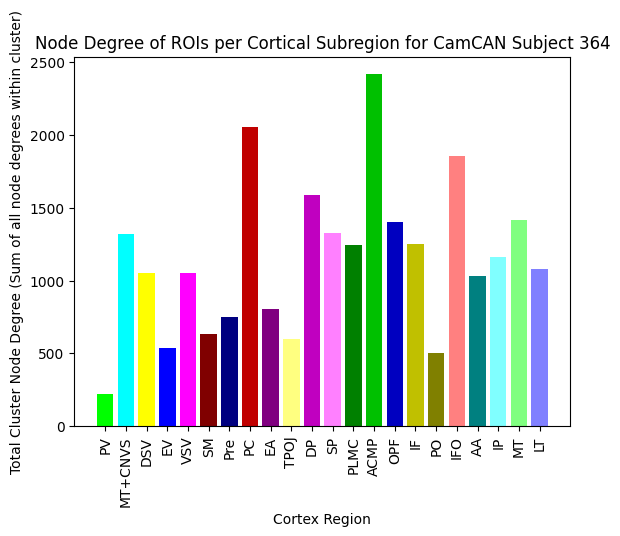

THIS IS THE SBJ ID:  365
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


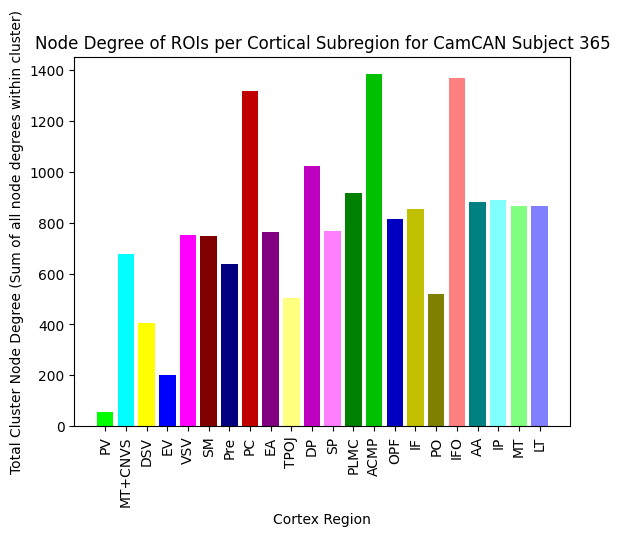

THIS IS THE SBJ ID:  366
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


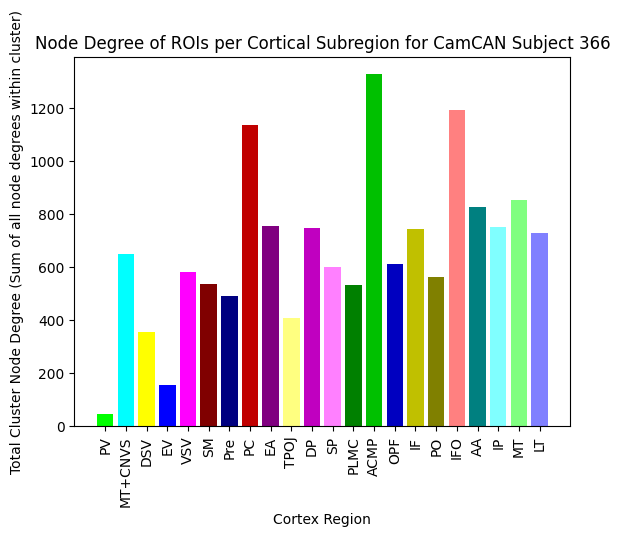

THIS IS THE SBJ ID:  367
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


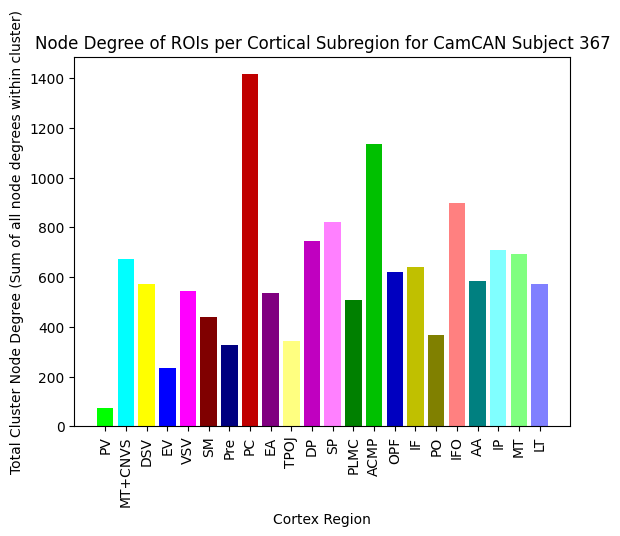

THIS IS THE SBJ ID:  368
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


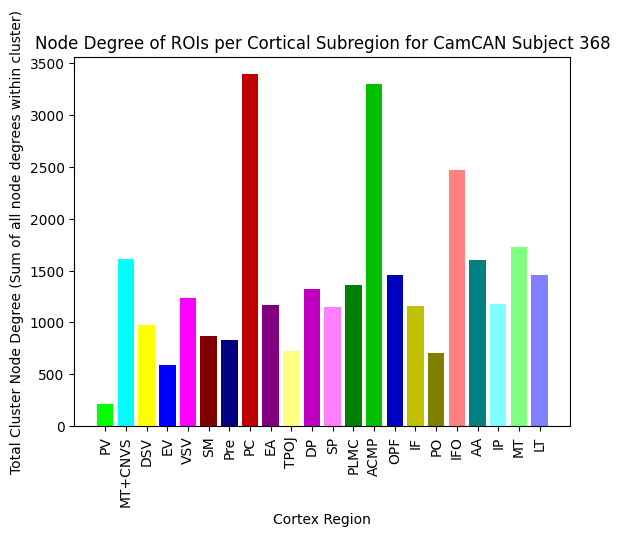

THIS IS THE SBJ ID:  369
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


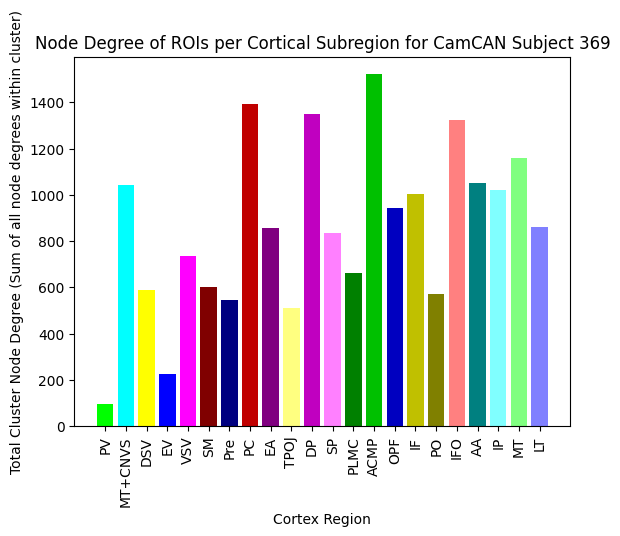

THIS IS THE SBJ ID:  370
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


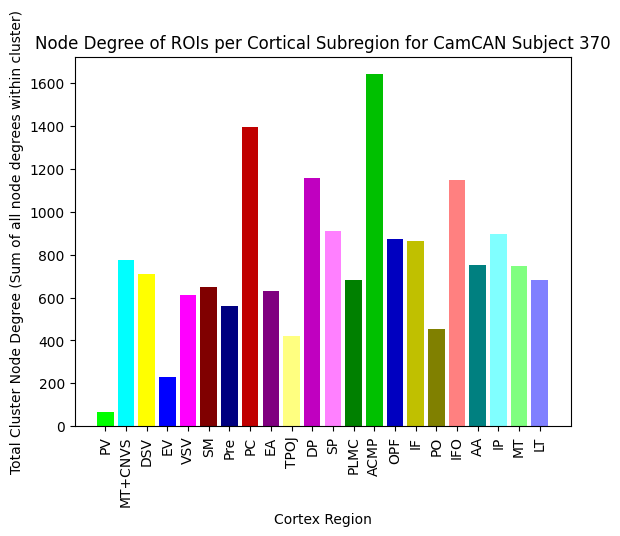

THIS IS THE SBJ ID:  371
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


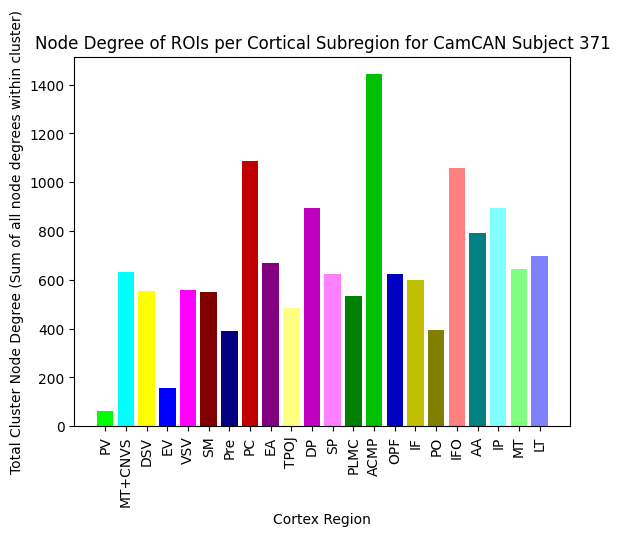

THIS IS THE SBJ ID:  372
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


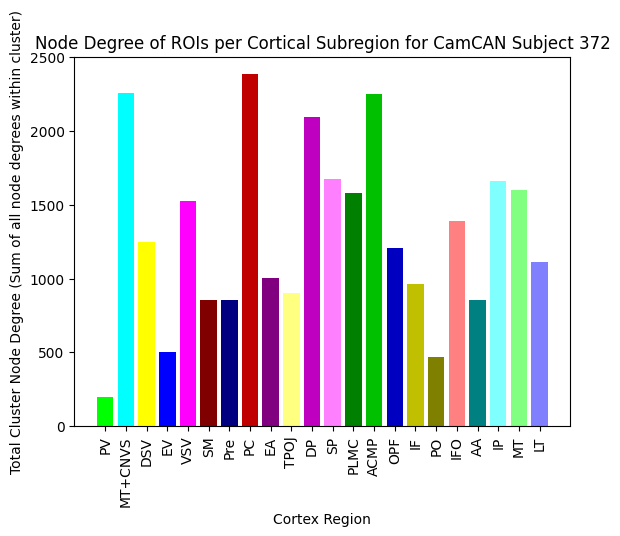

THIS IS THE SBJ ID:  373
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


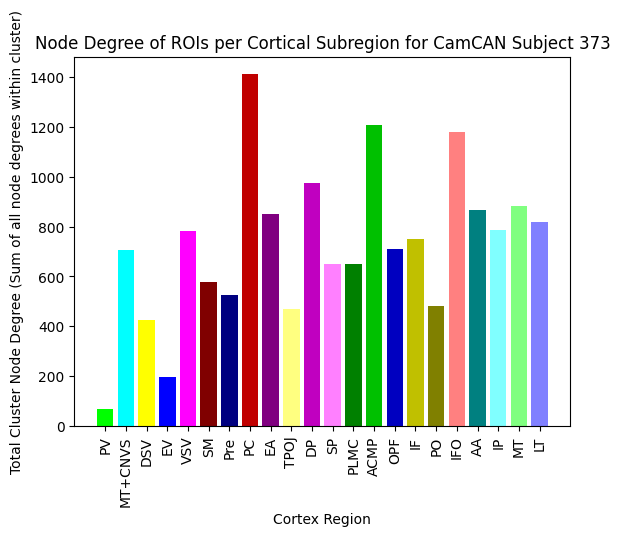

THIS IS THE SBJ ID:  374
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


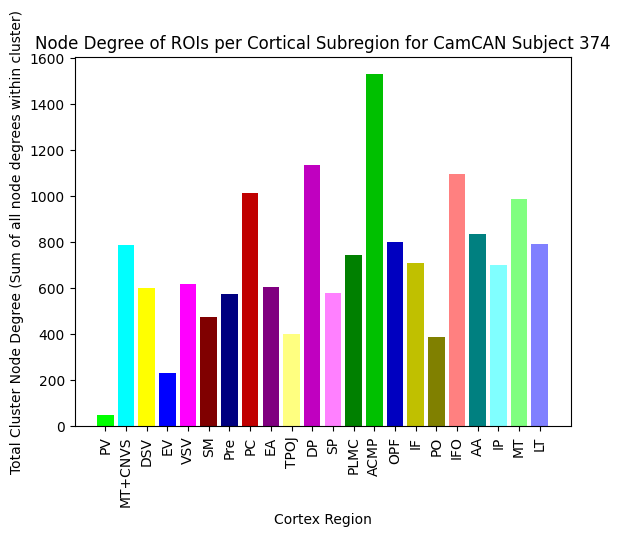

THIS IS THE SBJ ID:  375
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


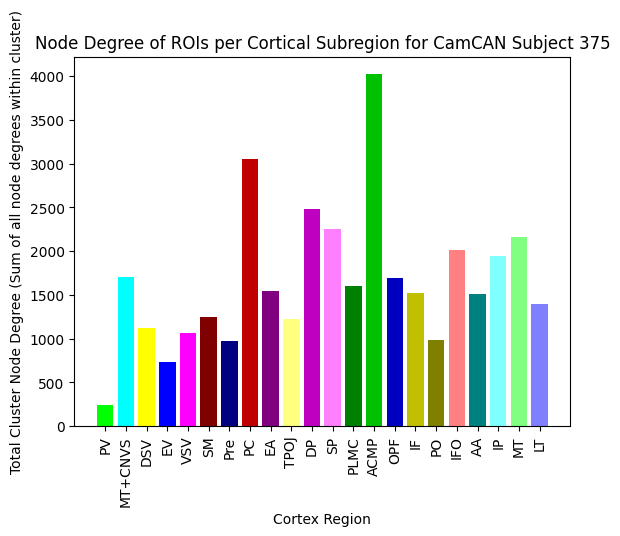

THIS IS THE SBJ ID:  376
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


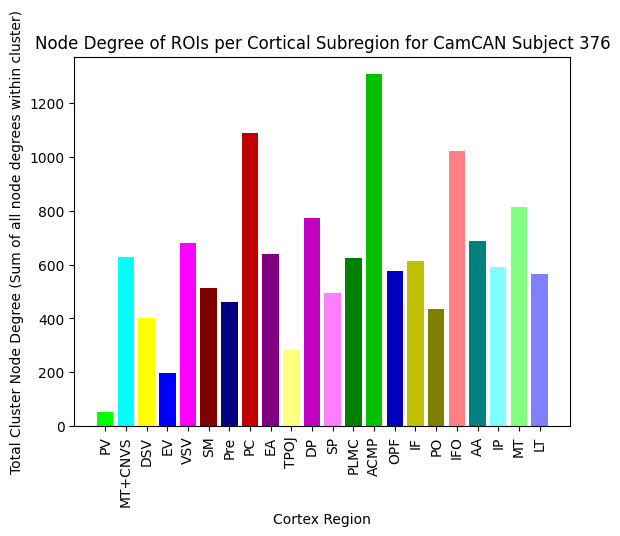

THIS IS THE SBJ ID:  377
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


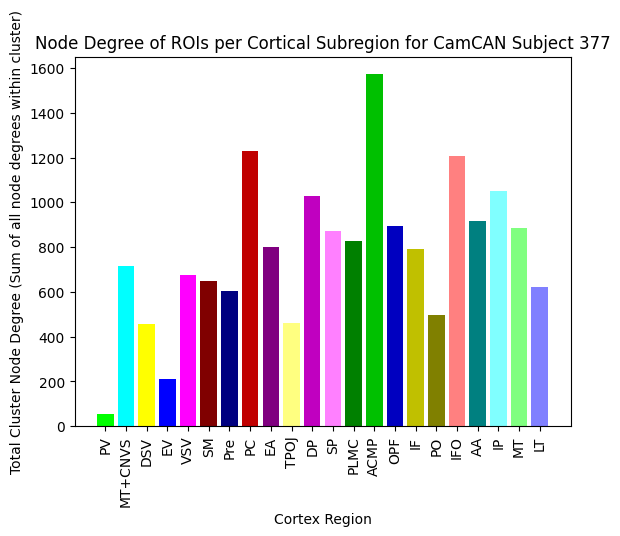

THIS IS THE SBJ ID:  378
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


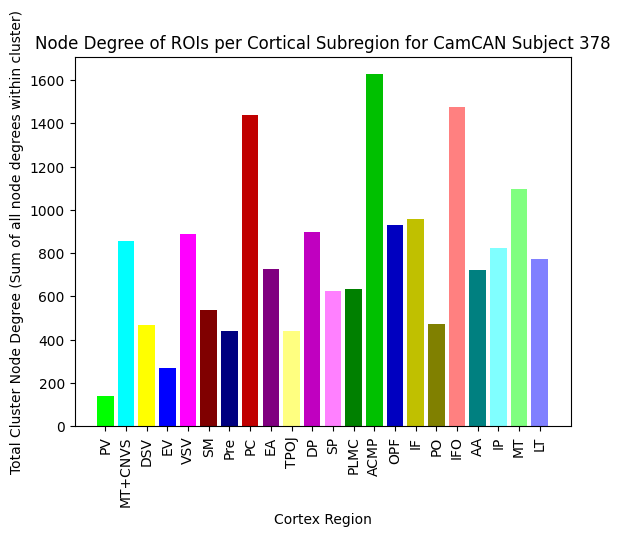

THIS IS THE SBJ ID:  379
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


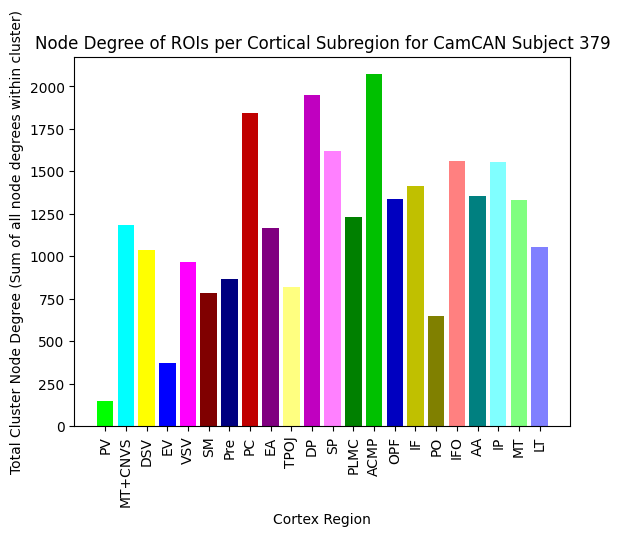

THIS IS THE SBJ ID:  380
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


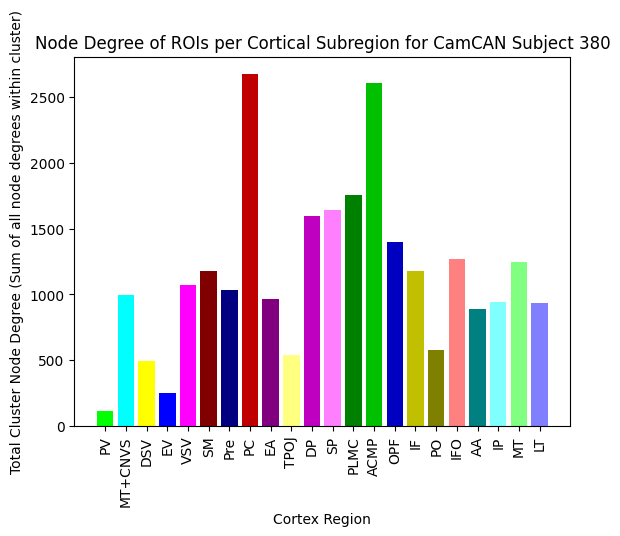

THIS IS THE SBJ ID:  381
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


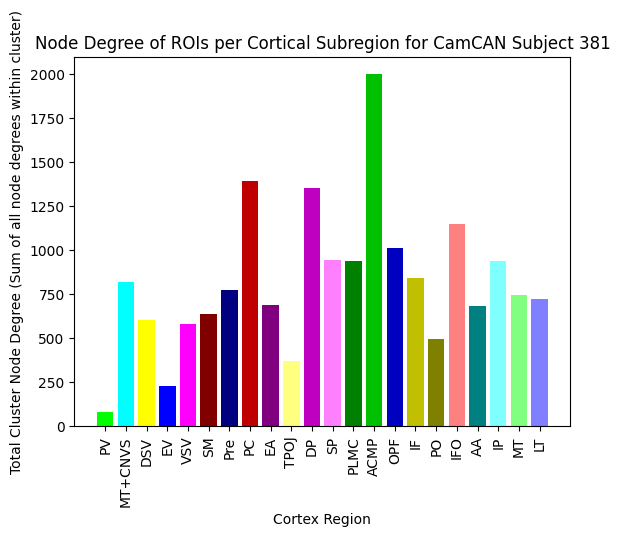

THIS IS THE SBJ ID:  382
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


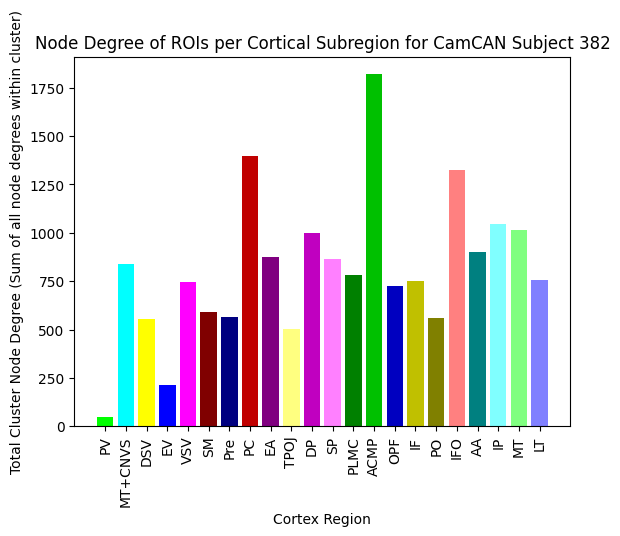

THIS IS THE SBJ ID:  383
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


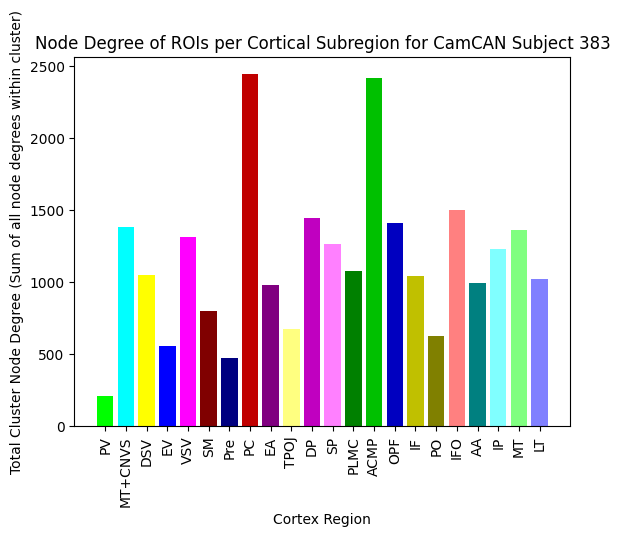

THIS IS THE SBJ ID:  384
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


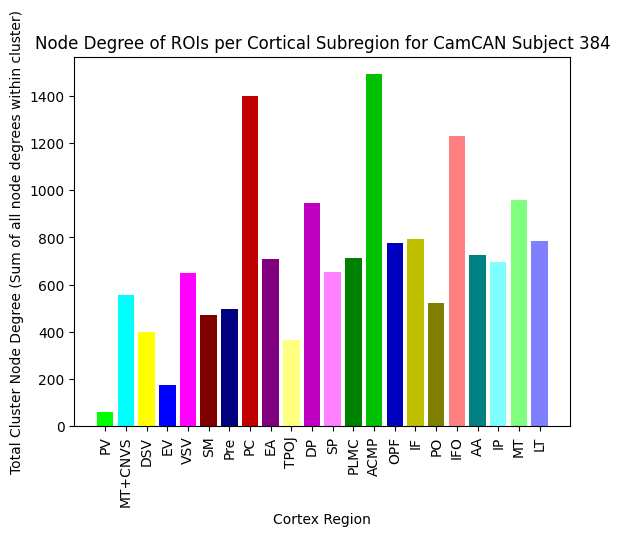

THIS IS THE SBJ ID:  385
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


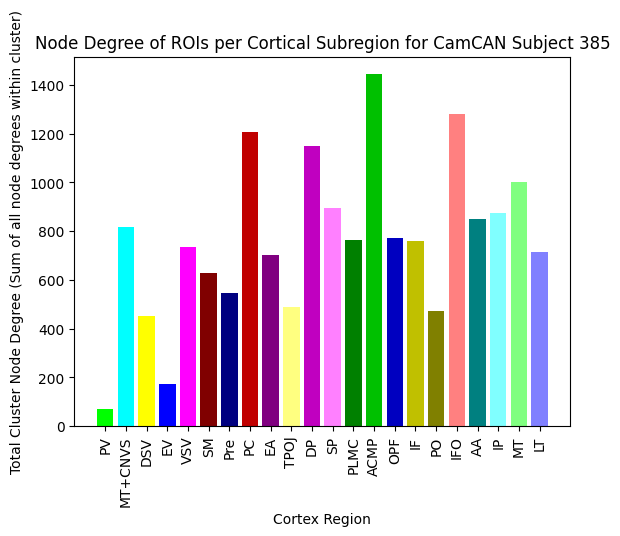

THIS IS THE SBJ ID:  386
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


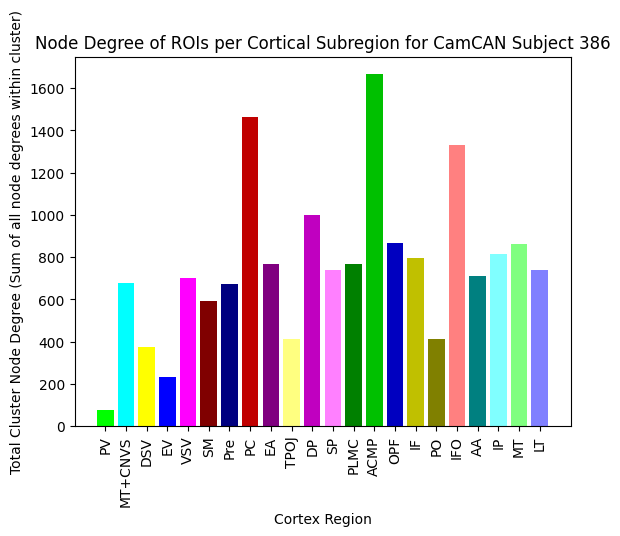

THIS IS THE SBJ ID:  387
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


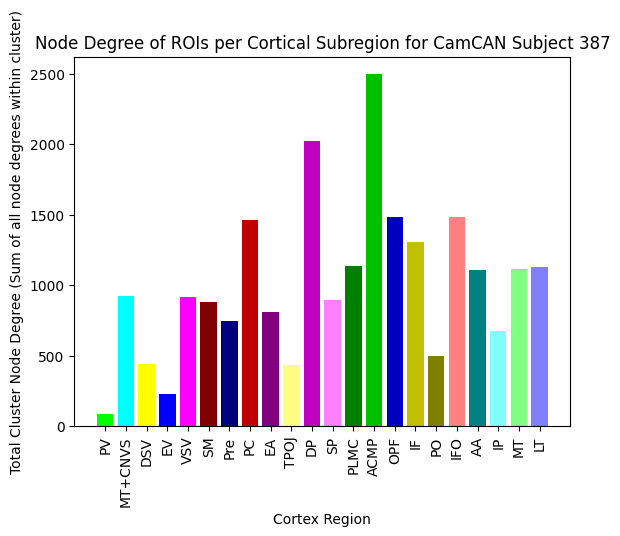

THIS IS THE SBJ ID:  388
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


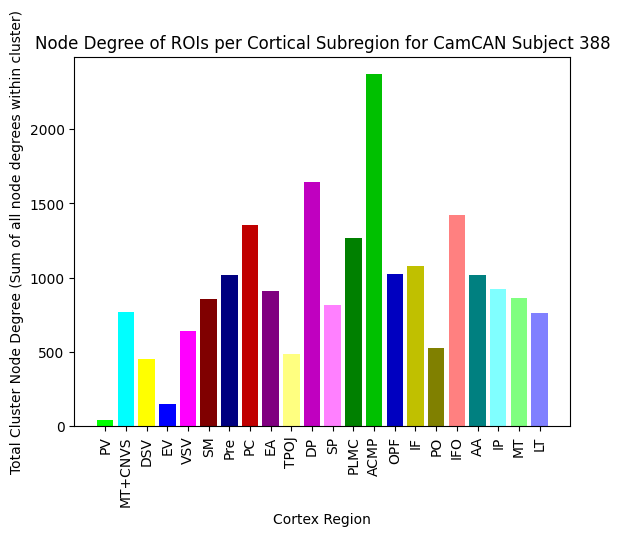

THIS IS THE SBJ ID:  389
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


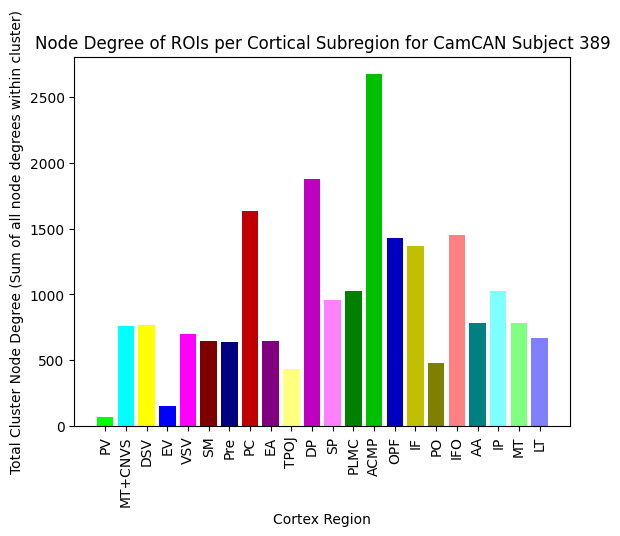

THIS IS THE SBJ ID:  390
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


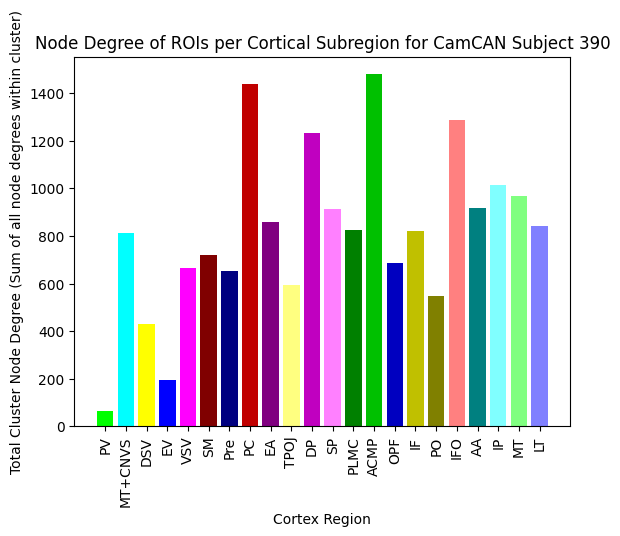

THIS IS THE SBJ ID:  391
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


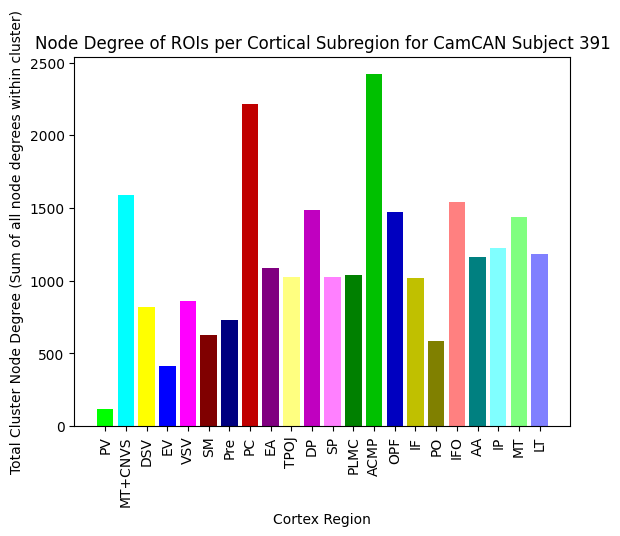

THIS IS THE SBJ ID:  392
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


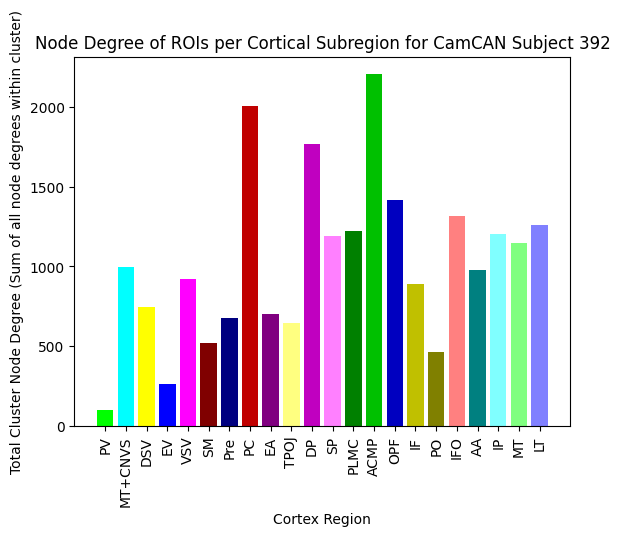

THIS IS THE SBJ ID:  393
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


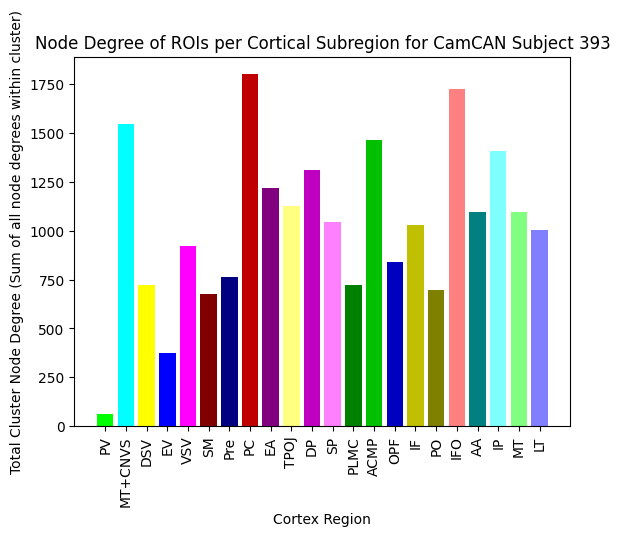

THIS IS THE SBJ ID:  394
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


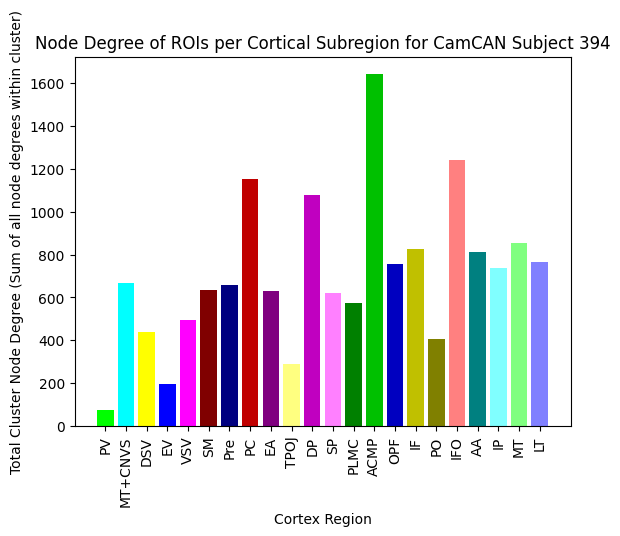

THIS IS THE SBJ ID:  395
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


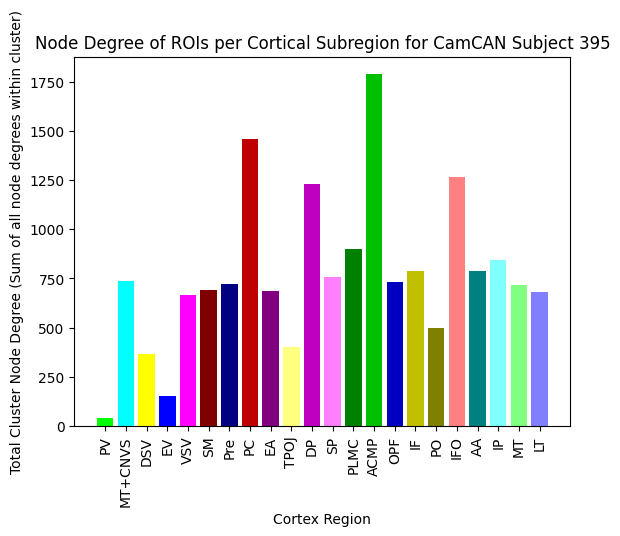

THIS IS THE SBJ ID:  396
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


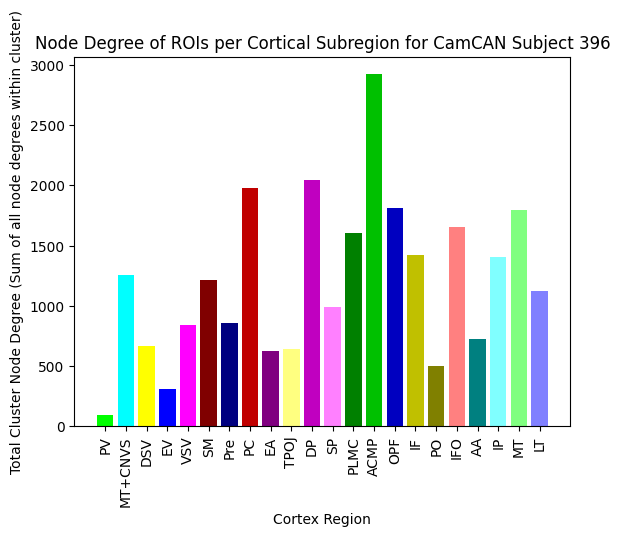

THIS IS THE SBJ ID:  397
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


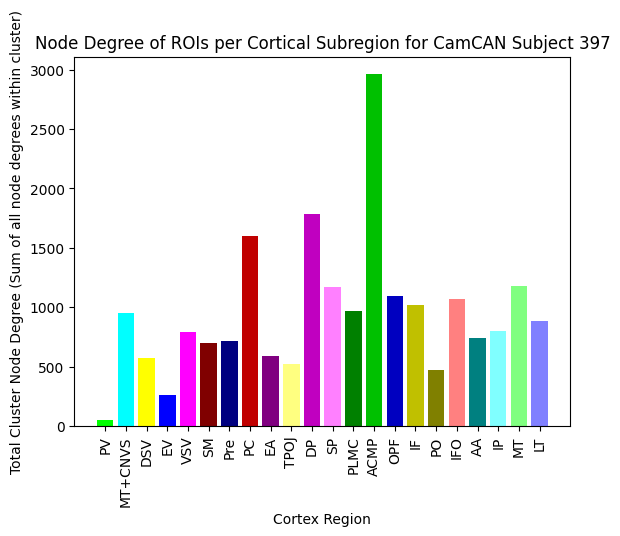

THIS IS THE SBJ ID:  398
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


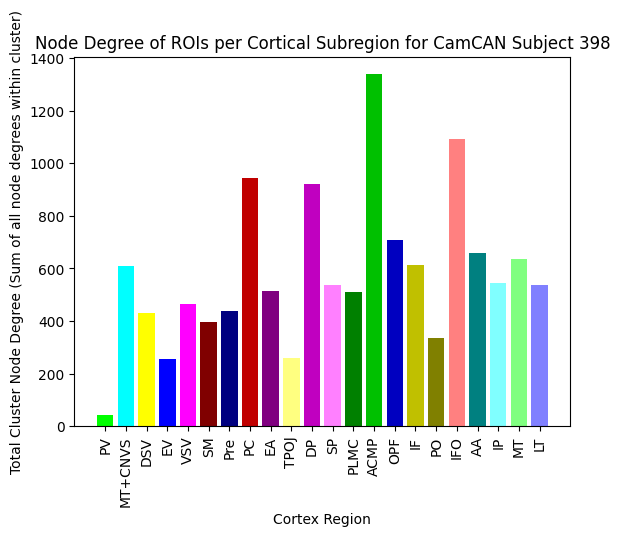

THIS IS THE SBJ ID:  399
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


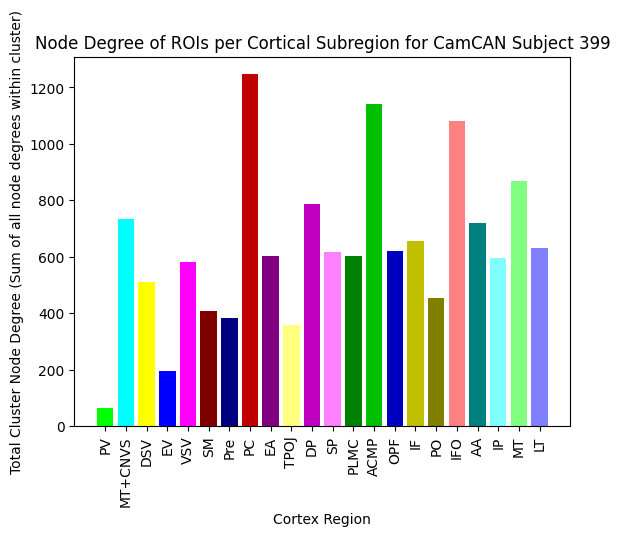

THIS IS THE SBJ ID:  400
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


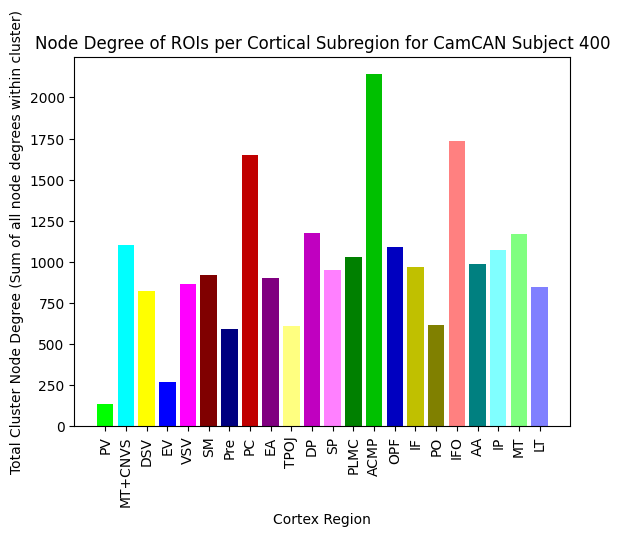

THIS IS THE SBJ ID:  401
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


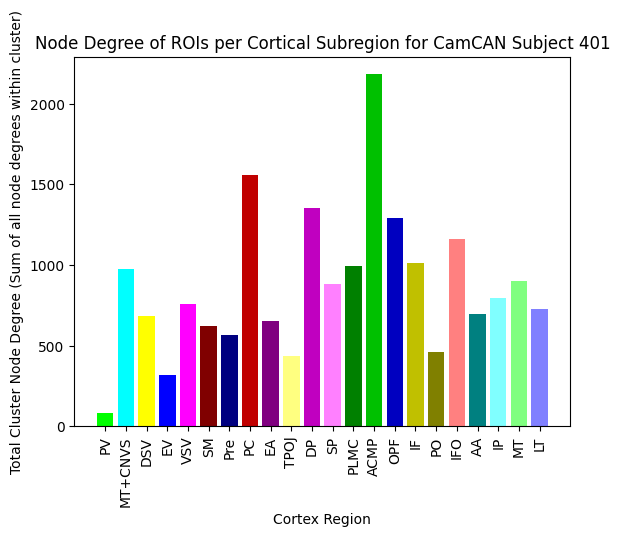

THIS IS THE SBJ ID:  402
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


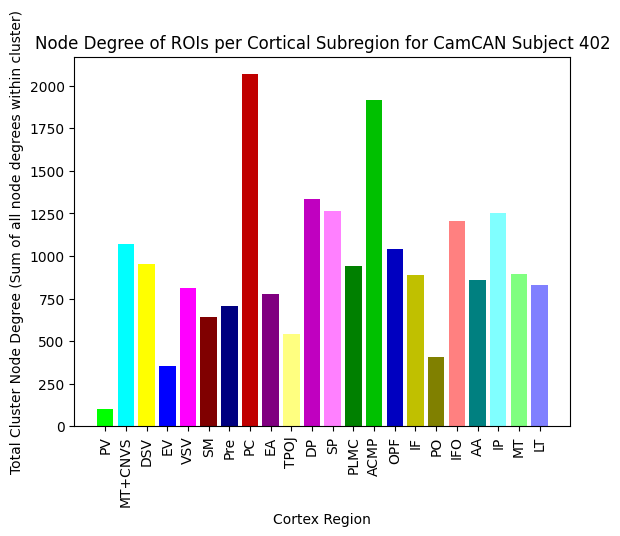

THIS IS THE SBJ ID:  403
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


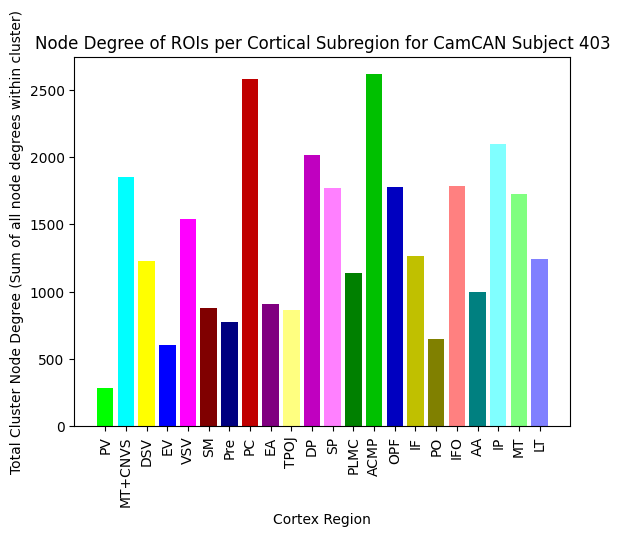

THIS IS THE SBJ ID:  404
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


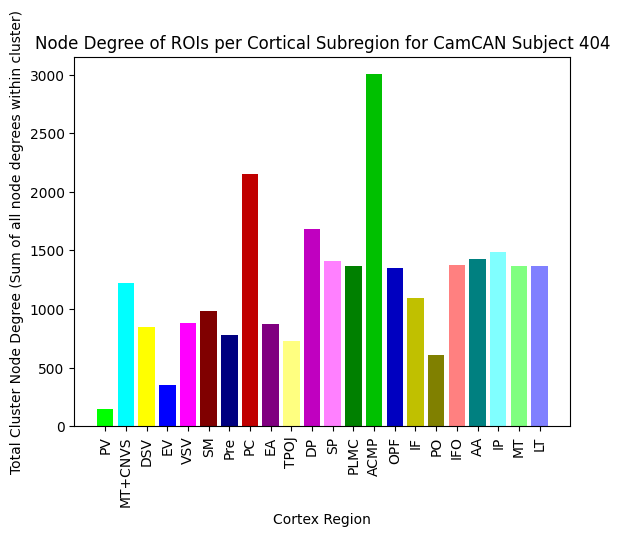

THIS IS THE SBJ ID:  405
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


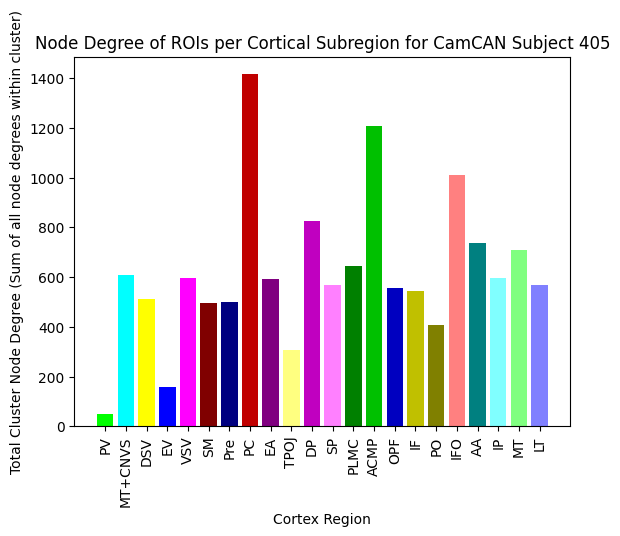

THIS IS THE SBJ ID:  406
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


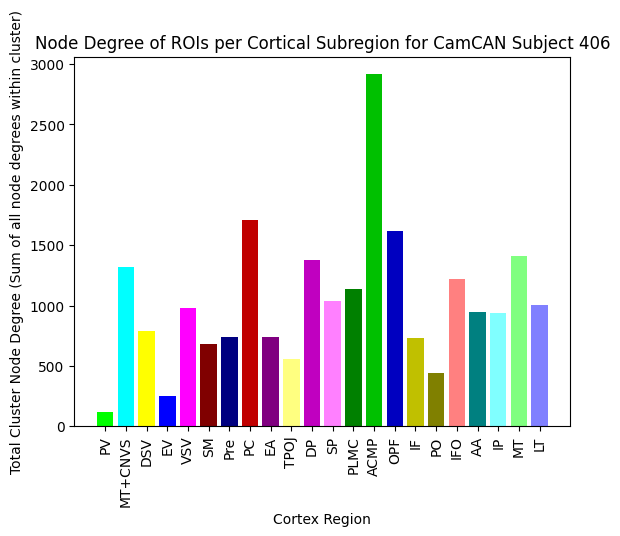

THIS IS THE SBJ ID:  407
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


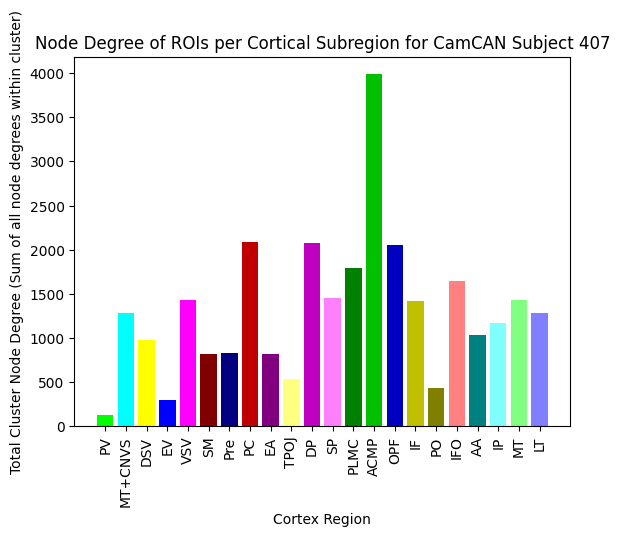

THIS IS THE SBJ ID:  408
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


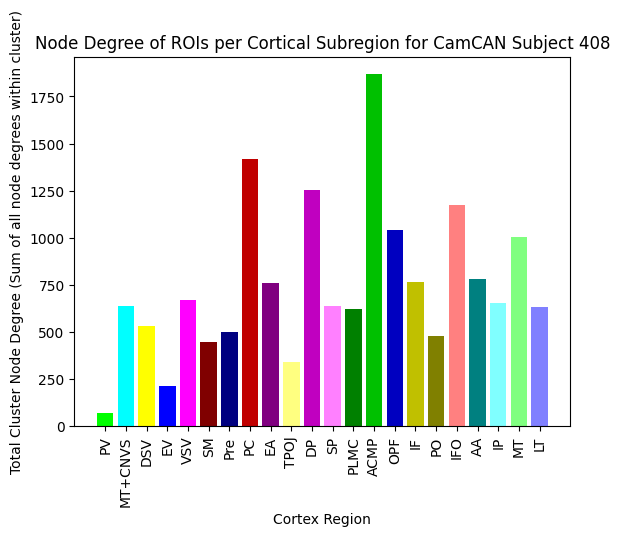

THIS IS THE SBJ ID:  409
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


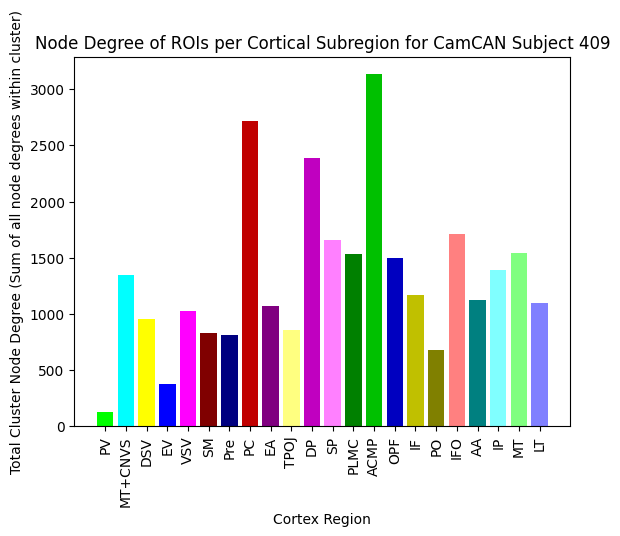

THIS IS THE SBJ ID:  410
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


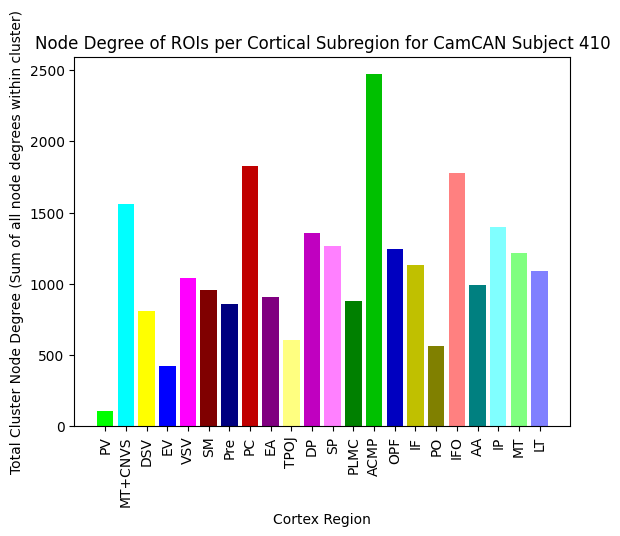

THIS IS THE SBJ ID:  411
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


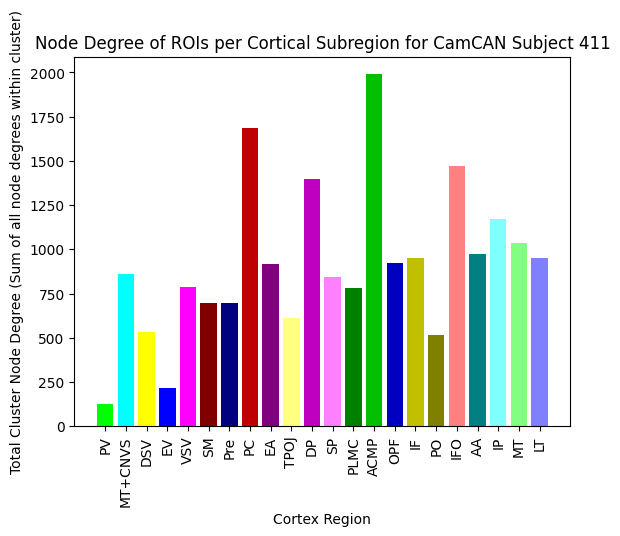

THIS IS THE SBJ ID:  412
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


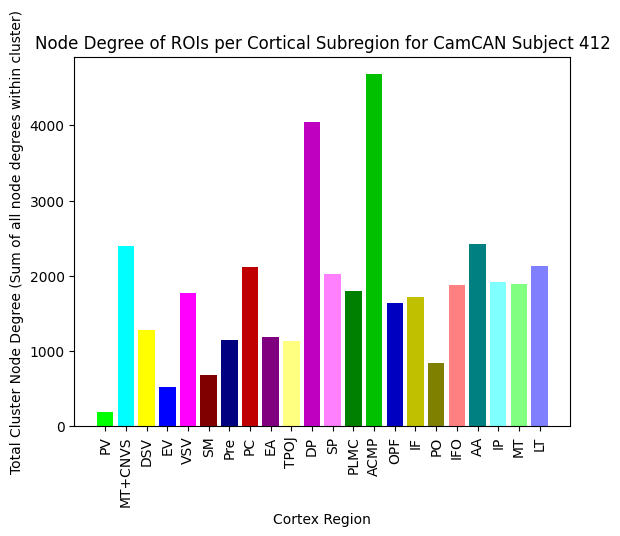

THIS IS THE SBJ ID:  413
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


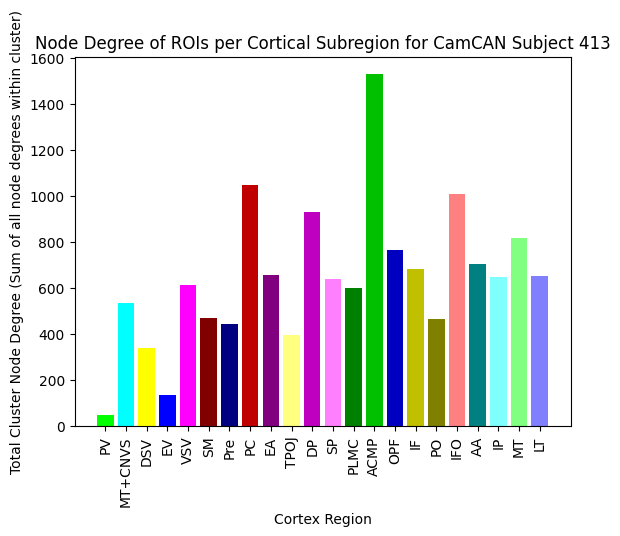

THIS IS THE SBJ ID:  414
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


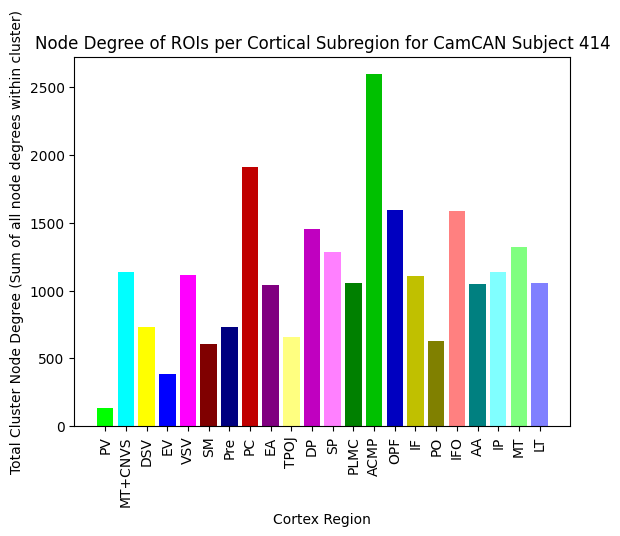

THIS IS THE SBJ ID:  415
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


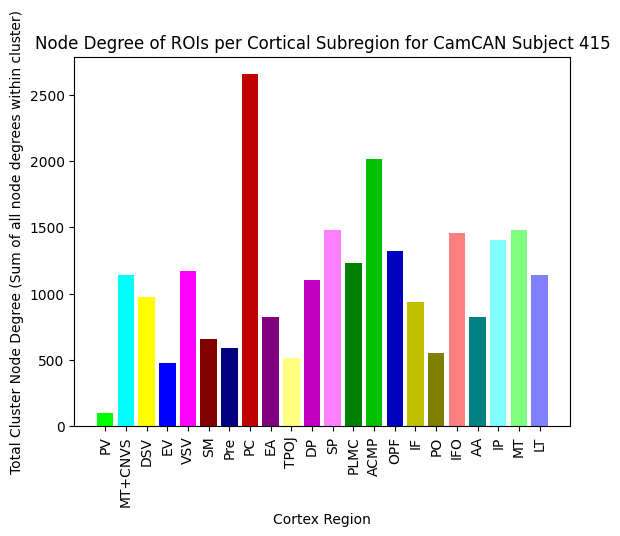

THIS IS THE SBJ ID:  416
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


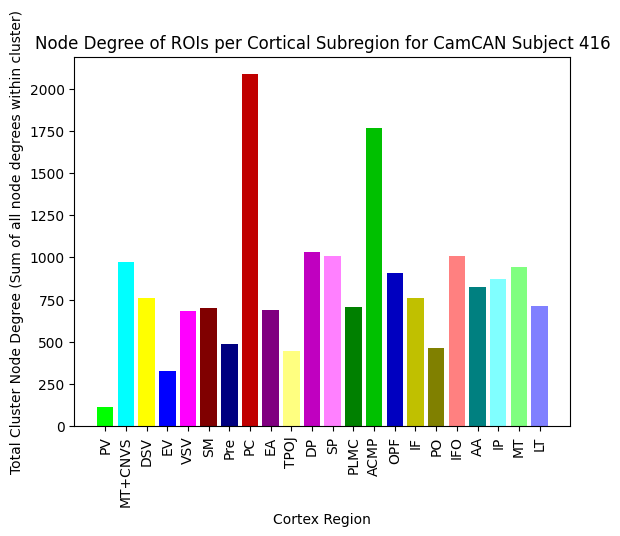

THIS IS THE SBJ ID:  417
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


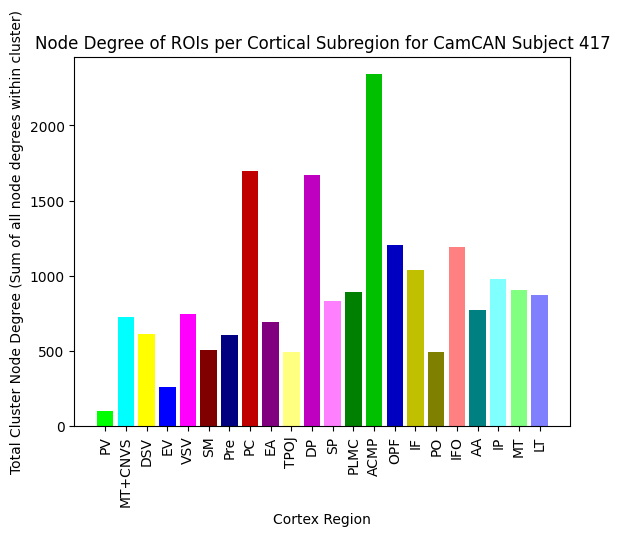

THIS IS THE SBJ ID:  418
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


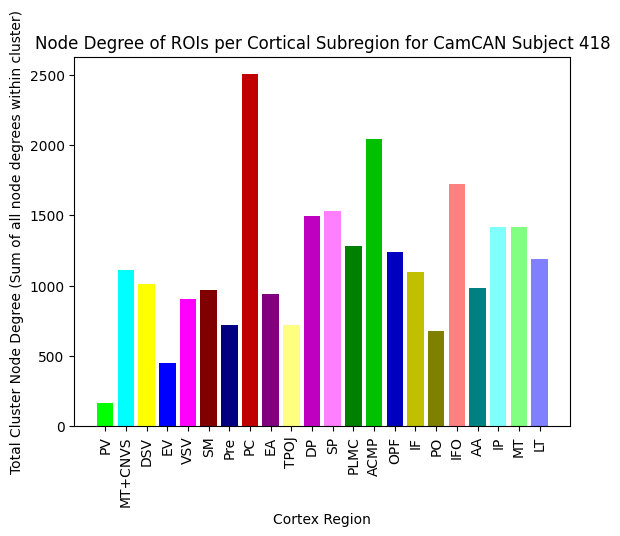

THIS IS THE SBJ ID:  419
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


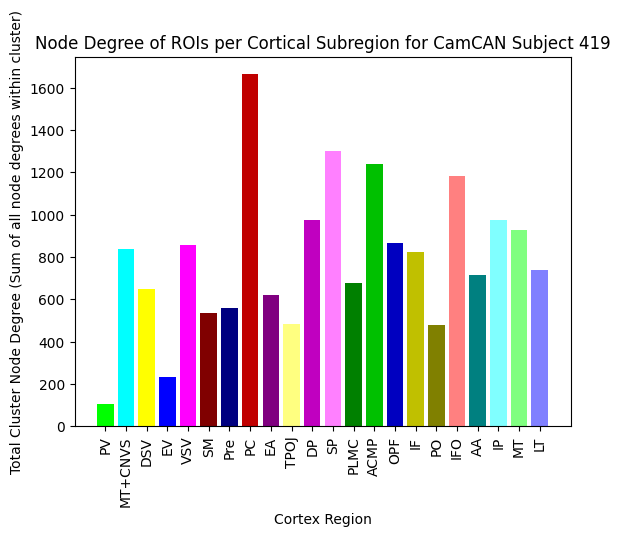

THIS IS THE SBJ ID:  420
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


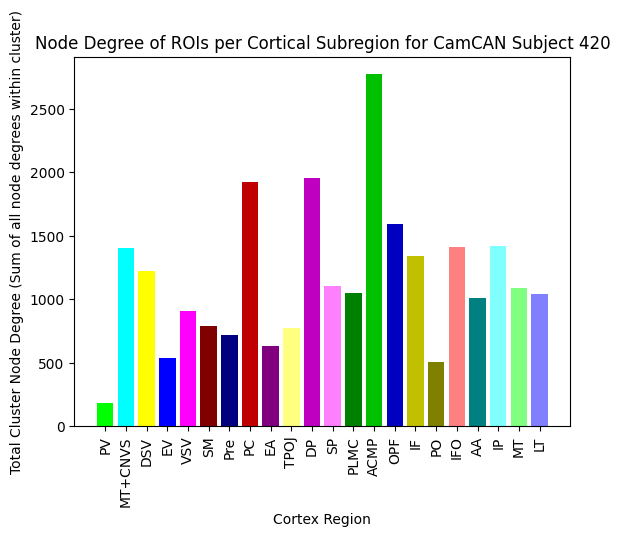

THIS IS THE SBJ ID:  421
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


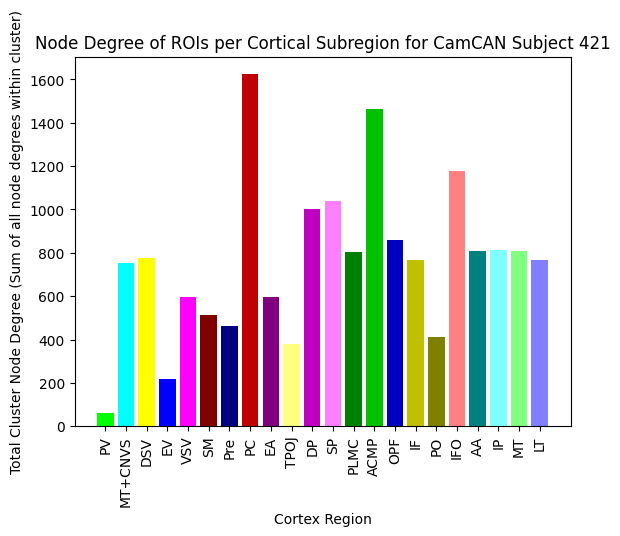

THIS IS THE SBJ ID:  422
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


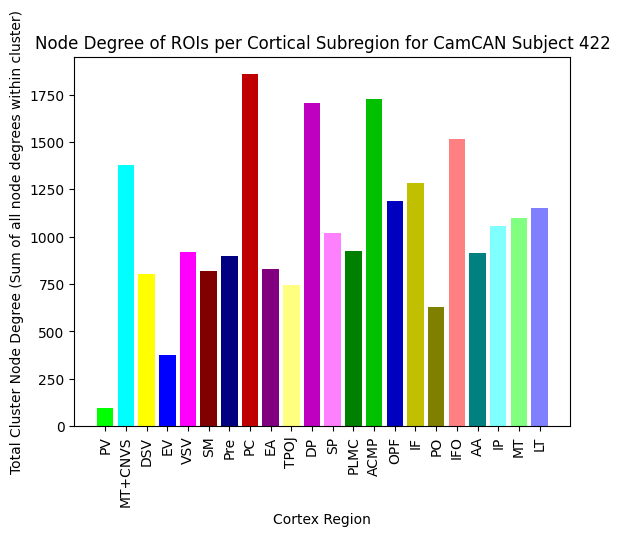

THIS IS THE SBJ ID:  423
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


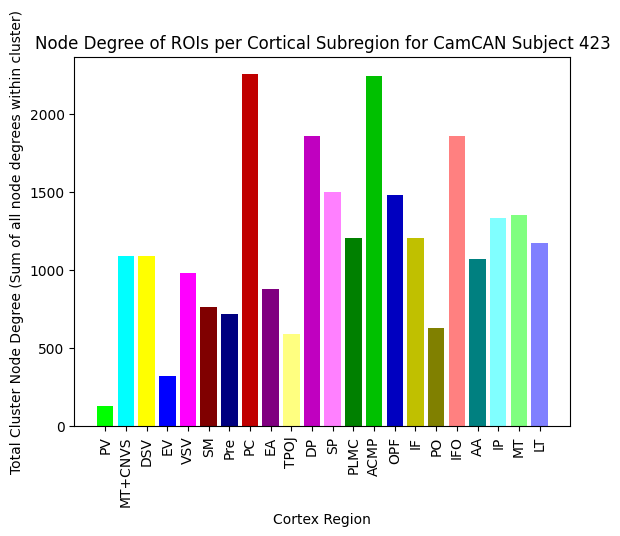

THIS IS THE SBJ ID:  424
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


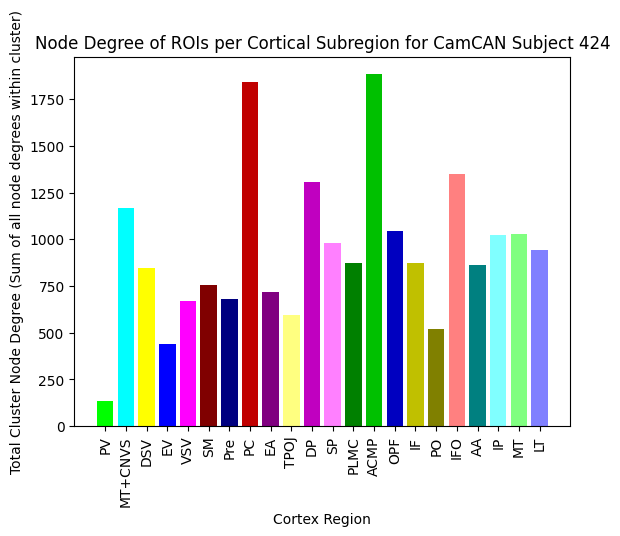

THIS IS THE SBJ ID:  425
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


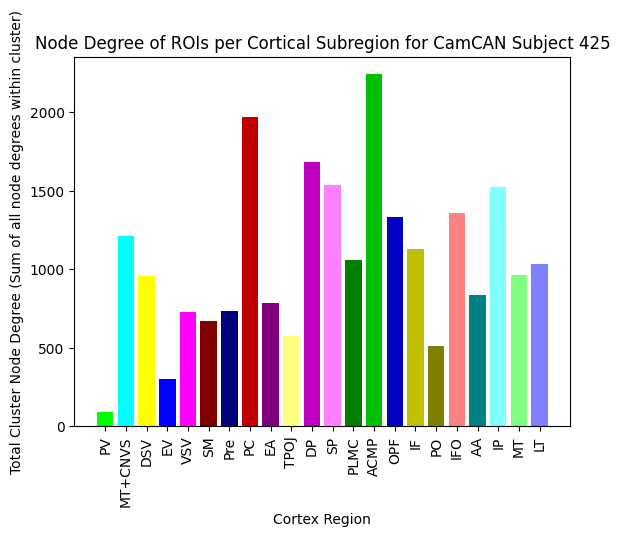

THIS IS THE SBJ ID:  426
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


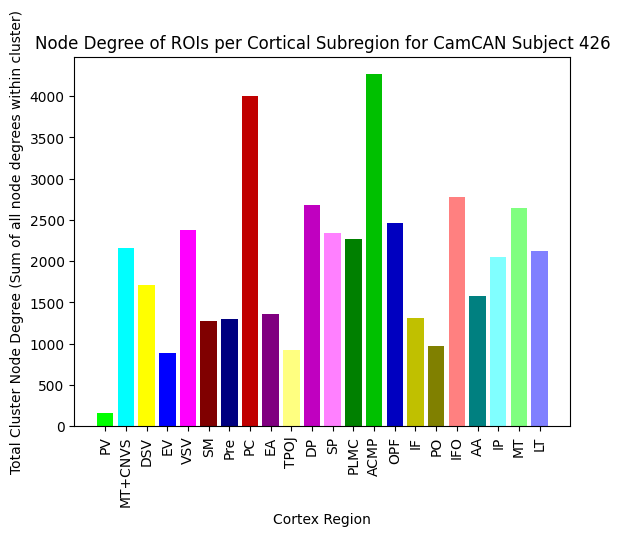

THIS IS THE SBJ ID:  427
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


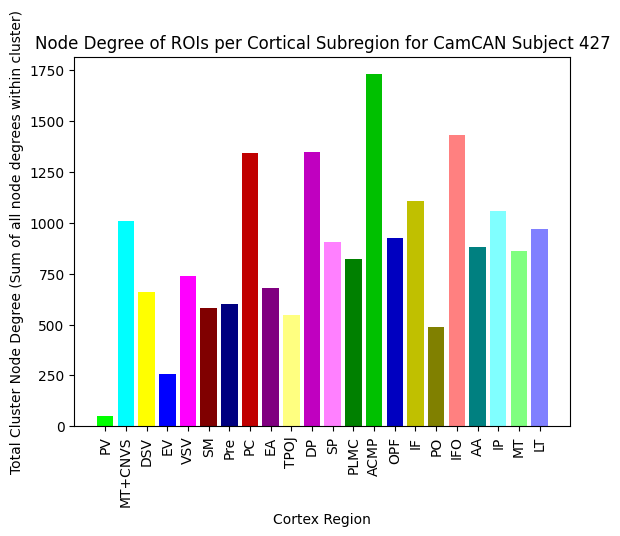

THIS IS THE SBJ ID:  428
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


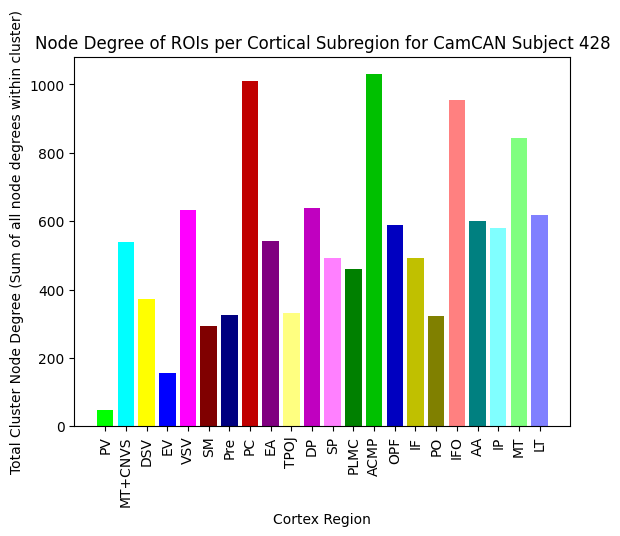

THIS IS THE SBJ ID:  429
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


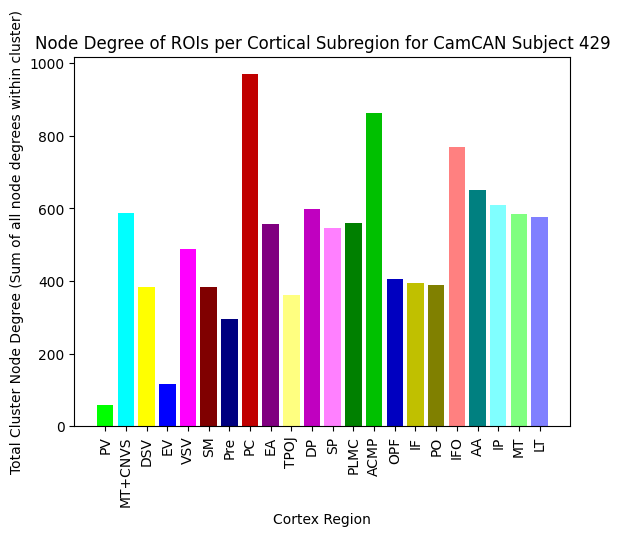

THIS IS THE SBJ ID:  430
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


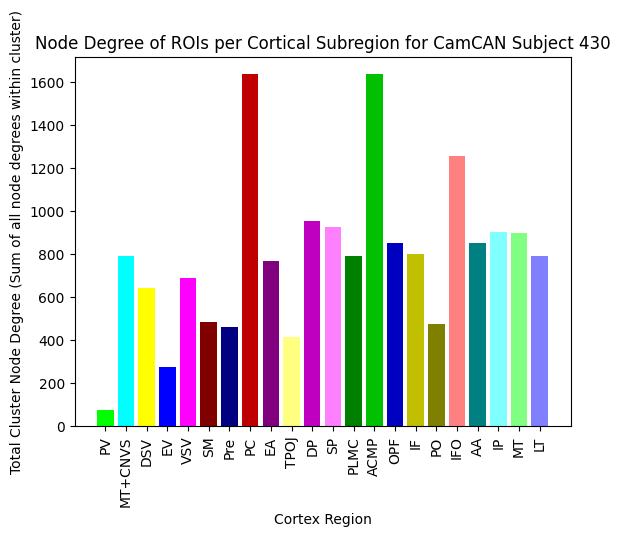

THIS IS THE SBJ ID:  431
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


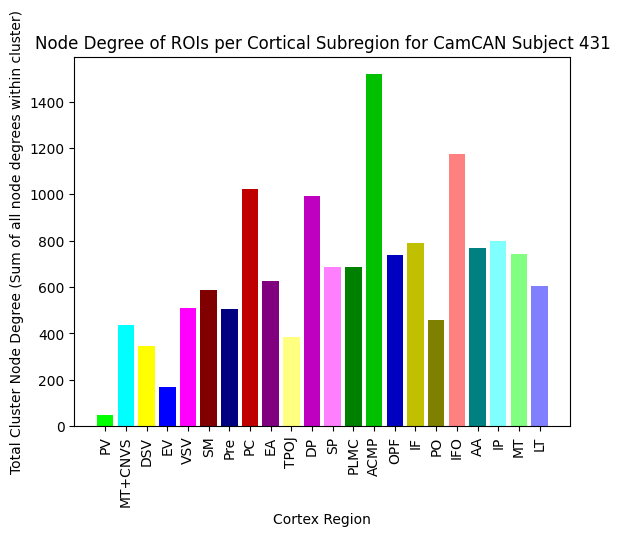

THIS IS THE SBJ ID:  432
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


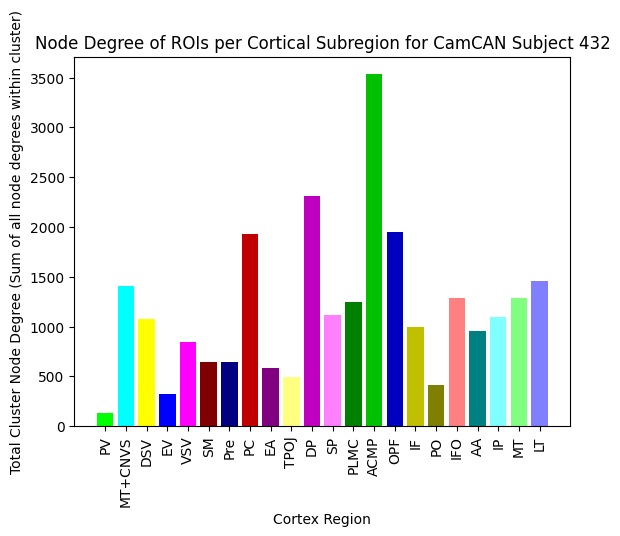

THIS IS THE SBJ ID:  433
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


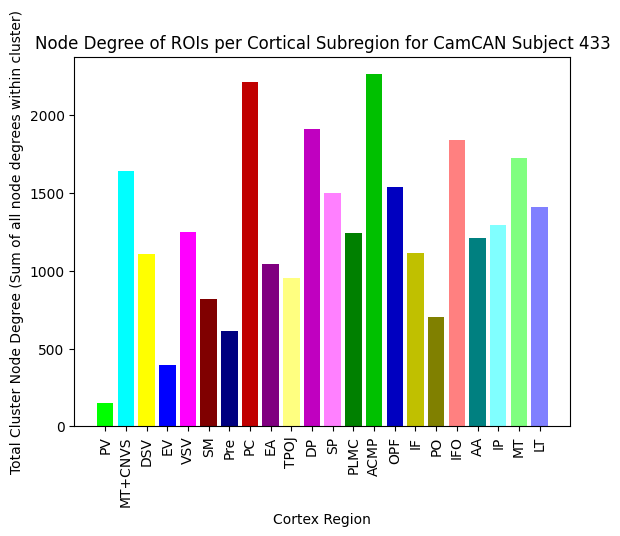

THIS IS THE SBJ ID:  434
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


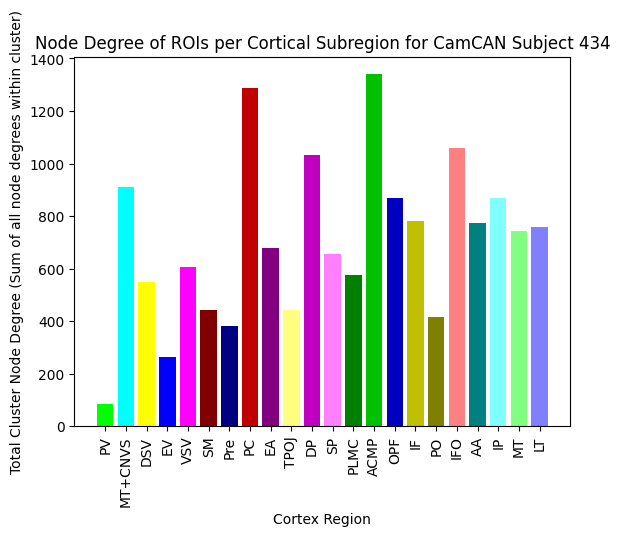

THIS IS THE SBJ ID:  435
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


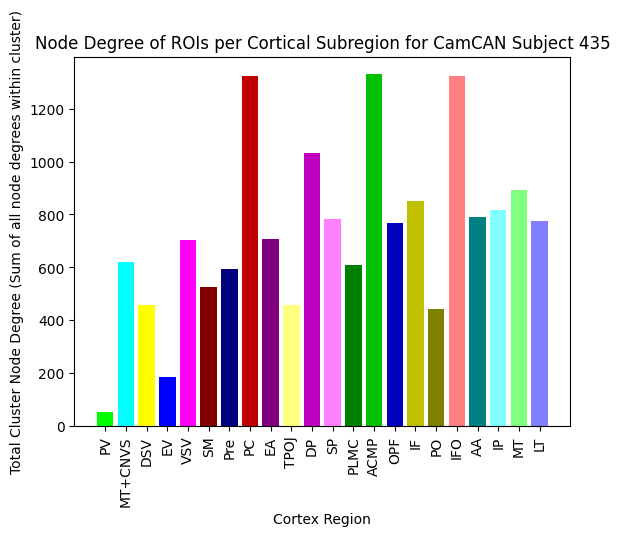

THIS IS THE SBJ ID:  436
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


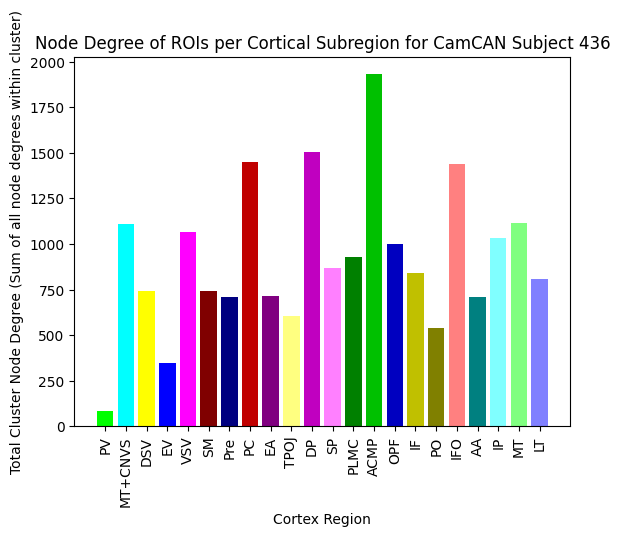

THIS IS THE SBJ ID:  437
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


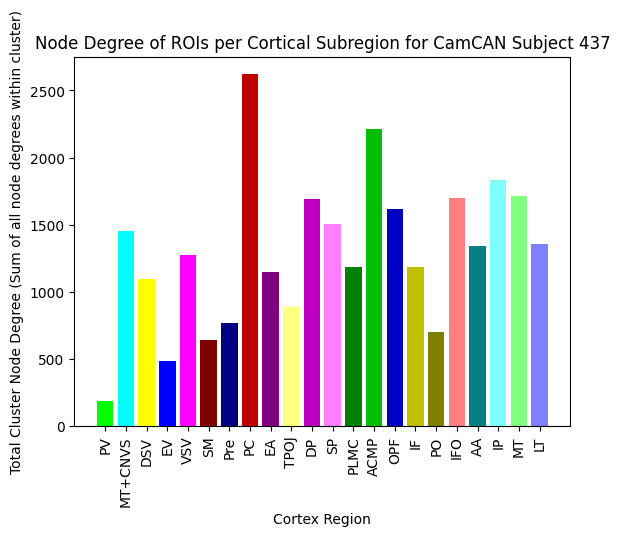

THIS IS THE SBJ ID:  438
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


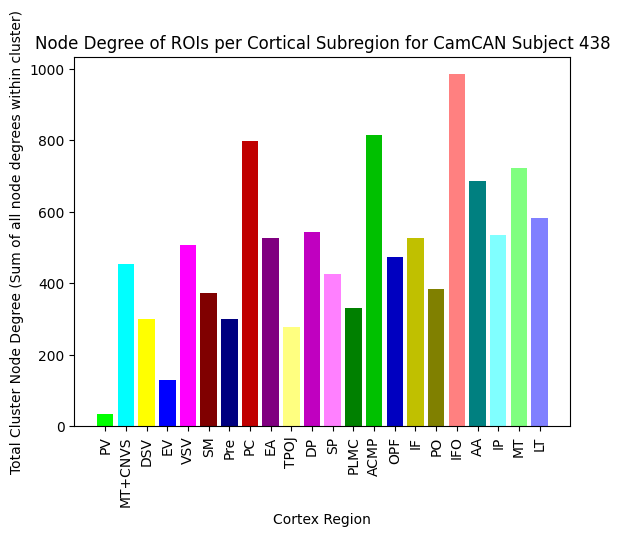

THIS IS THE SBJ ID:  439
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


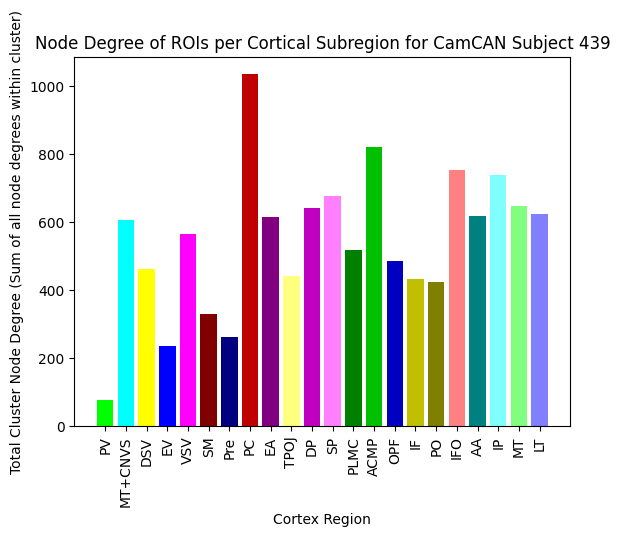

THIS IS THE SBJ ID:  440
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


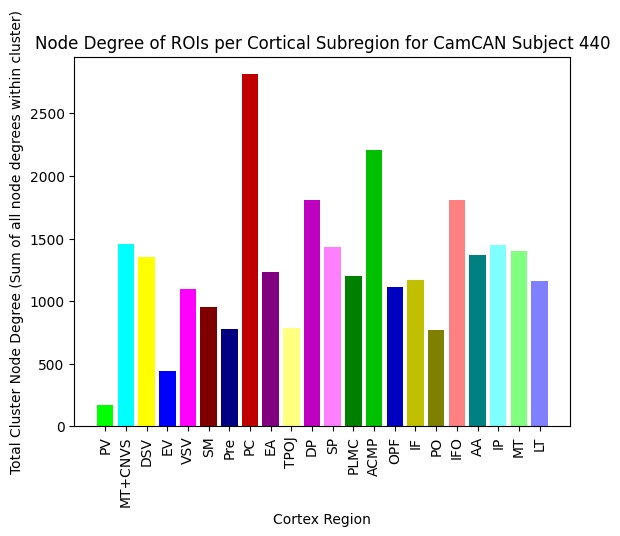

THIS IS THE SBJ ID:  441
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


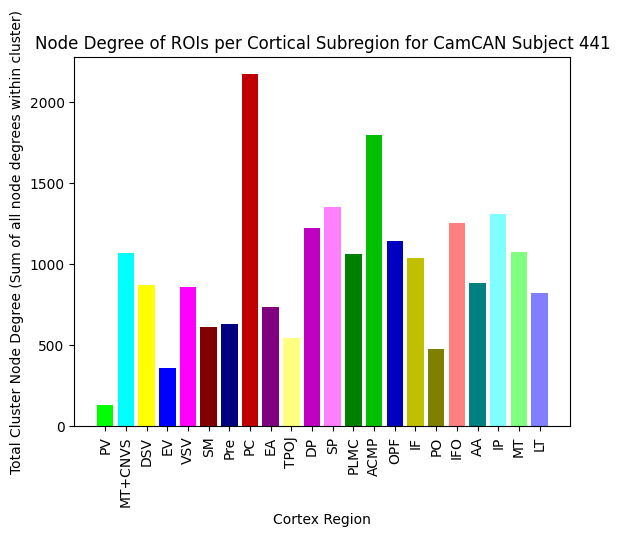

THIS IS THE SBJ ID:  442
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


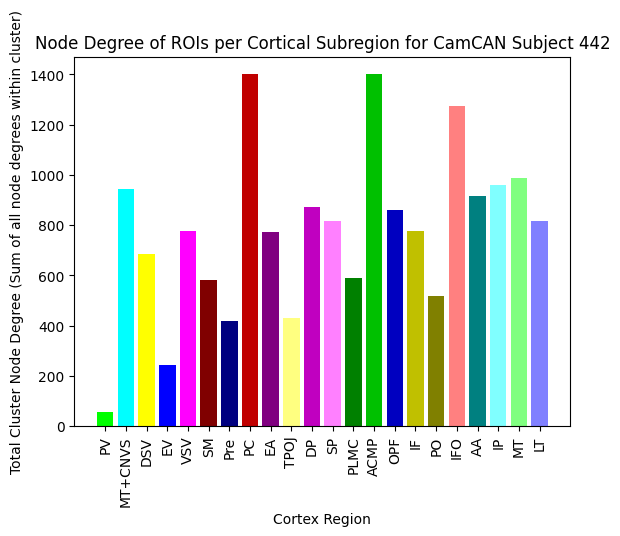

THIS IS THE SBJ ID:  443
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


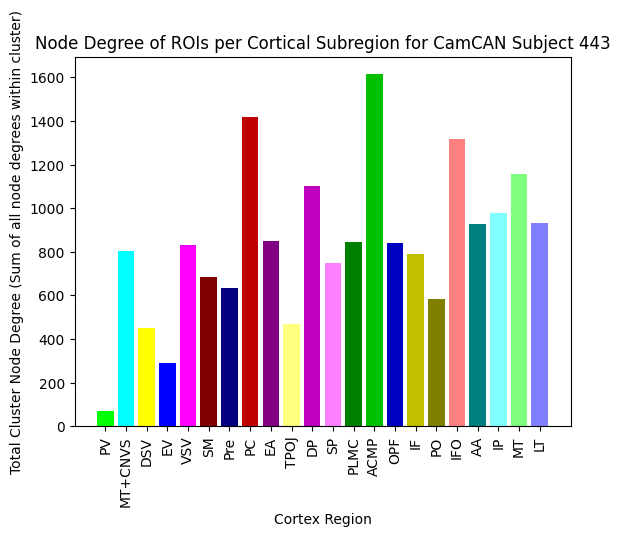

THIS IS THE SBJ ID:  444
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


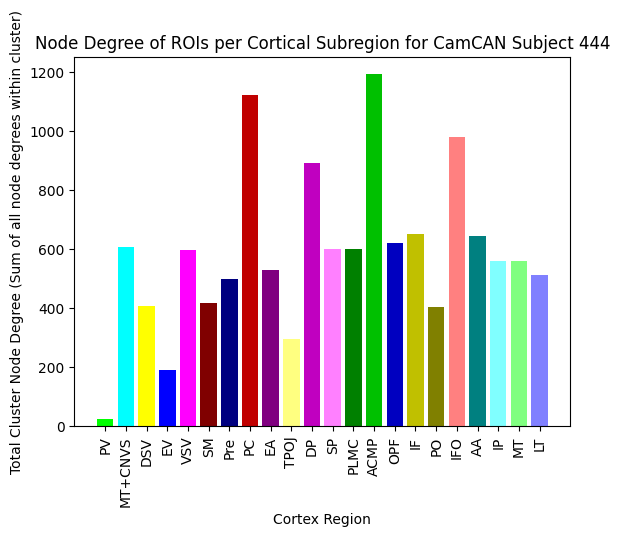

THIS IS THE SBJ ID:  445
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


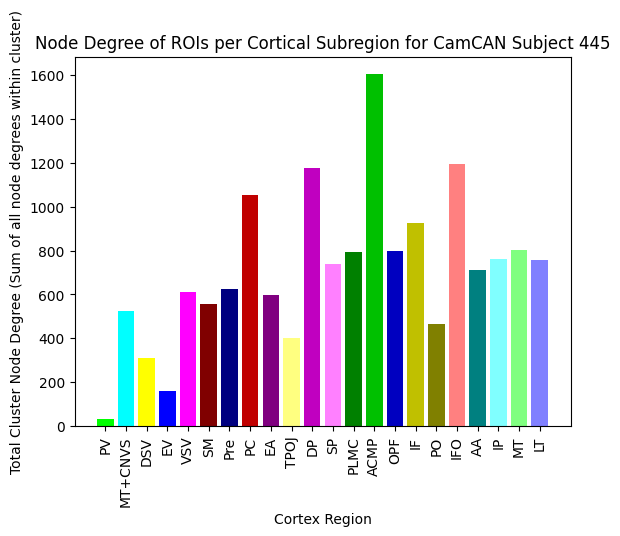

THIS IS THE SBJ ID:  446
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


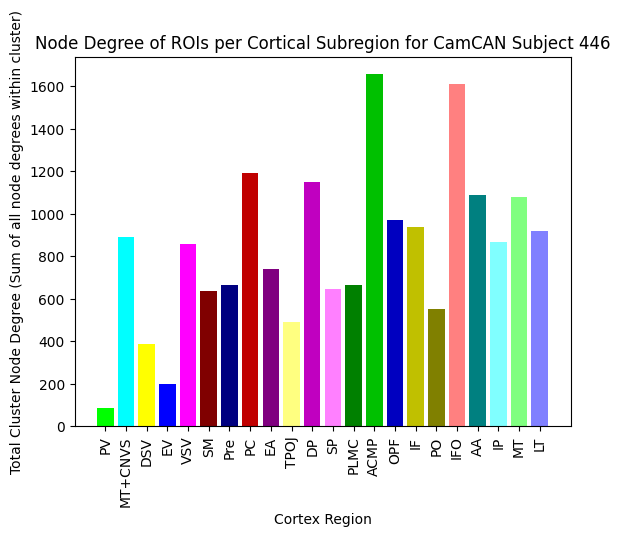

THIS IS THE SBJ ID:  447
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


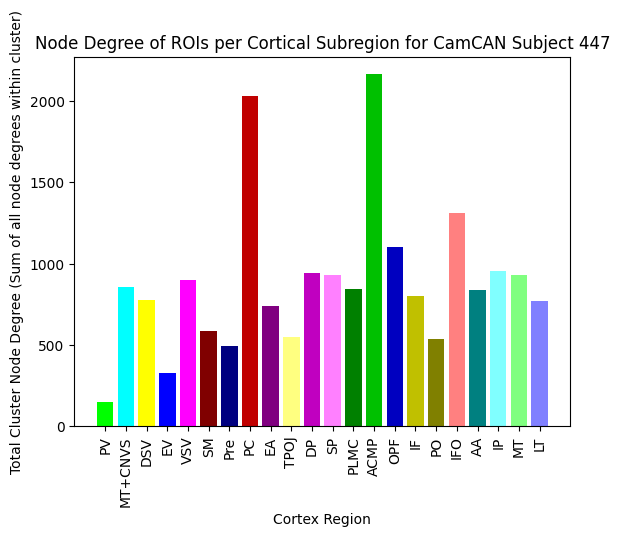

THIS IS THE SBJ ID:  448
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


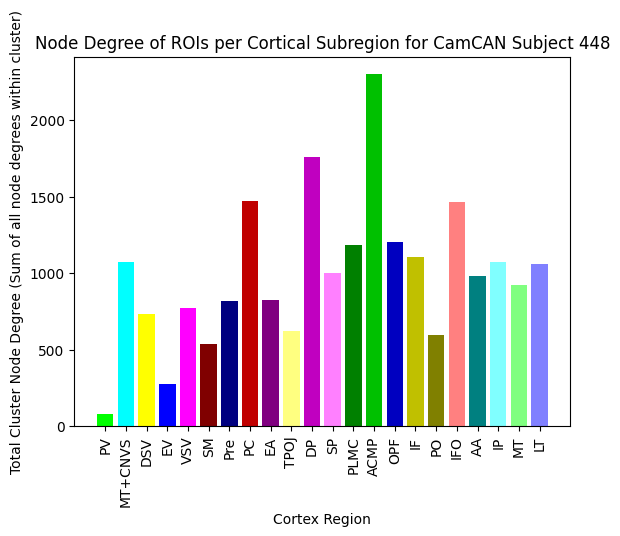

THIS IS THE SBJ ID:  449
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


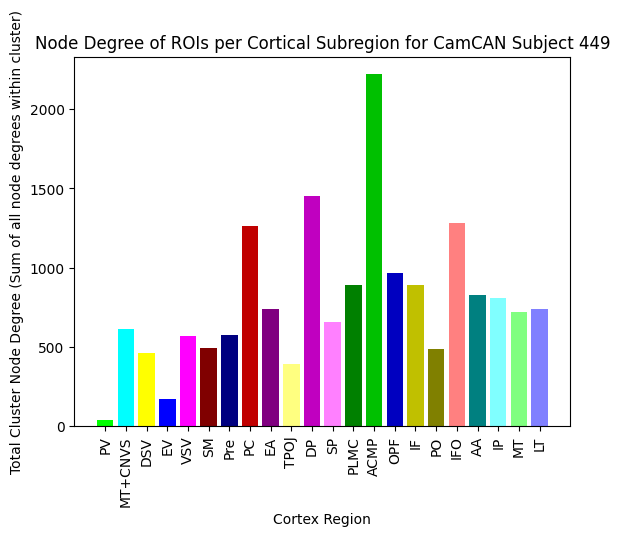

THIS IS THE SBJ ID:  450
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


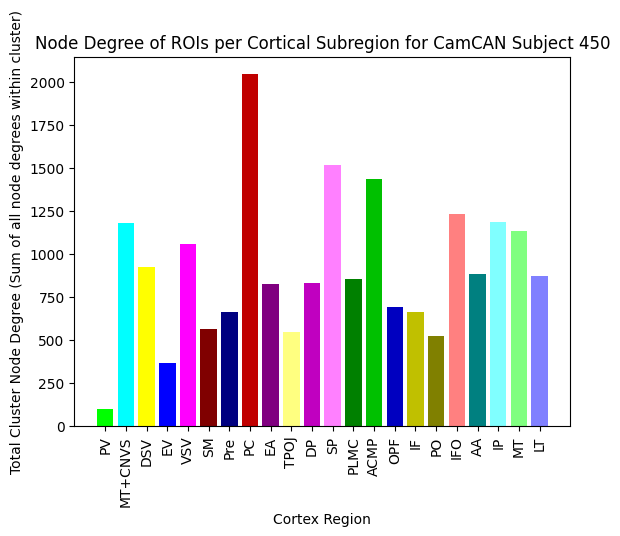

THIS IS THE SBJ ID:  451
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


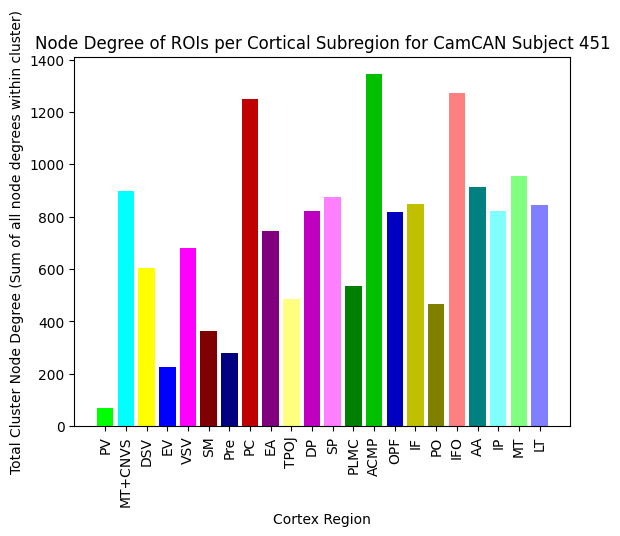

THIS IS THE SBJ ID:  452
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


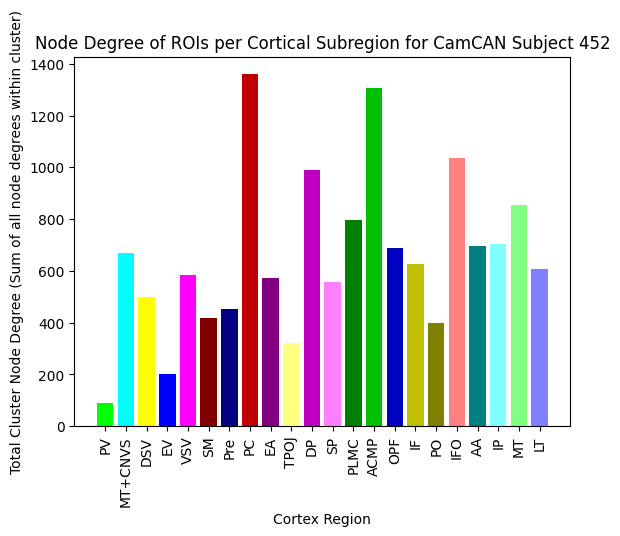

THIS IS THE SBJ ID:  453
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


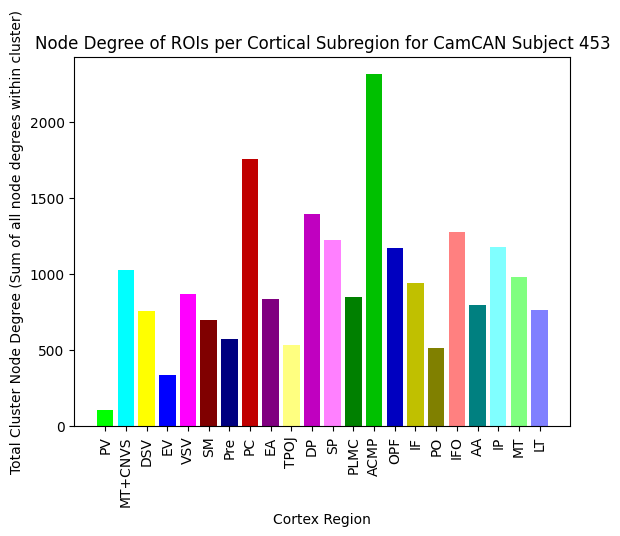

THIS IS THE SBJ ID:  454
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


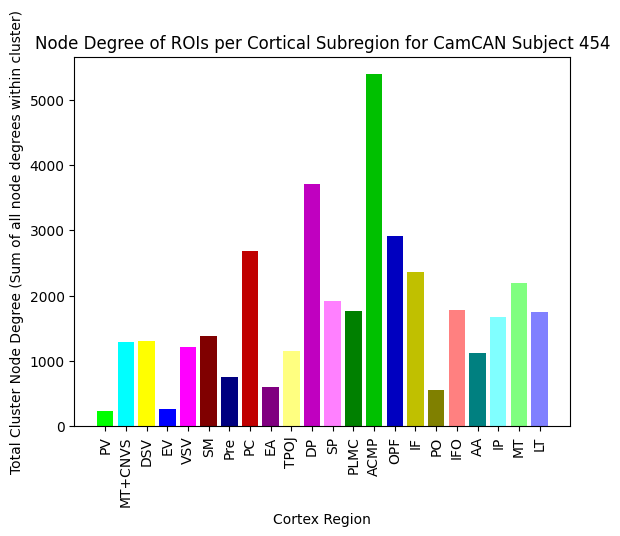

THIS IS THE SBJ ID:  455
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


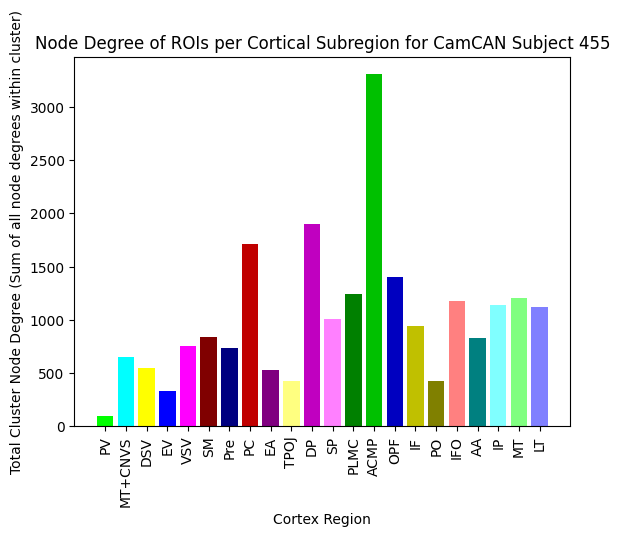

THIS IS THE SBJ ID:  456
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


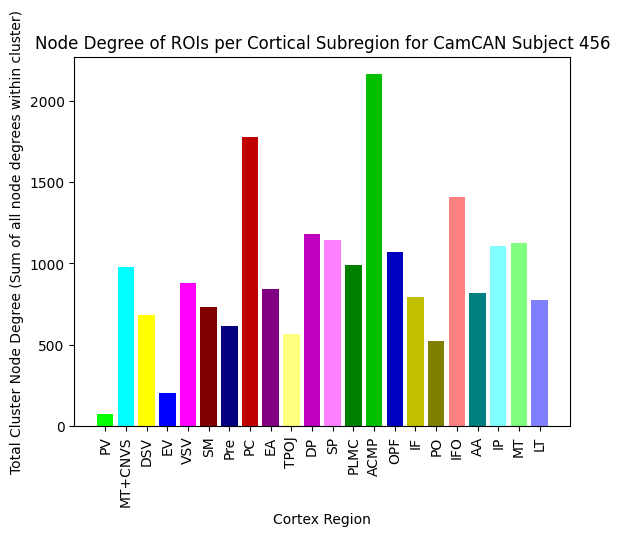

THIS IS THE SBJ ID:  457
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


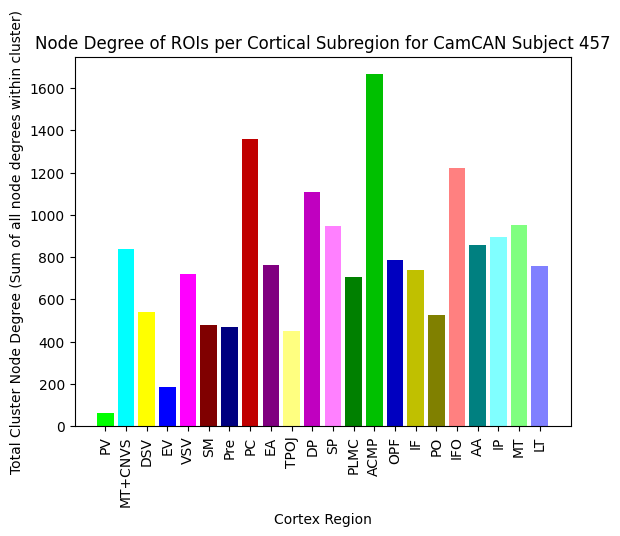

THIS IS THE SBJ ID:  458
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


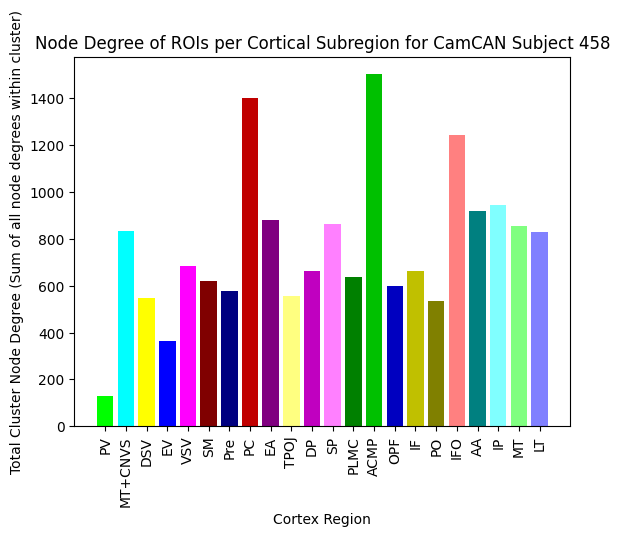

THIS IS THE SBJ ID:  459
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


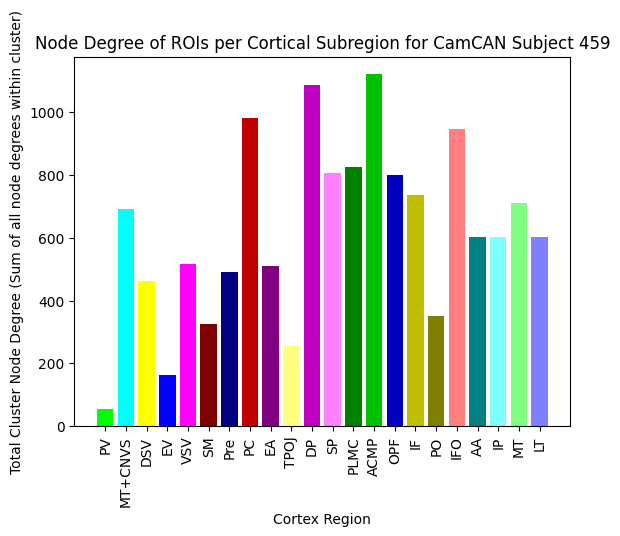

THIS IS THE SBJ ID:  460
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


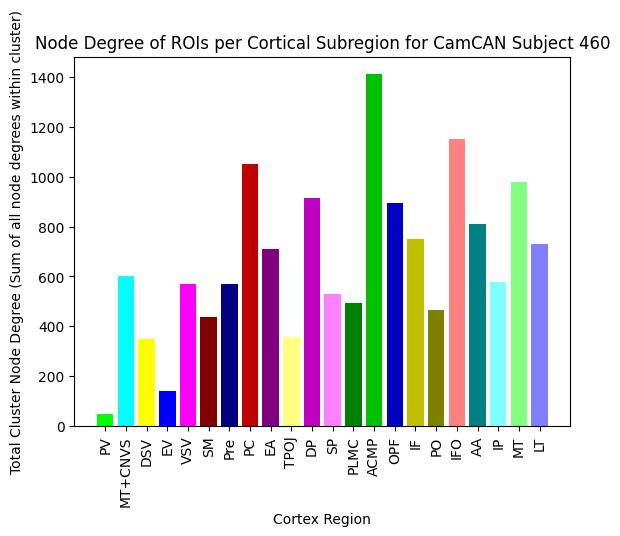

THIS IS THE SBJ ID:  461
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


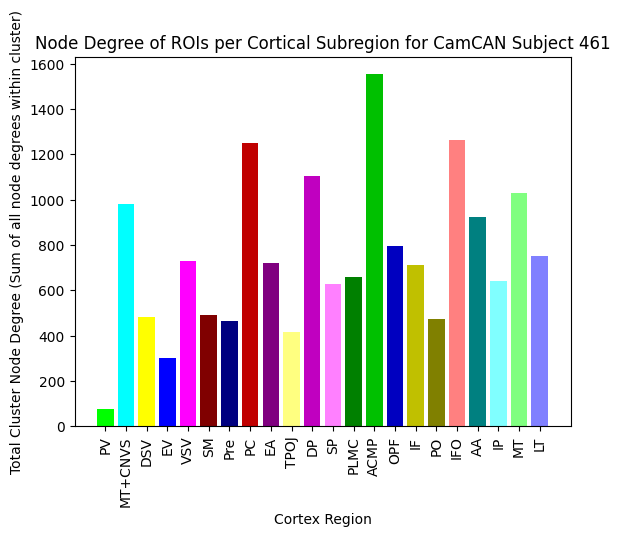

THIS IS THE SBJ ID:  462
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


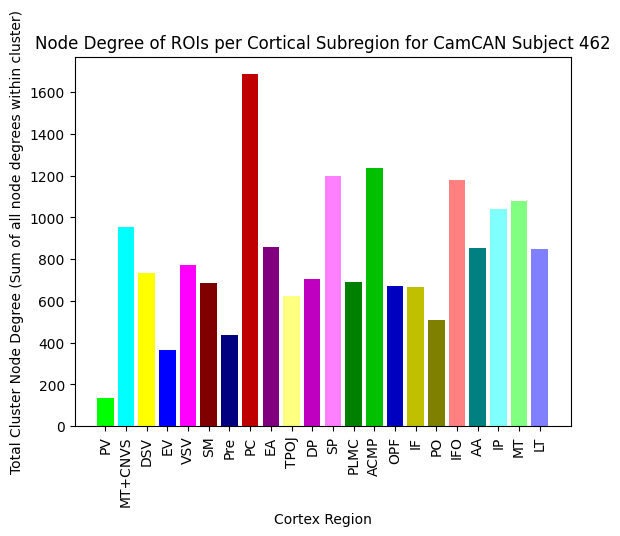

THIS IS THE SBJ ID:  463
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


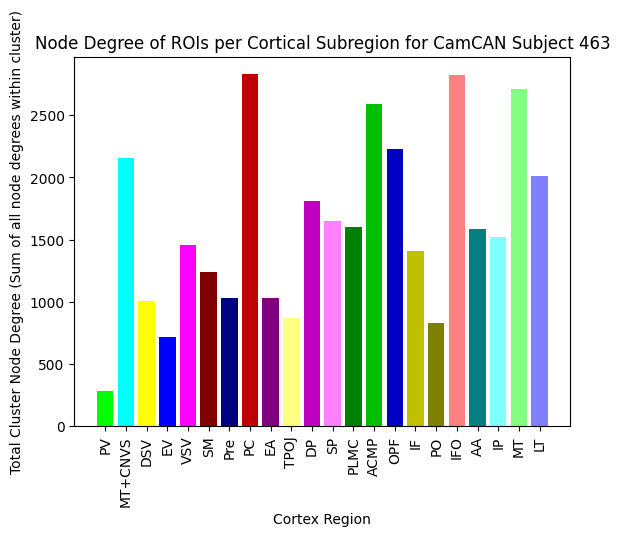

THIS IS THE SBJ ID:  464
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


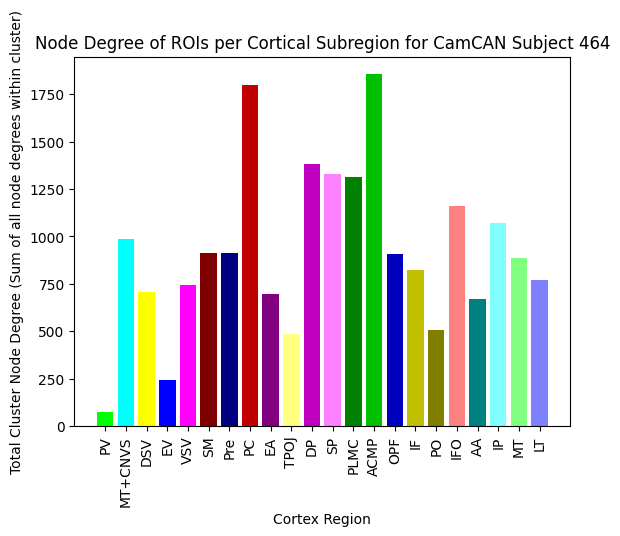

THIS IS THE SBJ ID:  465
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


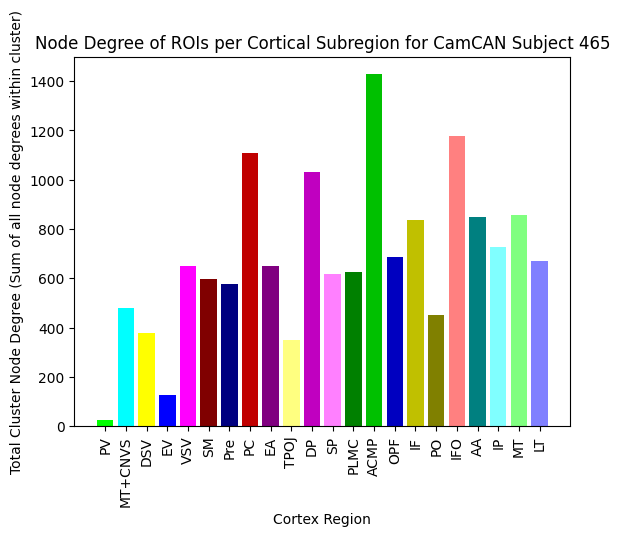

THIS IS THE SBJ ID:  466
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


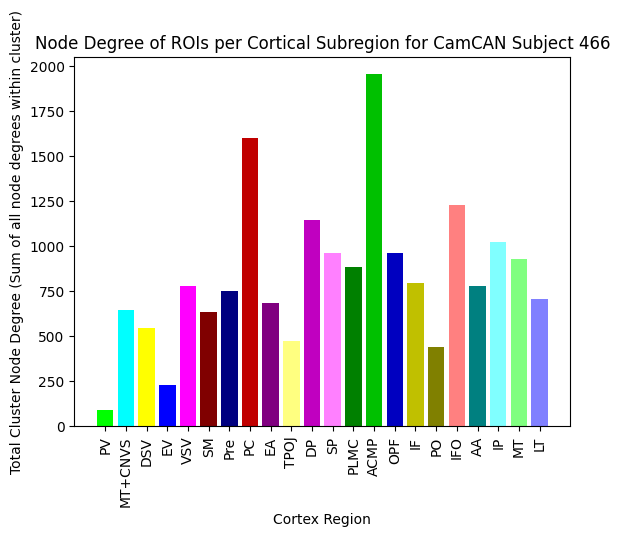

THIS IS THE SBJ ID:  467
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


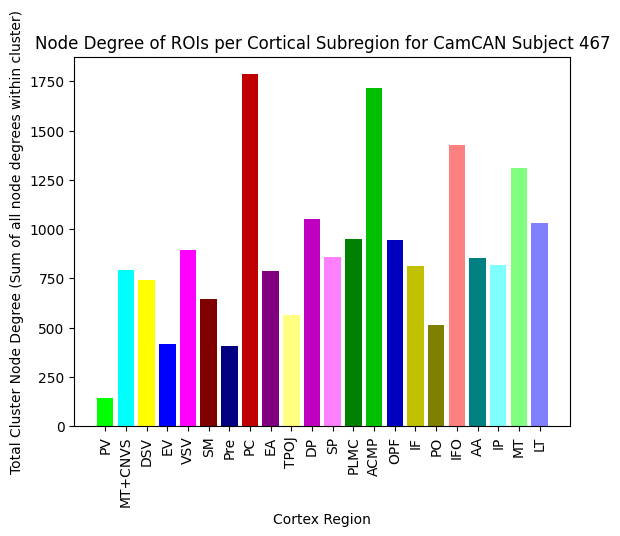

THIS IS THE SBJ ID:  468
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


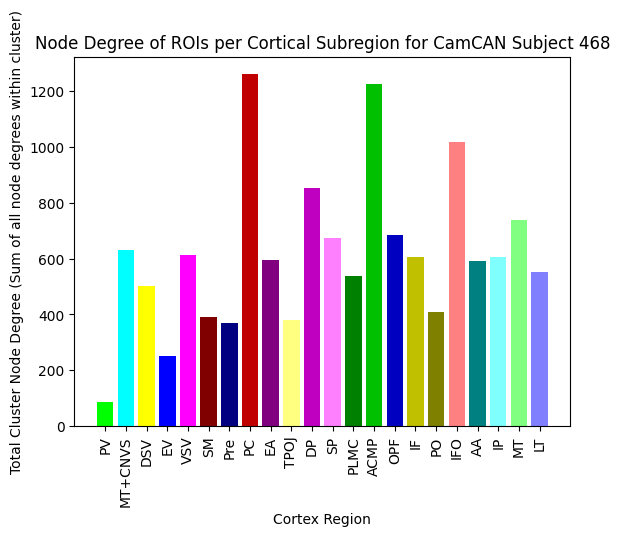

THIS IS THE SBJ ID:  469
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


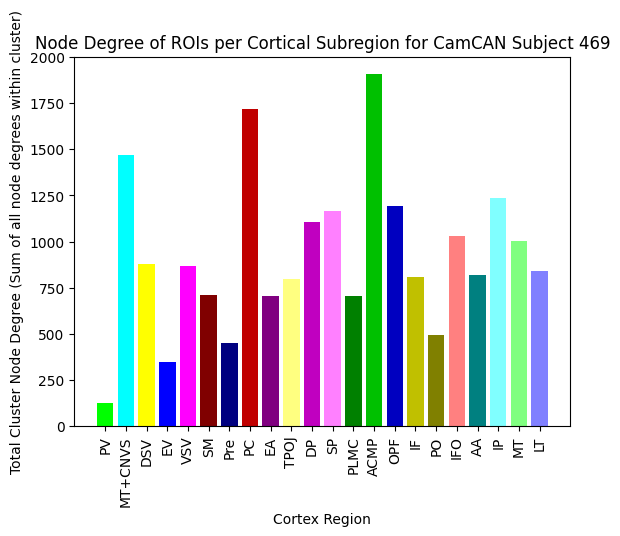

THIS IS THE SBJ ID:  470
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


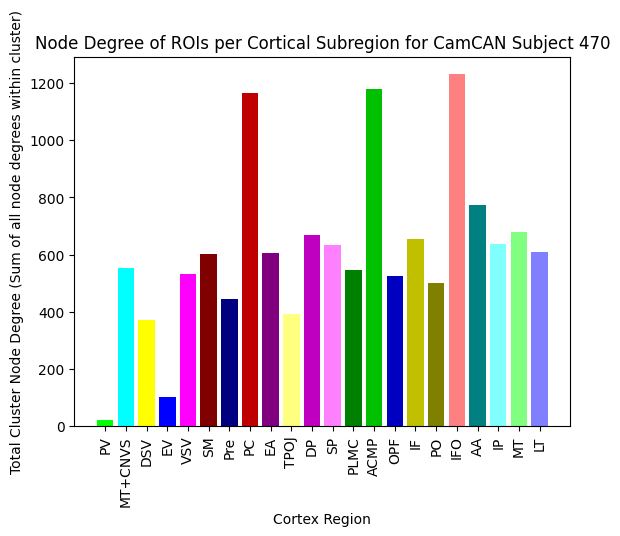

THIS IS THE SBJ ID:  471
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


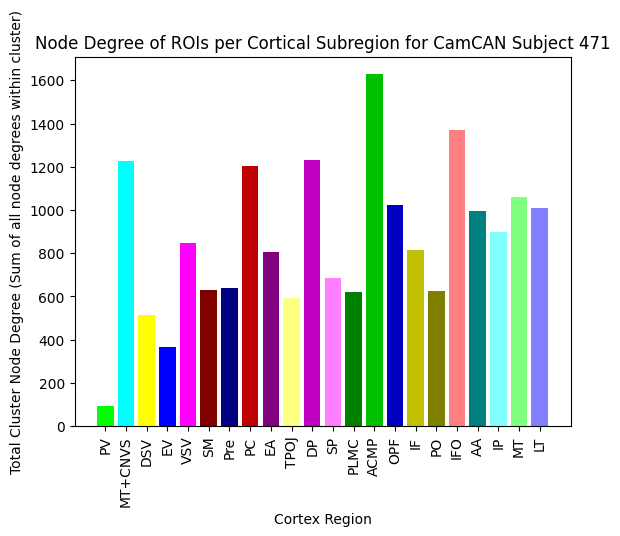

THIS IS THE SBJ ID:  472
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


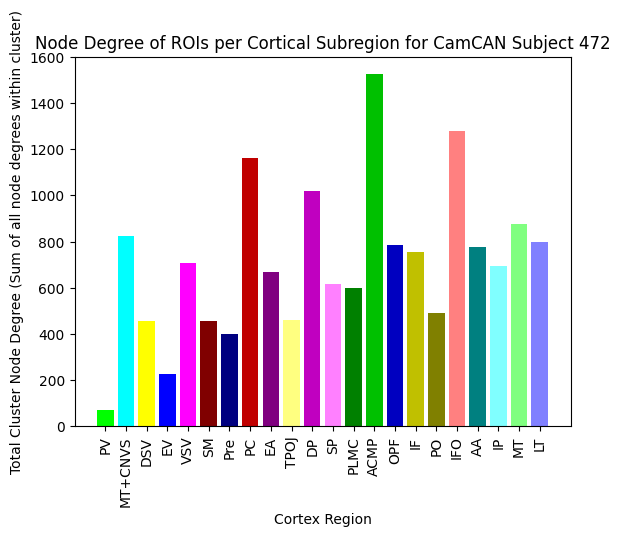

THIS IS THE SBJ ID:  473
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


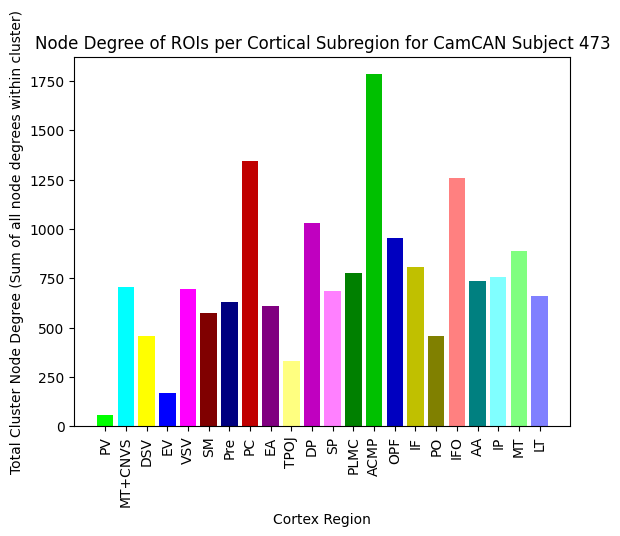

THIS IS THE SBJ ID:  474
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


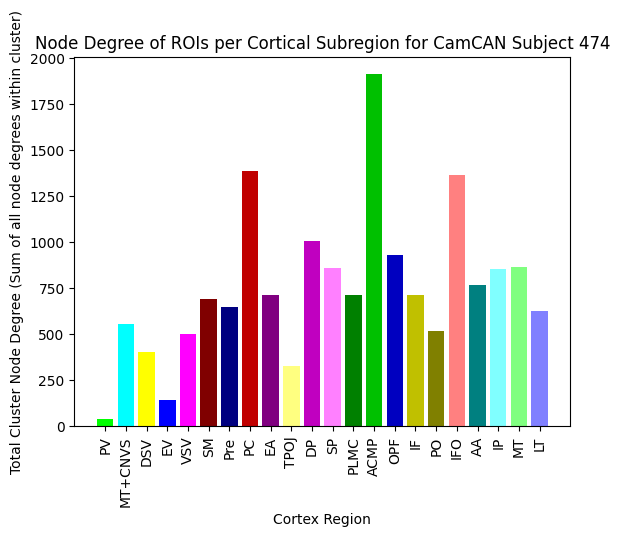

THIS IS THE SBJ ID:  475
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


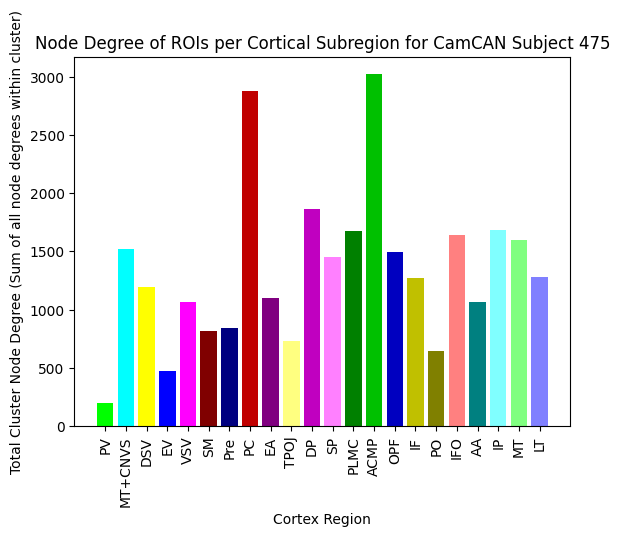

THIS IS THE SBJ ID:  476
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


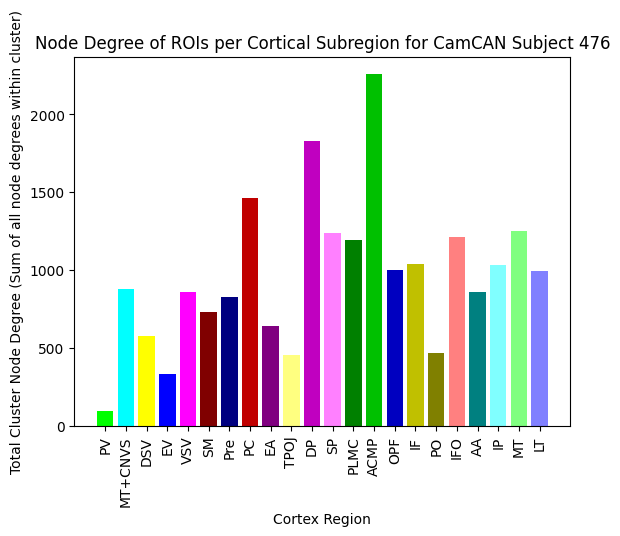

THIS IS THE SBJ ID:  477
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


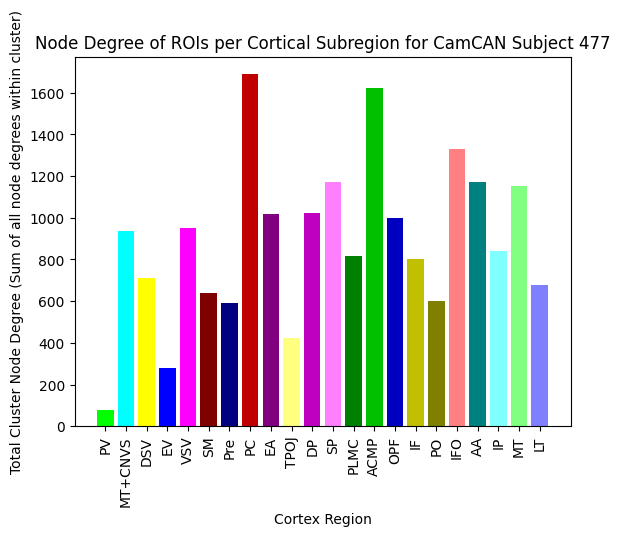

THIS IS THE SBJ ID:  478
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


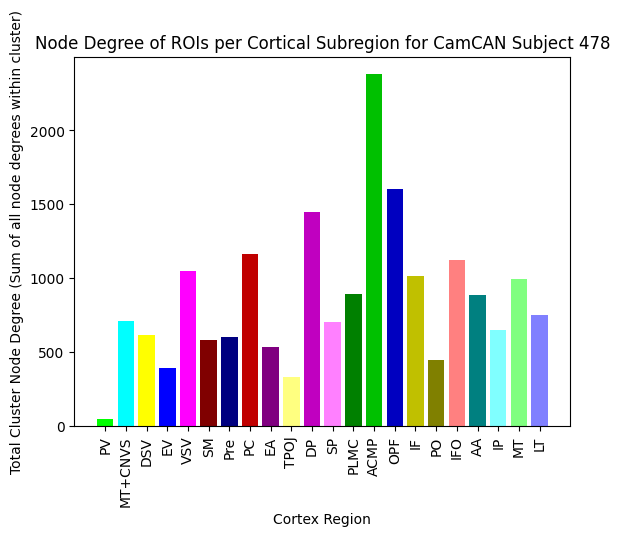

THIS IS THE SBJ ID:  479
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


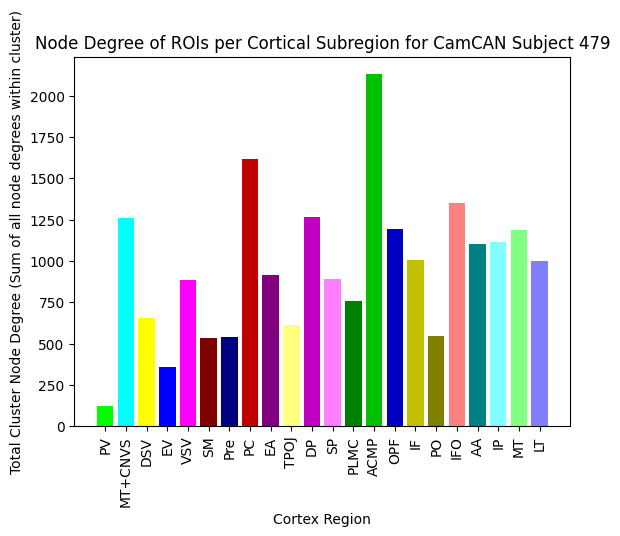

THIS IS THE SBJ ID:  480
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


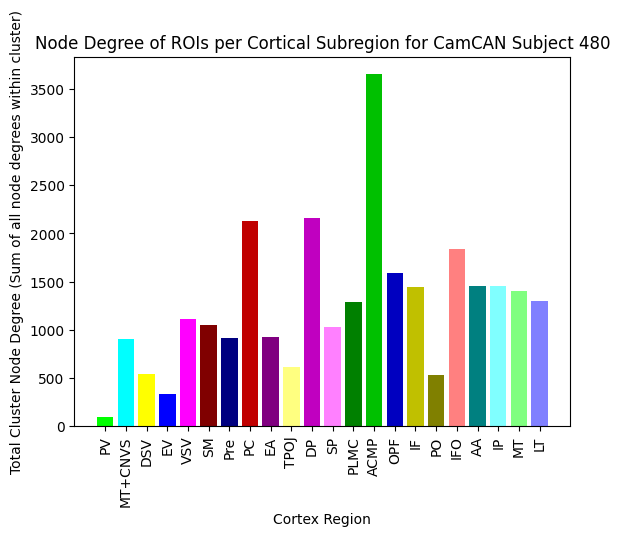

THIS IS THE SBJ ID:  481
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


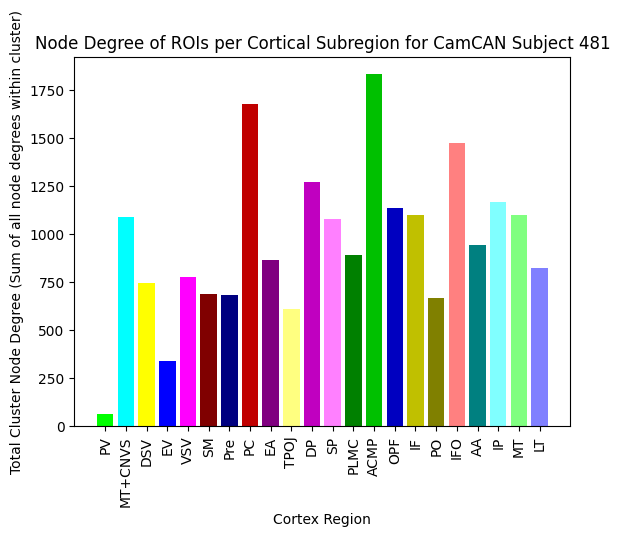

THIS IS THE SBJ ID:  482
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


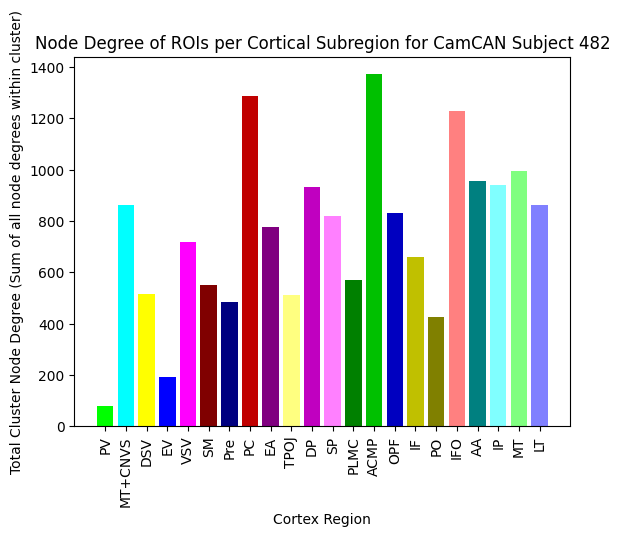

THIS IS THE SBJ ID:  483
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


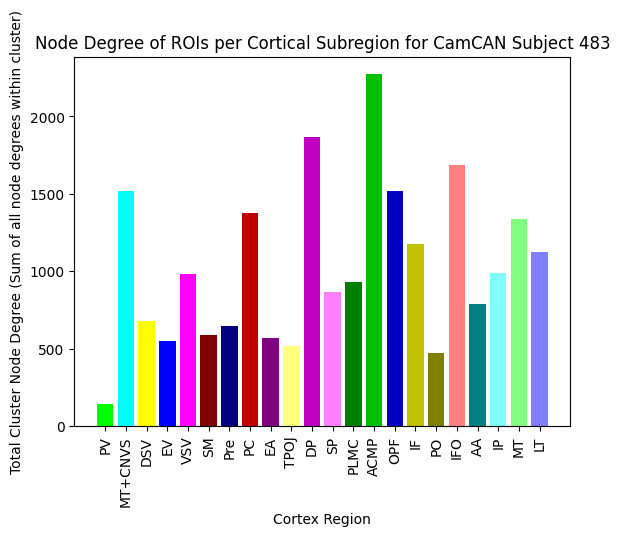

THIS IS THE SBJ ID:  484
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


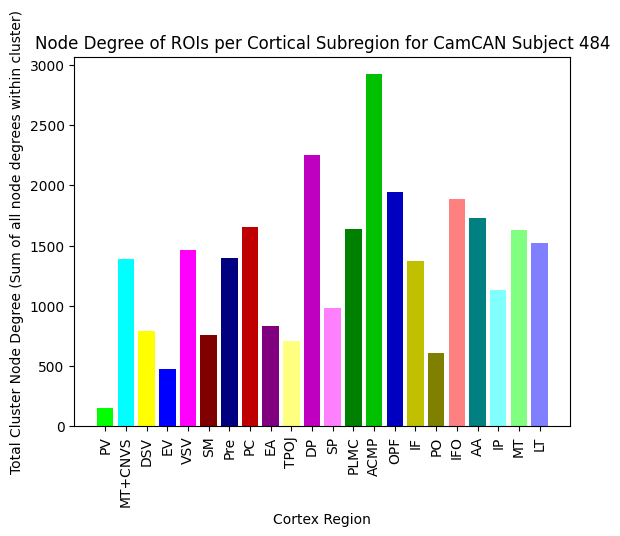

THIS IS THE SBJ ID:  485
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


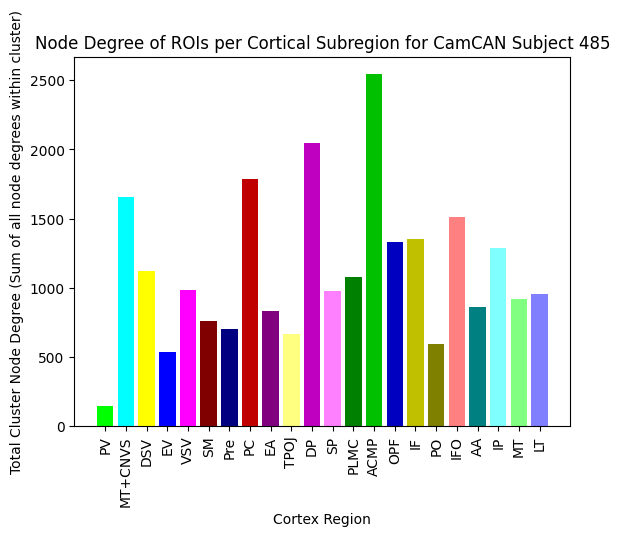

THIS IS THE SBJ ID:  486
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


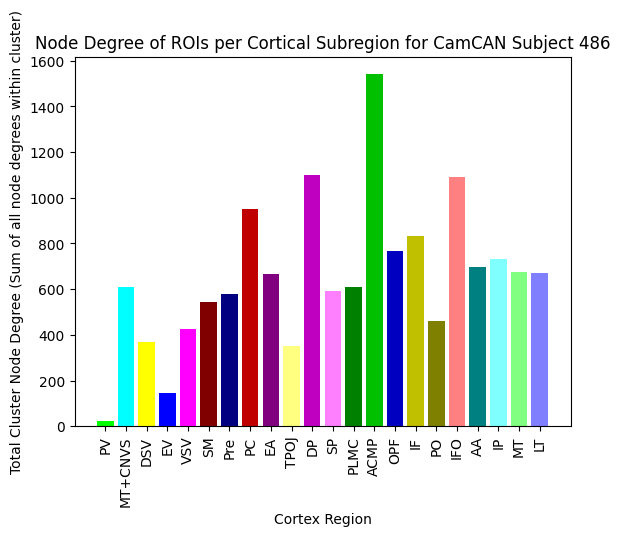

THIS IS THE SBJ ID:  487
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


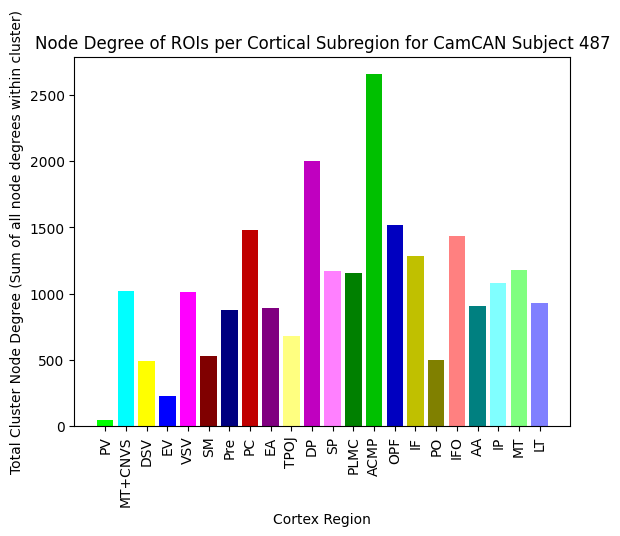

THIS IS THE SBJ ID:  488
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


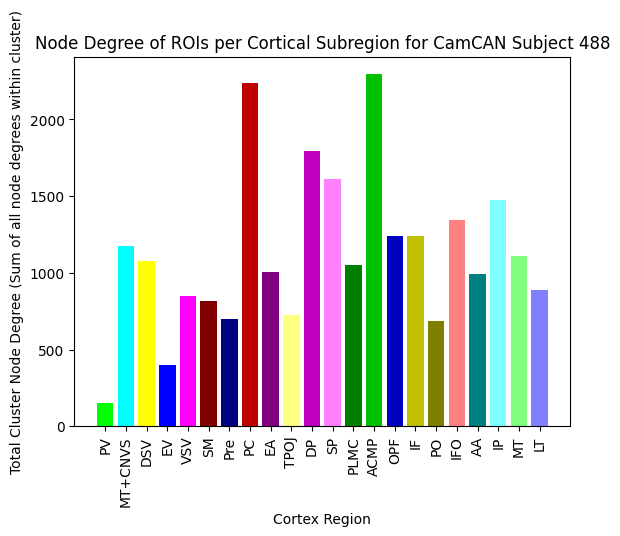

THIS IS THE SBJ ID:  489
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


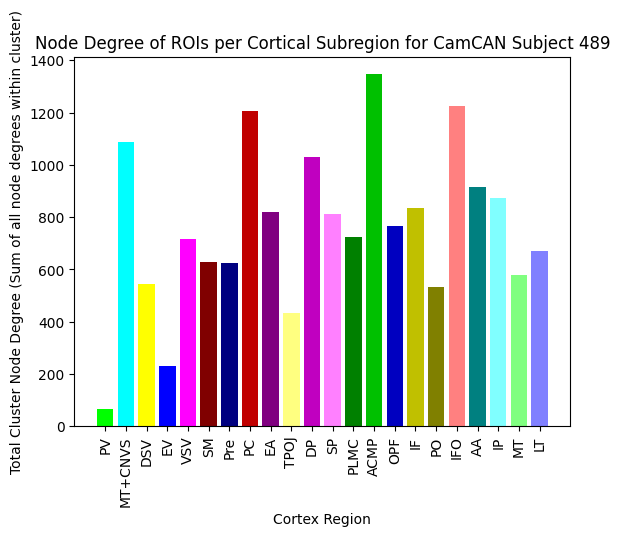

THIS IS THE SBJ ID:  490
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


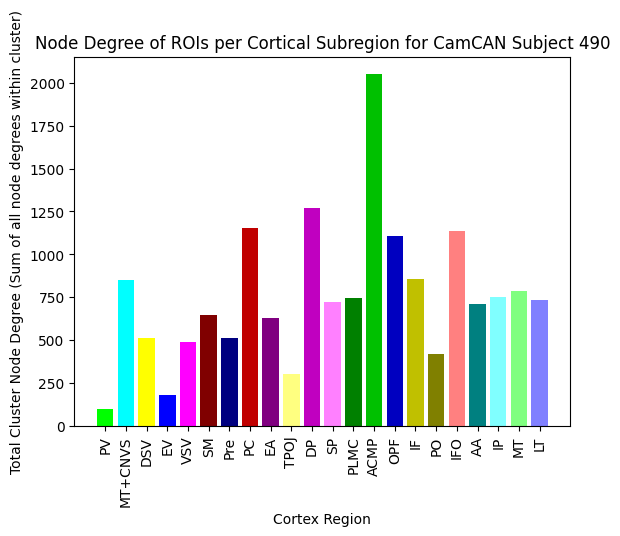

THIS IS THE SBJ ID:  491
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


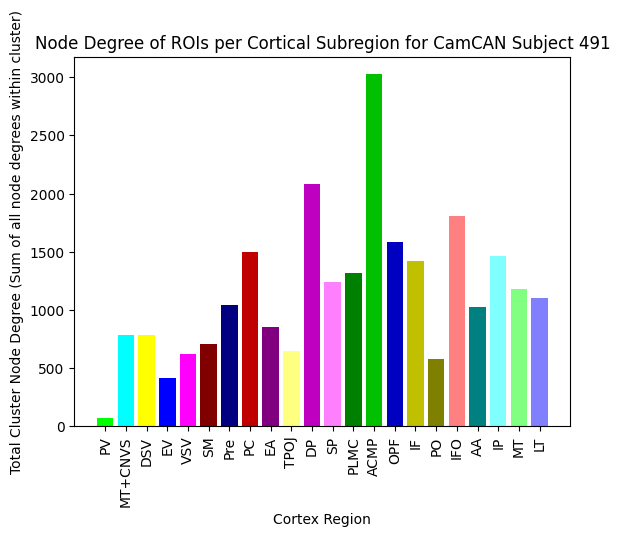

THIS IS THE SBJ ID:  492
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


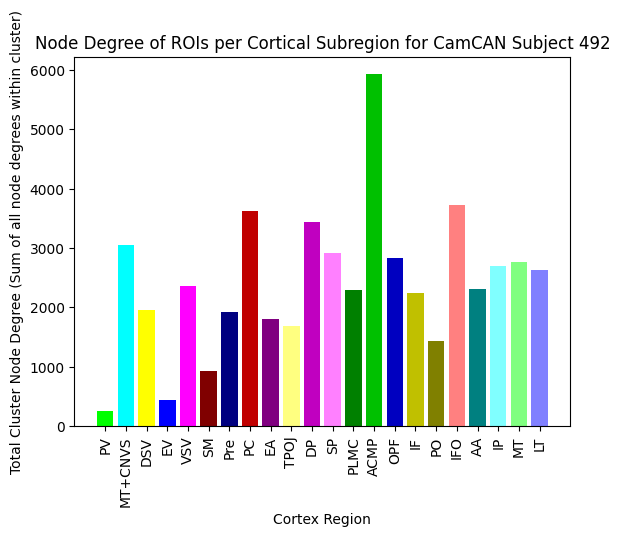

THIS IS THE SBJ ID:  493
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


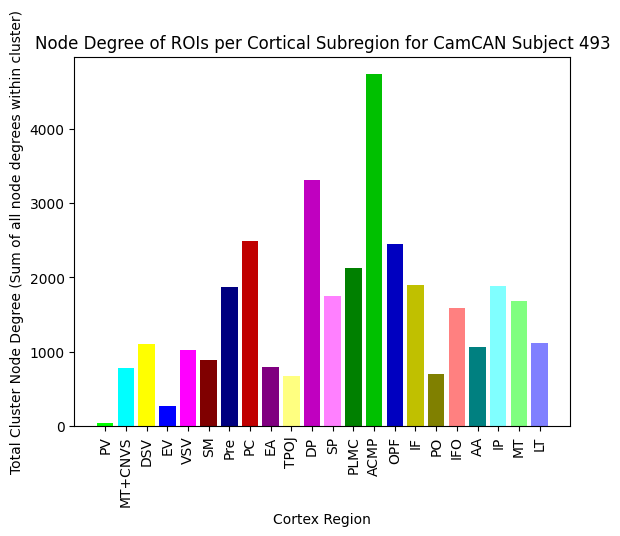

THIS IS THE SBJ ID:  494
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


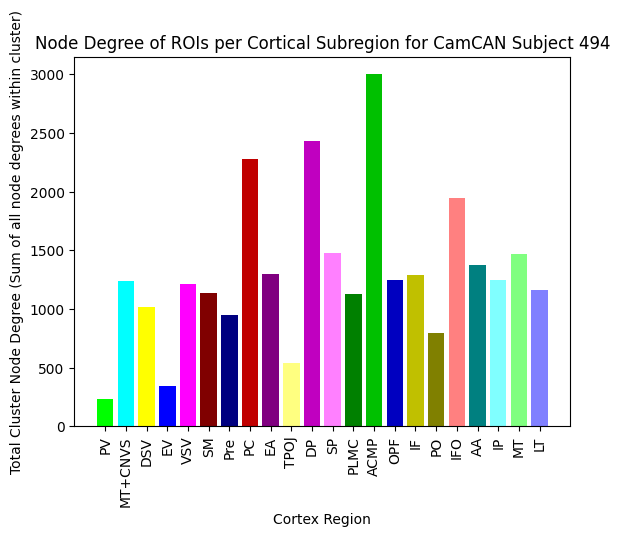

THIS IS THE SBJ ID:  495
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


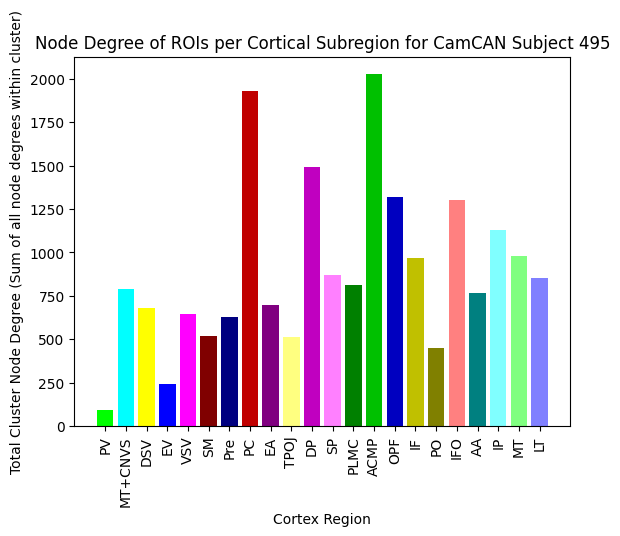

THIS IS THE SBJ ID:  496
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


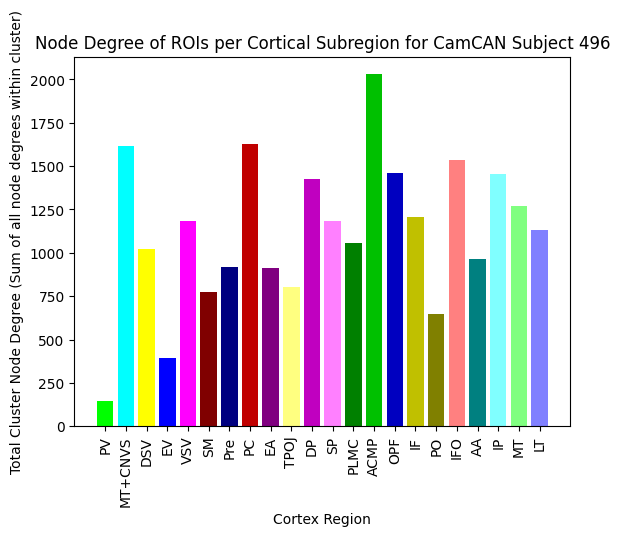

THIS IS THE SBJ ID:  497
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


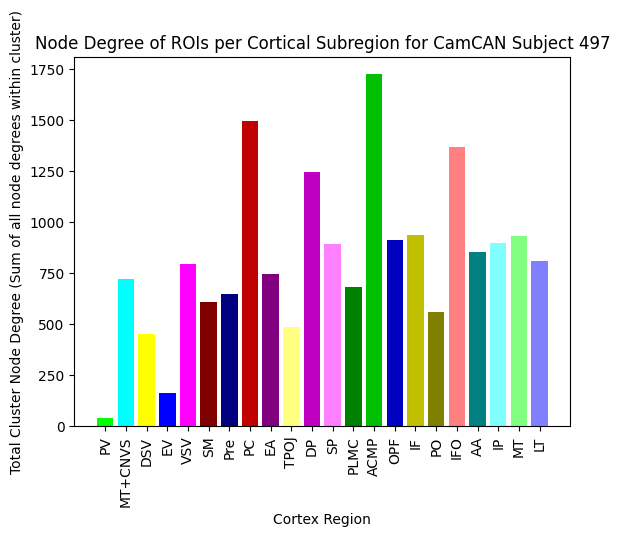

THIS IS THE SBJ ID:  498
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


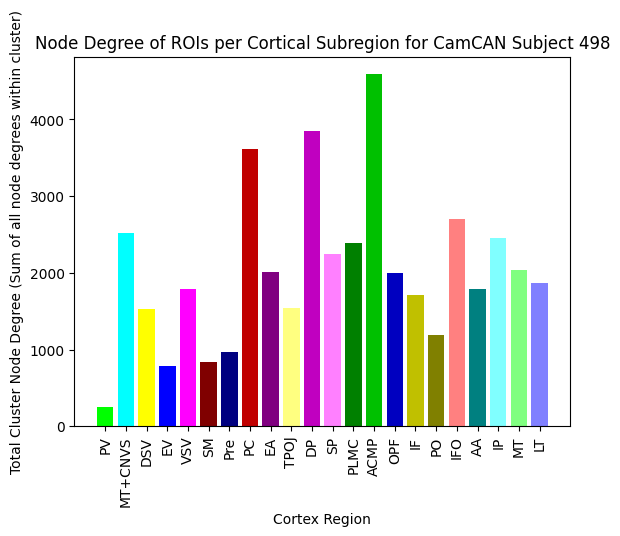

THIS IS THE SBJ ID:  499
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


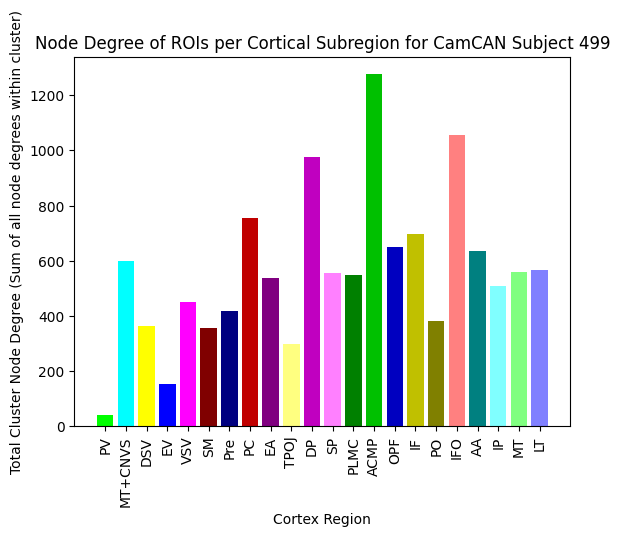

THIS IS THE SBJ ID:  500
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


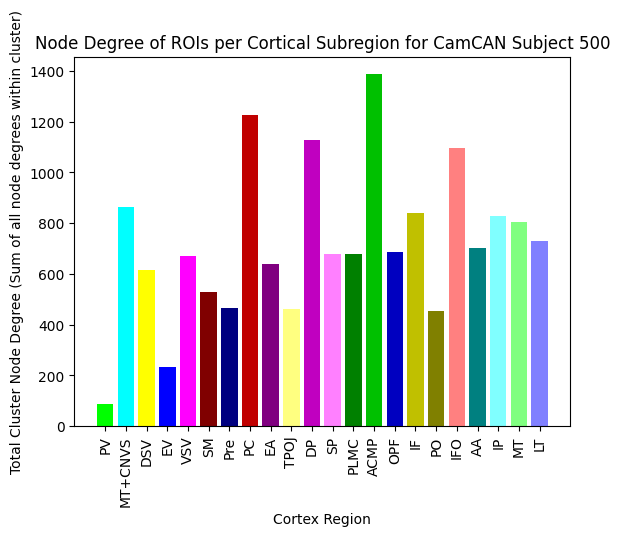

THIS IS THE SBJ ID:  501
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


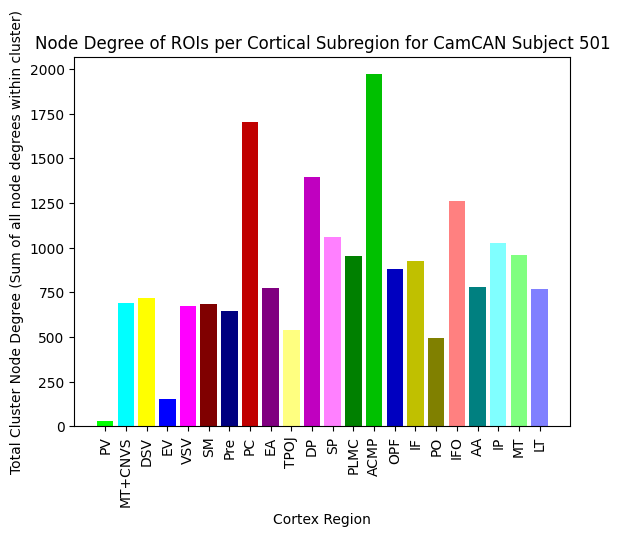

THIS IS THE SBJ ID:  502
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


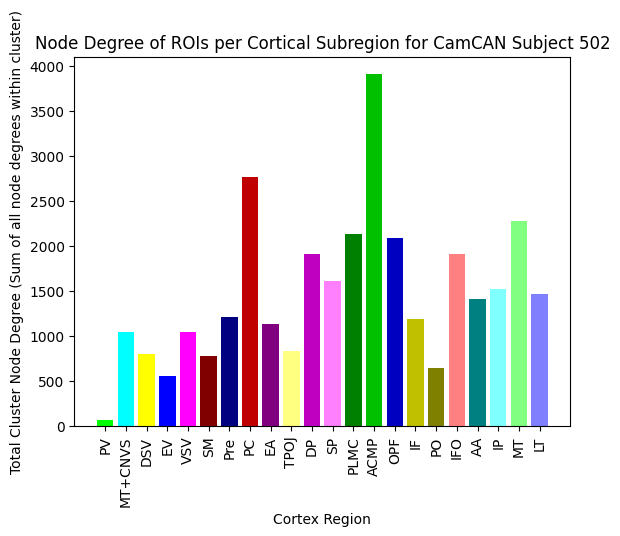

THIS IS THE SBJ ID:  503
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


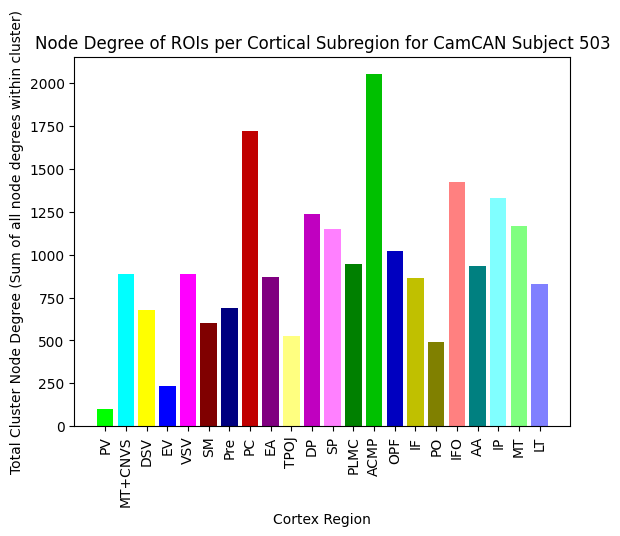

THIS IS THE SBJ ID:  504
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


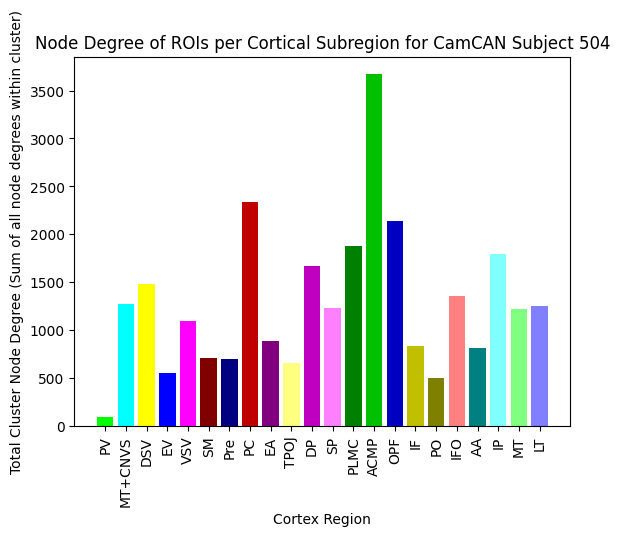

THIS IS THE SBJ ID:  505
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


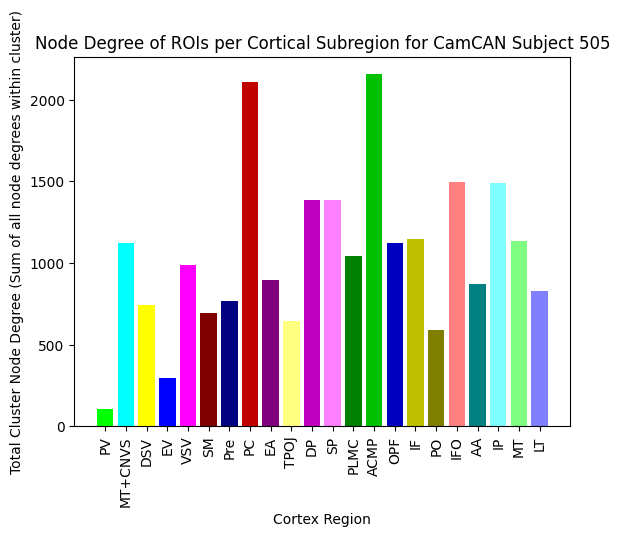

THIS IS THE SBJ ID:  506
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


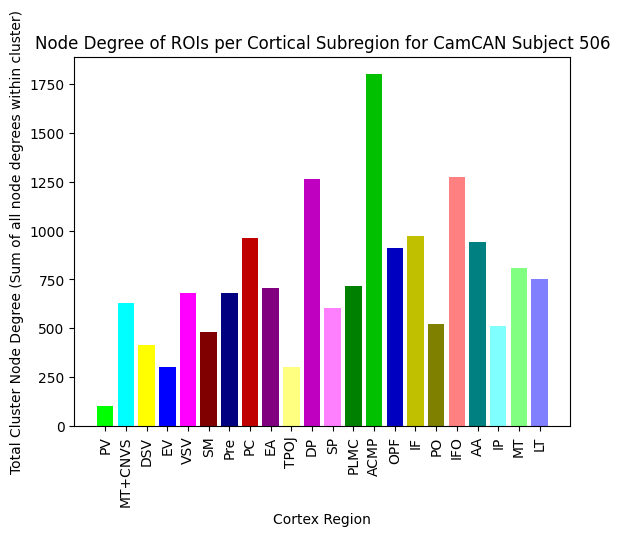

THIS IS THE SBJ ID:  507
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


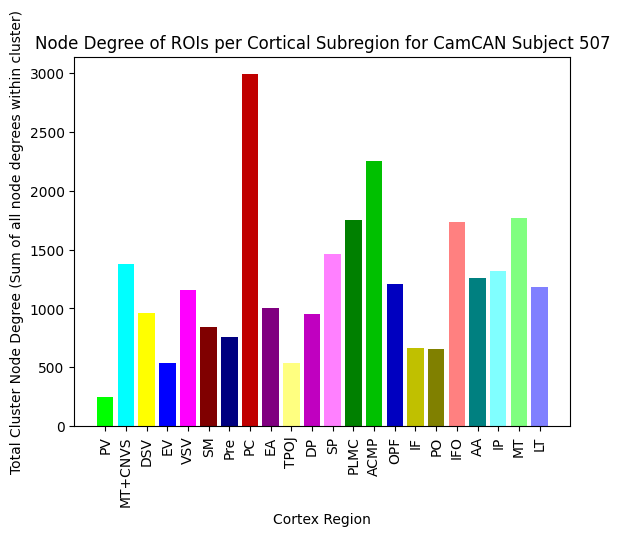

THIS IS THE SBJ ID:  508
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


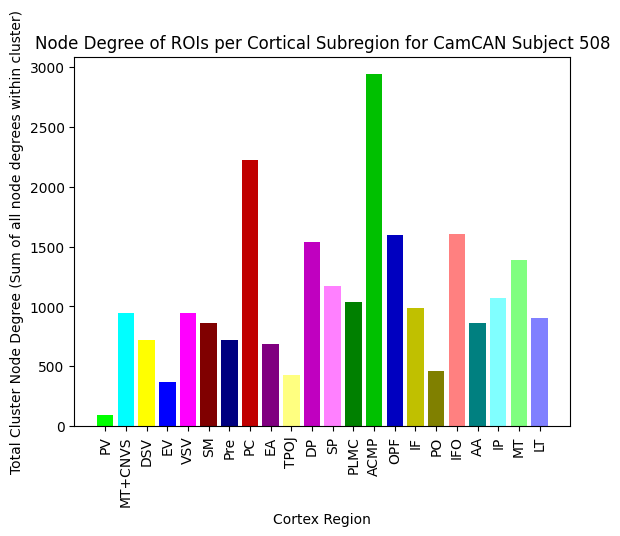

THIS IS THE SBJ ID:  509
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


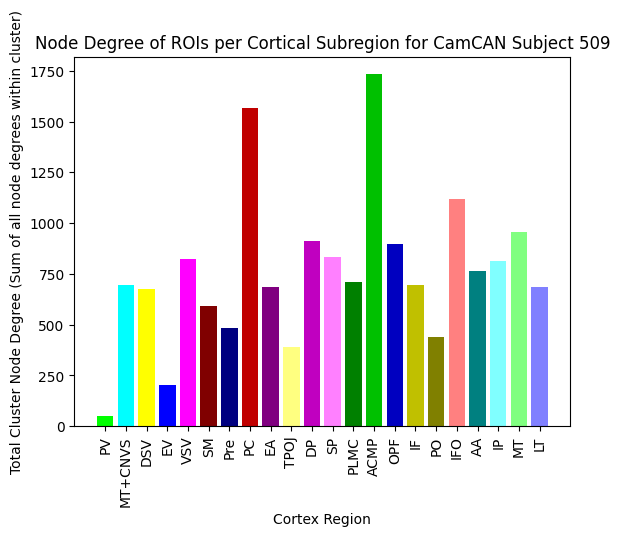

THIS IS THE SBJ ID:  510
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


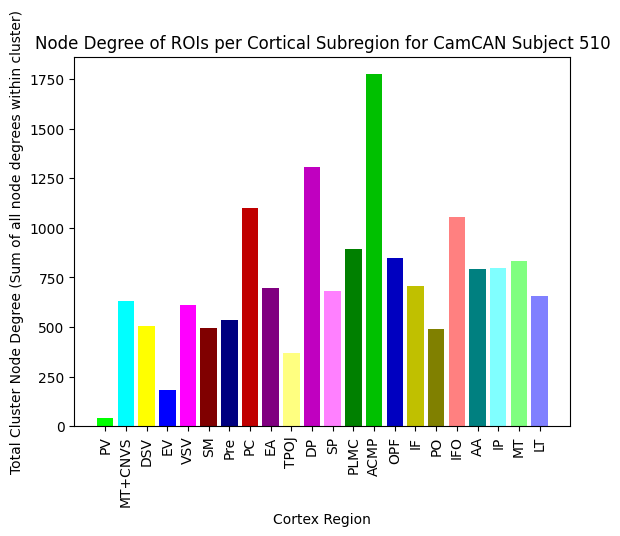

THIS IS THE SBJ ID:  511
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


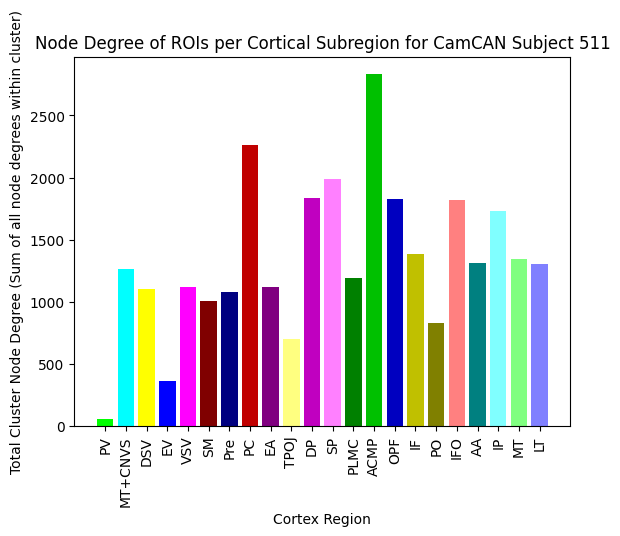

THIS IS THE SBJ ID:  512
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


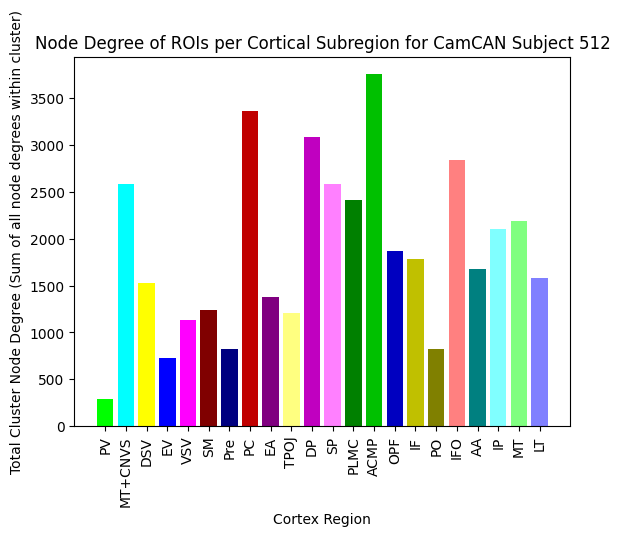

THIS IS THE SBJ ID:  513
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


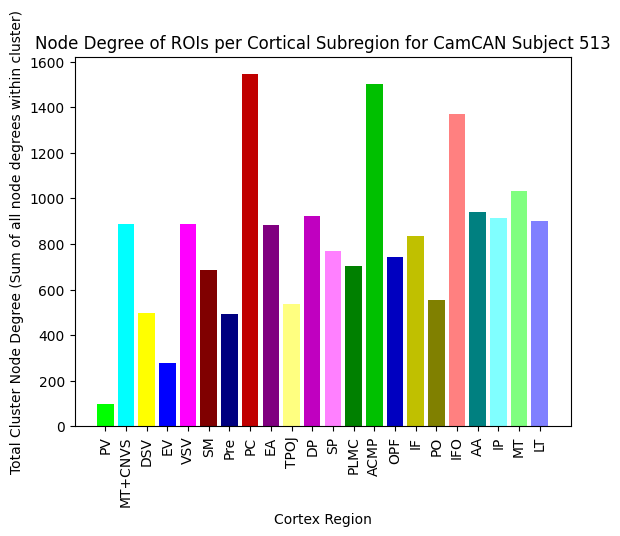

THIS IS THE SBJ ID:  514
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


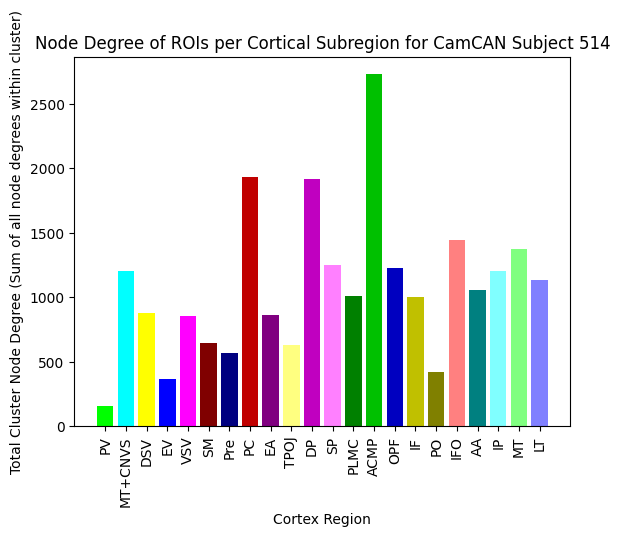

THIS IS THE SBJ ID:  515
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


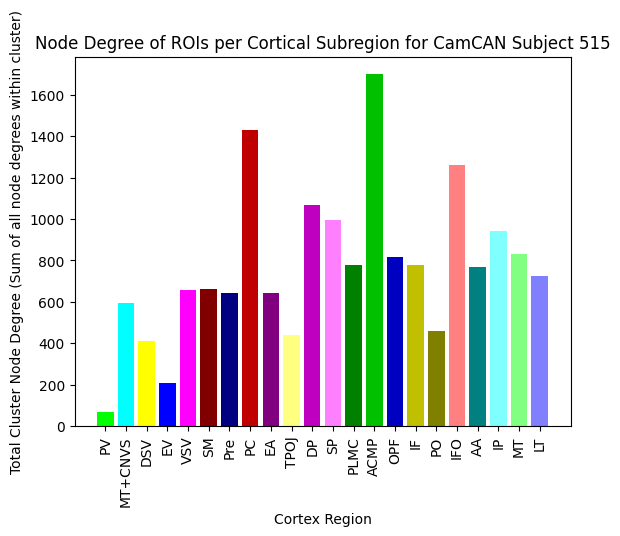

THIS IS THE SBJ ID:  516
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


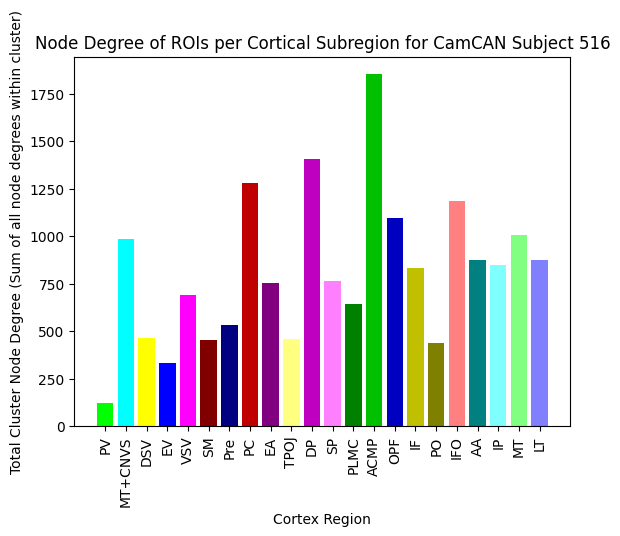

THIS IS THE SBJ ID:  517
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


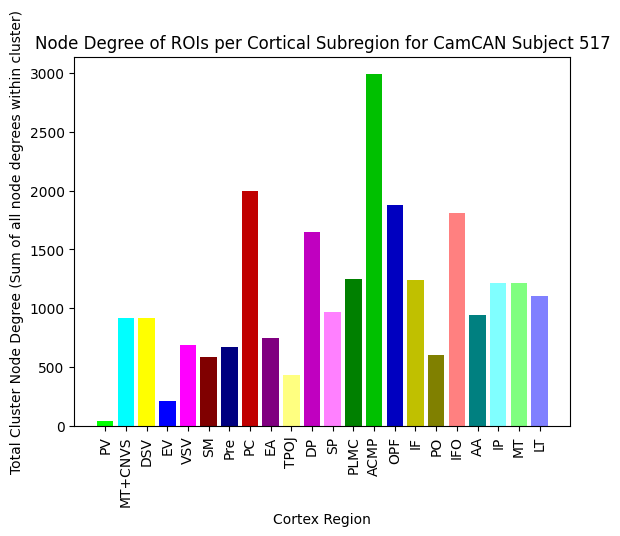

THIS IS THE SBJ ID:  518
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


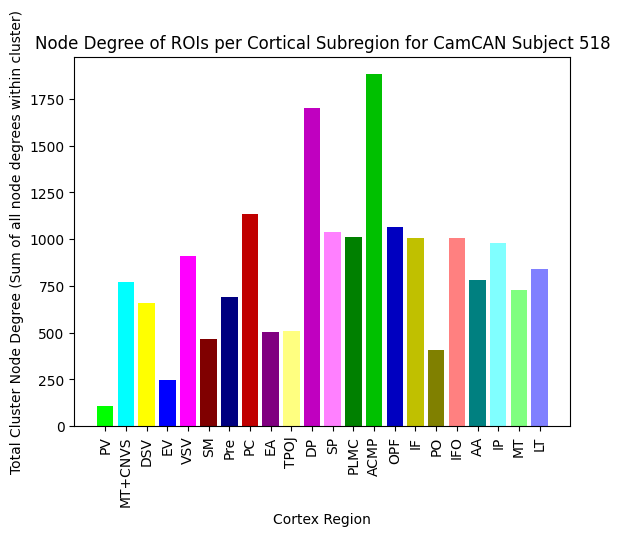

THIS IS THE SBJ ID:  519
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


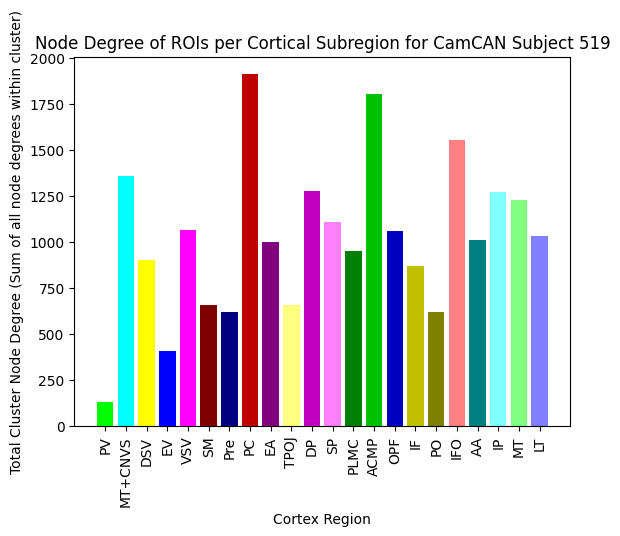

THIS IS THE SBJ ID:  520
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


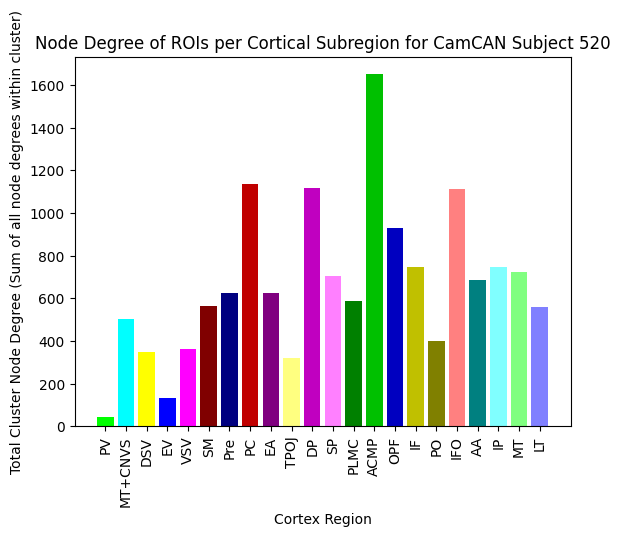

THIS IS THE SBJ ID:  521
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


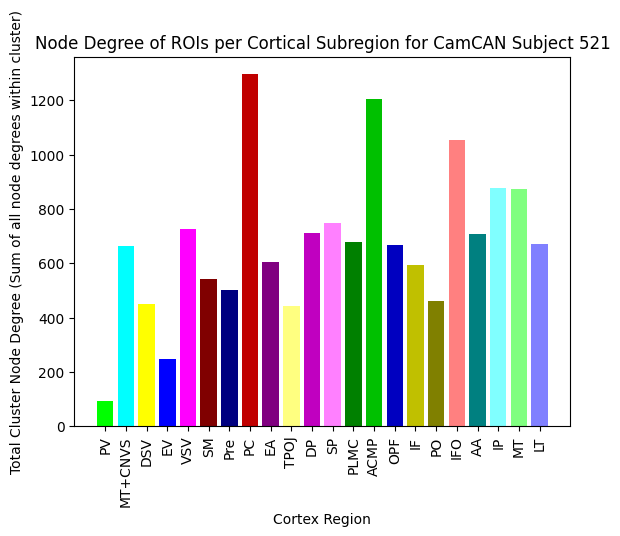

THIS IS THE SBJ ID:  522
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


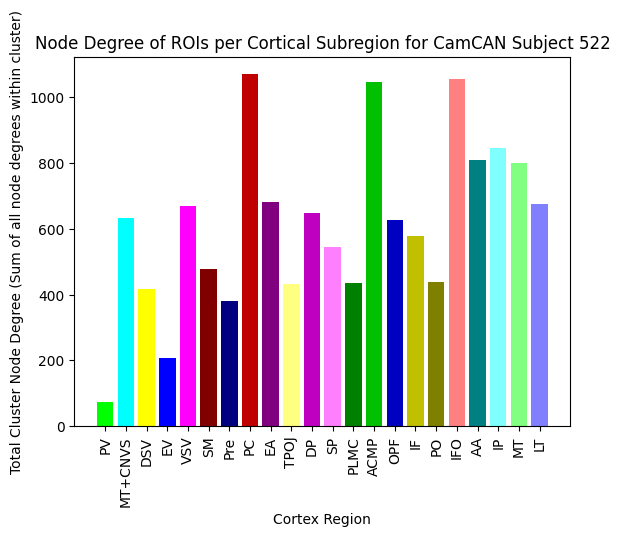

THIS IS THE SBJ ID:  523
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


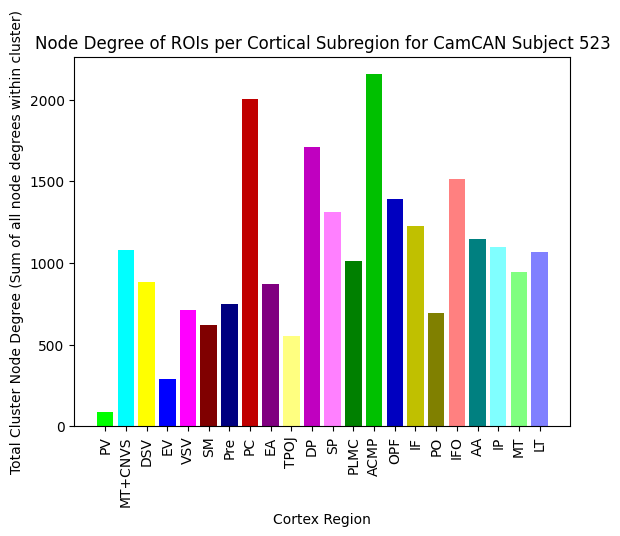

THIS IS THE SBJ ID:  524
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


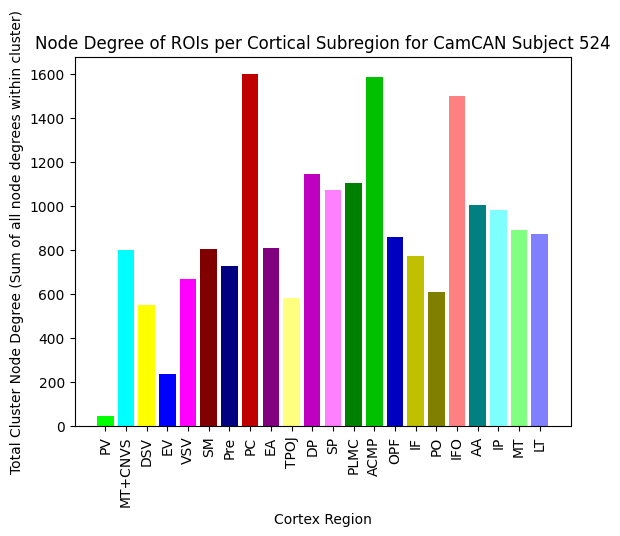

THIS IS THE SBJ ID:  525
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


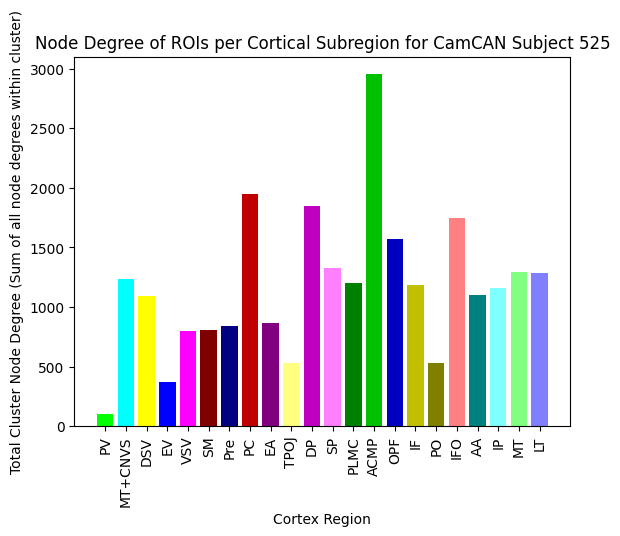

THIS IS THE SBJ ID:  526
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


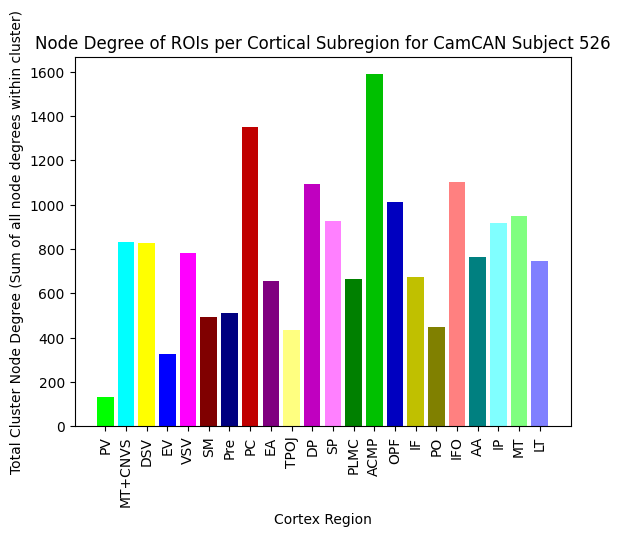

THIS IS THE SBJ ID:  527
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


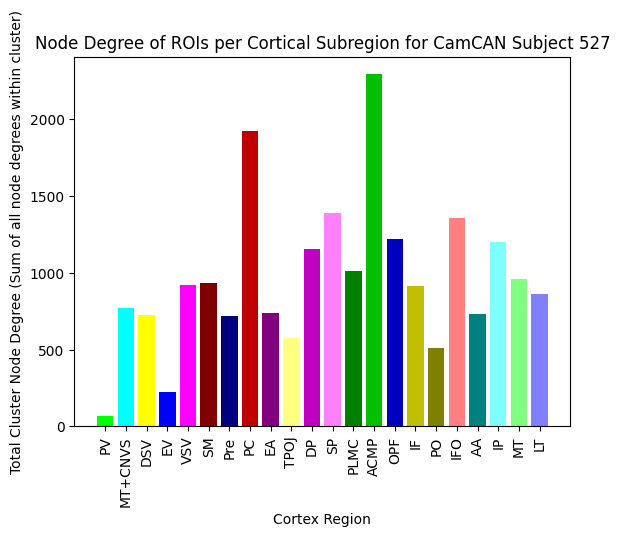

THIS IS THE SBJ ID:  528
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


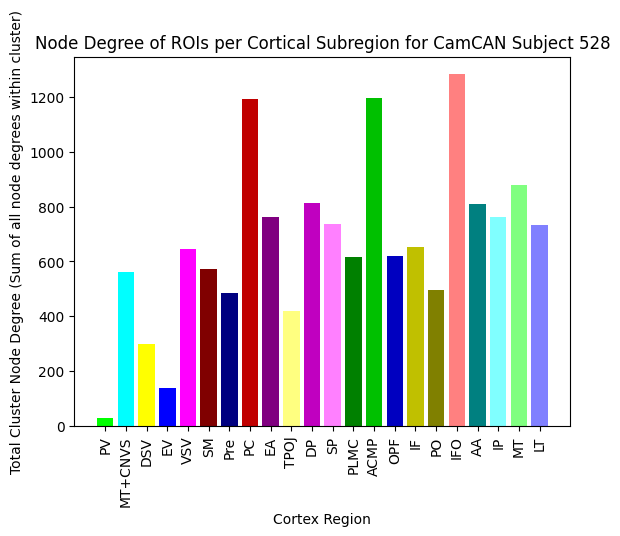

THIS IS THE SBJ ID:  529
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


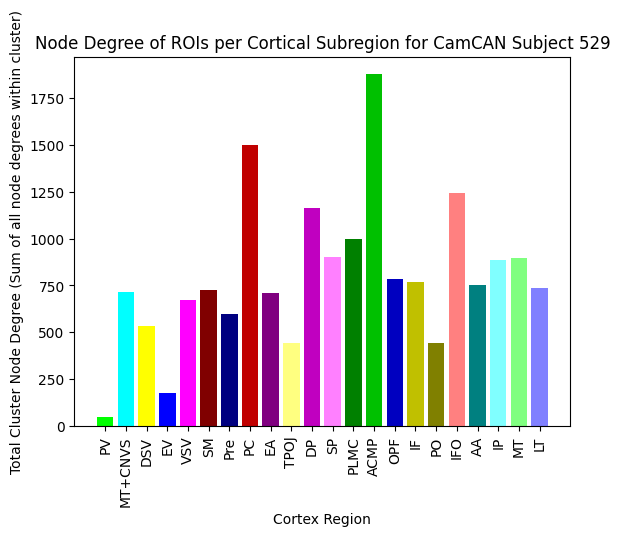

THIS IS THE SBJ ID:  530
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


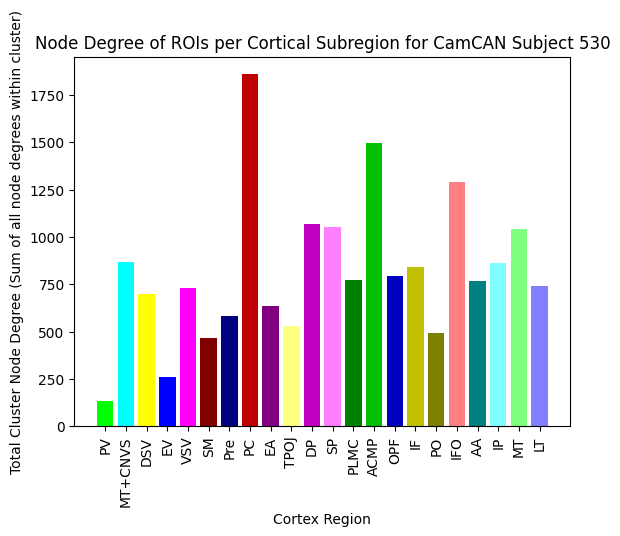

THIS IS THE SBJ ID:  531
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


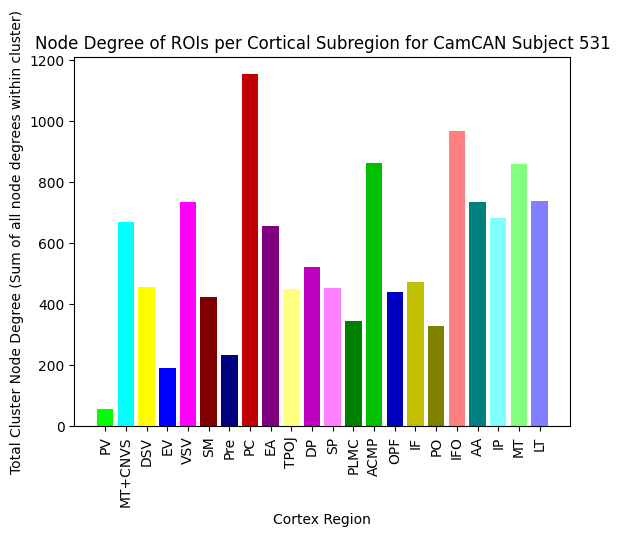

THIS IS THE SBJ ID:  532
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


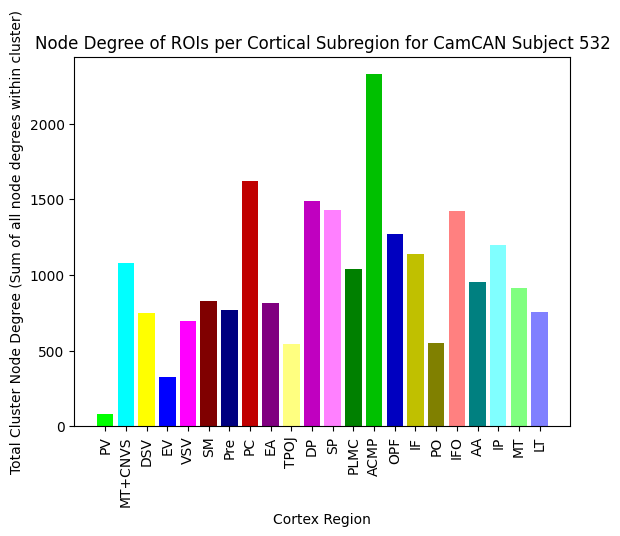

THIS IS THE SBJ ID:  533
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


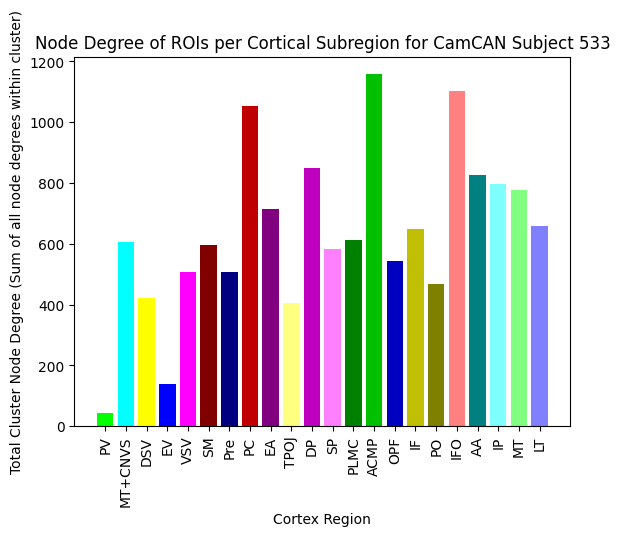

THIS IS THE SBJ ID:  534
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


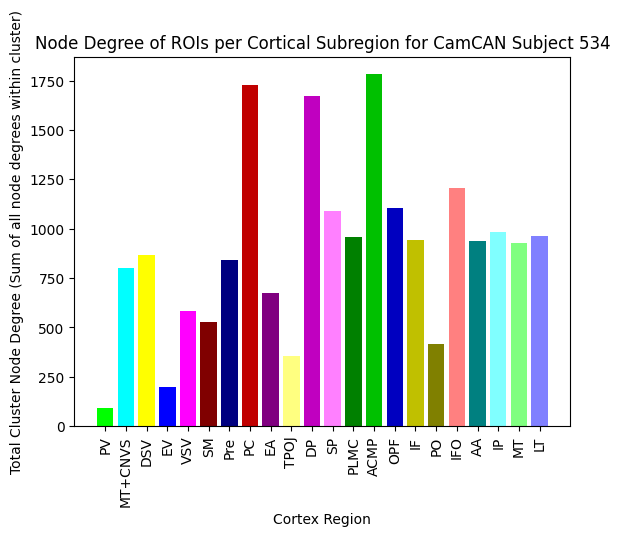

THIS IS THE SBJ ID:  535
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


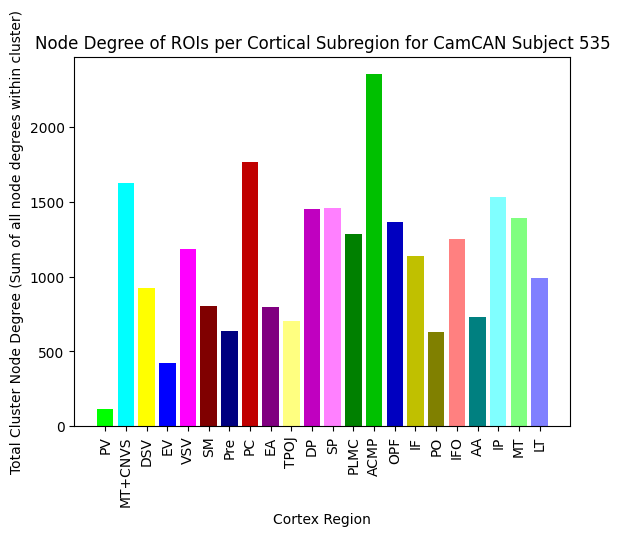

THIS IS THE SBJ ID:  536
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


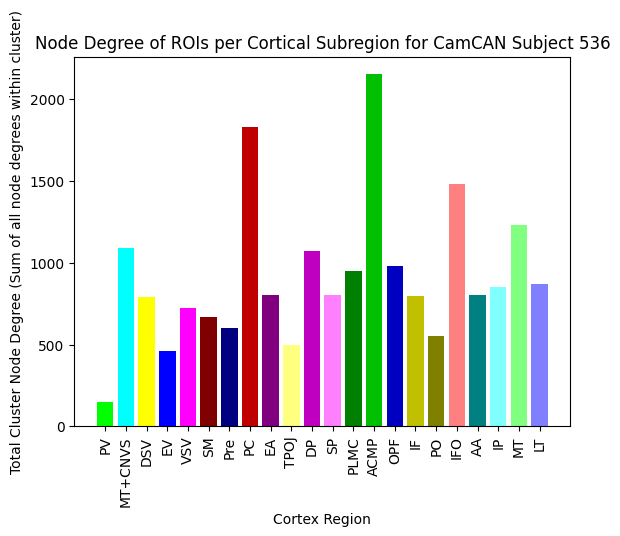

THIS IS THE SBJ ID:  537
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


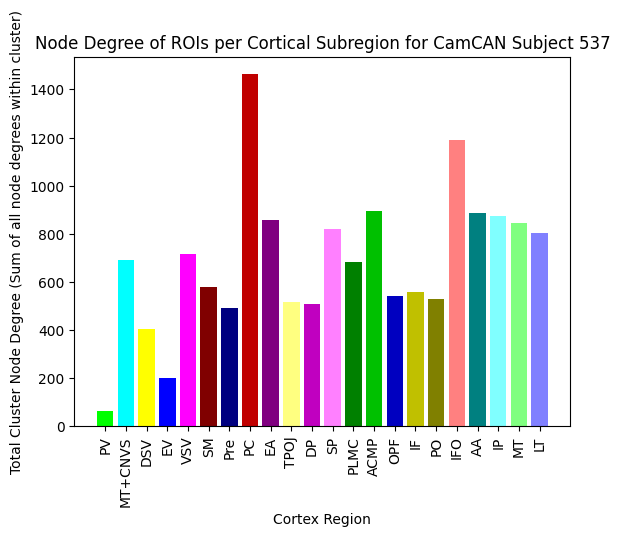

THIS IS THE SBJ ID:  538
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


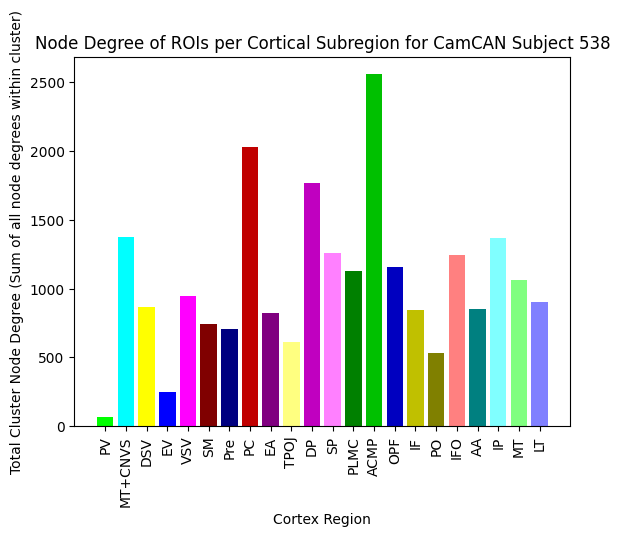

THIS IS THE SBJ ID:  539
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


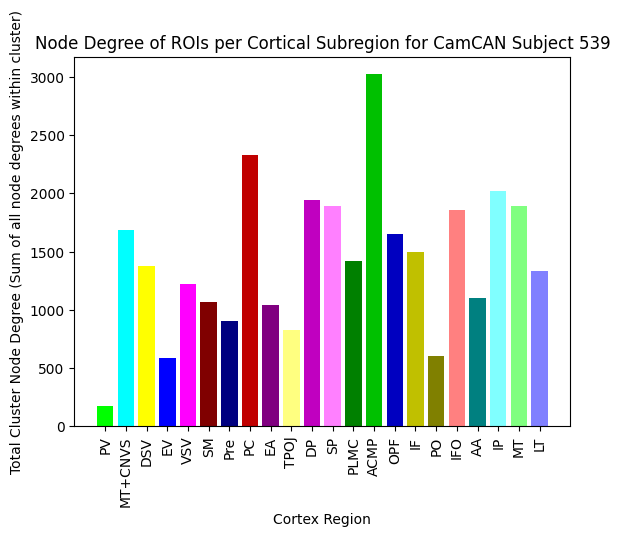

THIS IS THE SBJ ID:  540
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


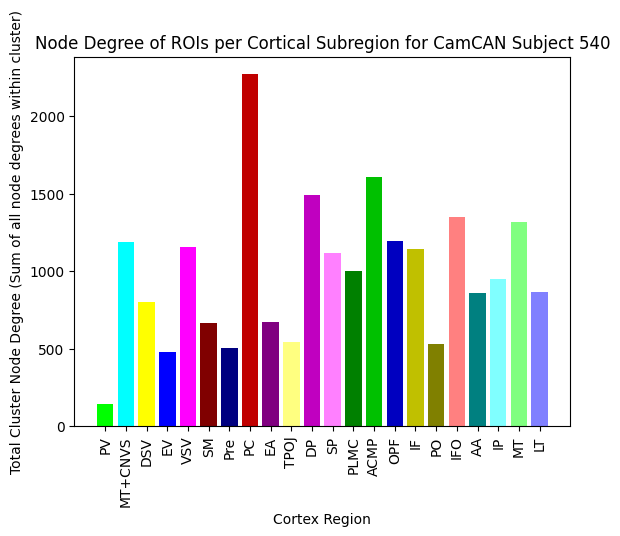

THIS IS THE SBJ ID:  541
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


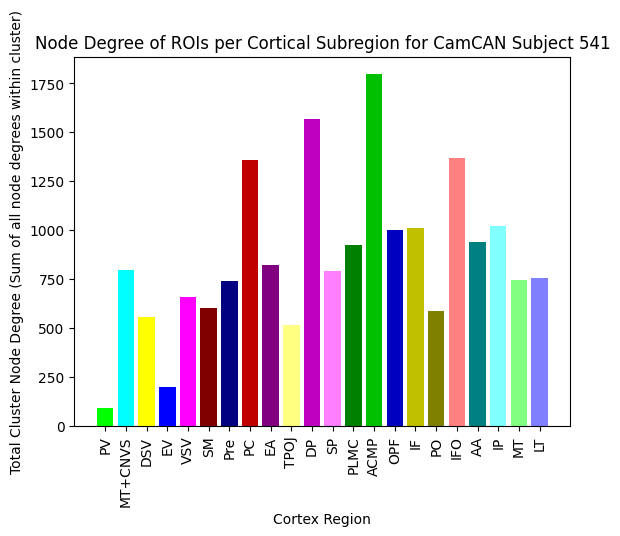

THIS IS THE SBJ ID:  542
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


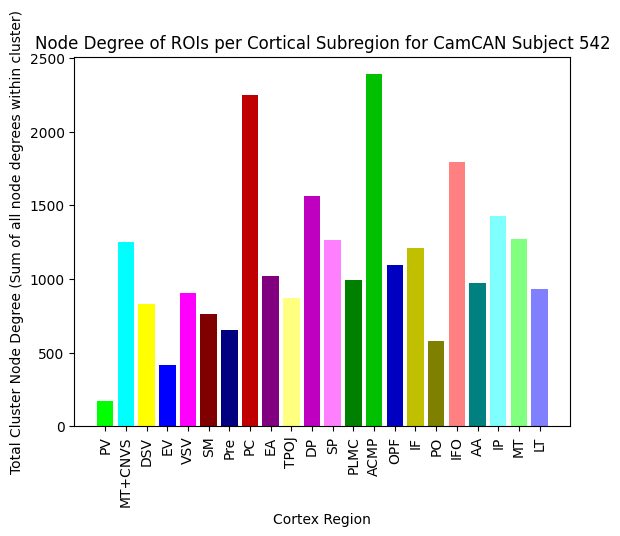

THIS IS THE SBJ ID:  543
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


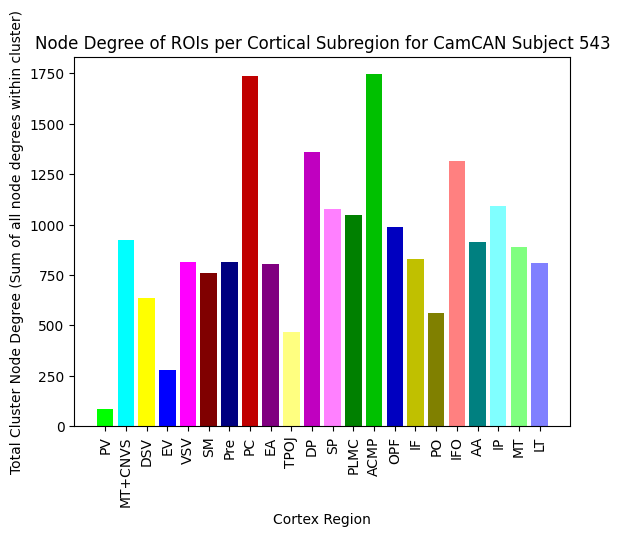

THIS IS THE SBJ ID:  544
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


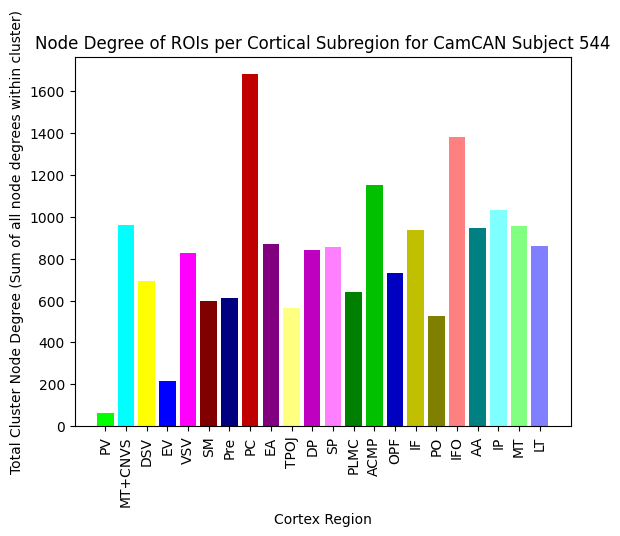

THIS IS THE SBJ ID:  545
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


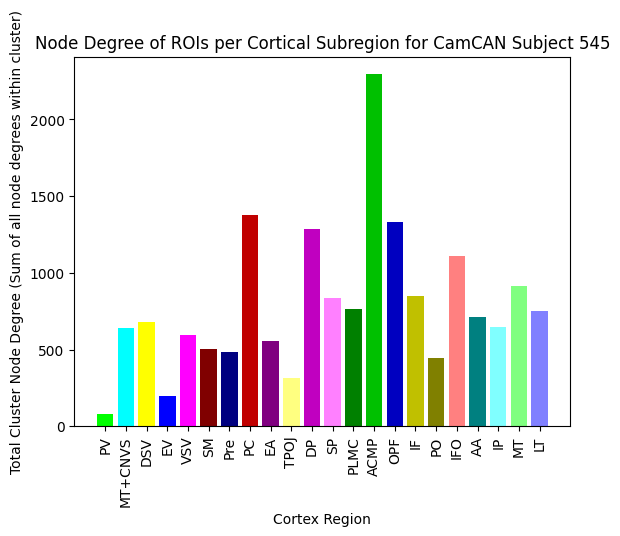

THIS IS THE SBJ ID:  546
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


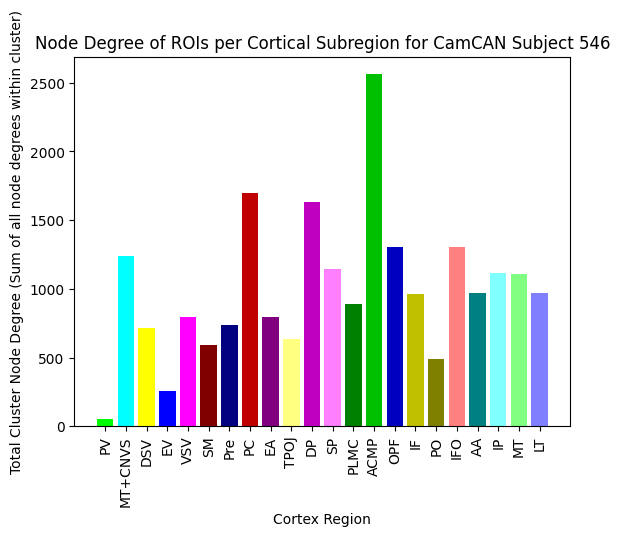

THIS IS THE SBJ ID:  547
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


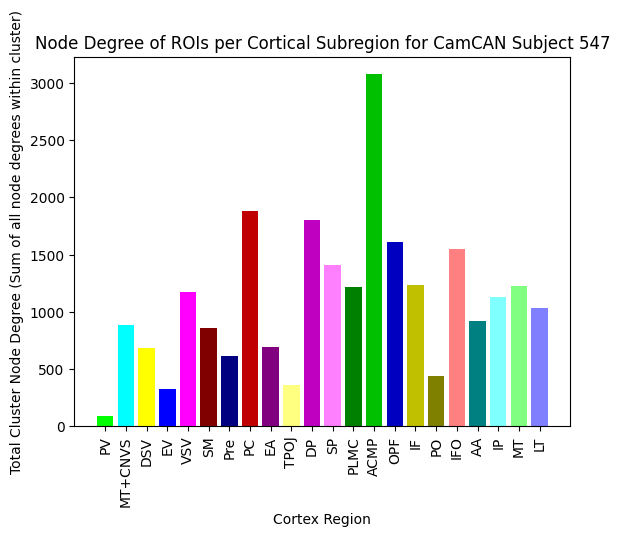

THIS IS THE SBJ ID:  548
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


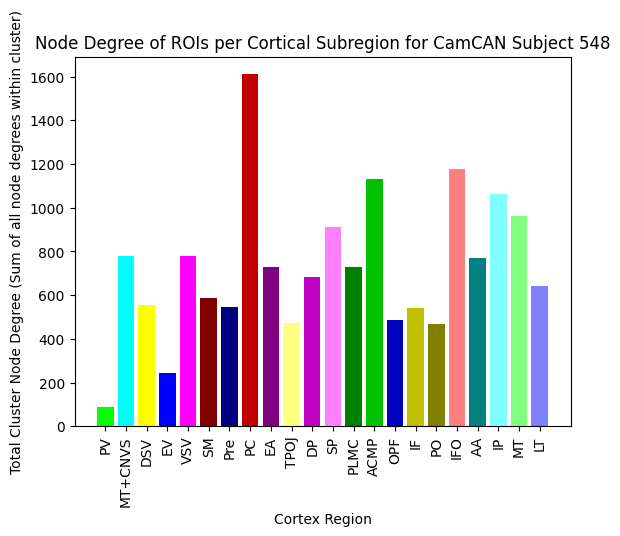

THIS IS THE SBJ ID:  549
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


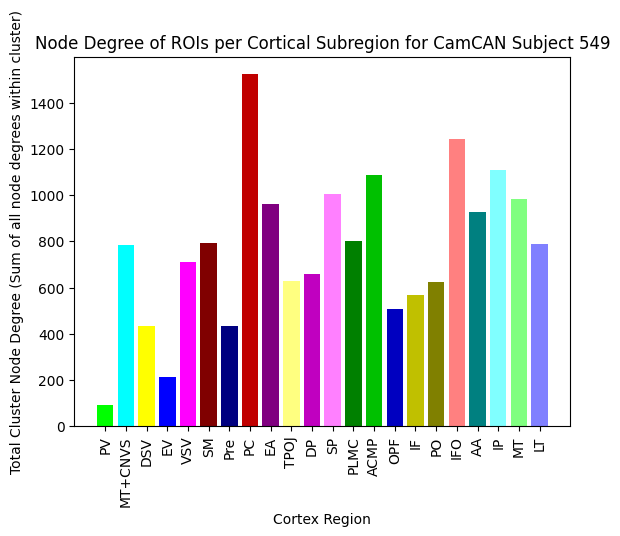

THIS IS THE SBJ ID:  550
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


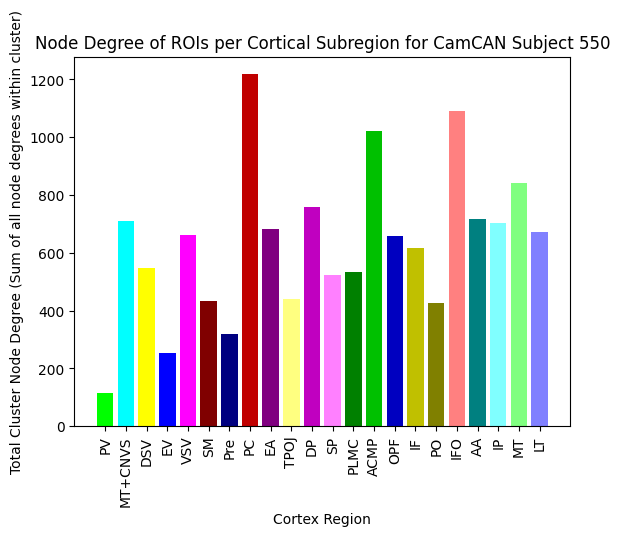

THIS IS THE SBJ ID:  551
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


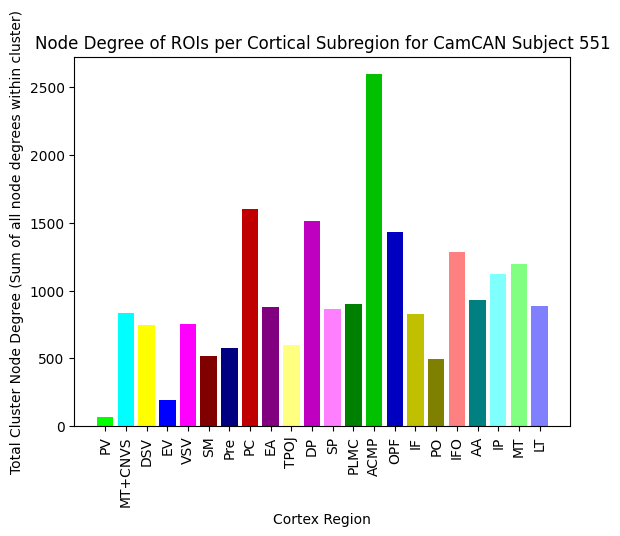

THIS IS THE SBJ ID:  552
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


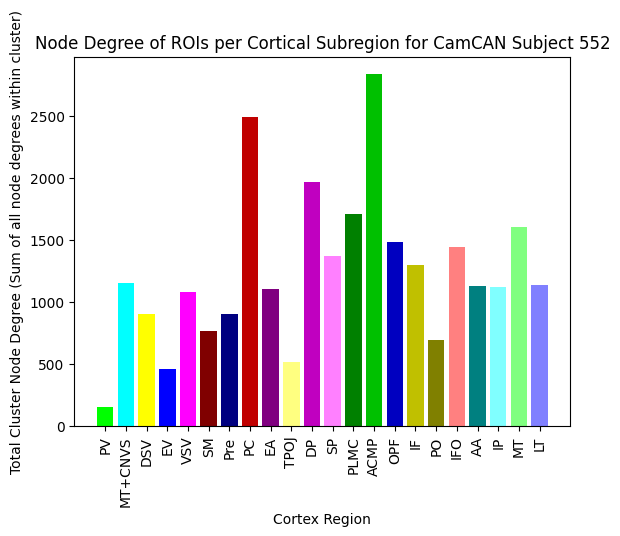

THIS IS THE SBJ ID:  553
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


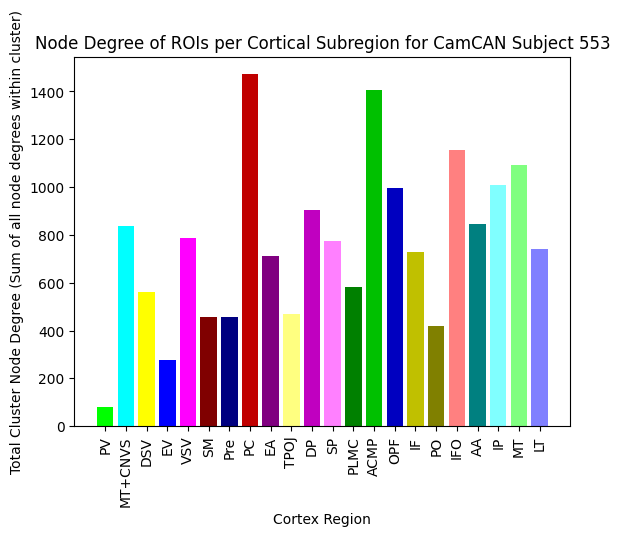

THIS IS THE SBJ ID:  554
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


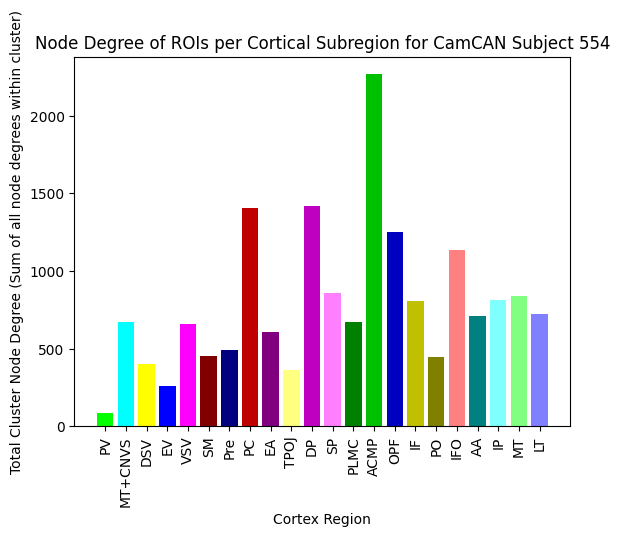

THIS IS THE SBJ ID:  555
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


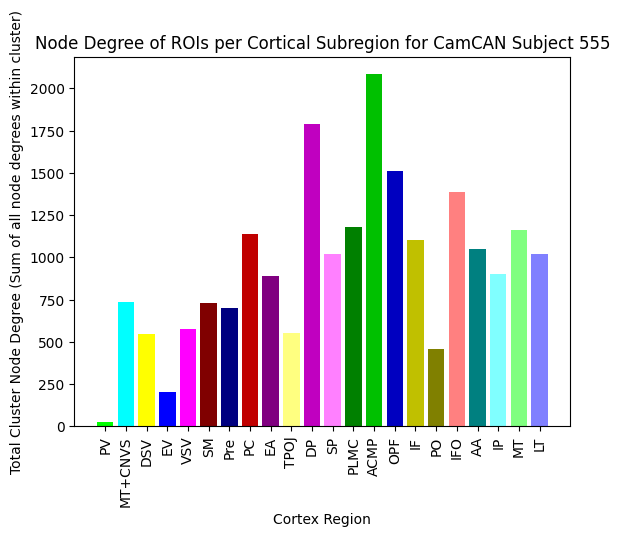

THIS IS THE SBJ ID:  556
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


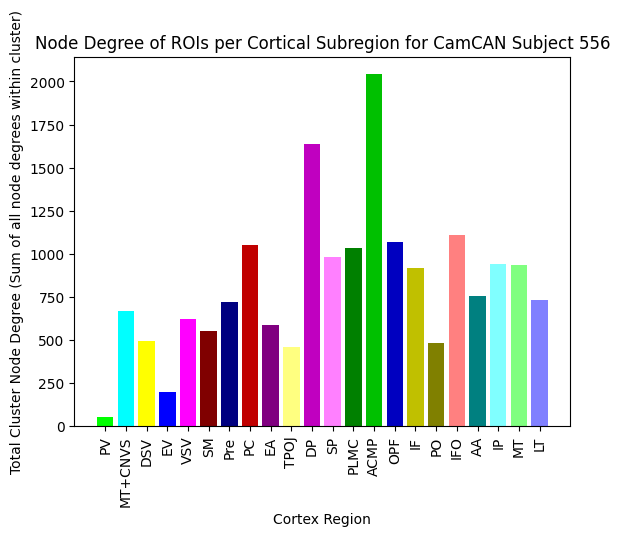

THIS IS THE SBJ ID:  557
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


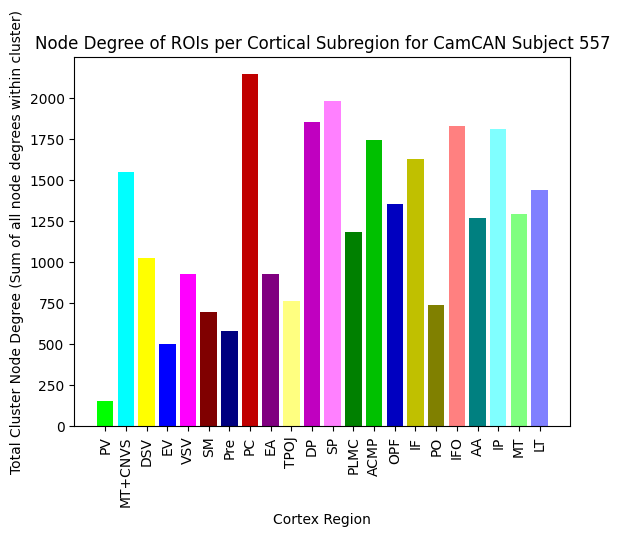

THIS IS THE SBJ ID:  558
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


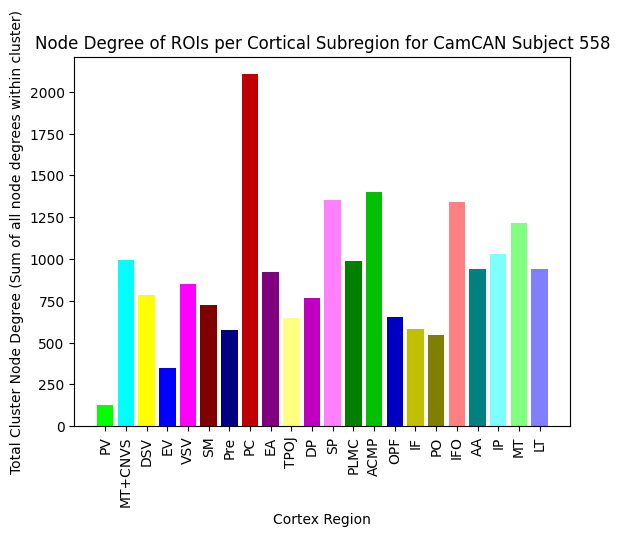

THIS IS THE SBJ ID:  559
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


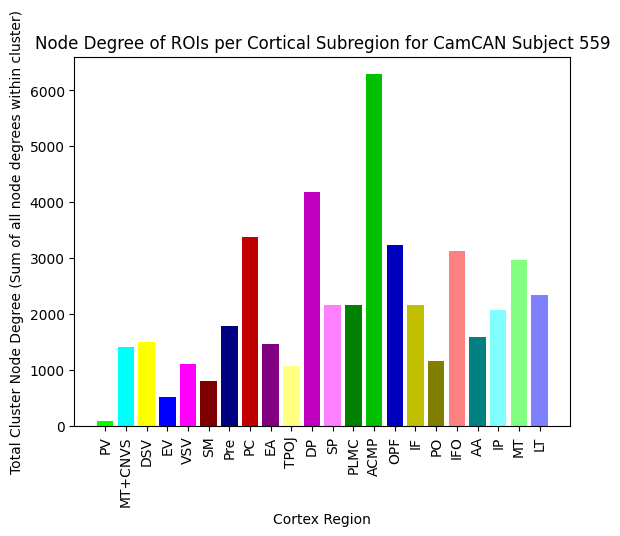

THIS IS THE SBJ ID:  560
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


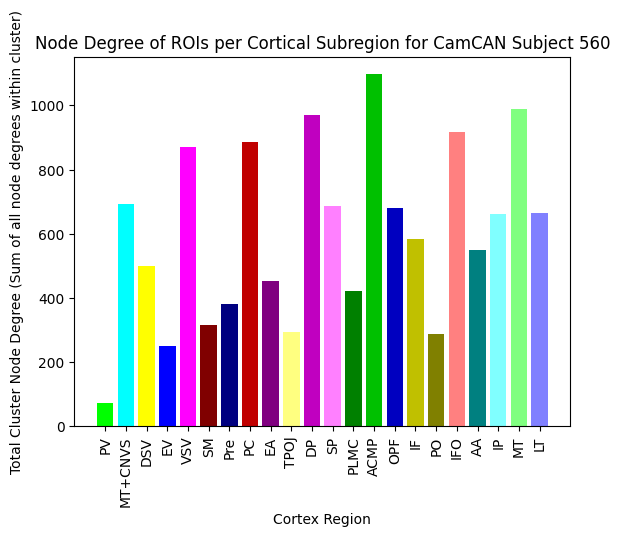

THIS IS THE SBJ ID:  561
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


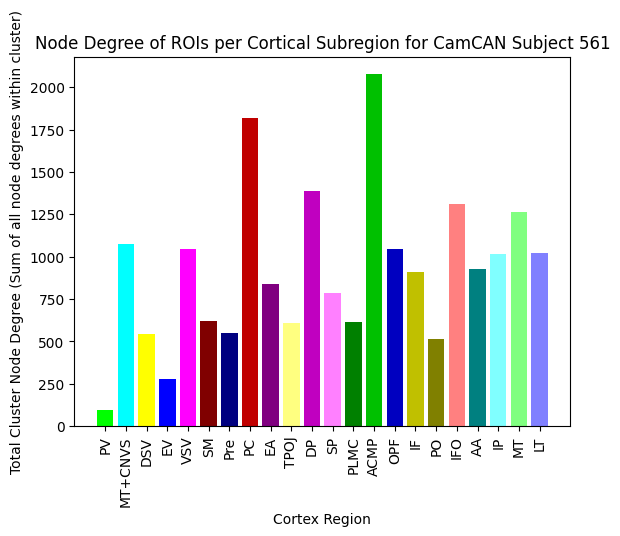

THIS IS THE SBJ ID:  562
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


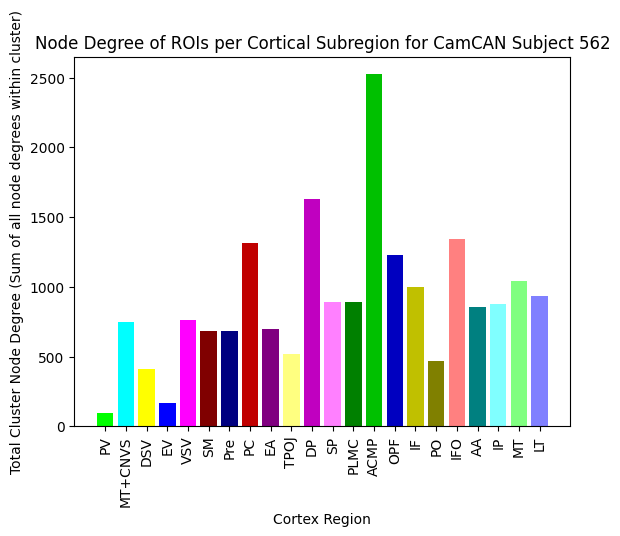

THIS IS THE SBJ ID:  563
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


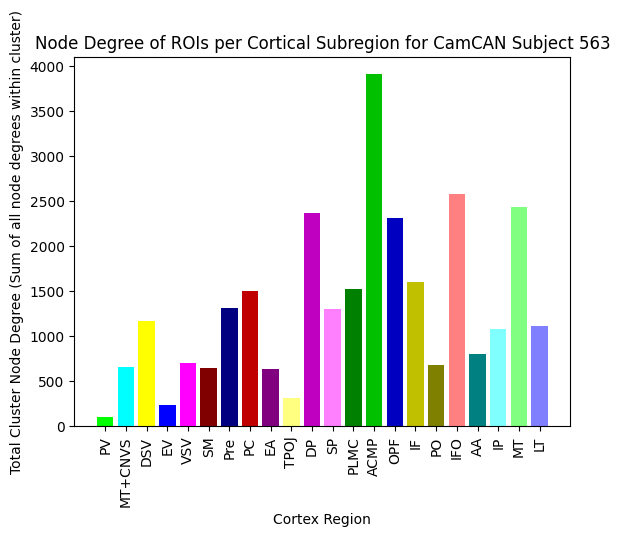

THIS IS THE SBJ ID:  564
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


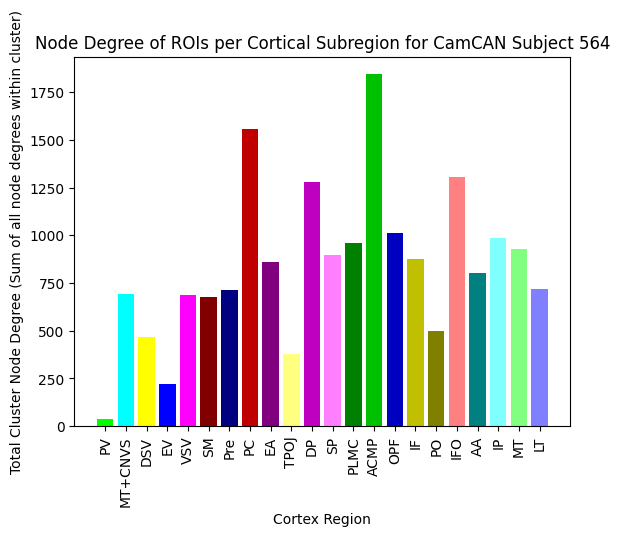

THIS IS THE SBJ ID:  565
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


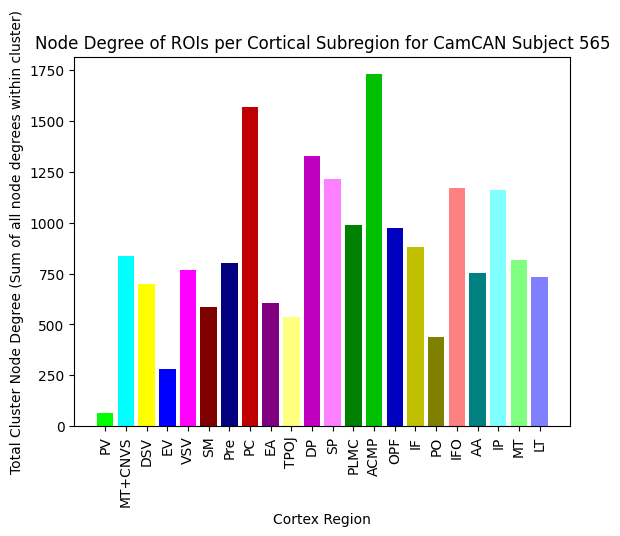

THIS IS THE SBJ ID:  566
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


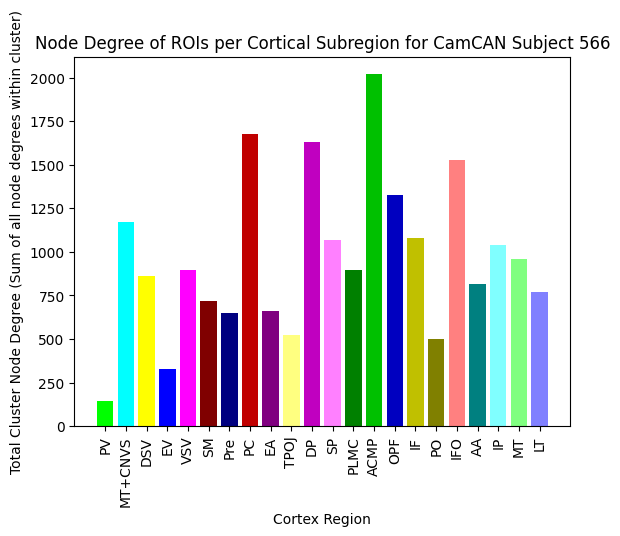

THIS IS THE SBJ ID:  567
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


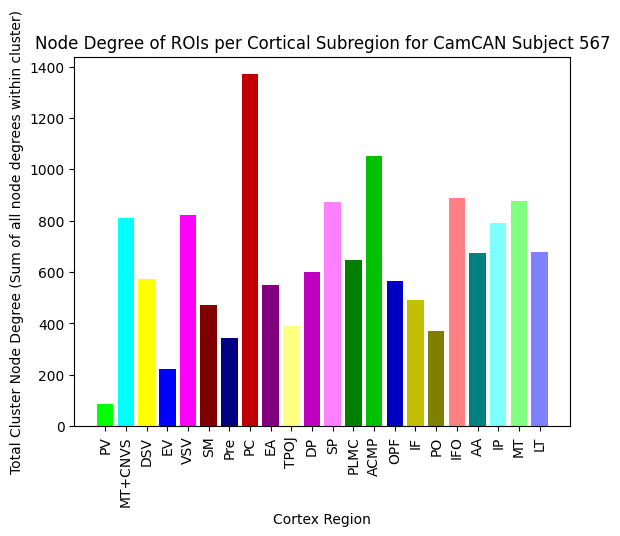

THIS IS THE SBJ ID:  568
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


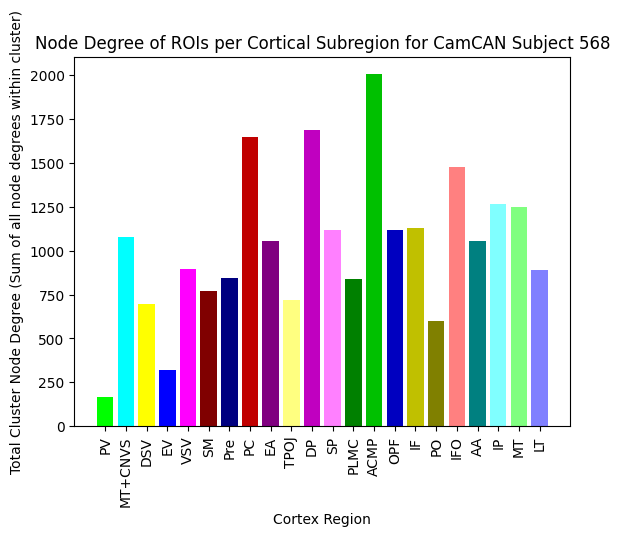

THIS IS THE SBJ ID:  569
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


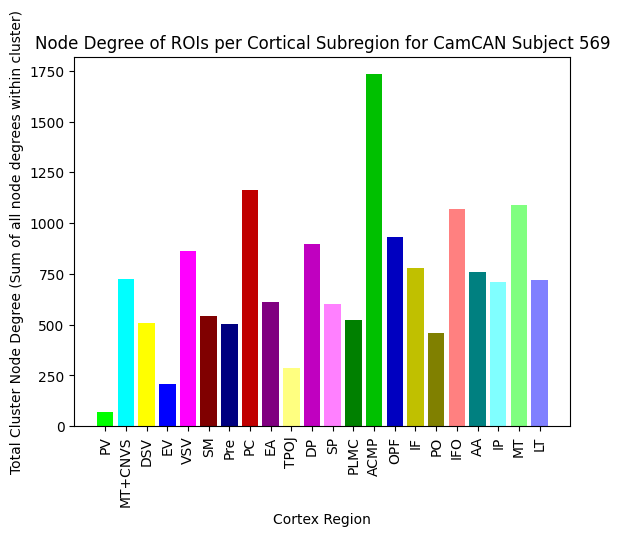

THIS IS THE SBJ ID:  570
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


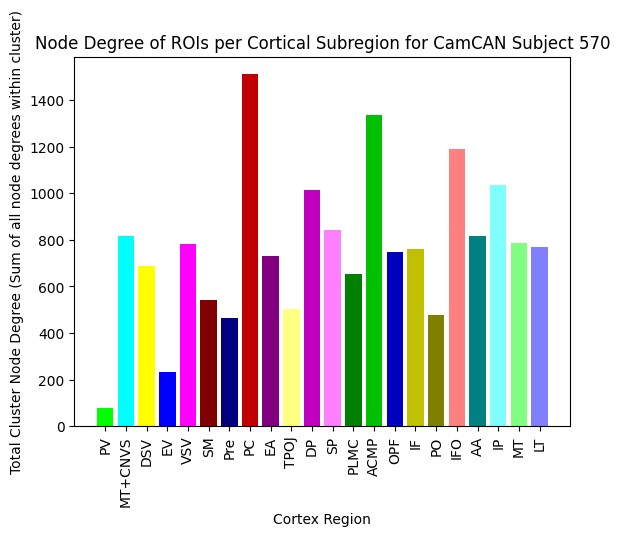

THIS IS THE SBJ ID:  571
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


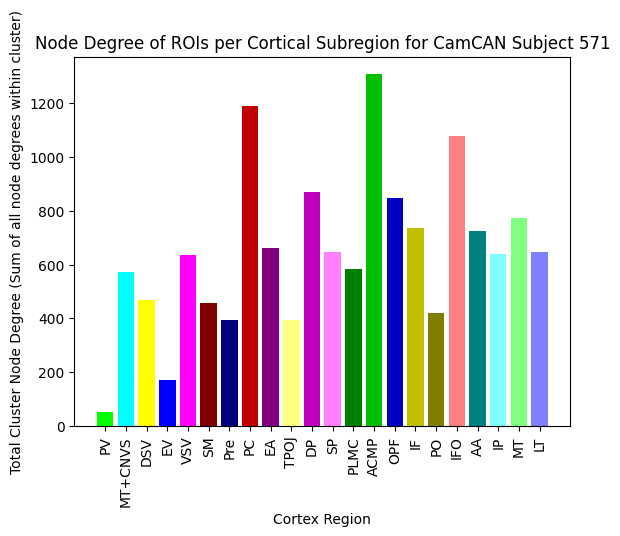

THIS IS THE SBJ ID:  572
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


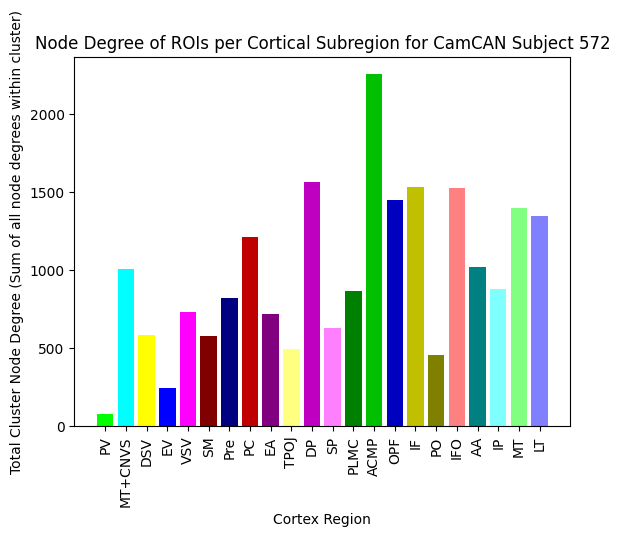

THIS IS THE SBJ ID:  573
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


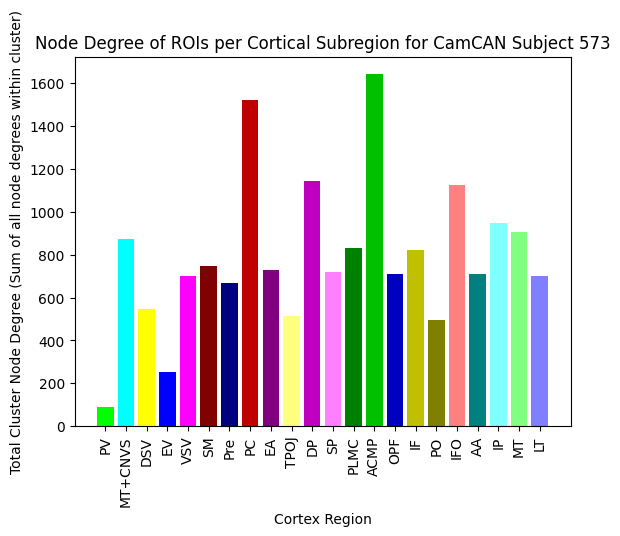

THIS IS THE SBJ ID:  574
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


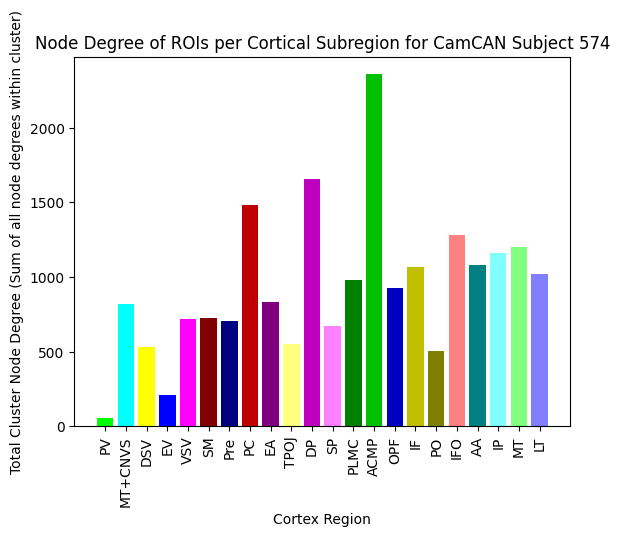

THIS IS THE SBJ ID:  575
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


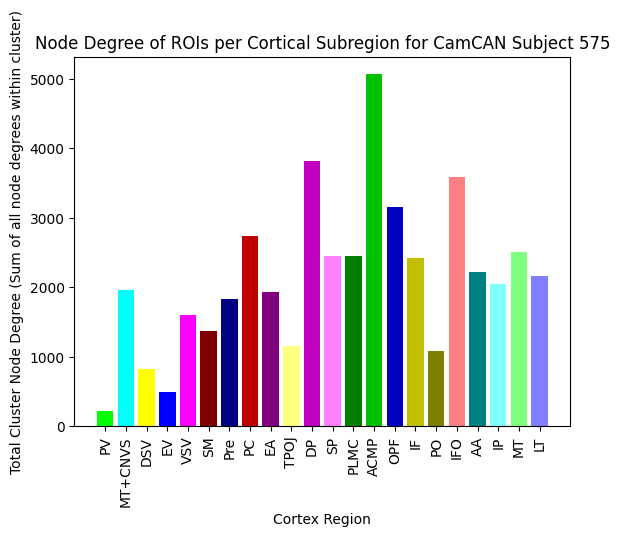

THIS IS THE SBJ ID:  576
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


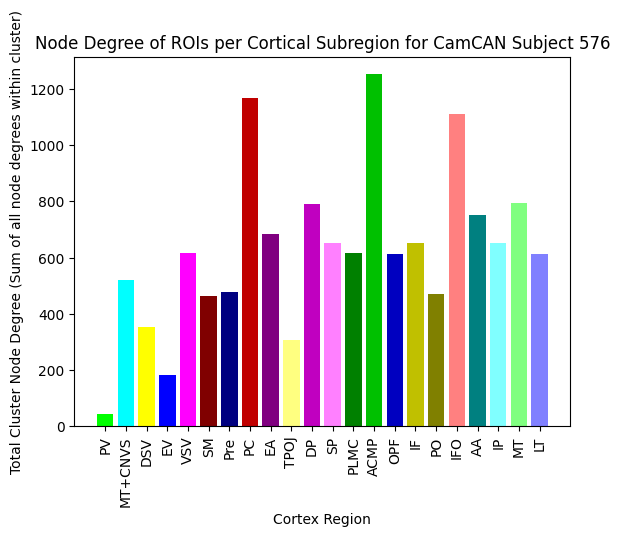

THIS IS THE SBJ ID:  577
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


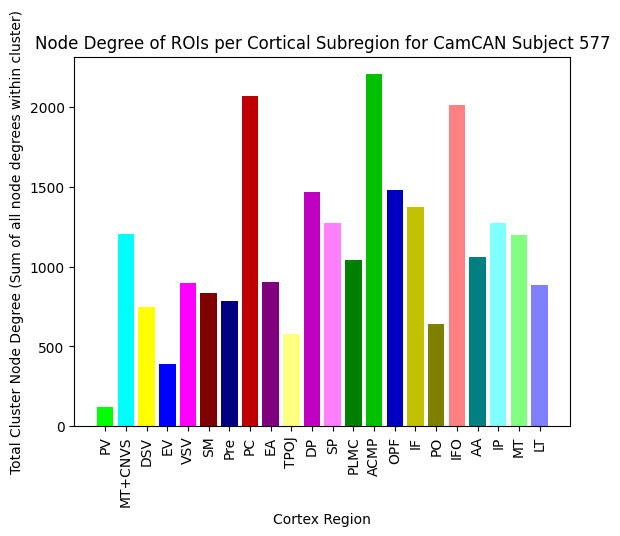

THIS IS THE SBJ ID:  578
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


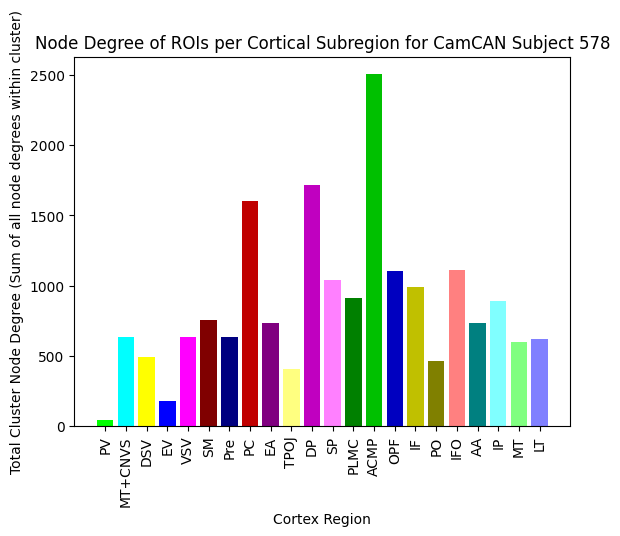

THIS IS THE SBJ ID:  579
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


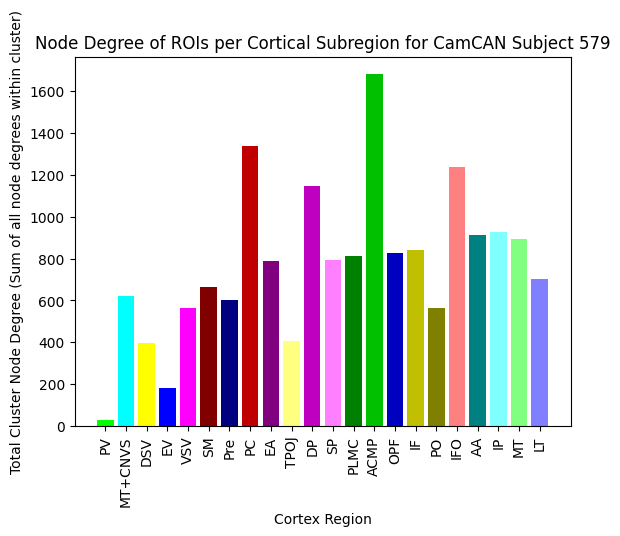

THIS IS THE SBJ ID:  580
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


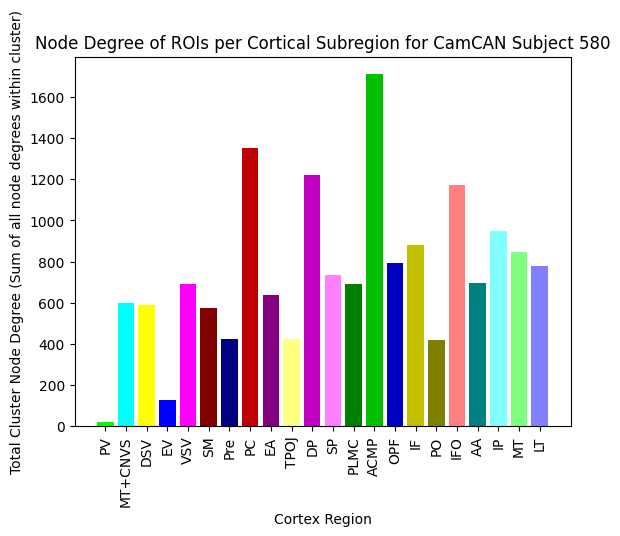

THIS IS THE SBJ ID:  581
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


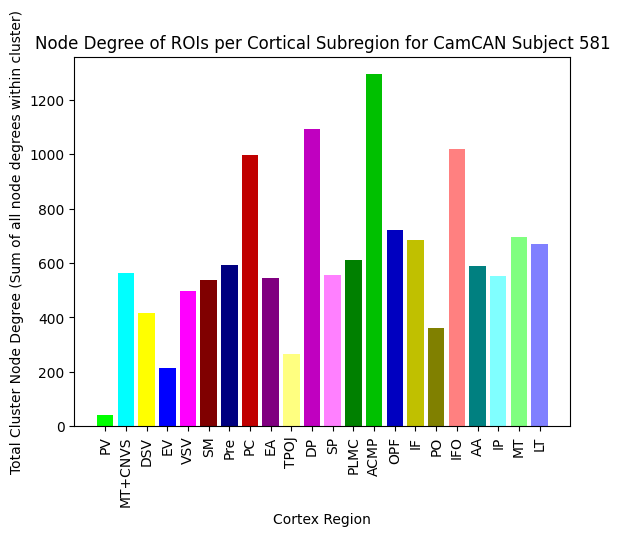

THIS IS THE SBJ ID:  582
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


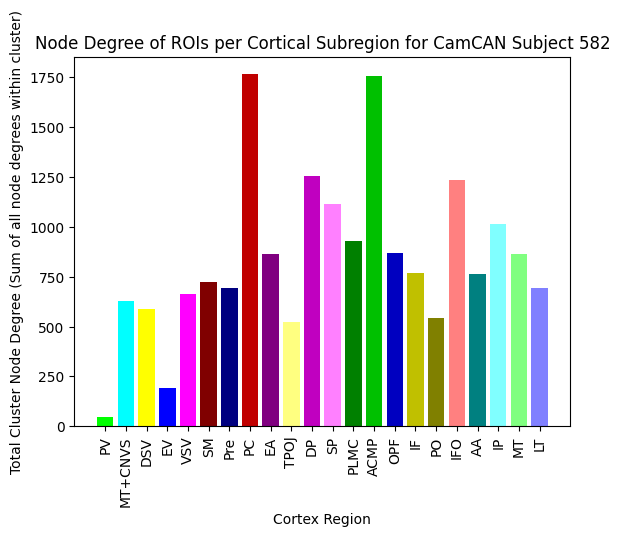

THIS IS THE SBJ ID:  583
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


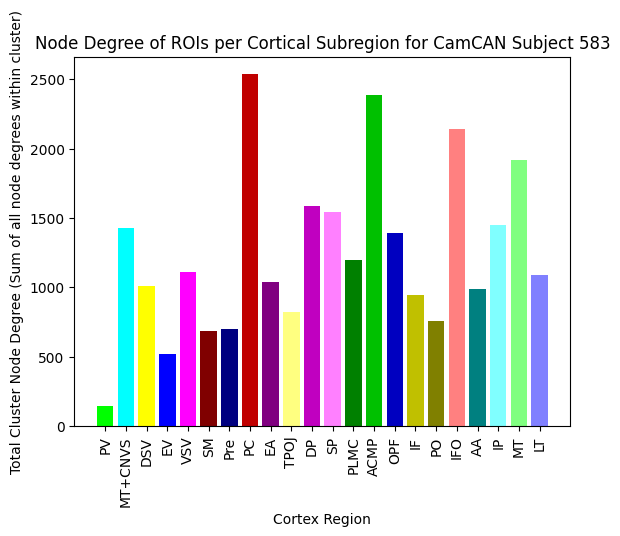

THIS IS THE SBJ ID:  584
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


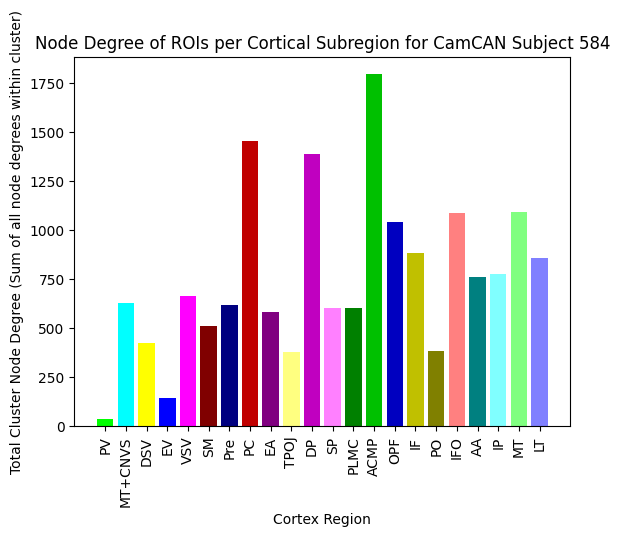

THIS IS THE SBJ ID:  585
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


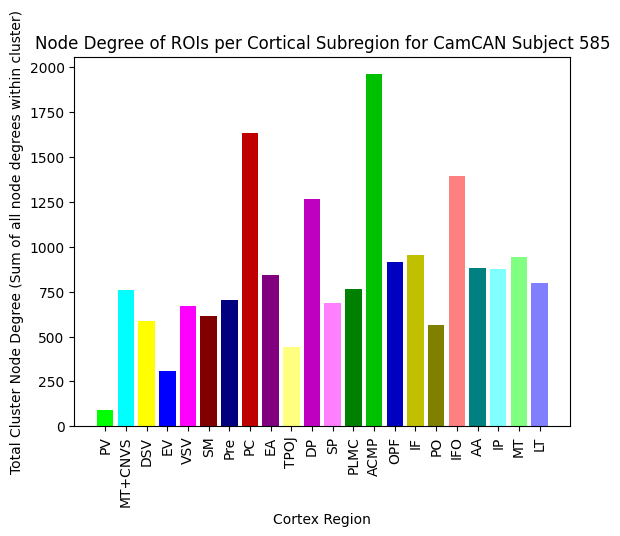

THIS IS THE SBJ ID:  586
THIS IS THE LENG OF THE FILTERED PLV TENSOR:  587


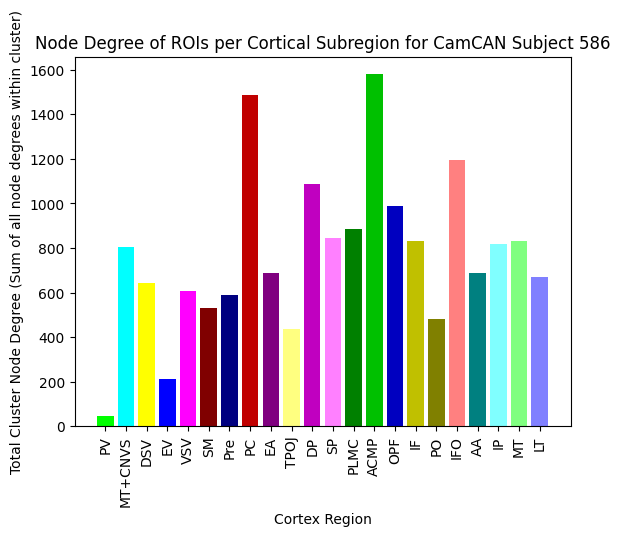

In [3]:
from visualization import viz_node_degree_clusters_for_subject_id

for i in range(592 - 5):
    viz_node_degree_clusters_for_subject_id(i)

In [13]:
rgb_colors = [mcolors.hex2color(color) for color in COLORS[1 : ]]
rgb_colors

[(0.0, 1.0, 0.0),
 (0.0, 0.0, 1.0),
 (1.0, 1.0, 0.0),
 (1.0, 0.0, 1.0),
 (0.0, 1.0, 1.0),
 (0.5019607843137255, 0.0, 0.0),
 (0.0, 0.5019607843137255, 0.0),
 (0.0, 0.0, 0.5019607843137255),
 (0.5019607843137255, 0.5019607843137255, 0.0),
 (0.5019607843137255, 0.0, 0.5019607843137255),
 (0.0, 0.5019607843137255, 0.5019607843137255),
 (1.0, 0.5019607843137255, 0.5019607843137255),
 (0.5019607843137255, 1.0, 0.5019607843137255),
 (0.5019607843137255, 0.5019607843137255, 1.0),
 (1.0, 1.0, 0.5019607843137255),
 (1.0, 0.5019607843137255, 1.0),
 (0.5019607843137255, 1.0, 1.0),
 (0.7529411764705882, 0.0, 0.0),
 (0.0, 0.7529411764705882, 0.0),
 (0.0, 0.0, 0.7529411764705882),
 (0.7529411764705882, 0.7529411764705882, 0.0),
 (0.7529411764705882, 0.0, 0.7529411764705882)]

In [6]:
def to_poincare(x, c):
    K = 1. / c
    sqrtK = K ** 0.5
    d = x.size(-1) - 1
#     return sqrtK * x.narrow(-1, 1, d) / (x[:, 0:1] + sqrtK)
    return sqrtK * x.narrow(-1, 1, d) / (x[0] + sqrtK)

def get_hcp_atlas_df():
    datapath = os.environ['DATAPATH']
    atlas_path = os.path.join(os.path.join(datapath, "cam_can_avg"), "HCP-MMP1_UniqueRegionList.csv")
    hcp_atlas_df = pd.read_csv(atlas_path)
    cortices = hcp_atlas_df['cortex']
    region_indices_to_cortices = {index : cortex for index, cortex in enumerate(cortices)}
    color_index = -1
    seen_cortices = set()
    region_indices_to_colors = {}

    for index in region_indices_to_cortices:
        cortex = region_indices_to_cortices[index]
        if cortex not in seen_cortices:
            color_index += 1
            region_indices_to_colors[index] = COLORS[color_index]
            seen_cortices.add(region_indices_to_cortices[index])    
        else:
            region_indices_to_colors[index] = COLORS[color_index]
        
    return hcp_atlas_df
def get_embeddings_df(hyperboloid_embeddings):
    hcp_atlas_df = get_hcp_atlas_df()
    
    region_indices_to_cortex_ids = {i : hcp_atlas_df['Cortex_ID'][i] for i in range(NUM_ROIS)}
    c = 1.
    torch_embeddings = torch.from_numpy(hyperboloid_embeddings)
    poincare_embeddings = [to_poincare(torch_embedding, c) for torch_embedding in torch_embeddings]
    
    embeddings_df = pd.DataFrame({'x': [poincare_embeddings[i][0] for i in range(NUM_ROIS)], 
                                        'y': [poincare_embeddings[i][1] for i in range(NUM_ROIS)],
                                        'label': [region_indices_to_cortex_ids[i] for i in range(NUM_ROIS)],
                                        'id': [i for i in range(NUM_ROIS)],
                                        'LR': hcp_atlas_df['LR']}
                                )
    return embeddings_df   

def norm(x, axis=None):
    return np.linalg.norm(x, axis=axis)

#-------------------------
#----- Poincaré Disk -----
#-------------------------

# NOTE: POSSIBLE ISSUE WITH DIFFERENT WAYS TO SPECIFY MINKOWSKI DOT PRODUCT
# arbritray sign gives different signatures (+, +, +, -), (+, -, -, -)
    
# distance in poincare disk
def poincare_dist(u, v, eps=1e-5):
    d = 1 + 2 * norm(u-v)**2 / ((1 - norm(u)**2) * (1 - norm(v)**2) + eps)
    return np.arccosh(d)

def get_cortices_to_avg_hyperbolic_cluster_radii(embeddings_df, cortex_ids_to_cortices):
    origin = np.array([0, 0])
    cortices_to_hyperbolic_radii = dict()
    avg_radius = 0
    for cortex_id in embeddings_df.label.unique():
        embeddings_from_id = embeddings_df[embeddings_df.label == cortex_id][['x', 'y']].values
        avg_radius = 0
        for embedding_coords in embeddings_from_id:
            hyperbolic_radius = poincare_dist(embedding_coords, origin)
            avg_radius += hyperbolic_radius
        avg_radius /= len(embeddings_from_id)
        cortices_to_hyperbolic_radii[cortex_ids_to_cortices[cortex_id]] = avg_radius
    return cortices_to_hyperbolic_radii
    
def get_cortices_to_avg_hyperbolic_cluster_radii_left_right(embeddings_df, cortex_ids_to_cortices):
    
    cortices_to_hyperbolic_radii_L = dict()
    cortices_to_hyperbolic_radii_R = dict()
    
    for cortex_id in embeddings_df.label.unique():
        
        embeddings_from_id_L = embeddings_df.loc[(embeddings_df.label == cortex_id) & (embeddings_df.LR == "L"), ['x', 'y']].values
        embeddings_from_id_R = embeddings_df.loc[(embeddings_df.label == cortex_id) & (embeddings_df.LR == "R"), ['x', 'y']].values
        cortices_to_hyperbolic_radii_L[cortex_ids_to_cortices[cortex_id]] = get_poincare_avg_radius(embeddings_from_id_L)
        cortices_to_hyperbolic_radii_R[cortex_ids_to_cortices[cortex_id]] = get_poincare_avg_radius(embeddings_from_id_R)
    return cortices_to_hyperbolic_radii_L, cortices_to_hyperbolic_radii_R 
def get_embeddings_df_list(date):
    """
    1. Gather all previous runs of embeddings in the date file directory from all the log numbers in the directory, 
    2. Access the respective numpy embeddings file, 
    3. Convert the numpy file into a dataframe, 
    4. Append dataframe to a list of embeddings dataframes 
    """
    date_dir = os.path.join(os.getcwd(), 'logs', 'lp', date)
    log_num_dirs = [os.path.join(date_dir, log_num) for log_num in os.listdir(date_dir)]
    embeddings_df_list = []
    for log_num_dir in log_num_dirs:
        for root, dirs, files in os.walk(log_num_dir):
            for file in files:
                if file.endswith(".npy"):
                    if 'test' not in file: continue 
                    embeddings = np.load(os.path.join(root, file))
                    embeddings_df = get_embeddings_df(embeddings)
                    embeddings_df_list.append(embeddings_df)
    return embeddings_df_list


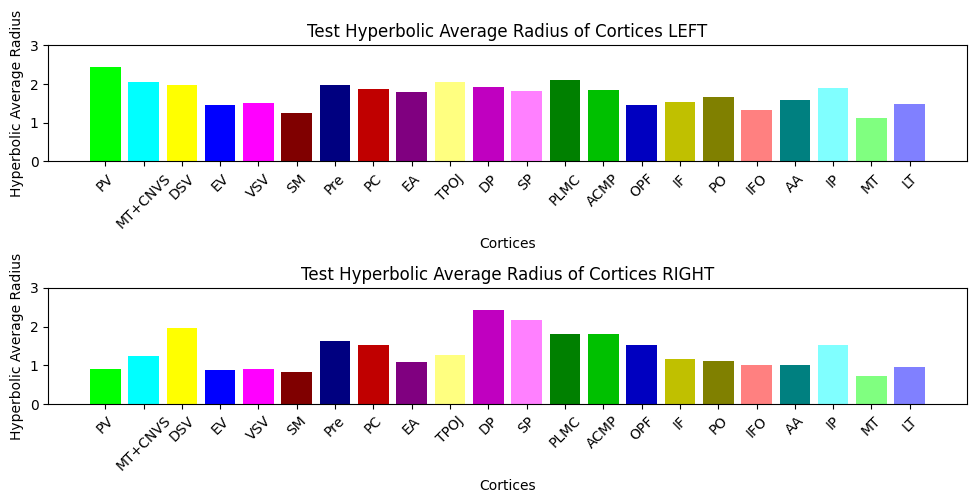

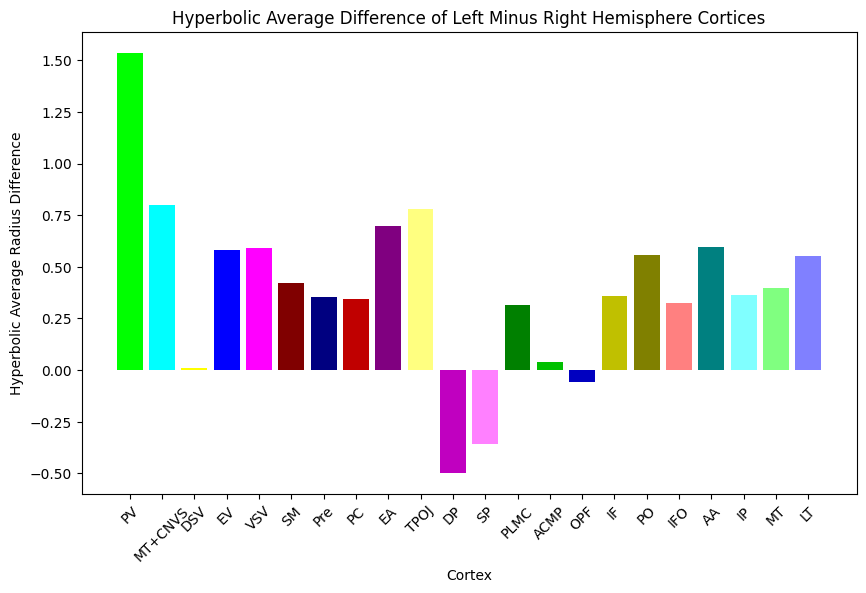

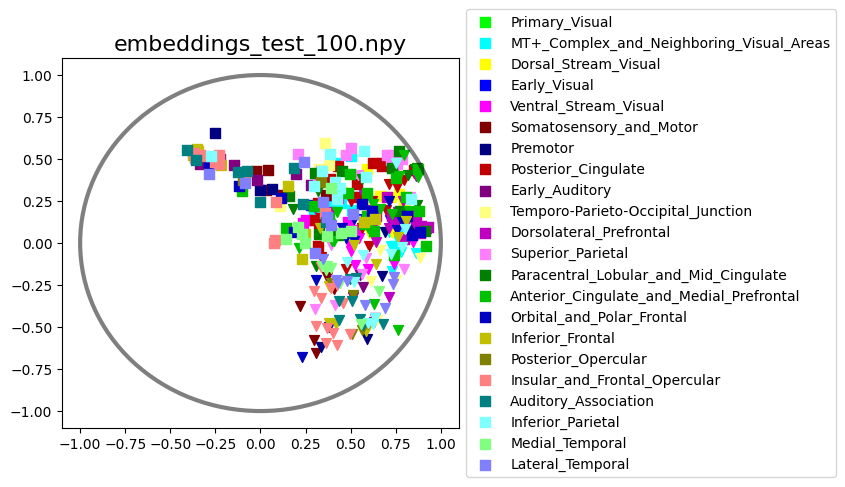

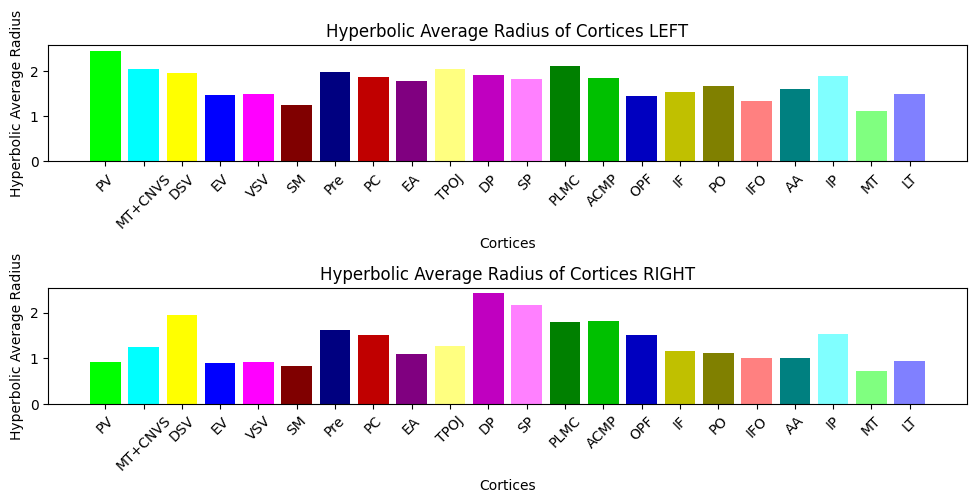

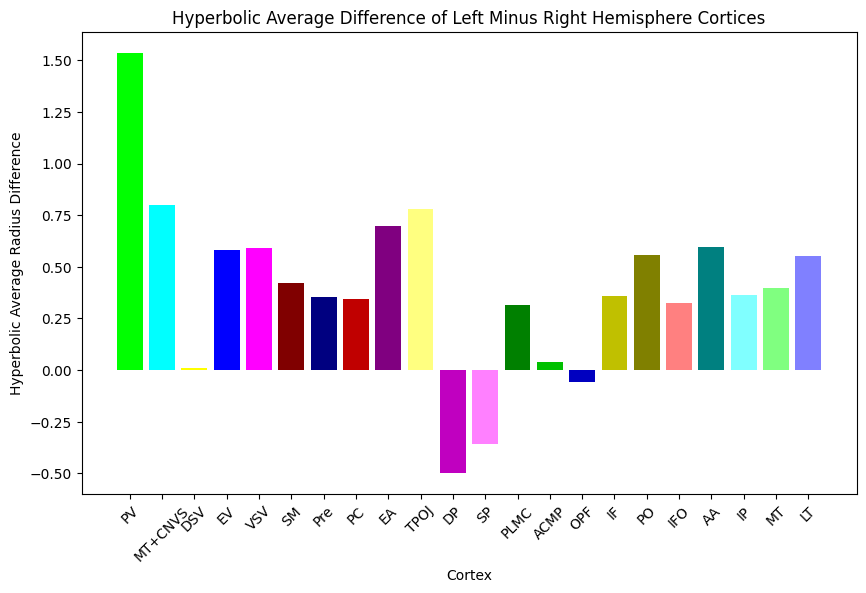

Test_Loss: 1.824005
Test_ROC: 0.785361
Test_Average_Precision: 0.745415
Test_Accuracy: 0.73046


(1.824005, 0.785361, 0.745415)

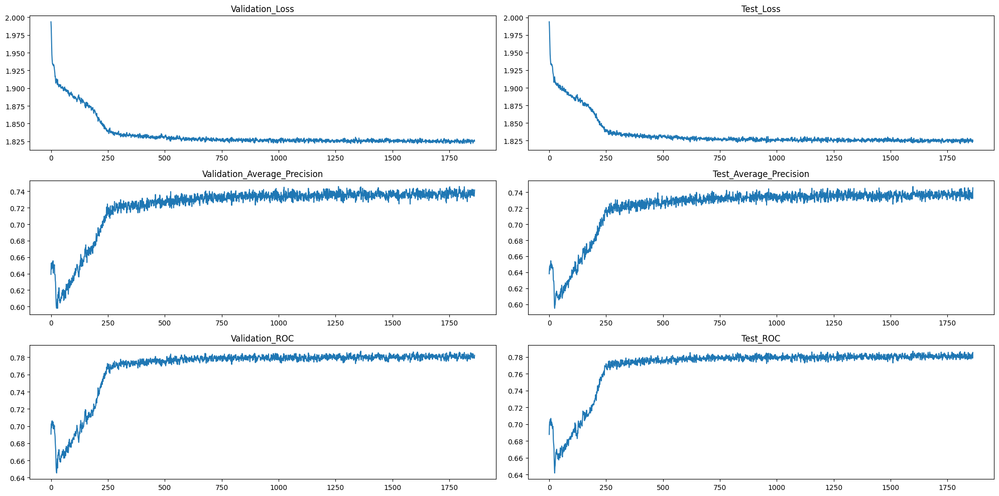

In [7]:
import os 
import numpy as np 
from sklearn.manifold import TSNE
from sklearn.decomposition import TruncatedSVD
from visualization import viz_embeddings
from visualization import plot_embeddings
from visualization import plot_embeddings_by_parts
from visualization import plot_tree_embeddings
from visualization import viz_metrics_multiple
from visualization import plot_total_avg_hyperbolic_radii
date = "2023_7_13"
log_num = '0'
log_path = os.path.join("logs", "lp", date, log_num)
embeddings_dir = os.path.join(log_path, 'embeddings')
log_path = os.path.join(os.getcwd(), 
                        "logs", 
                        "lp", 
                        date, 
                        log_num)

metrics_path = os.path.join(log_path, "log.txt")

plot_total_avg_hyperbolic_radii(embeddings_dir)

train_indices = []
for train_embeddings_dir in os.listdir(embeddings_dir):
    if 'test' not in train_embeddings_dir: continue
    _, _, train_index_str = train_embeddings_dir.split("_")
    embeddings = np.load(os.path.join(log_path, "embeddings", train_embeddings_dir))
    plot_embeddings(embeddings, 
                         use_scale=False, 
                         use_centroids=True,
                         title=train_embeddings_dir)      
#     plot_embeddings_by_parts(embeddings,
#                              use_scale=False,
#                              use_centroids=True,
#                              title=train_embeddings_dir)
viz_metrics_multiple(metrics_path)

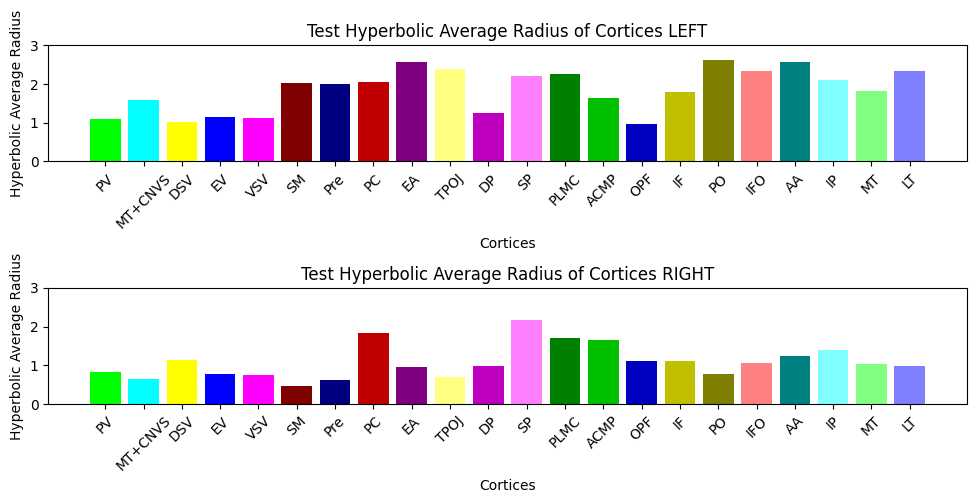

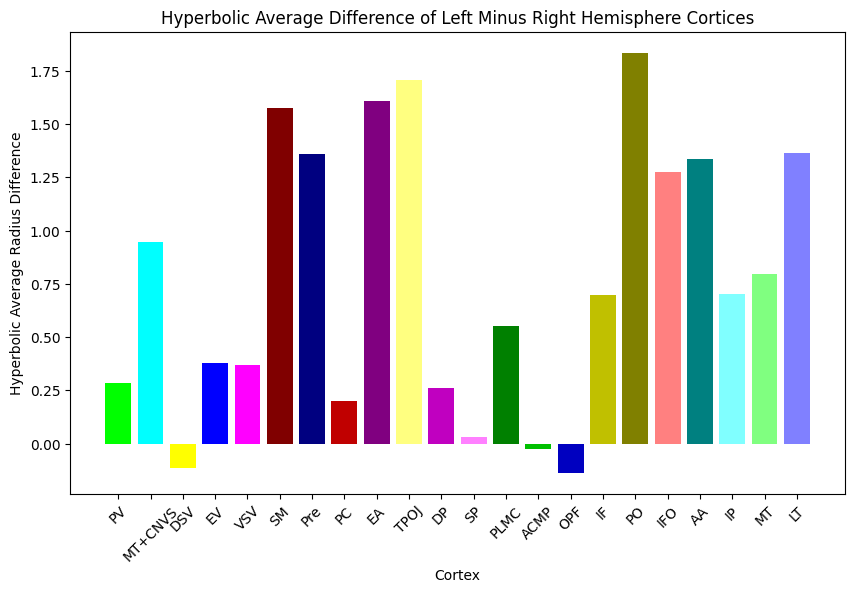

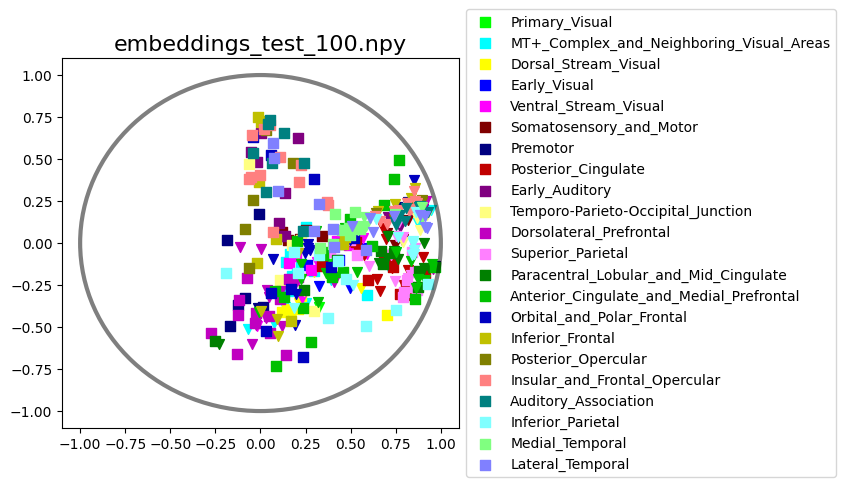

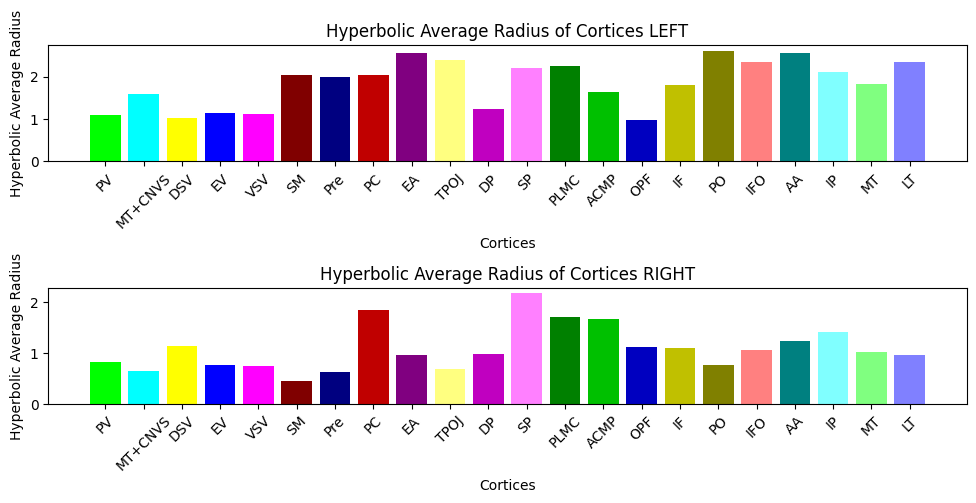

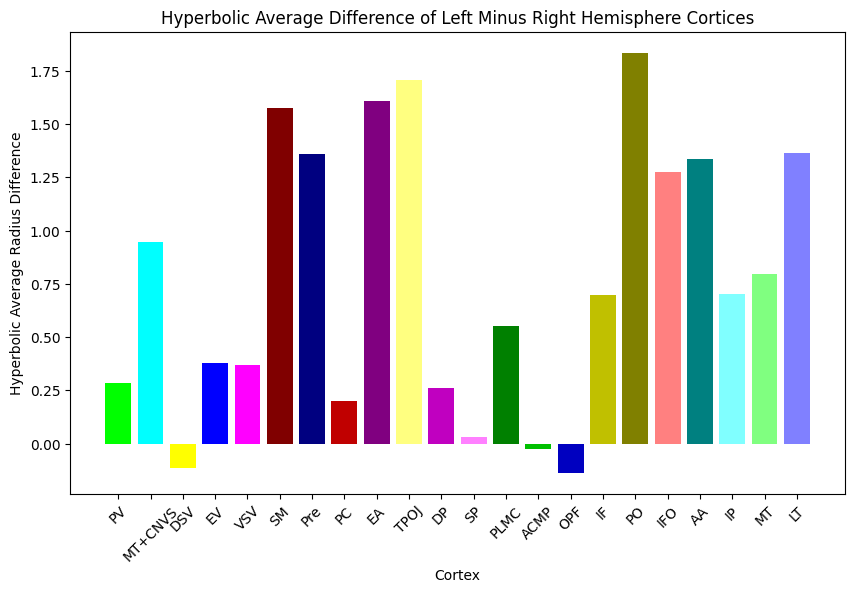

Test_Loss: 1.822572
Test_ROC: 0.78072
Test_Average_Precision: 0.736698
Test_Accuracy: 0.727438


(1.822572, 0.78072, 0.736698)

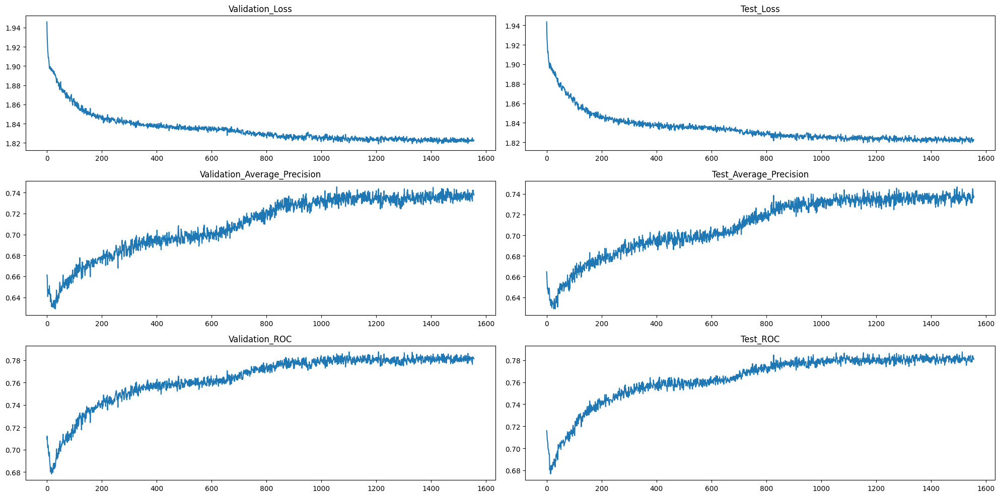

In [8]:
import os 
import numpy as np 
from sklearn.manifold import TSNE
from sklearn.decomposition import TruncatedSVD
from visualization import viz_embeddings
from visualization import plot_embeddings
from visualization import plot_embeddings_by_parts
from visualization import plot_tree_embeddings
from visualization import viz_metrics_multiple
from visualization import plot_total_avg_hyperbolic_radii
date = "2023_7_13"
log_num = '9'
log_path = os.path.join("logs", "lp", date, log_num)
embeddings_dir = os.path.join(log_path, 'embeddings')
log_path = os.path.join(os.getcwd(), 
                        "logs", 
                        "lp", 
                        date, 
                        log_num)

metrics_path = os.path.join(log_path, "log.txt")

plot_total_avg_hyperbolic_radii(embeddings_dir)

train_indices = []
for train_embeddings_dir in os.listdir(embeddings_dir):
    if 'test' not in train_embeddings_dir: continue
    _, _, train_index_str = train_embeddings_dir.split("_")
    embeddings = np.load(os.path.join(log_path, "embeddings", train_embeddings_dir))
    plot_embeddings(embeddings, 
                         use_scale=False, 
                         use_centroids=True,
                         title=train_embeddings_dir)      
#     plot_embeddings_by_parts(embeddings,
#                              use_scale=False,
#                              use_centroids=True,
#                              title=train_embeddings_dir)
viz_metrics_multiple(metrics_path)

c:\users\rarh9\desktop\mit\meng\fhnn_venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


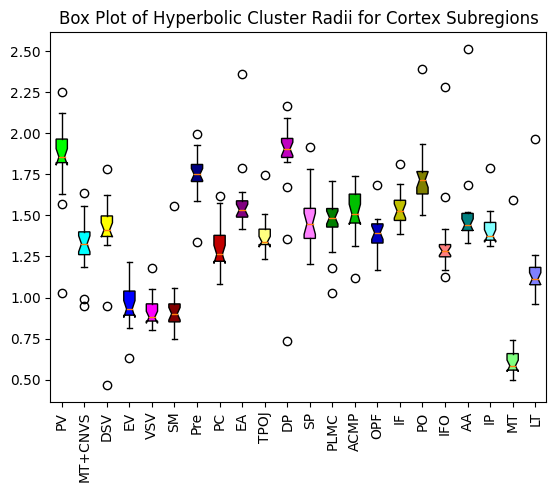

In [1]:
from visualization import viz_hyperbolic_radii_box_plots

viz_hyperbolic_radii_box_plots("2023_7_1")

c:\users\rarh9\desktop\mit\meng\fhnn_venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


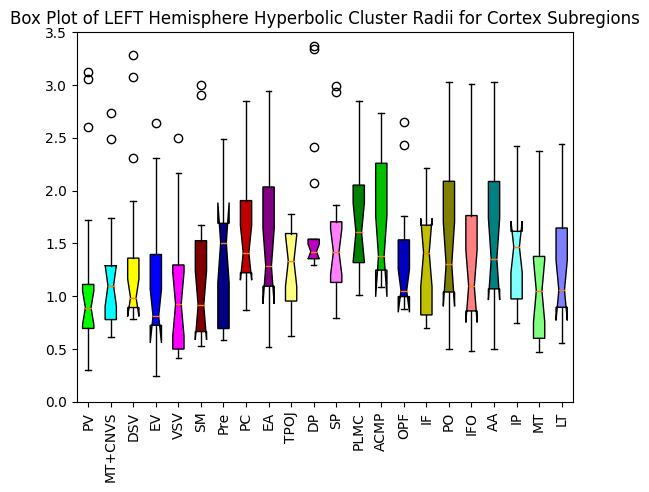

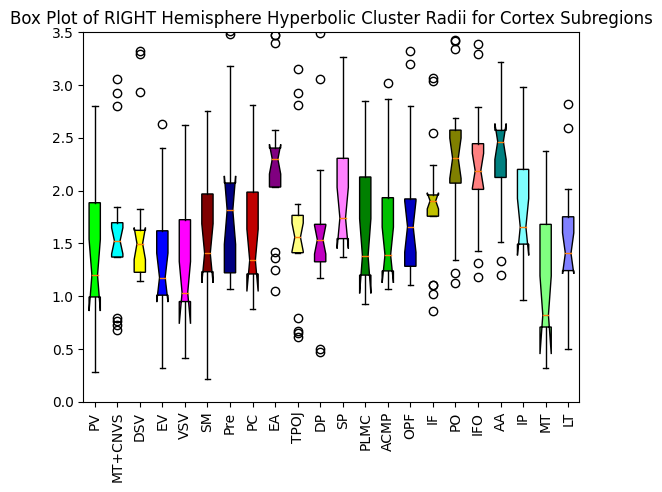

In [1]:
from visualization import viz_hyperbolic_radii_box_plots_left_right

viz_hyperbolic_radii_box_plots_left_right("2023_7_4")

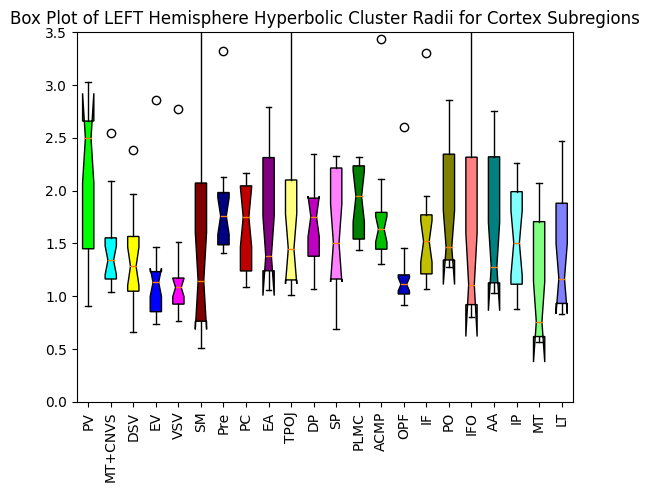

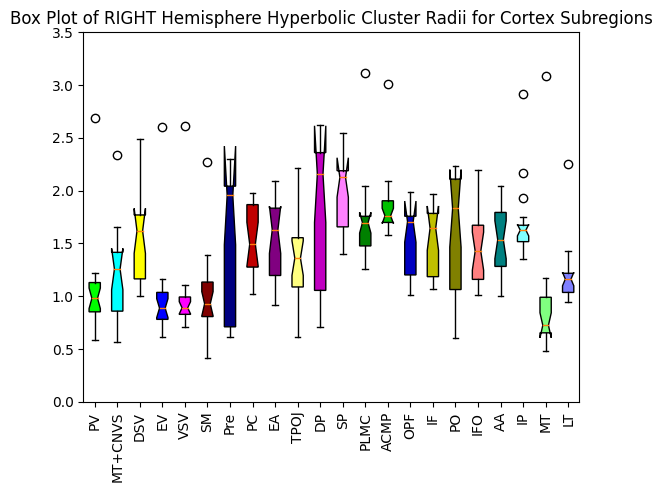

In [7]:
from visualization import viz_hyperbolic_radii_box_plots_left_right
viz_hyperbolic_radii_box_plots_left_right("2023_7_13")

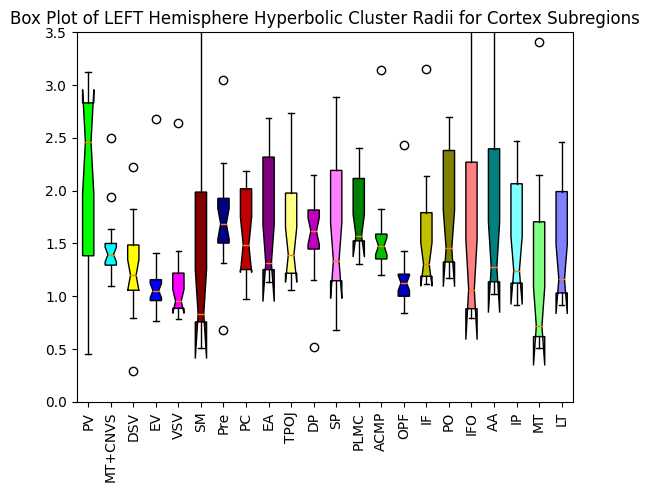

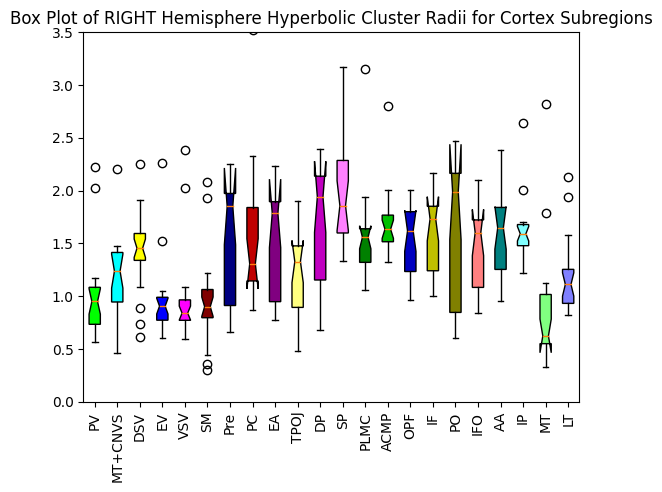

In [6]:
from visualization import viz_hyperbolic_radii_box_plots_left_right
viz_hyperbolic_radii_box_plots_left_right("2023_7_15_CT_identity_clumping_fixed")

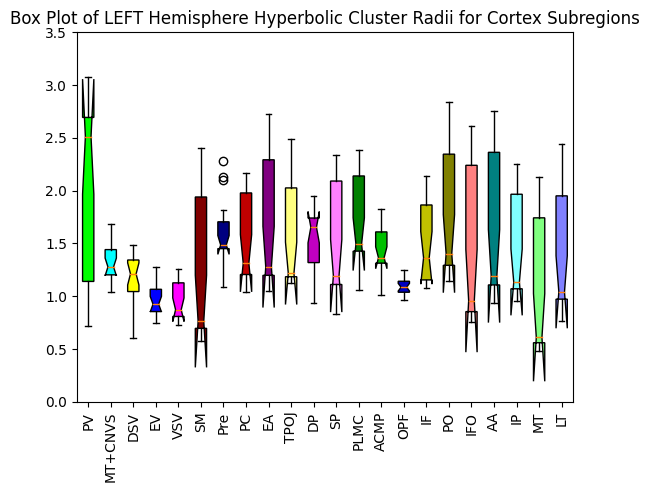

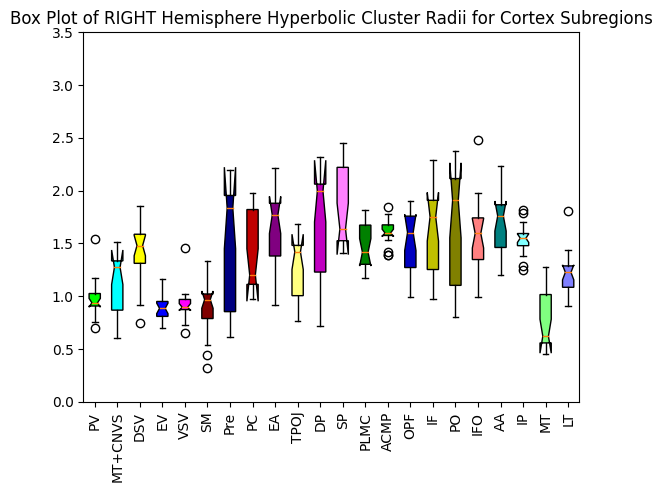

In [8]:
from visualization import viz_hyperbolic_radii_box_plots_left_right
viz_hyperbolic_radii_box_plots_left_right("2023_7_15")

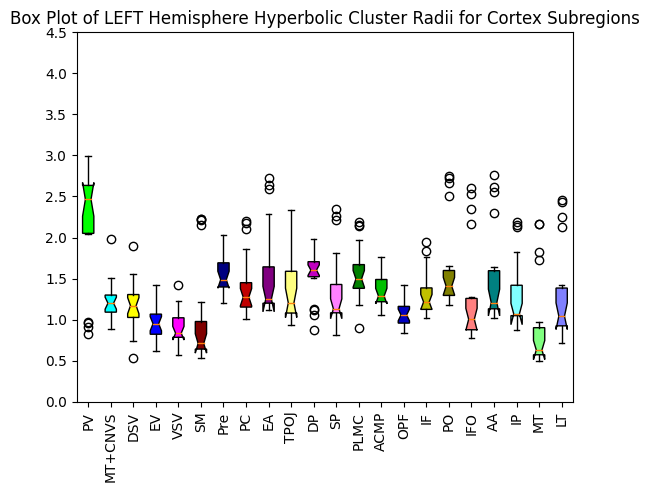

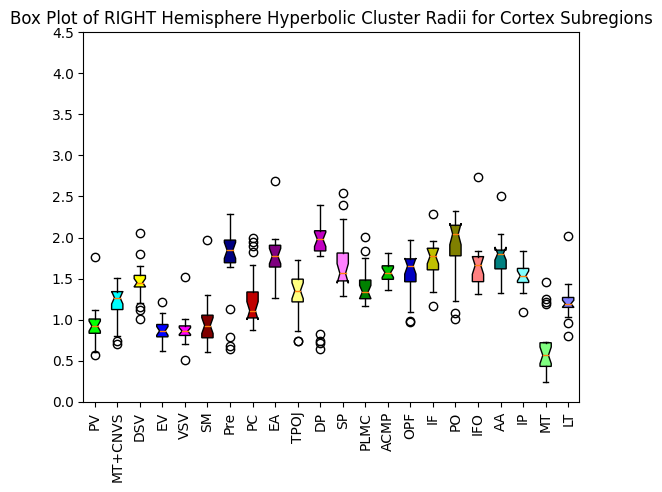

In [3]:
from visualization import viz_hyperbolic_radii_box_plots_left_right
viz_hyperbolic_radii_box_plots_left_right("2023_7_16_CT_myelination_id")

In [3]:
from hyperbolic_clustering.hyperbolic_cluster_metrics import get_roi_hyperbolic_radii_vector
from visualization import get_embeddings_df_list
embeddings_df_list = get_embeddings_df_list("2023_7_13")
embeddings_0 = embeddings_df_list[0]
hyperbolic_radii_0 = get_roi_hyperbolic_radii_vector(embeddings_0)

len(hyperbolic_radii_0)

360

In [22]:
from hyperbolic_clustering.hyperbolic_cluster_metrics import fit_clusters

In [6]:
from utils.data_utils import get_feature_matrix

feature_matrix = get_feature_matrix(0, os.path.join(os.environ['DATAPATH'], 'cam_can_multiple'), use_thicks_myelins=False)

INFO:root:Using CT + Identity Feature Matrix
INFO:root:Feature Matrix: [[0.         1.         0.         ... 0.         0.         0.        ]
 [0.21274208 0.         1.         ... 0.         0.         0.        ]
 [0.11976639 0.         0.         ... 0.         0.         0.        ]
 ...
 [0.62578743 0.         0.         ... 1.         0.         0.        ]
 [0.38427385 0.         0.         ... 0.         1.         0.        ]
 [0.38410251 0.         0.         ... 0.         0.         1.        ]]


In [13]:
thick_features = feature_matrix[:, 0]

In [19]:

np.corrcoef(hyperbolic_radii_0, thick_features)[1, 0]

-0.038389337722661794

In [16]:
import math

def calculate_correlation(data_X, data_Y):
    # Step 1: Check if the vectors have the same length
    if len(data_X) != len(data_Y):
        raise ValueError("The input vectors must have the same length.")
    
    # Step 2: Calculate the means of data_X and data_Y
    mean_X = sum(data_X) / len(data_X)
    mean_Y = sum(data_Y) / len(data_Y)
    
    # Step 3: Calculate the standard deviations of data_X and data_Y
    std_X = math.sqrt(sum((x - mean_X) ** 2 for x in data_X) / len(data_X))
    std_Y = math.sqrt(sum((y - mean_Y) ** 2 for y in data_Y) / len(data_Y))
    
    # Step 4: Calculate the covariance between data_X and data_Y
    covariance = sum((x - mean_X) * (y - mean_Y) for x, y in zip(data_X, data_Y)) / len(data_X)
    
    # Step 5: Calculate the correlation coefficient (Pearson correlation coefficient)
    correlation = covariance / (std_X * std_Y)
    
    return correlation

In [17]:
calculate_correlation(hyperbolic_radii_0, thick_features)

tensor(-0.0384)

In [20]:
def calculate_covariance(data_X, data_Y):
    # Step 1: Check if the vectors have the same length
    if len(data_X) != len(data_Y):
        raise ValueError("The input vectors must have the same length.")
    
    # Step 2: Calculate the means of data_X and data_Y
    mean_X = sum(data_X) / len(data_X)
    mean_Y = sum(data_Y) / len(data_Y)
    
    # Step 3: Calculate the standard deviations of data_X and data_Y
    std_X = math.sqrt(sum((x - mean_X) ** 2 for x in data_X) / len(data_X))
    std_Y = math.sqrt(sum((y - mean_Y) ** 2 for y in data_Y) / len(data_Y))
    
    # Step 4: Calculate the covariance between data_X and data_Y
    covariance = sum((x - mean_X) * (y - mean_Y) for x, y in zip(data_X, data_Y)) / len(data_X)
    
    # Step 5: Calculate the correlation coefficient (Pearson correlation coefficient)
#     correlation = covariance / (std_X * std_Y)
    
    return covariance

In [30]:
calculate_covariance([1,2,3], [0, 1, 0.5])

0.16666666666666666

In [32]:
calculate_covariance([1,2,3], [0, 1, 0.5]) / np.sqrt(np.var([1,2,3]) * np.var([0,1,0.5]))

0.5

In [34]:
calculate_correlation([1,2,3], [0, 1, 0.5])

0.5

In [28]:
np.var([1,2,3])

0.6666666666666666

In [29]:
np.var([1,0,0.5])

0.16666666666666666

In [35]:
def calculate_correlation(data_X, data_Y):
    # Step 1: Check if the vectors have the same length
    if len(data_X) != len(data_Y):
        raise ValueError("The input vectors must have the same length.")
    
    # Step 2: Calculate the correlation coefficient using numpy functions
    correlation = np.corrcoef(data_X, data_Y)[0, 1]
    
    return correlation

In [36]:
calculate_correlation([1,2,3], [0, 1, 0.5])

0.5

In [1]:
from visualization import consolidate_correlations_fisher_z
    
consolidate_correlations_fisher_z("2023_7_13", "thickness")

c:\users\rarh9\desktop\mit\meng\fhnn_venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


0.044415947598132215

In [4]:
from visualization import consolidate_correlations_fisher_z

consolidate_correlations_fisher_z("2023_7_13", "myelination")

-0.023627685306945676

In [2]:
from visualization import consolidate_correlations_fisher_z

consolidate_correlations_fisher_z("2023_7_15_CT_identity_clumping_fixed", "thickness")

0.05246058884276703

In [3]:
from visualization import consolidate_correlations_fisher_z

consolidate_correlations_fisher_z("2023_7_15_myelination_identity", "myelination")

-0.04784823815303121

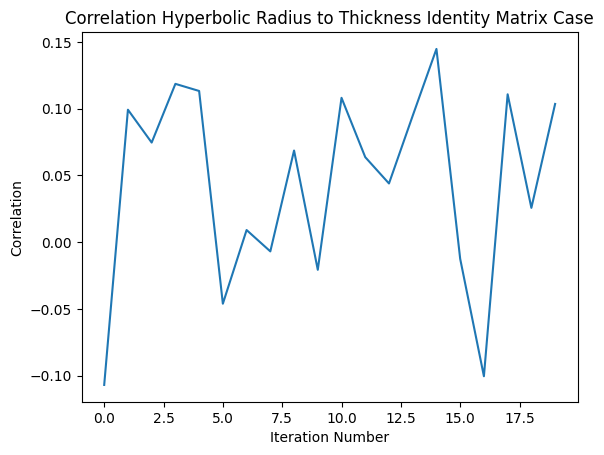

In [3]:
from visualization import get_correlations_hyperbolic_radii_to_thickness

correlations = get_correlations_hyperbolic_radii_to_thickness("2023_7_13")

import matplotlib.pyplot as plt
plt.title("Correlation Hyperbolic Radius to Thickness Identity Matrix Case")
plt.ylabel("Correlation")
plt.xlabel("Iteration Number")
plt.plot(correlations)

c:\users\rarh9\desktop\mit\meng\fhnn_venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


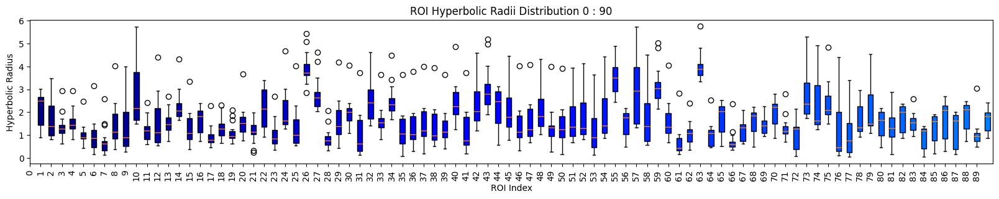

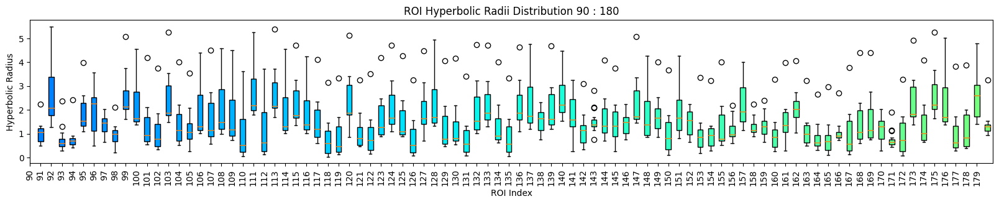

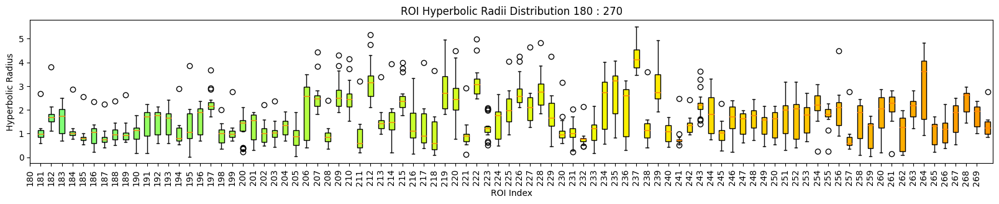

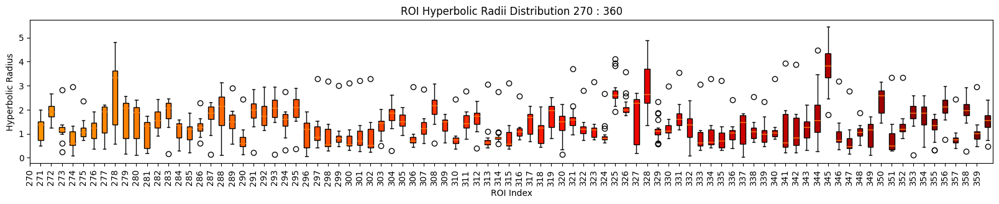

In [1]:
from visualization import plot_roi_hyperbolic_radii_distribution

plot_roi_hyperbolic_radii_distribution("2023_7_13")

In [1]:
from visualization import consolidate_difference_correlations_fisher_z

consolidate_difference_correlations_fisher_z("2023_7_15_myelination_identity", "myelination")

c:\users\rarh9\desktop\mit\meng\fhnn_venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


-0.07961665804729355

In [2]:
from visualization import consolidate_difference_correlations_fisher_z

consolidate_difference_correlations_fisher_z("2023_7_15_CT_identity_clumping_fixed", "thickness")

0.08752982655365873

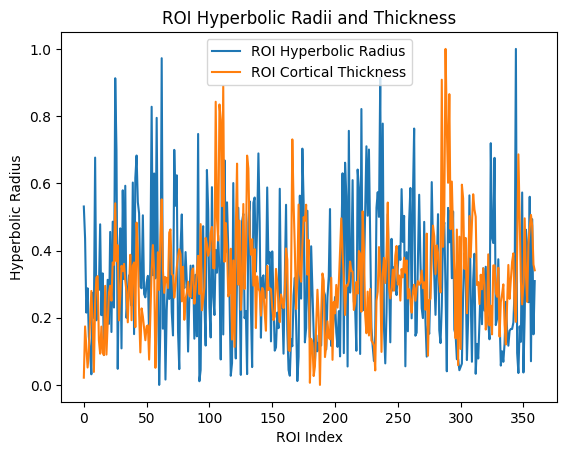

In [2]:
from visualization import viz_roi_hyperbolic_radii_vs_thickness

viz_roi_hyperbolic_radii_vs_thickness("2023_7_15_CT_identity_clumping_fixed")

c:\users\rarh9\desktop\mit\meng\fhnn_venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


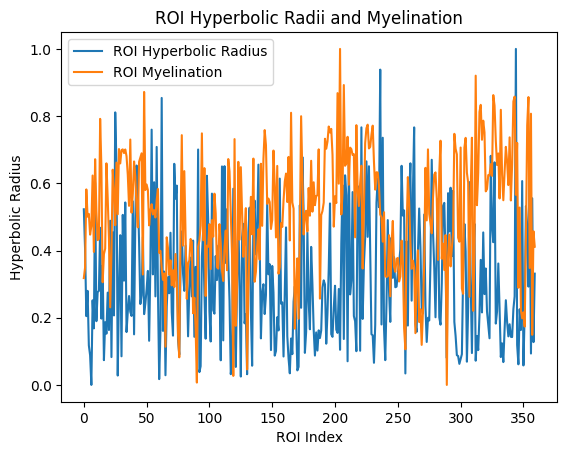

In [1]:
from visualization import viz_roi_hyperbolic_radii_vs_myelination

viz_roi_hyperbolic_radii_vs_myelination("2023_7_15_myelination_identity")

In [2]:
from visualization import correlate_average_hyperbolic_radius_to_thickness
import os
correlate_average_hyperbolic_radius_to_thickness(os.path.join(os.getcwd(), "logs", "lp", "2023_7_15_myelination_identity"), 100)


-0.05705516241454907

In [2]:
from visualization import collect_metrics_multiple

collect_metrics_multiple("2023_7_23")

9th Line INFO:root:Early stopping

NUM LINES 20191708
10th Line INFO:root:Test Epoch: 0657 test Phase of Epoch 656: Precision 0.968783, ROC 0.983407, Loss 1.607308, Accuracy 0.957509, Edges 55854, Graphs 60

['INFO:root:Test', 'Epoch:', '0657', 'test', 'Phase', 'of', 'Epoch', '656:', 'Precision', '0.968783,', 'ROC', '0.983407,', 'Loss', '1.607308,', 'Accuracy', '0.957509,', 'Edges', '55854,', 'Graphs', '60\n'] THESE ARE THE WORDS
9th Line INFO:root:Early stopping

NUM LINES 148570
10th Line INFO:root:Test Epoch: 0762 test Phase of Epoch 761: Precision 0.967908, ROC 0.982733, Loss 1.605768, Accuracy 0.958796, Edges 48396, Graphs 60

['INFO:root:Test', 'Epoch:', '0762', 'test', 'Phase', 'of', 'Epoch', '761:', 'Precision', '0.967908,', 'ROC', '0.982733,', 'Loss', '1.605768,', 'Accuracy', '0.958796,', 'Edges', '48396,', 'Graphs', '60\n'] THESE ARE THE WORDS
9th Line INFO:root:Early stopping

NUM LINES 148570
10th Line INFO:root:Test Epoch: 0762 test Phase of Epoch 761: Precision 0.967908, 

([0.968783, 0.967908, 0.967908],
 [0.983407, 0.982733, 0.982733],
 [1.607308, 1.605768, 1.605768],
 [0.957509, 0.958796, 0.958796])

In [3]:
from visualization import collect_metrics_multiple

metrics_329 = collect_metrics_multiple("full_fhnn_cam_can_threshold_0.329")
metrics_036 = collect_metrics_multiple("full_fhnn_cam_can_threshold_0.36")
metrics_439 = collect_metrics_multiple("full_fhnn_cam_can_threshold_0.439")
metrics_529 = collect_metrics_multiple("full_fhnn_cam_can_threshold_0.529")
metrics_063 = collect_metrics_multiple("full_fhnn_cam_can_threshold_0.63")
metrics_065 = collect_metrics_multiple("full_fhnn_cam_can_threshold_0.65")





THREE ARE THE WORDS  ['INFO:root:Test', 'Epoch:', '0400', 'test', 'Phase', 'of', 'Epoch', '399:', 'Precision', '0.719361,', 'ROC', '0.768880,', 'Loss', '1.837932,', 'Accuracy', '0.699532,', 'Edges', '105718,', 'Graphs', '6\n']
THREE ARE THE WORDS  ['INFO:root:Test', 'Epoch:', '0400', 'test', 'Phase', 'of', 'Epoch', '399:', 'Precision', '0.709782,', 'ROC', '0.758335,', 'Loss', '1.842673,', 'Accuracy', '0.693789,', 'Edges', '105718,', 'Graphs', '6\n']
THREE ARE THE WORDS  ['INFO:root:Test', 'Epoch:', '0200', 'test', 'Phase', 'of', 'Epoch', '199:', 'Precision', '0.864107,', 'ROC', '0.914478,', 'Loss', '1.725487,', 'Accuracy', '0.843097,', 'Edges', '393932,', 'Graphs', '60\n']
THREE ARE THE WORDS  ['INFO:root:Val', 'Epoch:', '1000', 'val', 'Phase', 'of', 'Epoch', '999:', 'Precision', '0.969934,', 'ROC', '0.984626,', 'Loss', '1.604732,', 'Accuracy', '0.959482,', 'Edges', '104038,', 'Graphs', '117\n']
THREE ARE THE WORDS  ['INFO:root:Test', 'Epoch:', '1000', 'test', 'Phase', 'of', 'Epoch', '

In [17]:
average_precision, roc_auc, final_test_loss, accuracy = metrics_329

average_precision_mean = sum(average_precision) / len(average_precision)
roc_auc_mean = sum(roc_auc) / len(roc_auc)
final_test_loss_mean = sum(final_test_loss) / len(final_test_loss)
accuracy_mean = sum(accuracy) / len(accuracy)

print("Average Precision :", average_precision_mean)
print("ROC AUC :", roc_auc_mean)
print("Test Loss :", final_test_loss_mean)
print("Accuracy :", accuracy_mean)

Average Precision : 0.8410832500000001
ROC AUC : 0.8932605
Test Loss : 1.74794525
Accuracy : 0.8140922500000001


In [18]:
average_precision, roc_auc, final_test_loss, accuracy = metrics_036

average_precision_mean = sum(average_precision) / len(average_precision)
roc_auc_mean = sum(roc_auc) / len(roc_auc)
final_test_loss_mean = sum(final_test_loss) / len(final_test_loss)
accuracy_mean = sum(accuracy) / len(accuracy)

print("Average Precision :", average_precision_mean)
print("ROC AUC :", roc_auc_mean)
print("Test Loss :", final_test_loss_mean)
print("Accuracy :", accuracy_mean)

Average Precision : 0.7644166666666666
ROC AUC : 0.8138976666666666
Test Loss : 1.8020306666666668
Accuracy : 0.7454726666666667


In [19]:
average_precision, roc_auc, final_test_loss, accuracy = metrics_439

average_precision_mean = sum(average_precision) / len(average_precision)
roc_auc_mean = sum(roc_auc) / len(roc_auc)
final_test_loss_mean = sum(final_test_loss) / len(final_test_loss)
accuracy_mean = sum(accuracy) / len(accuracy)

print("Average Precision :", average_precision_mean)
print("ROC AUC :", roc_auc_mean)
print("Test Loss :", final_test_loss_mean)
print("Accuracy :", accuracy_mean)

Average Precision : 0.920512
ROC AUC : 0.956007
Test Loss : 1.669072
Accuracy : 0.905349


In [20]:
average_precision, roc_auc, final_test_loss, accuracy = metrics_529

average_precision_mean = sum(average_precision) / len(average_precision)
roc_auc_mean = sum(roc_auc) / len(roc_auc)
final_test_loss_mean = sum(final_test_loss) / len(final_test_loss)
accuracy_mean = sum(accuracy) / len(accuracy)

print("Average Precision :", average_precision_mean)
print("ROC AUC :", roc_auc_mean)
print("Test Loss :", final_test_loss_mean)
print("Accuracy :", accuracy_mean)

Average Precision : 0.949038
ROC AUC : 0.974709
Test Loss : 1.631339
Accuracy : 0.939716


In [21]:
average_precision, roc_auc, final_test_loss, accuracy = metrics_063

average_precision_mean = sum(average_precision) / len(average_precision)
roc_auc_mean = sum(roc_auc) / len(roc_auc)
final_test_loss_mean = sum(final_test_loss) / len(final_test_loss)
accuracy_mean = sum(accuracy) / len(accuracy)

print("Average Precision :", average_precision_mean)
print("ROC AUC :", roc_auc_mean)
print("Test Loss :", final_test_loss_mean)
print("Accuracy :", accuracy_mean)

Average Precision : 0.9065002499999999
ROC AUC : 0.93101625
Test Loss : 1.65692725
Accuracy : 0.90498575


In [22]:
average_precision, roc_auc, final_test_loss, accuracy = metrics_065

average_precision_mean = sum(average_precision) / len(average_precision)
roc_auc_mean = sum(roc_auc) / len(roc_auc)
final_test_loss_mean = sum(final_test_loss) / len(final_test_loss)
accuracy_mean = sum(accuracy) / len(accuracy)

print("Average Precision :", average_precision_mean)
print("ROC AUC :", roc_auc_mean)
print("Test Loss :", final_test_loss_mean)
print("Accuracy :", accuracy_mean)

Average Precision : 0.96874125
ROC AUC : 0.983563
Test Loss : 1.6046122500000002
Accuracy : 0.95954475
